## Import libraries

In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers, losses, metrics, optimizers, callbacks
from sklearn.model_selection import KFold
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import SVG, Markdown, display, display_pretty
from tqdm.keras import TqdmCallback

Using TensorFlow backend.


## Load data

In [2]:
otu = pd.read_csv('data/otu_table_all_80.csv', index_col=0, header=None, sep='\t').T
otu = otu.set_index('otuids')

/home/wilkinsonlab/Environments/envKeras/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244

In [3]:
print(otu.shape)
otu = otu.astype('int32')
otu.head()

(4724, 717)


,4479944,513055,519510,810959,849092,1042671,818174,585221,1033380,875704,...,966091,55354,515709,902698,591499,569066,823091,219094,961783,823633
otuids,,,,,,,,,,,,,,,,,,,,,
11116.C02A66.1194587,70,2,22,5,5,0,0,0,0,1,...,25,0,3,149,0,2,19,0,32,2
11116.C06A63.1195666,8,16,15,0,2,0,0,0,0,0,...,18,0,2,63,1,78,2,0,58,2
11116.C08A61.1197689,18,1,12,3,1,1,0,0,0,7,...,26,0,5,61,0,1,4,0,350,3
11116.C08A63.1196825,24,1,30,1,3,0,0,0,0,4,...,12,0,4,57,2,29,6,0,45,2
11116.C12A64.1197667,22,0,33,6,5,0,0,0,0,1,...,34,0,7,136,0,22,10,0,281,1


In [4]:
tax = pd.read_csv('data/tax_table_all_80.csv', sep='\t')

In [5]:
print(tax.shape)
tax.head()

(717, 8)


,otuids,Rank1,Rank2,Rank3,Rank4,Rank5,Rank6,Rank7
0,4479944,k__Bacteria,p__Actinobacteria,c__MB-A2-108,o__0319-7L14,f__,g__,s__
1,513055,k__Bacteria,p__Proteobacteria,c__Gammaproteobacteria,o__Xanthomonadales,f__Sinobacteraceae,g__Steroidobacter,s__
2,519510,k__Bacteria,p__Proteobacteria,c__Alphaproteobacteria,o__Sphingomonadales,f__,g__,s__
3,810959,k__Bacteria,p__Actinobacteria,c__Actinobacteria,o__Actinomycetales,f__Intrasporangiaceae,g__Knoellia,s__
4,849092,k__Bacteria,p__Bacteroidetes,c__Cytophagia,o__Cytophagales,f__Cytophagaceae,g__,s__


In [6]:
metadata = pd.read_csv('data/metadata_table_all_80.csv', sep='\t')
metadata = metadata.set_index('X.SampleID')

print(metadata.shape)
metadata.head()

(4724, 71)


,BarcodeSequence,LinkerPrimerSequence,center_name,experiment_design_description,instrument_model,library_construction_protocol,linker,pcr_primers,platform,run_center,...,Field_BulkSoil,RUN_PREFIX,Sample_date,Temperature,PrecipitationSameDay,Precipitation2Days,Precipitation3Days,INBREDS,Maize_Line,Description1
X.SampleID,,,,,,,,,,,,,,,,,,,,,
11116.C02A66.1194587,ATACTTCGCAG,GTGTGYCAGCMGCCGCGGTAA,Maize,equimolar mix of pool members for Illumina HiS...,Illumina MiSeq,Maize roots-associated soil DNA was extracted ...,GT,FWD:GTGYCAGCMGCCGCGGTAA; REV:GGACTACNVGGGTWTCTAAT,Illumina,JGI,...,Columbia,M2084.7554.1.75777,08/10/10,76.0,0.07,0.14,0.14,Oh7B,Non_Stiff_Stalk,rhizosphere
11116.C06A63.1195666,TCGCTGTAACA,GTGTGYCAGCMGCCGCGGTAA,Maize,equimolar mix of pool members for Illumina HiS...,Illumina MiSeq,Maize roots-associated soil DNA was extracted ...,GT,FWD:GTGYCAGCMGCCGCGGTAA; REV:GGACTACNVGGGTWTCTAAT,Illumina,JGI,...,Columbia,M2085.7557.1.75778,08/10/10,76.0,0.07,0.14,0.14,P39,Sweet_Corn,rhizosphere
11116.C08A61.1197689,TCTGGAACGCT,GTGTGYCAGCMGCCGCGGTAA,Maize,equimolar mix of pool members for Illumina HiS...,Illumina MiSeq,Maize roots-associated soil DNA was extracted ...,GT,FWD:GTGYCAGCMGCCGCGGTAA; REV:GGACTACNVGGGTWTCTAAT,Illumina,JGI,...,Columbia,M2085.7557.1.75778,08/10/10,76.0,0.07,0.14,0.14,CML333,Tropical,rhizosphere
11116.C08A63.1196825,CTTGTAGGACC,GTGTGYCAGCMGCCGCGGTAA,Maize,equimolar mix of pool members for Illumina HiS...,Illumina MiSeq,Maize roots-associated soil DNA was extracted ...,GT,FWD:GTGYCAGCMGCCGCGGTAA; REV:GGACTACNVGGGTWTCTAAT,Illumina,JGI,...,Columbia,M2085.7557.1.75778,08/10/10,76.0,0.07,0.14,0.14,CML333,Tropical,rhizosphere
11116.C12A64.1197667,AGCGATGCCTT,GTGTGYCAGCMGCCGCGGTAA,Maize,equimolar mix of pool members for Illumina HiS...,Illumina MiSeq,Maize roots-associated soil DNA was extracted ...,GT,FWD:GTGYCAGCMGCCGCGGTAA; REV:GGACTACNVGGGTWTCTAAT,Illumina,JGI,...,Columbia,M2085.7557.1.75778,08/10/10,76.0,0.07,0.14,0.14,Il14H,Sweet_Corn,rhizosphere


### Get only the metadata we are going to use

In [7]:
metadata.columns

Index(['BarcodeSequence', 'LinkerPrimerSequence', 'center_name',
       'experiment_design_description', 'instrument_model',
       'library_construction_protocol', 'linker', 'pcr_primers', 'platform',
       'run_center', 'run_prefix', 'sample_center', 'sequencing_meth',
       'target_gene', 'target_subfragment', 'qiita_prep_id', 'age', 'age_unit',
       'anonymized_name', 'collection_timestamp', 'depth', 'dna_extracted',
       'elevation', 'env', 'env_biome', 'env_feature', 'env_material',
       'env_package', 'experiment_center', 'geo_loc_name', 'host_common_name',
       'host_scientific_name', 'host_subject_id', 'host_taxid', 'inbreds',
       'latitude', 'longitude', 'physical_specimen_location',
       'physical_specimen_remaining', 'plant_product', 'plot',
       'qiita_study_id', 'rangecoord', 'rep', 'row', 'rowcoord', 'samp_size',
       'sample_type', 'scientific_name', 'shipment', 'study_center', 'subrow',
       'taxon_id', 'timepoint', 'timepoint_units', 'week', 'Desc

In [8]:
domain = metadata[['age',
                   'Temperature',
                   'Precipitation3Days',
                   'INBREDS',
                   'Maize_Line']]
domain.head()

,age,Temperature,Precipitation3Days,INBREDS,Maize_Line
X.SampleID,,,,,
11116.C02A66.1194587,12,76.0,0.14,Oh7B,Non_Stiff_Stalk
11116.C06A63.1195666,12,76.0,0.14,P39,Sweet_Corn
11116.C08A61.1197689,12,76.0,0.14,CML333,Tropical
11116.C08A63.1196825,12,76.0,0.14,CML333,Tropical
11116.C12A64.1197667,12,76.0,0.14,Il14H,Sweet_Corn


In [9]:
domain = pd.concat([domain, pd.get_dummies(domain['INBREDS'],prefix='INBREDS')], axis=1)
domain = pd.concat([domain, pd.get_dummies(domain['Maize_Line'],prefix='Maize_Line')], axis=1)
domain = domain.drop(['INBREDS', 'Maize_Line'], axis=1)
domain.head()

,age,Temperature,Precipitation3Days,INBREDS_B73,INBREDS_B97,INBREDS_CML103,INBREDS_CML228,INBREDS_CML247,INBREDS_CML277,INBREDS_CML322,...,INBREDS_Oh7B,INBREDS_P39,INBREDS_Tx303,INBREDS_Tzi8,Maize_Line_Mixed,Maize_Line_Non_Stiff_Stalk,Maize_Line_Popcorn,Maize_Line_Stiff_Stalk,Maize_Line_Sweet_Corn,Maize_Line_Tropical
X.SampleID,,,,,,,,,,,,,,,,,,,,,
11116.C02A66.1194587,12,76.0,0.14,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,0,0,0
11116.C06A63.1195666,12,76.0,0.14,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
11116.C08A61.1197689,12,76.0,0.14,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
11116.C08A63.1196825,12,76.0,0.14,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
11116.C12A64.1197667,12,76.0,0.14,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0


### Join otus and domain in one table

In [10]:
df = pd.concat([otu, domain], axis=1, sort=True, join='outer')

print(df.shape)
df.head()

(4724, 753)


,4479944,513055,519510,810959,849092,1042671,818174,585221,1033380,875704,...,INBREDS_Oh7B,INBREDS_P39,INBREDS_Tx303,INBREDS_Tzi8,Maize_Line_Mixed,Maize_Line_Non_Stiff_Stalk,Maize_Line_Popcorn,Maize_Line_Stiff_Stalk,Maize_Line_Sweet_Corn,Maize_Line_Tropical
11116.A01A061.1195113,73,0,749,6,11,1,1052,0,0,76,...,0,0,0,0,0,0,0,1,0,0
11116.A01A070.1197472,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
11116.A01A073.1194387,9,0,8,0,20,0,25,0,0,0,...,0,0,0,0,0,0,0,1,0,0
11116.A01A076.1198452,18,0,17,0,45,1,32,0,0,1,...,0,0,0,0,0,0,0,1,0,0
11116.A01A079.1197702,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [11]:
class CenterLogRatio(layers.Layer):

    def __init__(self):
        super(CenterLogRatio, self).__init__(name='center_log_ratio')

    def build(self, input_shape):
        super(CenterLogRatio, self).build(input_shape)

    def call(self, x, **kwargs):
        x = x + 1 # TODO to remove all ceros
        logx = tf.math.log(x)
        log_mean = tf.math.reduce_mean(logx, axis=-1, keepdims=True)
        return tf.subtract(logx, log_mean, name='center_log_ratio')

    def compute_output_shape(self, input_shape):
        return input_shape

class Percentage(layers.Layer):

    def __init__(self):
        super(Percentage, self).__init__(name='percentage')

    def build(self, input_shape):
        super(Percentage, self).build(input_shape)

    def call(self, x, **kwargs):
        x_sum = tf.math.reduce_sum(x, axis=-1, keepdims=True)
        return tf.math.divide(x, x_sum, name='percentage')

    def compute_output_shape(self, input_shape):
        return input_shape


class Identity(layers.Layer):

    def __init__(self, name):
        super(Identity, self).__init__(name=name)

    def build(self, input_shape):
        super(Identity, self).build(input_shape)

    def call(self, x, **kwargs):
        return x

    def compute_output_shape(self, input_shape):
        return input_shape


class MeanSquaredErrorWrapper(metrics.MeanSquaredError):

    def __init__(self, y_true_transformer, y_pred_transformer):
        super(MeanSquaredErrorWrapper, self).__init__(name='mse')
        self.y_true_transformer = y_true_transformer
        self.y_pred_transformer = y_pred_transformer

    def __call__(self, y_true, y_pred, *args, **kwargs):
        if self.y_true_transformer is not None:
            y_true = self.y_true_transformer(y_true)
        if self.y_pred_transformer is not None:
            y_pred = self.y_pred_transformer(y_pred)
        return super(MeanSquaredErrorWrapper, self).__call__(y_true, y_pred, *args, **kwargs)


class MeanAbsoluteErrorWrapper(metrics.MeanAbsoluteError):

    def __init__(self, y_true_transformer, y_pred_transformer):
        super(MeanAbsoluteErrorWrapper, self).__init__(name='mae')
        self.y_true_transformer = y_true_transformer
        self.y_pred_transformer = y_pred_transformer

    def __call__(self, y_true, y_pred, *args, **kwargs):
        if self.y_true_transformer is not None:
            y_true = self.y_true_transformer(y_true)
        if self.y_pred_transformer is not None:
            y_pred = self.y_pred_transformer(y_pred)
        return super(MeanAbsoluteErrorWrapper, self).__call__(y_true, y_pred, *args, **kwargs)


class MeanAbsolutePercentageErrorWrapper(metrics.MeanAbsolutePercentageError):

    def __init__(self, y_true_transformer, y_pred_transformer):
        super(MeanAbsolutePercentageErrorWrapper, self).__init__(name='mape')
        self.y_true_transformer = y_true_transformer
        self.y_pred_transformer = y_pred_transformer

    def __call__(self, y_true, y_pred, *args, **kwargs):
        if self.y_true_transformer is not None:
            y_true = self.y_true_transformer(y_true)
        if self.y_pred_transformer is not None:
            y_pred = self.y_pred_transformer(y_pred)
        y_pred = y_pred + 1 # to avoid 0
        y_true = y_true + 1 # to avoid 0
        return super(MeanAbsolutePercentageErrorWrapper, self).__call__(y_true, y_pred, *args, **kwargs)


# TODO more metrics: correlations

In [12]:
# TODO add VAE??

def autoencoder(bioma_shape=717,
                domain_shape=36,
                latent_space=10,
                bioma_layers=[128,64],
                domain_layers=[32,16],
                input_transform=CenterLogRatio(), # Percentage
                output_transform=None, # layers.Softmax
                activation_function_encoder=layers.ReLU(),
                activation_function_decoder=layers.ReLU(),
                activation_function_latent='tanh',
                ):

    has_domain = domain_shape is not None

    # encoder bioma

    in_bioma = layers.Input(shape=(bioma_shape,), name='bioma_input_{}'.format(bioma_shape))
    net = in_bioma
    if input_transform is not None:
        net = input_transform(net)
    for s in bioma_layers:
        net = layers.Dense(s, activation=activation_function_encoder,
                           name="encoder_bioma_dense_{}".format(s))(net)
    encoded_bioma = layers.Dense(latent_space, activation=activation_function_latent,
                                 name='encoded_bioma_{}'.format(latent_space))(net)
    encoder_bioma = keras.Model(inputs=in_bioma, outputs=encoded_bioma, name='EncoderBioma')

    # encoder domain

    if has_domain:
        in_domain = layers.Input(shape=(domain_shape,), name='domain_input_{}'.format(domain_shape))
        net = in_domain
        for s in domain_layers:
            net = layers.Dense(s, activation=activation_function_encoder,
                               name="encoder_domain_dense_{}".format(s))(net)
        encoded_domain = layers.Dense(latent_space, activation=activation_function_latent,
                                      name='encoded_domain_{}'.format(latent_space))(net)
        encoder_domain = keras.Model(inputs=in_domain, outputs=encoded_domain, name='EncoderDomain')
    else:
        encoded_domain = None
        encoder_domain = None

    # decoder bioma for both autoencoders

    in_latent_space = layers.Input(shape=(latent_space,), name='latent_space_input')
    net = in_latent_space
    net_bioma = encoded_bioma
    net_domain = encoded_domain
    for s in reversed(bioma_layers):
        layer = layers.Dense(s, activation=activation_function_decoder,
                             name="decoder_dense_{}".format(s))
        net = layer(net)
        net_bioma = layer(net_bioma)
        if has_domain:
            net_domain = layer(net_domain)

    layer = layers.Dense(bioma_shape, activation=None, name='decoded_bioma')
    decoded_bioma = layer(net)
    net_bioma = layer(net_bioma)
    if has_domain:
        net_domain = layer(net_domain)

    if output_transform is not None:
        decoded_bioma = output_transform(decoded_bioma)
        net_bioma = output_transform(net_bioma)
        if has_domain:
            net_domain = output_transform(net_domain)

    decoder_bioma = keras.Model(inputs=in_latent_space, outputs=decoded_bioma, name='DecoderBioma')

    # combined model for training

    if has_domain:
        diff_encoders = tf.math.abs(encoded_domain - encoded_bioma, name='diff_encoded')
        diff_encoders = Identity(name='latent')(diff_encoders)
        net_bioma = Identity(name='bioma')(net_bioma)
        net_domain = Identity(name='domain')(net_domain)

        model = keras.Model(inputs=[in_bioma, in_domain],
                            outputs=[net_bioma, net_domain, diff_encoders],
                            name='model')
    else:
        net_bioma = Identity(name='bioma')(net_bioma)
        model = keras.Model(inputs=[in_bioma],
                            outputs=[net_bioma],
                            name='model')

    return model, encoder_bioma, encoder_domain, decoder_bioma

def compile_train(model, encoder_domain=None,
                  reconstruction_error=losses.MeanSquaredError(),
                  encoded_comparison_error=losses.MeanAbsoluteError(),
                  metrics=[
                      [
                          metrics.MeanSquaredError(name='mse'),
                          metrics.MeanAbsoluteError(name='mae'),
                          metrics.MeanAbsolutePercentageError(name='mape')
                      ],[
                          metrics.MeanSquaredError(name='mse'),
                          metrics.MeanAbsoluteError(name='mae'),
                          metrics.MeanAbsolutePercentageError(name='mape')
                      ], [
                          metrics.MeanAbsoluteError(name='mae'),
                      ]
                  ],
                  optimizer=optimizers.SGD(lr=0.01)):
    if encoder_domain is not None:
        model.compile(optimizer=optimizer,
                      loss=[reconstruction_error, reconstruction_error, encoded_comparison_error],
                      metrics=metrics)
    else:
        model.compile(optimizer=optimizer,
                      loss=reconstruction_error,
                      metrics=metrics[0])


def exp_decay(epoch):
    initial_lrate = 0.01
    k = 0.9
    lrate = initial_lrate * k**epoch
    return lrate

def train(model_fn,
          data_microbioma,
          data_domain,
          latent_space=10,
          folds=5,
          epochs=20,
          batch_size=128,
          learning_rate_scheduler=callbacks.LearningRateScheduler(exp_decay),
          random_seed=347,
          verbose=0):
    data_zeros_latent = np.zeros((data_domain.shape[0], latent_space), dtype=data_domain.dtype)
    kf = KFold(n_splits=folds, random_state=random_seed, shuffle=True)
    results = []
    if verbose >= 0:
        callbacks = [TqdmCallback(verbose=verbose)]
    else:
        callbacks = []
    if learning_rate_scheduler is not None:
        callbacks += [learning_rate_scheduler]

    for train_index, test_index in kf.split(data_microbioma):
        y_train, y_test = data_microbioma[train_index], data_microbioma[test_index]
        model, encoder_bioma, encoder_domain, decoder_bioma = model_fn()
        if encoder_domain is not None:
            d_train, d_test = data_domain[train_index], data_domain[test_index]
            zs_train, zs_test = data_zeros_latent[train_index], data_zeros_latent[test_index]
            r = model.fit(x=[y_train, d_train],
                          y=[y_train, y_train, zs_train],
                          batch_size=batch_size,
                          epochs=epochs,
                          validation_data=([y_test, d_test], [y_test, y_test, zs_test]),
                          callbacks=callbacks,
                          verbose=0)
        else:
            r = model.fit(x=y_train,
                          y=y_train,
                          batch_size=batch_size,
                          epochs=epochs,
                          validation_data=(y_test, y_test),
                          callbacks=callbacks,
                          verbose=0)

        results.append(r)
    return results

In [13]:
def save_plot_model(model, name='model'):
    filename = '{}.png'.format(name)
    keras.utils.plot_model(model, show_shapes=True, show_layer_names=True, to_file=filename)

def plot_models(model, encoder_bioma, encoder_domain, decoder_bioma):
    def _print(t):
        display_pretty(t,raw=True)
    display(Markdown("### Encoder Bioma"))
    encoder_bioma.summary(line_length=120, print_fn=_print)
    display(SVG(keras.utils.model_to_dot(encoder_bioma, show_shapes=True).create(prog='dot', format='svg')))
    if encoder_domain is not None:
        display(Markdown("### Encoder Domain"))
        encoder_domain.summary(line_length=120, print_fn=_print)
        display(SVG(keras.utils.model_to_dot(encoder_domain, show_shapes=True).create(prog='dot', format='svg')))
    display(Markdown("### Decoder Bioma"))
    decoder_bioma.summary(line_length=120, print_fn=_print)
    display(SVG(keras.utils.model_to_dot(decoder_bioma, show_shapes=True).create(prog='dot', format='svg')))
    display(Markdown("### Model for training"))
    model.summary(line_length=120, print_fn=_print)
    display(SVG(keras.utils.model_to_dot(model, show_shapes=True).create(prog='dot', format='svg')))

def print_results(results):
    sequences = {}
    last_iteration = []
    for k in results[0].history.keys():
        arrays = np.array([r.history[k] for r in results])
        sequences[k] = [arrays.mean(axis=0), arrays.min(axis=0), arrays.max(axis=0)]
        if k.startswith('val_'):
            last_iteration.append((k,[x[-1] for x in sequences[k]]))

    keys = [k for k in results[0].history.keys() if not k.startswith('val_')]
    x = results[0].epoch
    for k in keys:
        mean_seq, min_seq, max_seq = sequences[k]
        display(Markdown("<b>{}</b>: {:.4f} (min: {:.4f}, max: {:.4f})".format(k, mean_seq[-1],
                                                                               min_seq[-1],
                                                                               max_seq[-1])))
        plt.fill_between(x, min_seq, max_seq, color="blue", alpha=0.2)
        plt.plot(x, mean_seq, color="blue", alpha=0.8)
        k_val = 'val_{}'.format(k)
        if k_val in sequences:
            mean_seq, min_seq, max_seq = sequences[k_val]
            plt.fill_between(x, min_seq, max_seq, color="red", alpha=0.2)
            plt.plot(x, mean_seq, color="red", alpha=0.8)

        plt.title(k)
        plt.ylabel(k)
        plt.xlabel('Epoch')
        if k_val in sequences:
            plt.legend(['train', 'validation'])
        plt.show()
    return last_iteration

### Create numpy datasets

In [14]:
data_microbioma = df[otu.columns].to_numpy(dtype=np.float32)[:100]
data_domain = df[domain.columns].to_numpy(dtype=np.float32)[:100]

# Train & evaluate models

In [15]:
def get_experiment_metrics(input_transform, output_transform):
    name_in = input_transform.__class__.__name__ if input_transform is not None else ""
    name_out = output_transform.__class__.__name__ if output_transform is not None else ""

    mape_in_transform = None
    mape_out_transform = None

    if input_transform is not None:
        mape_in_transform = Percentage()
    if name_out != Percentage.__name__ and name_out != layers.Softmax.__name__:
        mape_out_transform = layers.Softmax()

    return [
        [
            MeanSquaredErrorWrapper(y_true_transformer=input_transform,
                                    y_pred_transformer=None),
            MeanAbsoluteErrorWrapper(y_true_transformer=input_transform,
                                     y_pred_transformer=None),
            MeanAbsolutePercentageErrorWrapper(y_true_transformer=mape_in_transform,
                                               y_pred_transformer=mape_out_transform)
        ],[
            MeanSquaredErrorWrapper(y_true_transformer=input_transform,
                                    y_pred_transformer=None),
            MeanAbsoluteErrorWrapper(y_true_transformer=input_transform,
                                     y_pred_transformer=None),
            MeanAbsolutePercentageErrorWrapper(y_true_transformer=mape_in_transform,
                                               y_pred_transformer=mape_out_transform)
        ], [
            metrics.MeanAbsoluteError(name='mae'),
        ]
    ]

def perform_experiment(cv_folds, epochs, batch_size, learning_rate,  optimizer,
                       input_transform, output_transform, reconstruction_loss, latent_space, layers,
                       activation, activation_latent):
    domain_layers = [l//16 for l in layers]
    bioma_autoencoder = " -> ".join(["b"] +
                                    [str(l) for l in layers] +
                                    [str(latent_space)] +
                                    [str(l) for l in reversed(layers)] +
                                    ["b"])
    domain_autoencoder = " -> ".join(["d"] +
                                     [str(l) for l in domain_layers] +
                                     [str(latent_space)] +
                                     [str(l) for l in reversed(layers)] +
                                     ["b"])
    in_transform_name = input_transform.__class__.__name__ if input_transform else "none"
    out_transform_name = output_transform.__class__.__name__ if output_transform else "none"
    experiment_parameters = [
        ("Input transform" , in_transform_name),
        ("Output transform" , out_transform_name),
        ("Reconstruction Loss" , reconstruction_loss.__class__.__name__ ),
        ("Latent Space" , latent_space),
        ("Bioma Autoencoder" , bioma_autoencoder),
        ("Domain Autoencoder" , domain_autoencoder),
        ("Activation Encoder" , activation),
        ("Activation Decoder" , activation),
        ("Activation Latent" , activation_latent),
        ("CV folds" , cv_folds),
        ("Epochs" , epochs),
        ("Batch Size" , batch_size),
        ("Learning Rate" , "constant = {}".format(learning_rate)),
        ("Optimizer" , optimizer.__class__.__name__),
    ]

    md_text = ""
    md_text += "| Parameter             | Value         |\n"
    md_text += "|:----------------------|:--------------|\n"
    for n, v in experiment_parameters:
        md_text += "| {} | {} |\n".format(n,v)

    display(Markdown(md_text))

    def create_model(print_data=False):

        models = autoencoder(bioma_shape=717,
                             domain_shape=36,
                             latent_space=latent_space,
                             bioma_layers=layers,
                             domain_layers=domain_layers,
                             input_transform=input_transform,
                             output_transform=output_transform,
                             activation_function_encoder=activation,
                             activation_function_decoder=activation,
                             activation_function_latent=activation_latent)
        model, encoder_bioma, encoder_domain, decoder_bioma = models

        if print_data:
            plot_models(model, encoder_bioma, encoder_domain, decoder_bioma)
        compile_train(model,
                      encoder_domain=encoder_domain,
                      reconstruction_error=reconstruction_loss,
                      encoded_comparison_error=losses.MeanAbsoluteError(),
                      metrics=get_experiment_metrics(input_transform, output_transform),
                      optimizer=optimizer)

        return model, encoder_bioma, encoder_domain, decoder_bioma

    create_model(print_data=False)

    results  = train(create_model,
                     data_microbioma,
                     data_domain,
                     latent_space=latent_space,
                     folds=cv_folds,
                     epochs=epochs,
                     batch_size=batch_size,
                     learning_rate_scheduler=None,
                     verbose=-1)

    validation_results = print_results(results)

    display(Markdown("*************"))

    return experiment_parameters + validation_results

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976450.1875 (min: 786090.5000, max: 1166809.8750)

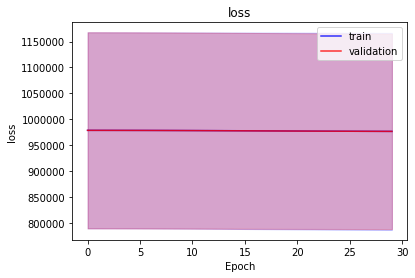

<b>bioma_loss</b>: 488011.3750 (min: 393041.2812, max: 582981.5000)

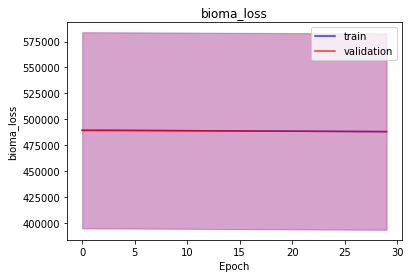

<b>domain_loss</b>: 488438.1875 (min: 393048.8438, max: 583827.5000)

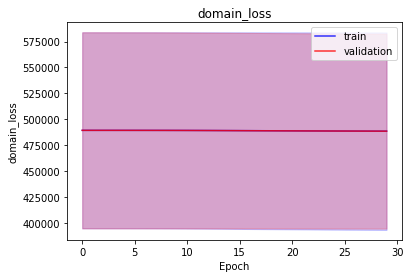

<b>latent_loss</b>: 0.6085 (min: 0.3713, max: 0.8457)

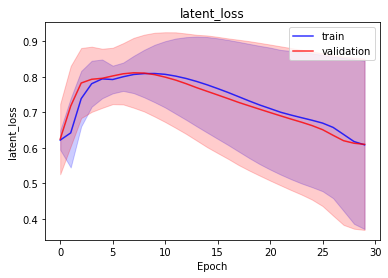

<b>bioma_mse</b>: 488011.3750 (min: 393041.2812, max: 582981.5000)

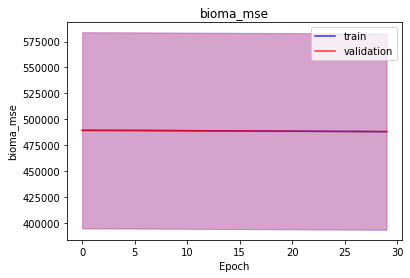

<b>bioma_mae</b>: 31.7068 (min: 31.6570, max: 31.7566)

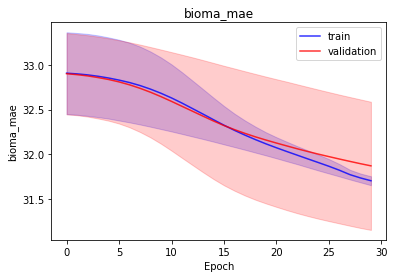

<b>bioma_mape</b>: 42.4256 (min: 41.7983, max: 43.0528)

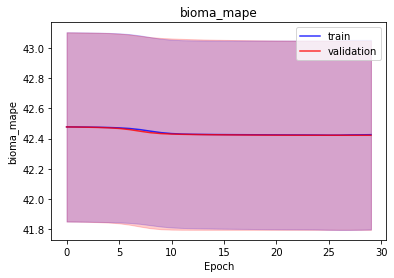

<b>domain_mse</b>: 488438.1875 (min: 393048.8438, max: 583827.5000)

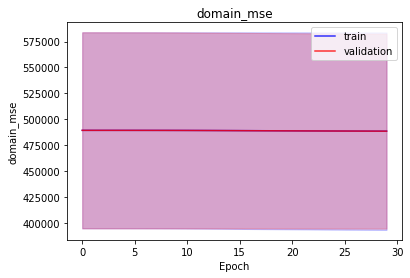

<b>domain_mae</b>: 31.8682 (min: 31.8603, max: 31.8762)

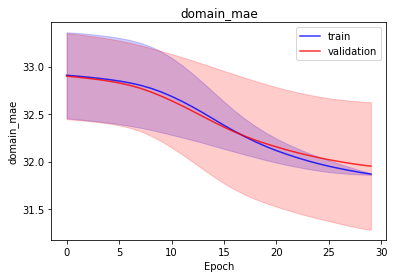

<b>domain_mape</b>: 42.4277 (min: 41.8068, max: 43.0486)

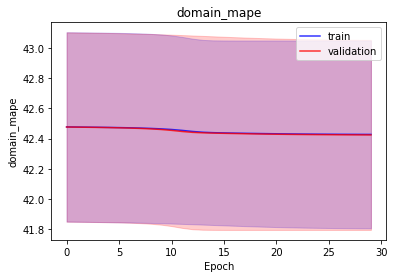

<b>latent_mae</b>: 0.6085 (min: 0.3713, max: 0.8457)

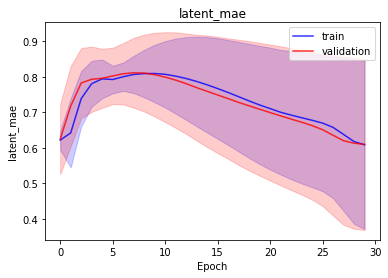

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 975173.9375 (min: 785520.6250, max: 1164827.2500)

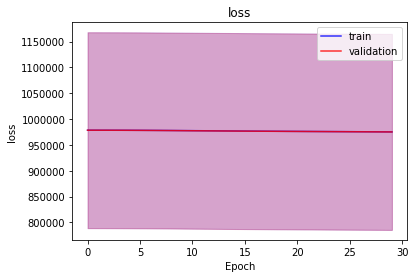

<b>bioma_loss</b>: 487584.9688 (min: 392758.8750, max: 582411.0625)

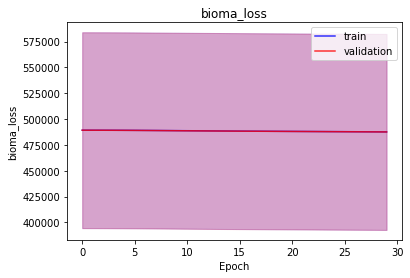

<b>domain_loss</b>: 487588.6875 (min: 392761.5312, max: 582415.8750)

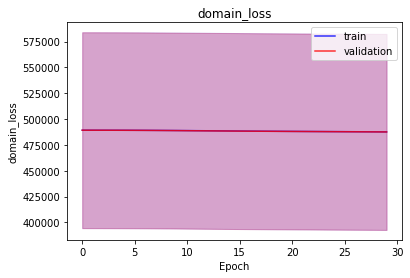

<b>latent_loss</b>: 0.2797 (min: 0.2540, max: 0.3054)

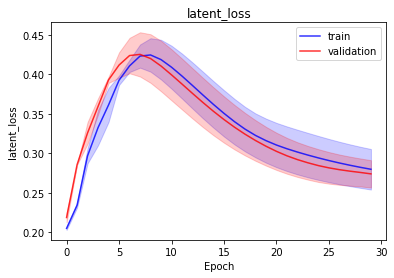

<b>bioma_mse</b>: 487584.9688 (min: 392758.8750, max: 582411.0625)

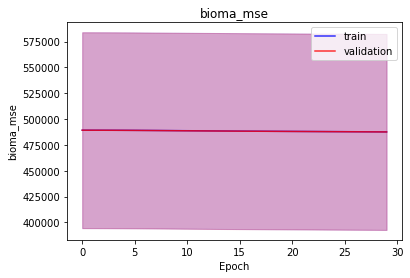

<b>bioma_mae</b>: 31.6431 (min: 31.4019, max: 31.8844)

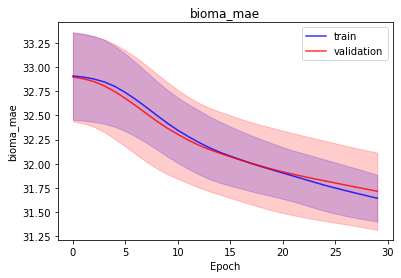

<b>bioma_mape</b>: 42.4245 (min: 41.7985, max: 43.0506)

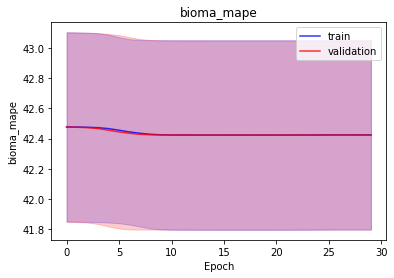

<b>domain_mse</b>: 487588.6875 (min: 392761.5312, max: 582415.8750)

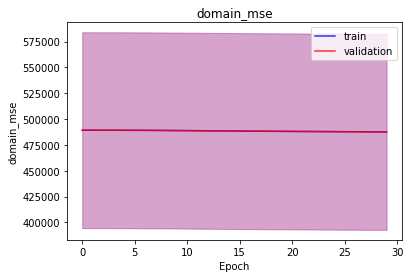

<b>domain_mae</b>: 31.7219 (min: 31.5185, max: 31.9253)

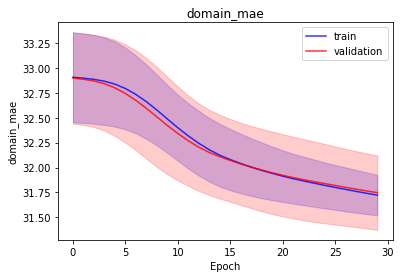

<b>domain_mape</b>: 42.4235 (min: 41.7965, max: 43.0506)

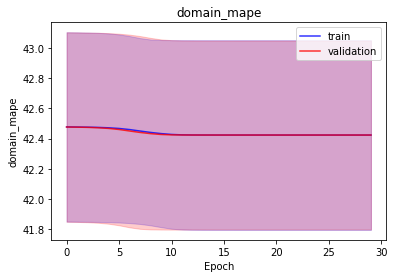

<b>latent_mae</b>: 0.2797 (min: 0.2540, max: 0.3054)

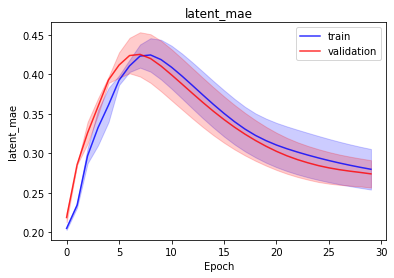

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 965403.0625 (min: 774332.0000, max: 1156474.1250)

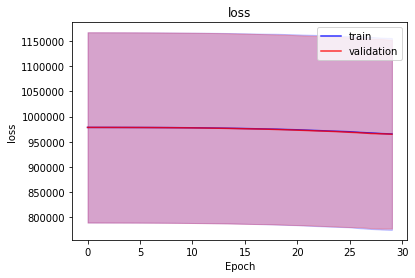

<b>bioma_loss</b>: 483181.0938 (min: 387803.5625, max: 578558.6250)

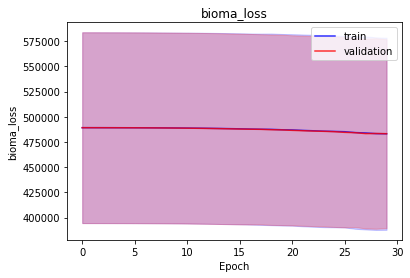

<b>domain_loss</b>: 482221.1250 (min: 386527.7188, max: 577914.5625)

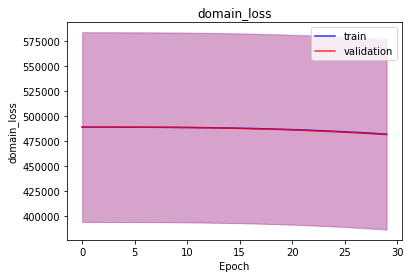

<b>latent_loss</b>: 0.7735 (min: 0.7206, max: 0.8263)

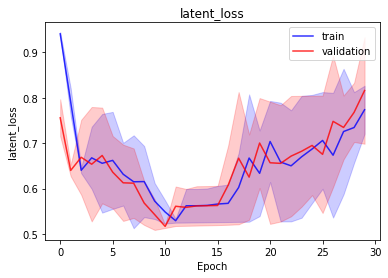

<b>bioma_mse</b>: 483181.0938 (min: 387803.5625, max: 578558.6250)

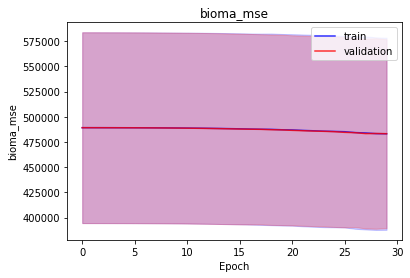

<b>bioma_mae</b>: 33.3329 (min: 33.1011, max: 33.5647)

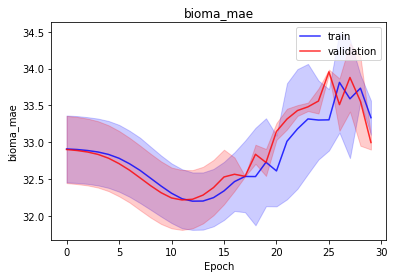

<b>bioma_mape</b>: 42.4248 (min: 41.8003, max: 43.0493)

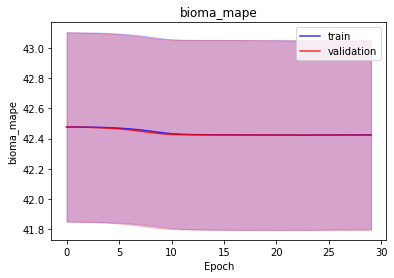

<b>domain_mse</b>: 482221.1250 (min: 386527.7188, max: 577914.5625)

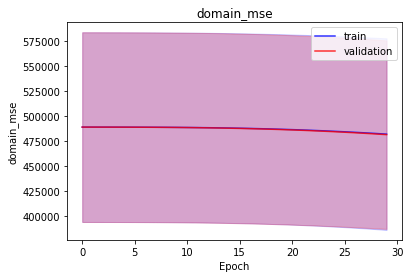

<b>domain_mae</b>: 35.4453 (min: 35.1776, max: 35.7131)

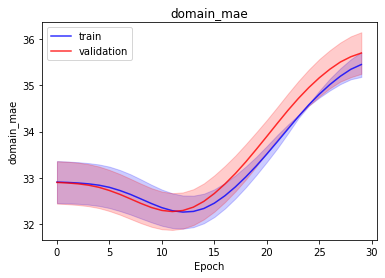

<b>domain_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

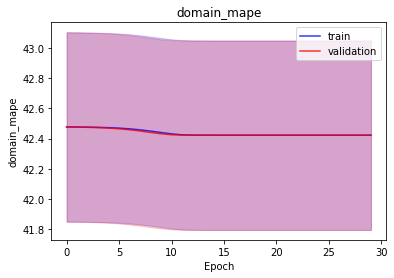

<b>latent_mae</b>: 0.7735 (min: 0.7206, max: 0.8263)

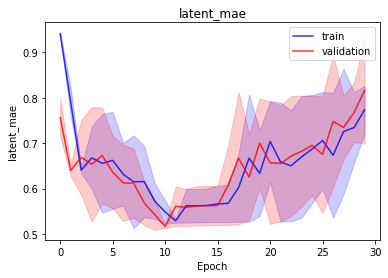

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 962696.6875 (min: 775932.7500, max: 1149460.6250)

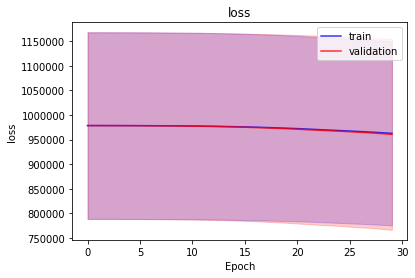

<b>bioma_loss</b>: 482806.3125 (min: 388437.7188, max: 577174.9375)

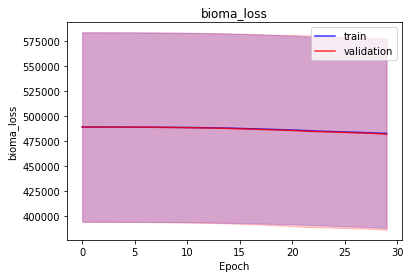

<b>domain_loss</b>: 479889.8750 (min: 387494.5312, max: 572285.1875)

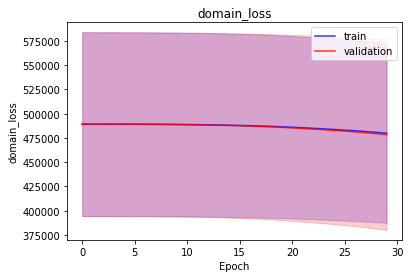

<b>latent_loss</b>: 0.5276 (min: 0.4978, max: 0.5574)

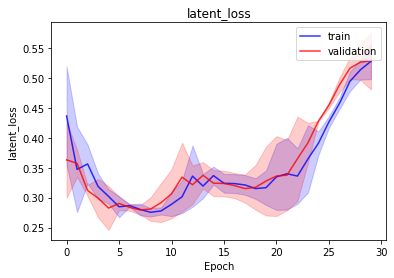

<b>bioma_mse</b>: 482806.3125 (min: 388437.7188, max: 577174.9375)

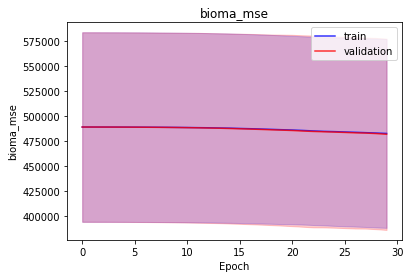

<b>bioma_mae</b>: 33.0562 (min: 32.0490, max: 34.0634)

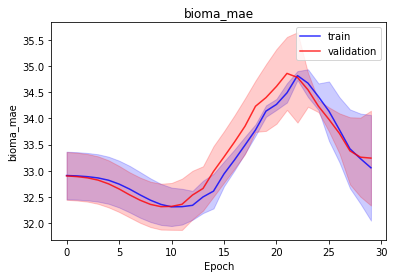

<b>bioma_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

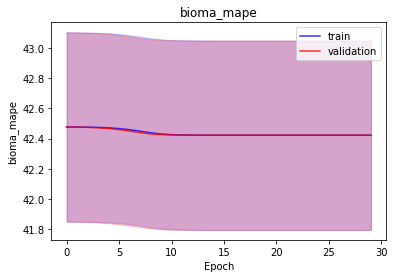

<b>domain_mse</b>: 479889.8750 (min: 387494.5312, max: 572285.1875)

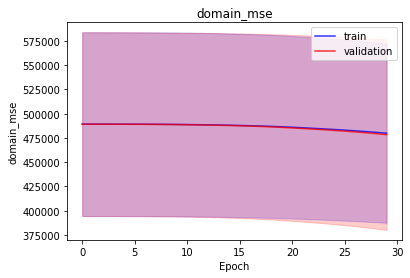

<b>domain_mae</b>: 37.0605 (min: 35.6172, max: 38.5039)

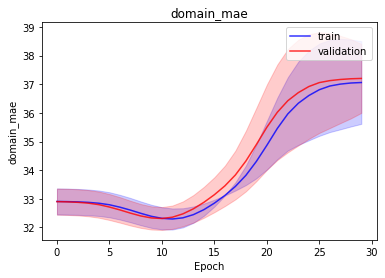

<b>domain_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

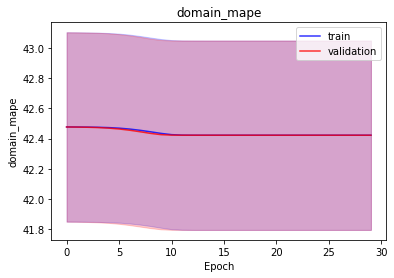

<b>latent_mae</b>: 0.5276 (min: 0.4978, max: 0.5574)

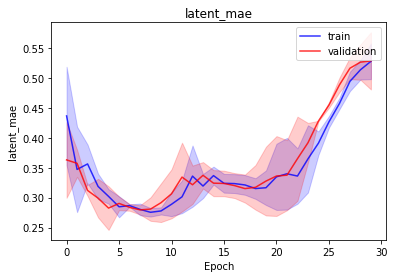

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976386.4688 (min: 785546.5625, max: 1167226.3750)

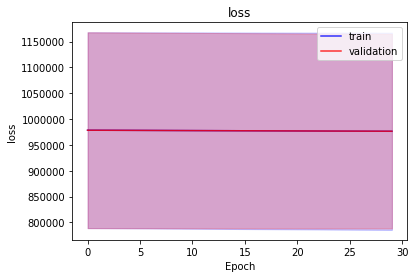

<b>bioma_loss</b>: 488193.1250 (min: 392773.0938, max: 583613.1875)

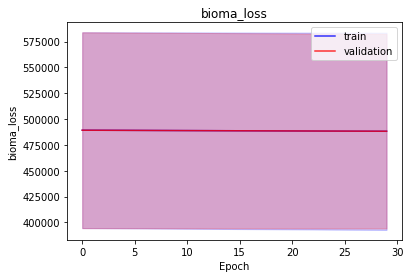

<b>domain_loss</b>: 488193.2500 (min: 392773.2812, max: 583613.1875)

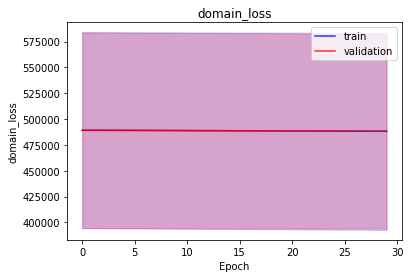

<b>latent_loss</b>: 0.0999 (min: 0.0420, max: 0.1579)

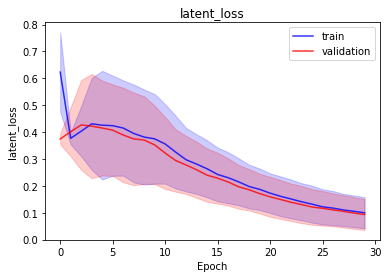

<b>bioma_mse</b>: 488193.1250 (min: 392773.0938, max: 583613.1875)

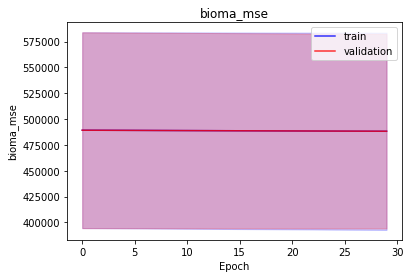

<b>bioma_mae</b>: 31.9779 (min: 31.8978, max: 32.0579)

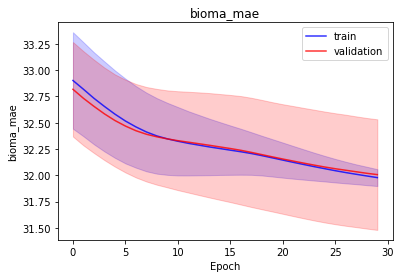

<b>bioma_mape</b>: 42.4257 (min: 41.8028, max: 43.0487)

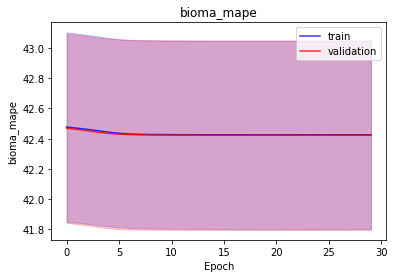

<b>domain_mse</b>: 488193.2500 (min: 392773.2812, max: 583613.1875)

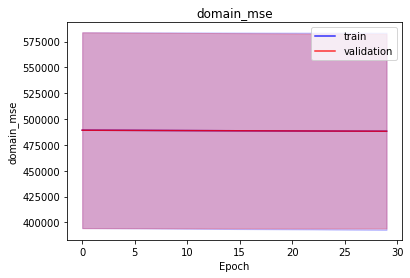

<b>domain_mae</b>: 31.9779 (min: 31.8978, max: 32.0580)

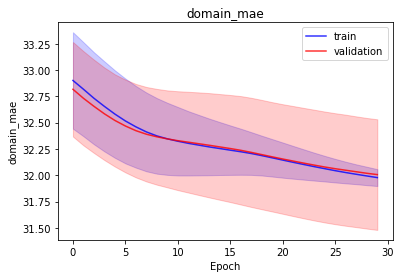

<b>domain_mape</b>: 42.4257 (min: 41.8028, max: 43.0487)

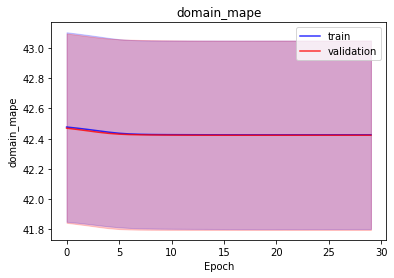

<b>latent_mae</b>: 0.0999 (min: 0.0420, max: 0.1579)

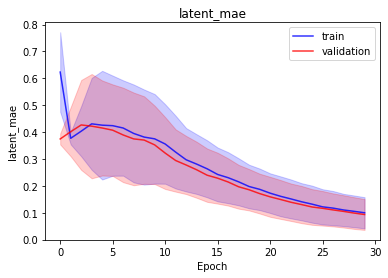

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 975878.5000 (min: 785269.1250, max: 1166487.8750)

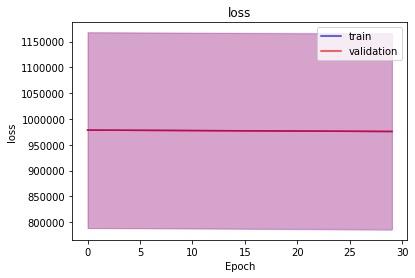

<b>bioma_loss</b>: 487938.9375 (min: 392634.0312, max: 583243.8125)

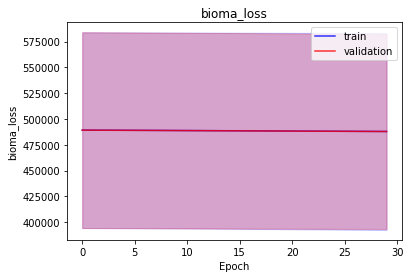

<b>domain_loss</b>: 487939.3750 (min: 392634.8438, max: 583243.9375)

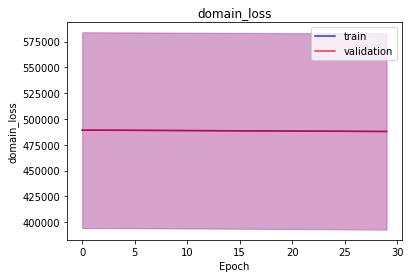

<b>latent_loss</b>: 0.2084 (min: 0.1719, max: 0.2449)

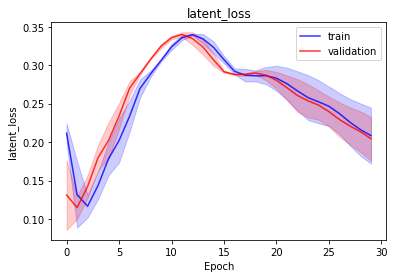

<b>bioma_mse</b>: 487938.9375 (min: 392634.0312, max: 583243.8125)

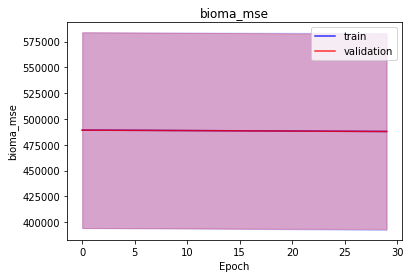

<b>bioma_mae</b>: 31.9582 (min: 31.8975, max: 32.0190)

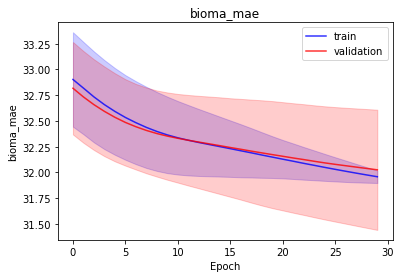

<b>bioma_mape</b>: 42.4246 (min: 41.7986, max: 43.0505)

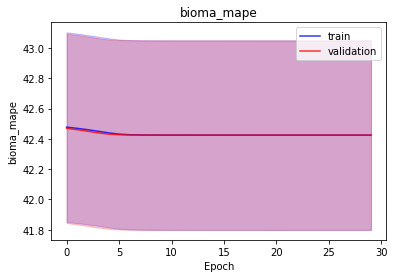

<b>domain_mse</b>: 487939.3750 (min: 392634.8438, max: 583243.9375)

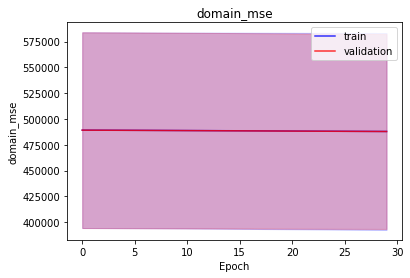

<b>domain_mae</b>: 31.9580 (min: 31.8975, max: 32.0186)

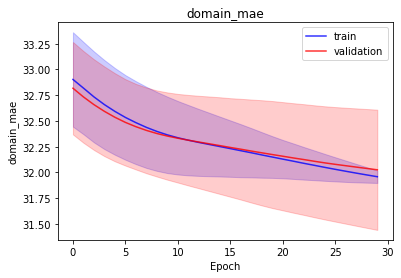

<b>domain_mape</b>: 42.4246 (min: 41.7986, max: 43.0505)

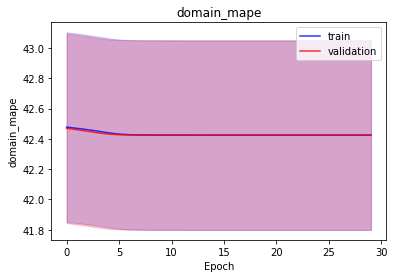

<b>latent_mae</b>: 0.2084 (min: 0.1719, max: 0.2449)

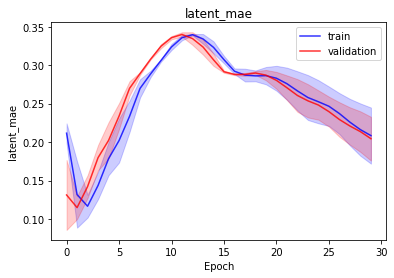

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976150.2188 (min: 786373.5625, max: 1165926.8750)

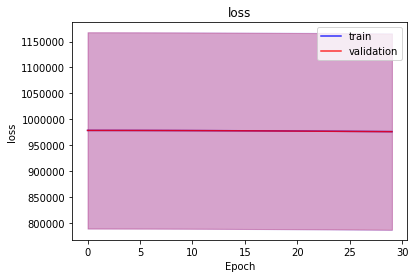

<b>bioma_loss</b>: 488045.5938 (min: 393173.3750, max: 582917.8125)

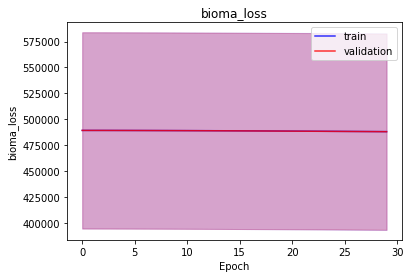

<b>domain_loss</b>: 488104.4062 (min: 393200.1250, max: 583008.6875)

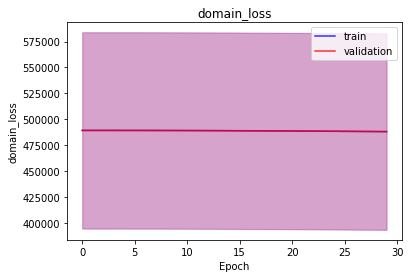

<b>latent_loss</b>: 0.2552 (min: 0.0752, max: 0.4352)

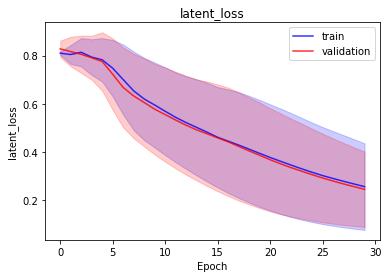

<b>bioma_mse</b>: 488045.5938 (min: 393173.3750, max: 582917.8125)

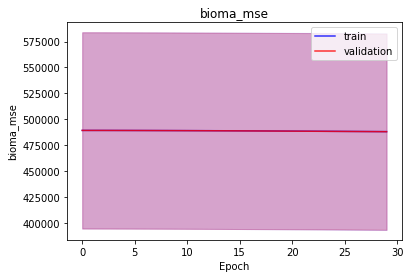

<b>bioma_mae</b>: 31.5643 (min: 31.2672, max: 31.8614)

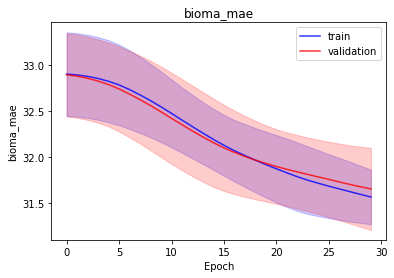

<b>bioma_mape</b>: 42.4265 (min: 41.8016, max: 43.0514)

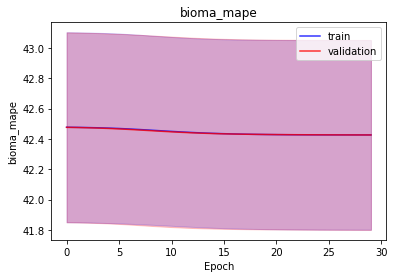

<b>domain_mse</b>: 488104.4062 (min: 393200.1250, max: 583008.6875)

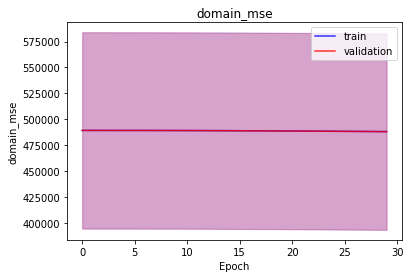

<b>domain_mae</b>: 31.7858 (min: 31.5974, max: 31.9742)

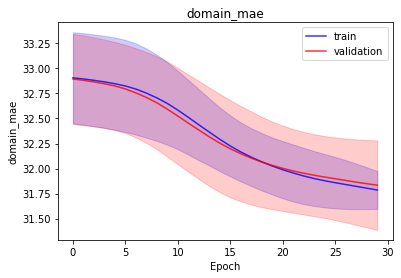

<b>domain_mape</b>: 42.4246 (min: 41.8002, max: 43.0491)

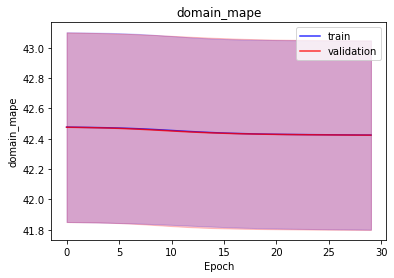

<b>latent_mae</b>: 0.2552 (min: 0.0752, max: 0.4352)

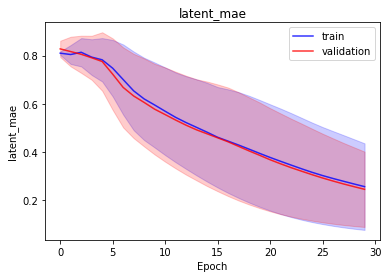

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976332.3750 (min: 786468.5000, max: 1166196.2500)

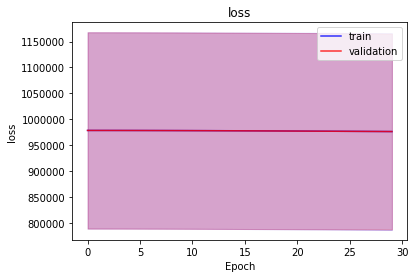

<b>bioma_loss</b>: 488135.7500 (min: 393204.8750, max: 583066.6250)

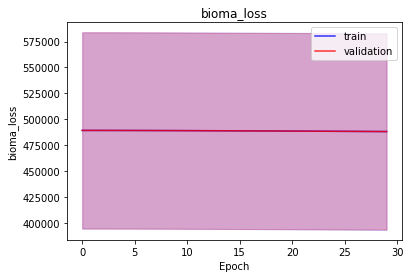

<b>domain_loss</b>: 488196.4375 (min: 393263.5312, max: 583129.3750)

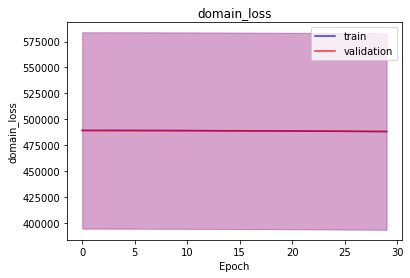

<b>latent_loss</b>: 0.1576 (min: 0.1250, max: 0.1901)

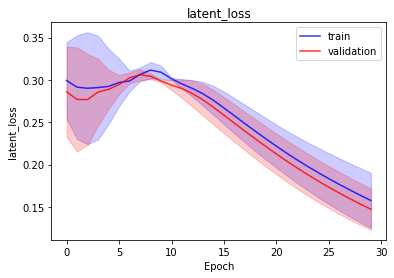

<b>bioma_mse</b>: 488135.7500 (min: 393204.8750, max: 583066.6250)

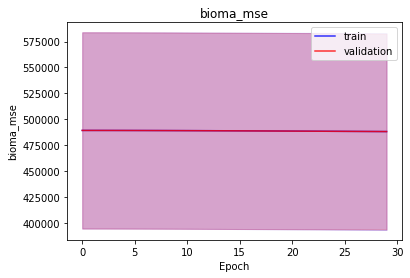

<b>bioma_mae</b>: 31.8445 (min: 31.6616, max: 32.0274)

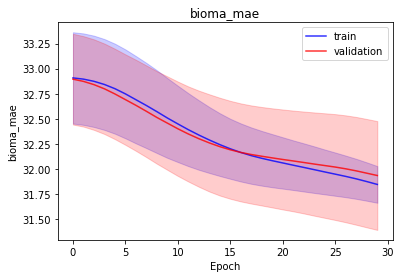

<b>bioma_mape</b>: 42.4256 (min: 41.8010, max: 43.0502)

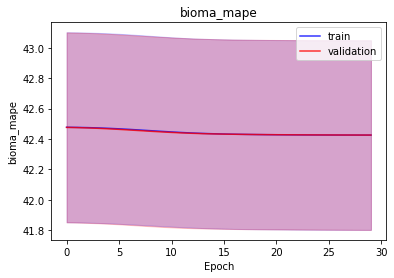

<b>domain_mse</b>: 488196.4375 (min: 393263.5312, max: 583129.3750)

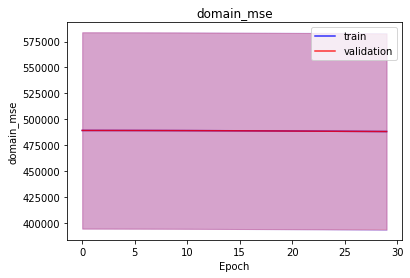

<b>domain_mae</b>: 31.8697 (min: 31.7098, max: 32.0297)

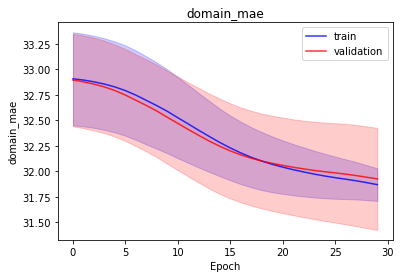

<b>domain_mape</b>: 42.4242 (min: 41.7984, max: 43.0500)

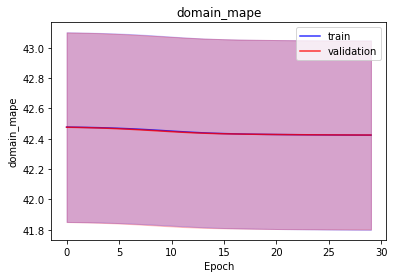

<b>latent_mae</b>: 0.1576 (min: 0.1250, max: 0.1901)

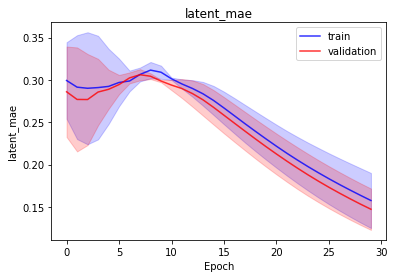

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976190.7812 (min: 786792.0625, max: 1165589.5000)

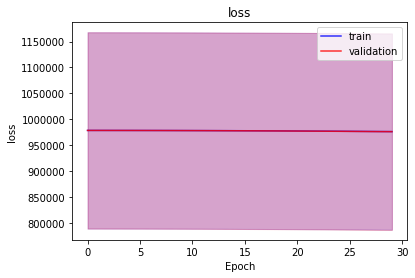

<b>bioma_loss</b>: 488154.3125 (min: 393382.6250, max: 582926.0000)

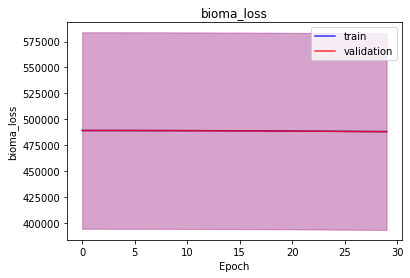

<b>domain_loss</b>: 488036.0000 (min: 393408.7188, max: 582663.2500)

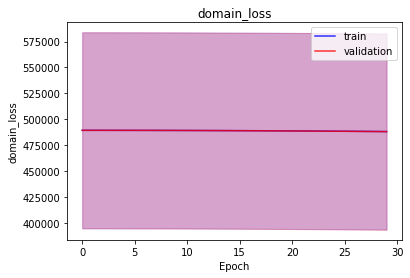

<b>latent_loss</b>: 0.4773 (min: 0.2519, max: 0.7028)

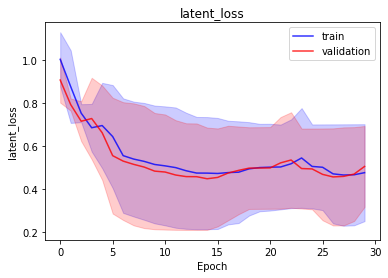

<b>bioma_mse</b>: 488154.3125 (min: 393382.6250, max: 582926.0000)

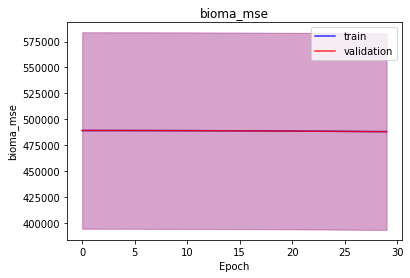

<b>bioma_mae</b>: 31.6282 (min: 31.2136, max: 32.0428)

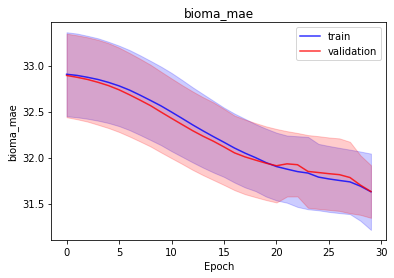

<b>bioma_mape</b>: 42.4269 (min: 41.8046, max: 43.0492)

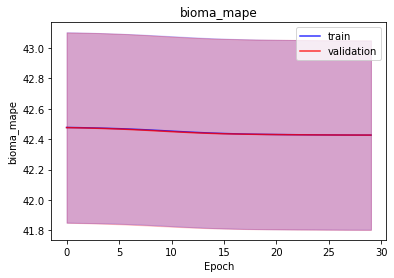

<b>domain_mse</b>: 488036.0000 (min: 393408.7188, max: 582663.2500)

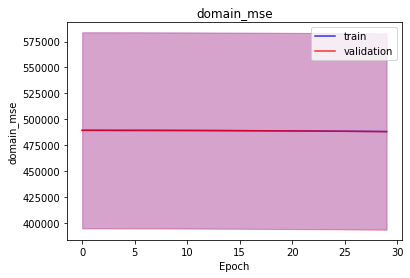

<b>domain_mae</b>: 32.1014 (min: 32.0128, max: 32.1900)

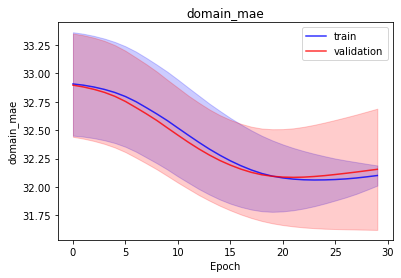

<b>domain_mape</b>: 42.4257 (min: 41.8024, max: 43.0491)

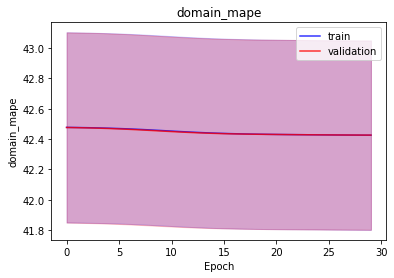

<b>latent_mae</b>: 0.4773 (min: 0.2519, max: 0.7028)

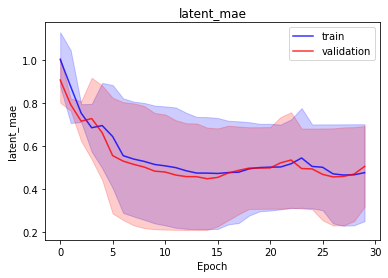

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976403.8438 (min: 787256.5625, max: 1165551.1250)

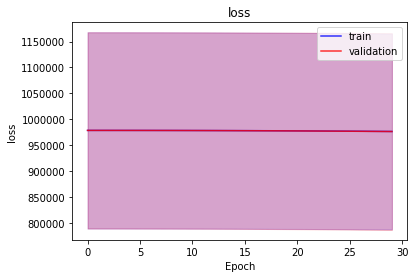

<b>bioma_loss</b>: 488162.0000 (min: 393659.3750, max: 582664.6250)

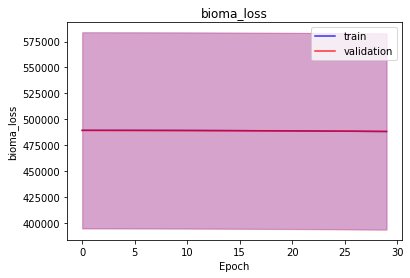

<b>domain_loss</b>: 488241.5625 (min: 393596.8438, max: 582886.2500)

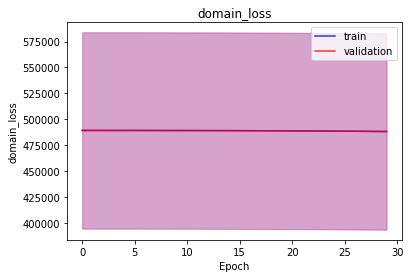

<b>latent_loss</b>: 0.2598 (min: 0.2348, max: 0.2848)

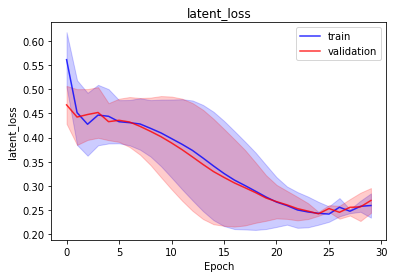

<b>bioma_mse</b>: 488162.0000 (min: 393659.3750, max: 582664.6250)

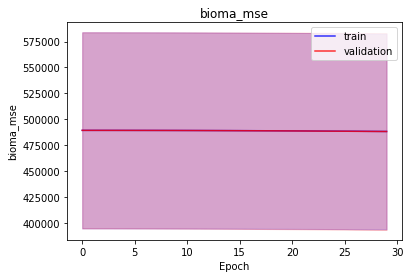

<b>bioma_mae</b>: 32.0726 (min: 31.8753, max: 32.2698)

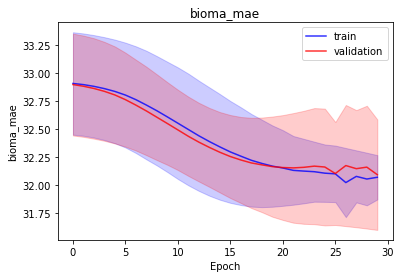

<b>bioma_mape</b>: 42.4277 (min: 41.8038, max: 43.0515)

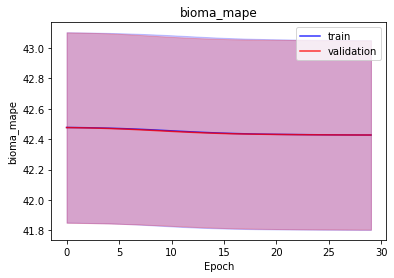

<b>domain_mse</b>: 488241.5625 (min: 393596.8438, max: 582886.2500)

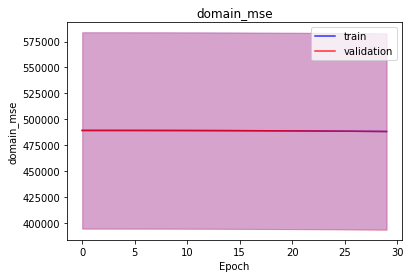

<b>domain_mae</b>: 32.0690 (min: 31.7190, max: 32.4190)

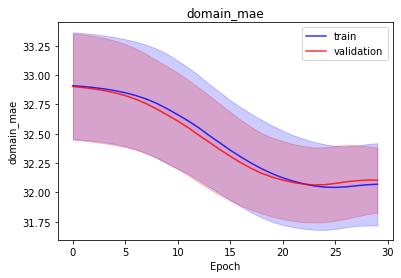

<b>domain_mape</b>: 42.4270 (min: 41.8028, max: 43.0513)

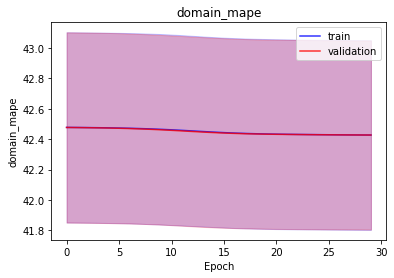

<b>latent_mae</b>: 0.2598 (min: 0.2348, max: 0.2848)

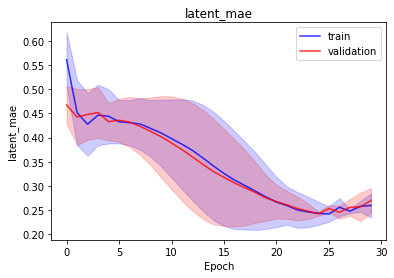

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976799.5312 (min: 787739.4375, max: 1165859.6250)

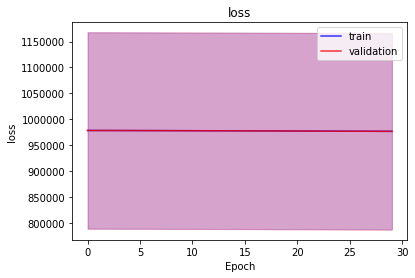

<b>bioma_loss</b>: 488393.3125 (min: 393867.1250, max: 582919.5000)

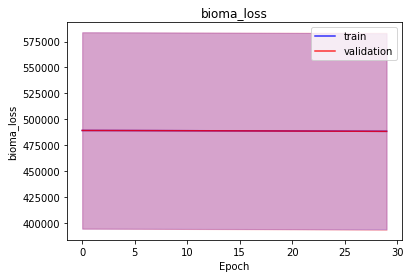

<b>domain_loss</b>: 488406.1562 (min: 393872.2500, max: 582940.0625)

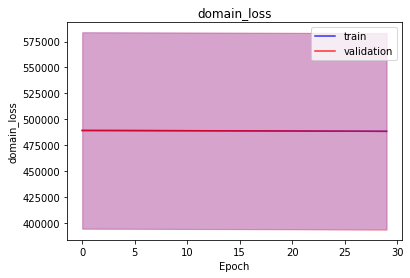

<b>latent_loss</b>: 0.0656 (min: 0.0407, max: 0.0905)

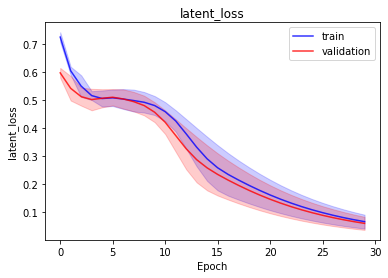

<b>bioma_mse</b>: 488393.3125 (min: 393867.1250, max: 582919.5000)

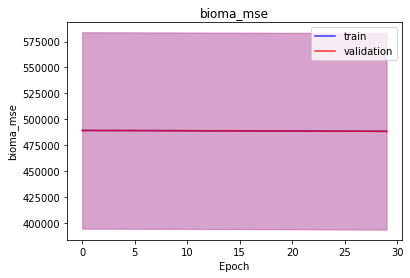

<b>bioma_mae</b>: 32.2424 (min: 31.9292, max: 32.5557)

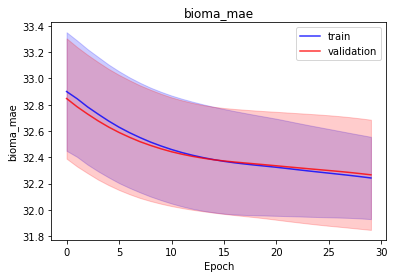

<b>bioma_mape</b>: 42.4259 (min: 41.8028, max: 43.0491)

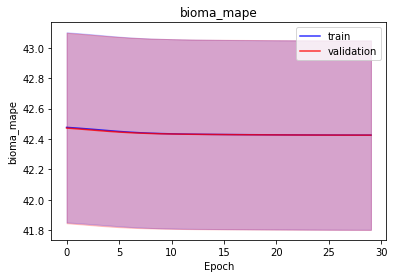

<b>domain_mse</b>: 488406.1562 (min: 393872.2500, max: 582940.0625)

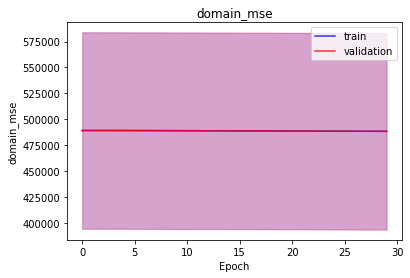

<b>domain_mae</b>: 32.2295 (min: 31.9093, max: 32.5497)

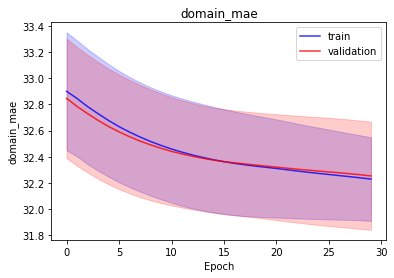

<b>domain_mape</b>: 42.4260 (min: 41.8028, max: 43.0491)

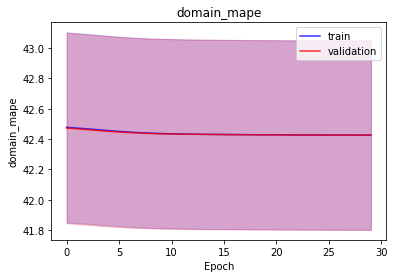

<b>latent_mae</b>: 0.0656 (min: 0.0407, max: 0.0905)

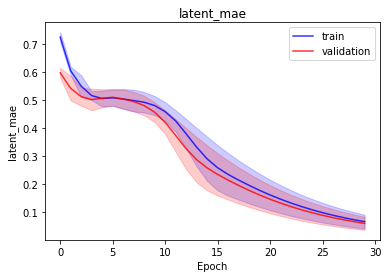

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977094.5000 (min: 787447.3750, max: 1166741.6250)

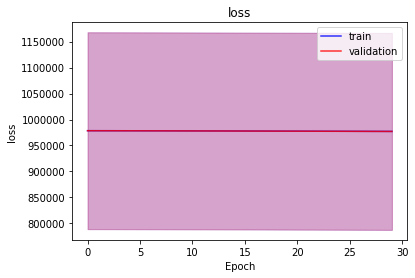

<b>bioma_loss</b>: 488522.5000 (min: 393696.1875, max: 583348.8125)

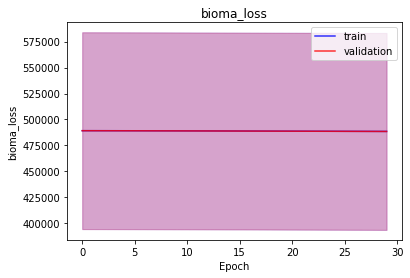

<b>domain_loss</b>: 488571.7188 (min: 393750.8750, max: 583392.5625)

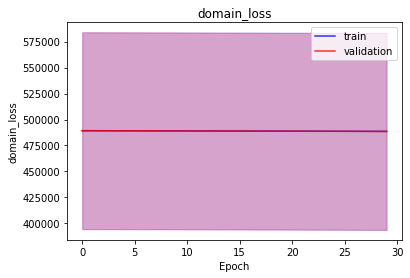

<b>latent_loss</b>: 0.3113 (min: 0.3081, max: 0.3144)

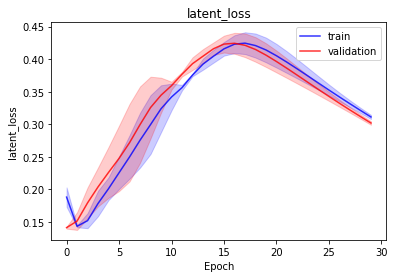

<b>bioma_mse</b>: 488522.5000 (min: 393696.1875, max: 583348.8125)

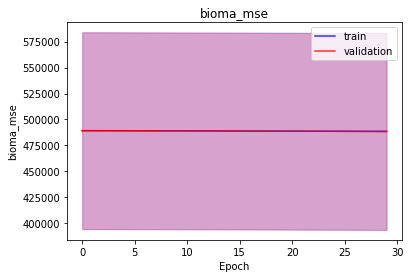

<b>bioma_mae</b>: 32.2178 (min: 31.8289, max: 32.6067)

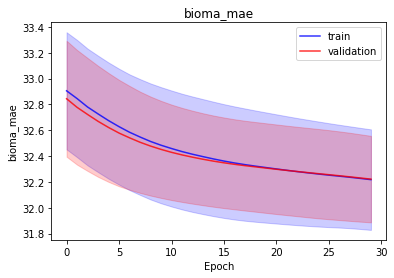

<b>bioma_mape</b>: 42.4261 (min: 41.8030, max: 43.0491)

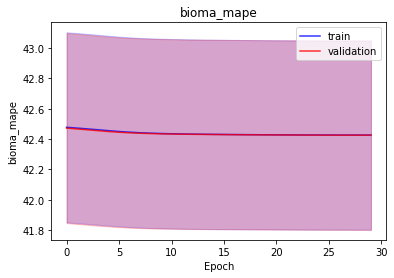

<b>domain_mse</b>: 488571.7188 (min: 393750.8750, max: 583392.5625)

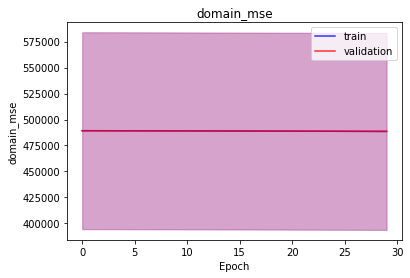

<b>domain_mae</b>: 32.1594 (min: 31.7601, max: 32.5588)

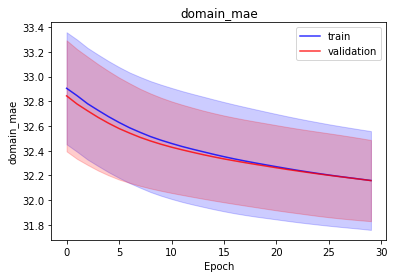

<b>domain_mape</b>: 42.4261 (min: 41.8031, max: 43.0491)

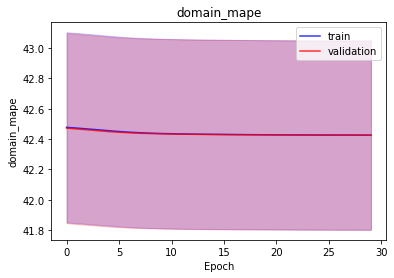

<b>latent_mae</b>: 0.3113 (min: 0.3081, max: 0.3144)

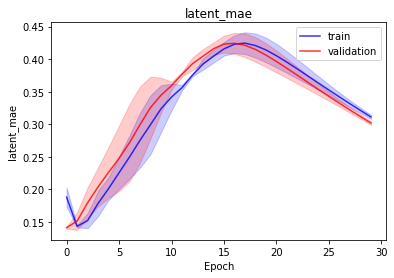

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978349.2500 (min: 788815.6250, max: 1167882.8750)

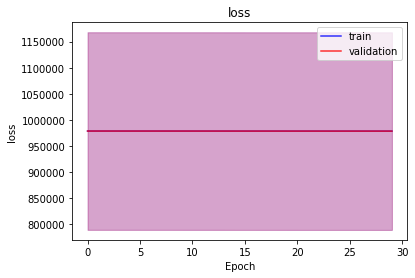

<b>bioma_loss</b>: 489180.4375 (min: 394410.5938, max: 583950.2500)

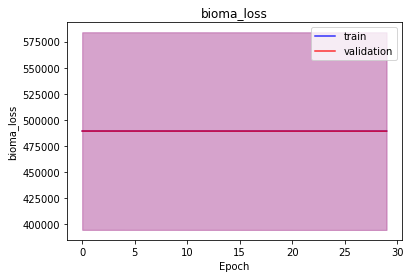

<b>domain_loss</b>: 489168.2500 (min: 394404.5312, max: 583931.9375)

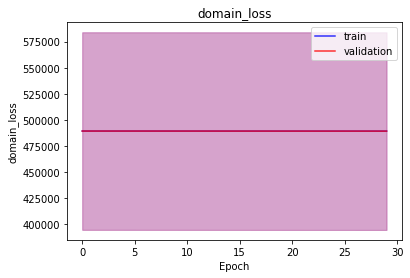

<b>latent_loss</b>: 0.5641 (min: 0.5049, max: 0.6233)

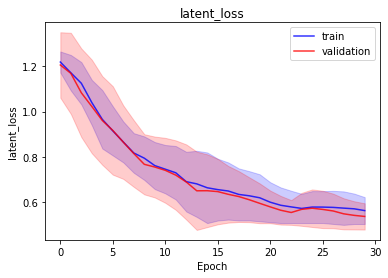

<b>bioma_mse</b>: 489180.4375 (min: 394410.5938, max: 583950.2500)

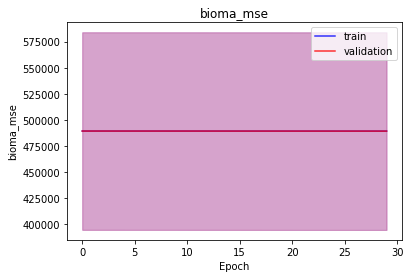

<b>bioma_mae</b>: 32.6554 (min: 32.2292, max: 33.0816)

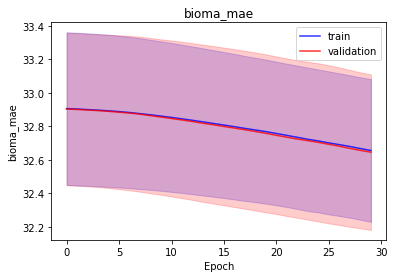

<b>bioma_mape</b>: 42.4630 (min: 41.8389, max: 43.0870)

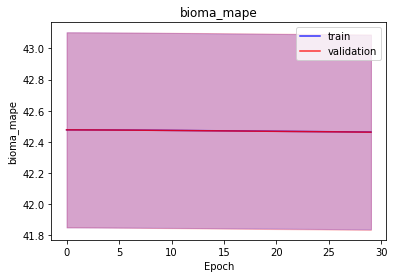

<b>domain_mse</b>: 489168.2500 (min: 394404.5312, max: 583931.9375)

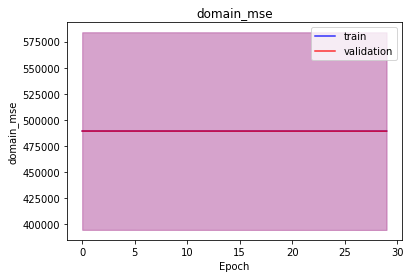

<b>domain_mae</b>: 32.6616 (min: 32.2526, max: 33.0706)

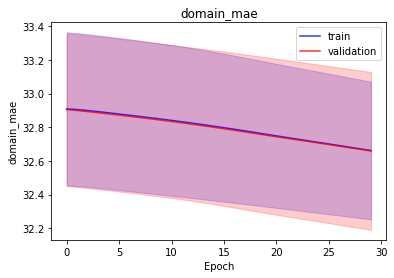

<b>domain_mape</b>: 42.4594 (min: 41.8354, max: 43.0835)

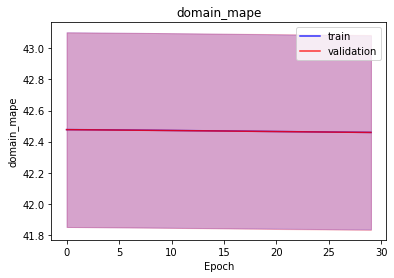

<b>latent_mae</b>: 0.5641 (min: 0.5049, max: 0.6233)

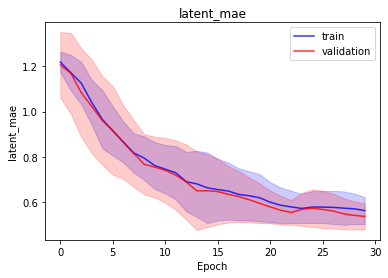

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978349.6562 (min: 788845.3125, max: 1167854.0000)

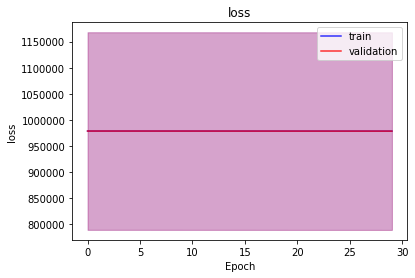

<b>bioma_loss</b>: 489164.6250 (min: 394412.0938, max: 583917.1875)

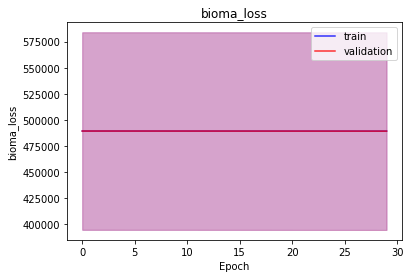

<b>domain_loss</b>: 489184.7500 (min: 394432.8438, max: 583936.6250)

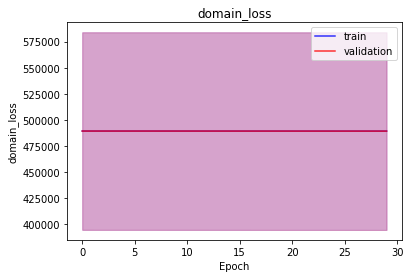

<b>latent_loss</b>: 0.3315 (min: 0.2695, max: 0.3935)

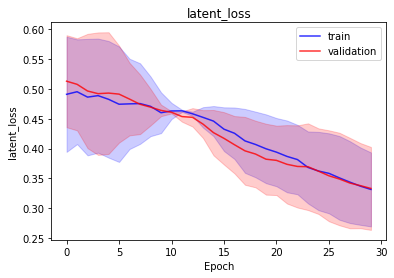

<b>bioma_mse</b>: 489164.6250 (min: 394412.0938, max: 583917.1875)

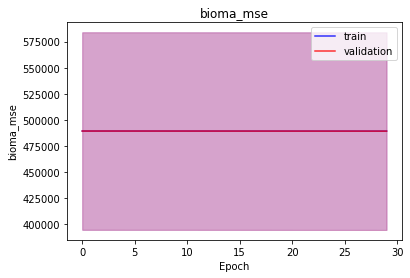

<b>bioma_mae</b>: 32.5569 (min: 32.1336, max: 32.9802)

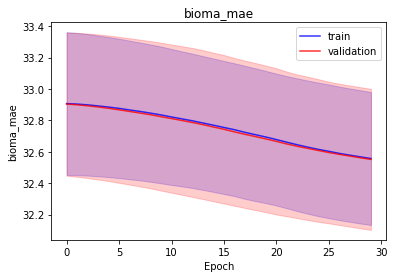

<b>bioma_mape</b>: 42.4565 (min: 41.8329, max: 43.0802)

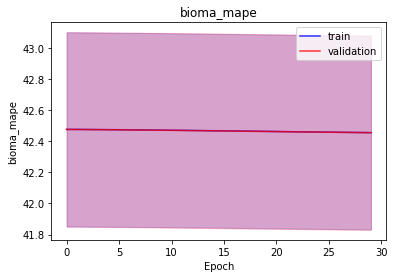

<b>domain_mse</b>: 489184.7500 (min: 394432.8438, max: 583936.6250)

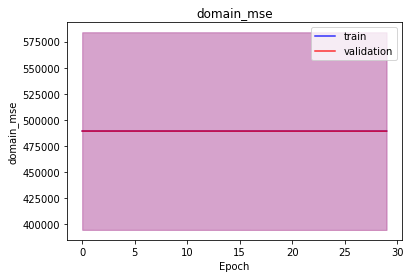

<b>domain_mae</b>: 32.6660 (min: 32.2198, max: 33.1122)

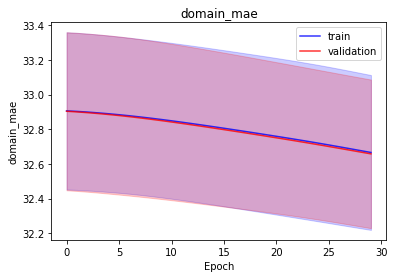

<b>domain_mape</b>: 42.4621 (min: 41.8366, max: 43.0876)

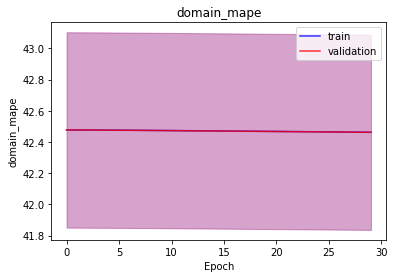

<b>latent_mae</b>: 0.3315 (min: 0.2695, max: 0.3935)

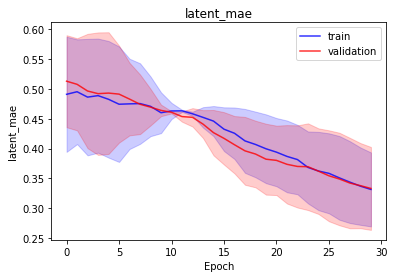

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978345.1562 (min: 788807.5625, max: 1167882.7500)

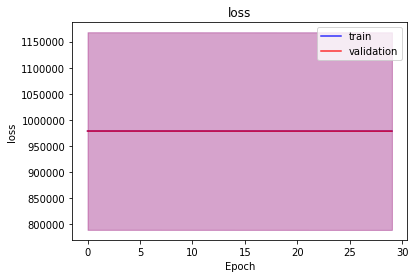

<b>bioma_loss</b>: 489172.5000 (min: 394410.1875, max: 583934.8125)

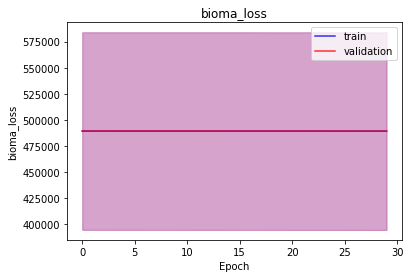

<b>domain_loss</b>: 489172.0938 (min: 394396.8125, max: 583947.3750)

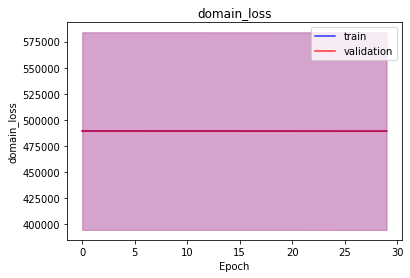

<b>latent_loss</b>: 0.5059 (min: 0.4629, max: 0.5489)

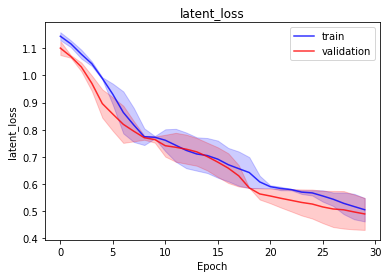

<b>bioma_mse</b>: 489172.5000 (min: 394410.1875, max: 583934.8125)

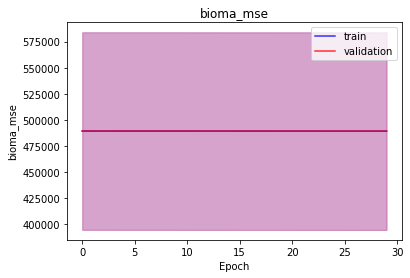

<b>bioma_mae</b>: 32.6228 (min: 32.1903, max: 33.0554)

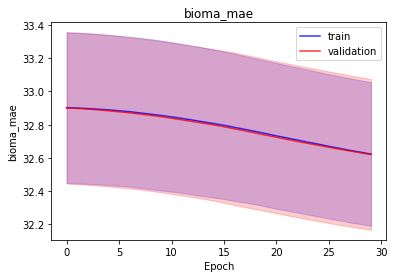

<b>bioma_mape</b>: 42.4612 (min: 41.8370, max: 43.0854)

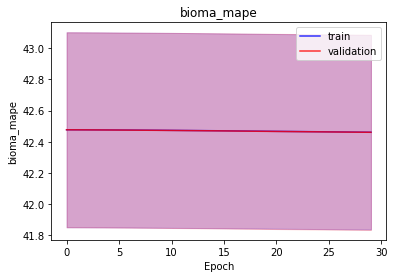

<b>domain_mse</b>: 489172.0938 (min: 394396.8125, max: 583947.3750)

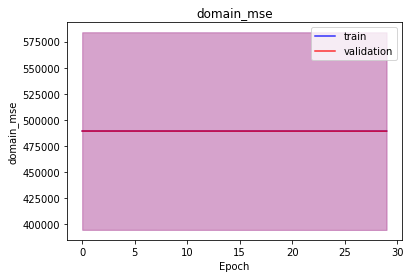

<b>domain_mae</b>: 32.6547 (min: 32.2218, max: 33.0875)

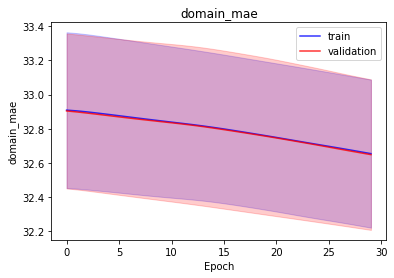

<b>domain_mape</b>: 42.4596 (min: 41.8359, max: 43.0834)

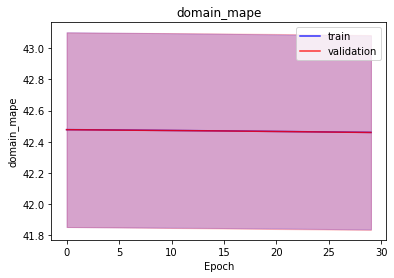

<b>latent_mae</b>: 0.5059 (min: 0.4629, max: 0.5489)

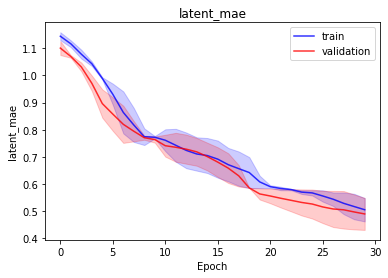

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978318.6562 (min: 788814.0625, max: 1167823.2500)

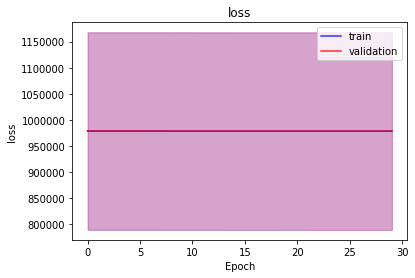

<b>bioma_loss</b>: 489150.6250 (min: 394389.2812, max: 583911.9375)

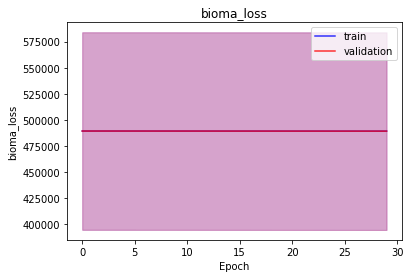

<b>domain_loss</b>: 489167.8125 (min: 394424.4062, max: 583911.1875)

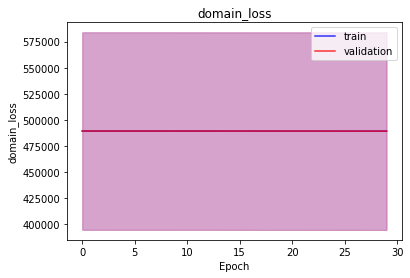

<b>latent_loss</b>: 0.2329 (min: 0.0684, max: 0.3975)

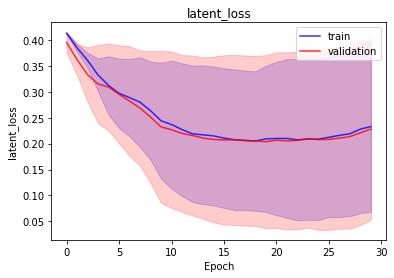

<b>bioma_mse</b>: 489150.6250 (min: 394389.2812, max: 583911.9375)

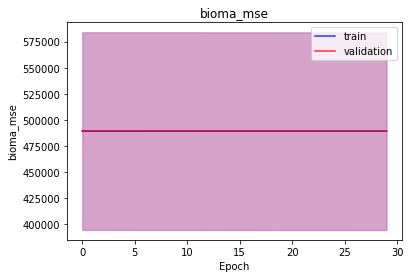

<b>bioma_mae</b>: 32.5661 (min: 32.1252, max: 33.0070)

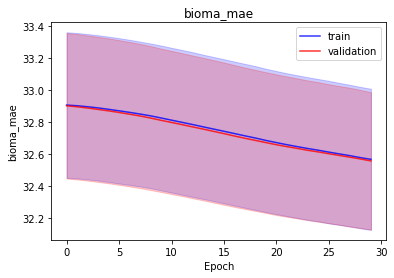

<b>bioma_mape</b>: 42.4560 (min: 41.8310, max: 43.0809)

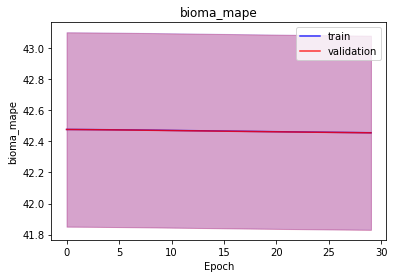

<b>domain_mse</b>: 489167.8125 (min: 394424.4062, max: 583911.1875)

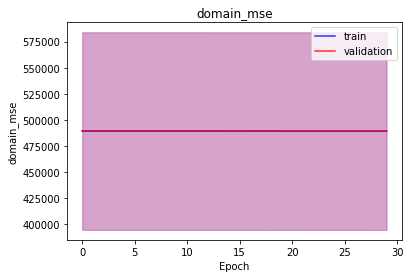

<b>domain_mae</b>: 32.6461 (min: 32.1541, max: 33.1381)

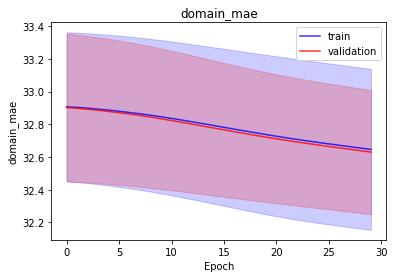

<b>domain_mape</b>: 42.4601 (min: 41.8313, max: 43.0889)

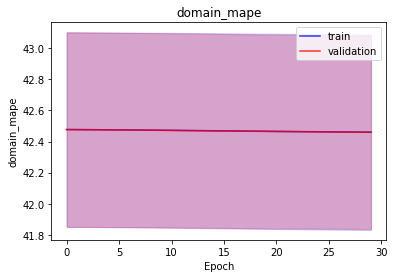

<b>latent_mae</b>: 0.2329 (min: 0.0684, max: 0.3975)

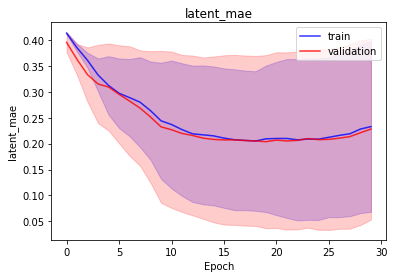

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978333.2188 (min: 788795.1875, max: 1167871.2500)

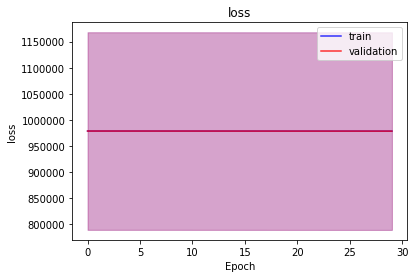

<b>bioma_loss</b>: 489167.2500 (min: 394403.2500, max: 583931.2500)

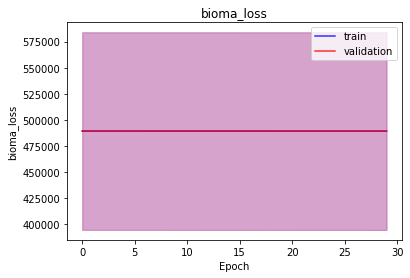

<b>domain_loss</b>: 489165.5625 (min: 394391.7188, max: 583939.4375)

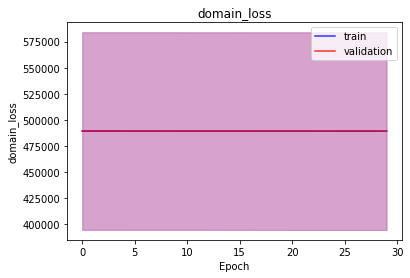

<b>latent_loss</b>: 0.3725 (min: 0.1853, max: 0.5597)

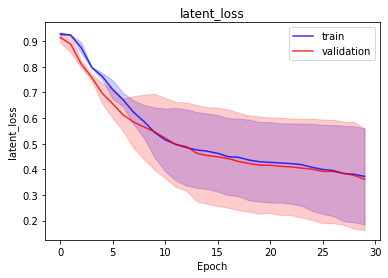

<b>bioma_mse</b>: 489167.2500 (min: 394403.2500, max: 583931.2500)

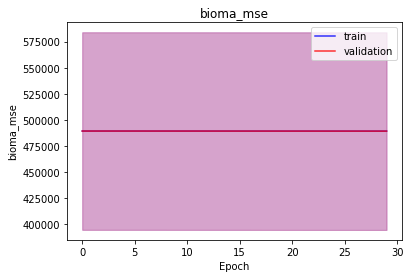

<b>bioma_mae</b>: 32.5904 (min: 32.1874, max: 32.9933)

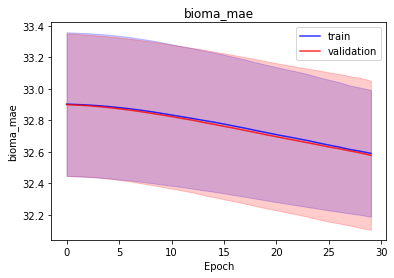

<b>bioma_mape</b>: 42.4593 (min: 41.8361, max: 43.0825)

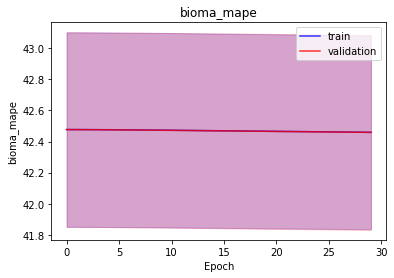

<b>domain_mse</b>: 489165.5625 (min: 394391.7188, max: 583939.4375)

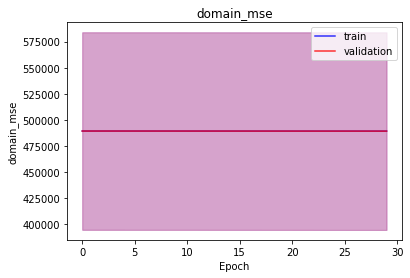

<b>domain_mae</b>: 32.5936 (min: 32.1890, max: 32.9982)

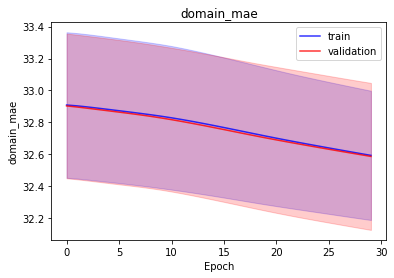

<b>domain_mape</b>: 42.4568 (min: 41.8332, max: 43.0805)

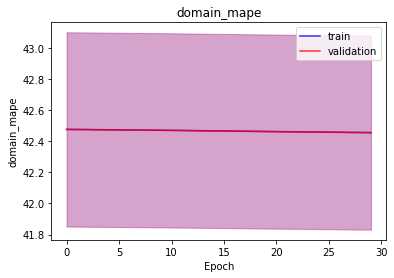

<b>latent_mae</b>: 0.3725 (min: 0.1853, max: 0.5597)

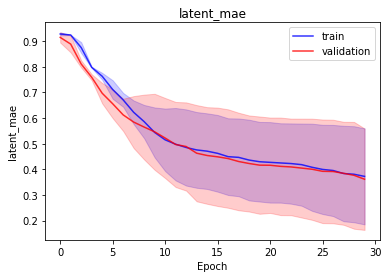

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978340.7812 (min: 788835.1875, max: 1167846.3750)

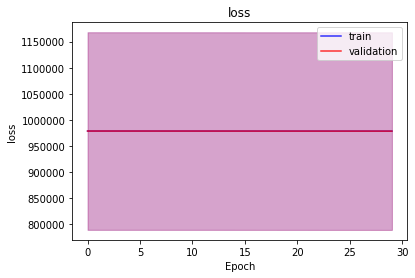

<b>bioma_loss</b>: 489155.6875 (min: 394401.2812, max: 583910.1250)

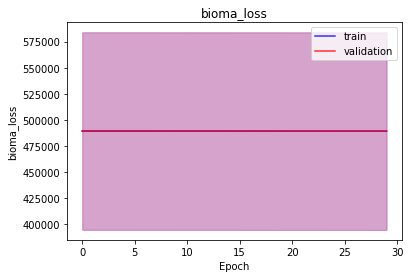

<b>domain_loss</b>: 489184.5938 (min: 394433.3125, max: 583935.8750)

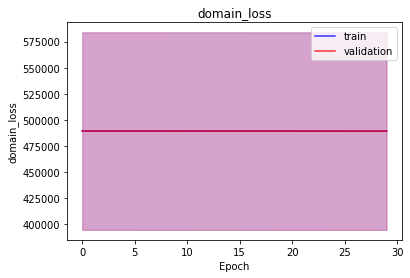

<b>latent_loss</b>: 0.4856 (min: 0.3945, max: 0.5767)

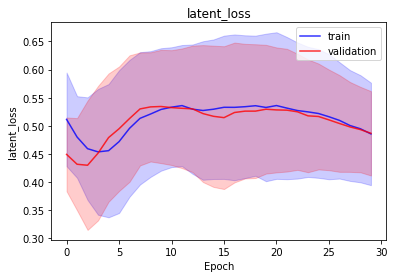

<b>bioma_mse</b>: 489155.6875 (min: 394401.2812, max: 583910.1250)

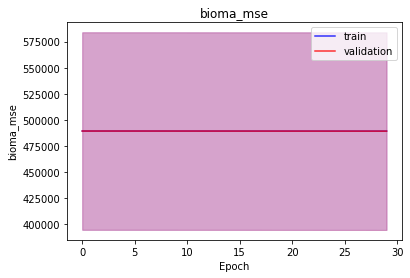

<b>bioma_mae</b>: 32.5502 (min: 32.0974, max: 33.0030)

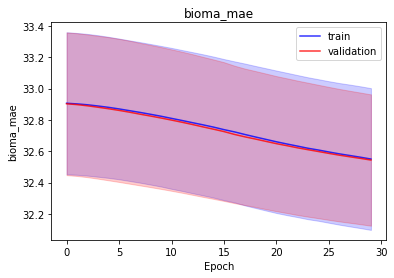

<b>bioma_mape</b>: 42.4558 (min: 41.8304, max: 43.0812)

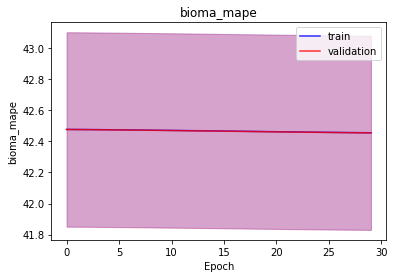

<b>domain_mse</b>: 489184.5938 (min: 394433.3125, max: 583935.8750)

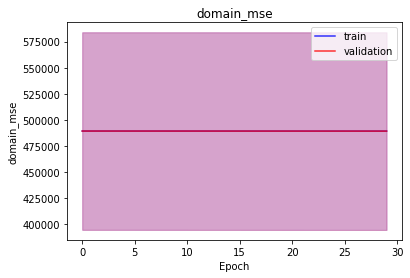

<b>domain_mae</b>: 32.6763 (min: 32.2147, max: 33.1379)

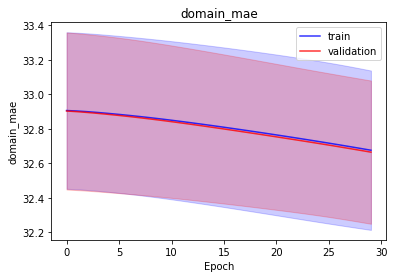

<b>domain_mape</b>: 42.4624 (min: 41.8358, max: 43.0890)

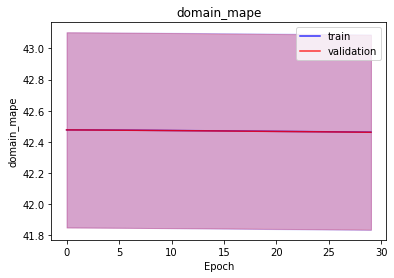

<b>latent_mae</b>: 0.4856 (min: 0.3945, max: 0.5767)

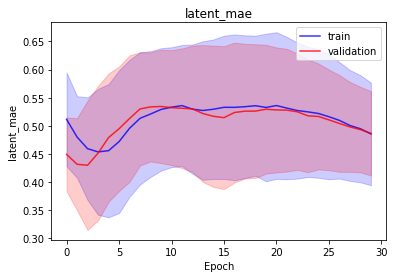

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 970715.9375 (min: 780914.1250, max: 1160517.7500)

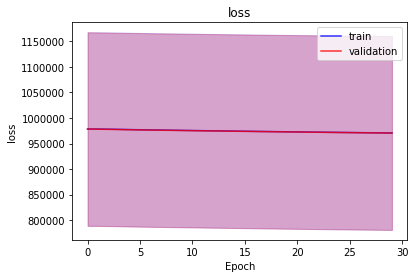

<b>bioma_loss</b>: 485350.5625 (min: 390452.2812, max: 580248.8125)

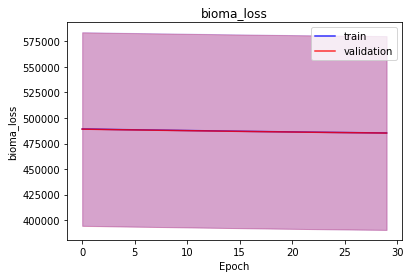

<b>domain_loss</b>: 485365.0000 (min: 390461.4688, max: 580268.5625)

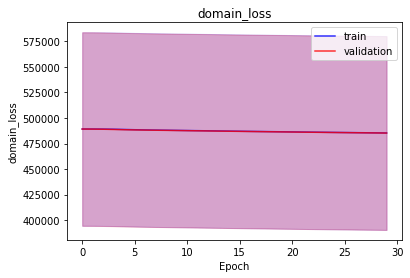

<b>latent_loss</b>: 0.3970 (min: 0.3608, max: 0.4332)

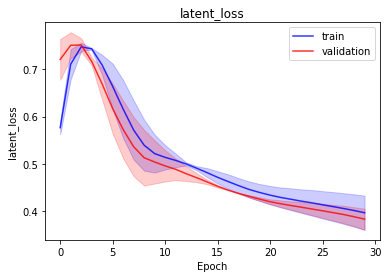

<b>bioma_mse</b>: 485350.5625 (min: 390452.2812, max: 580248.8125)

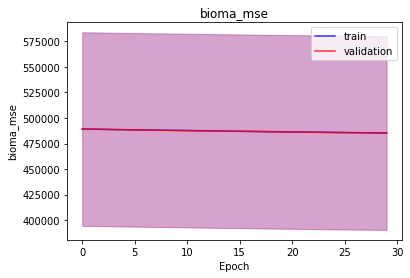

<b>bioma_mae</b>: 31.2046 (min: 31.1726, max: 31.2367)

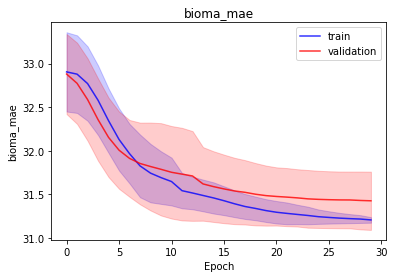

<b>bioma_mape</b>: 42.4267 (min: 41.8006, max: 43.0528)

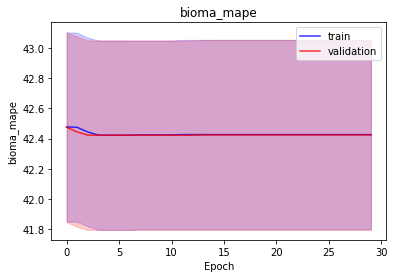

<b>domain_mse</b>: 485365.0000 (min: 390461.4688, max: 580268.5625)

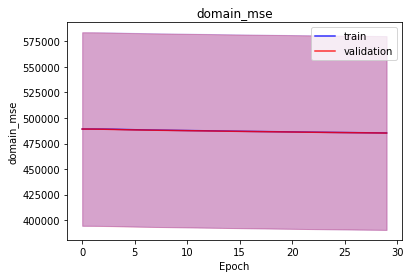

<b>domain_mae</b>: 31.5434 (min: 31.4431, max: 31.6438)

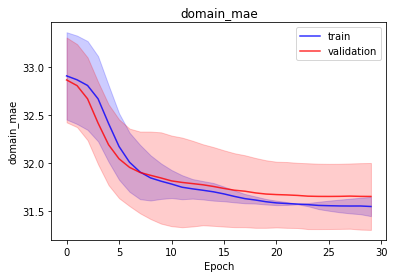

<b>domain_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

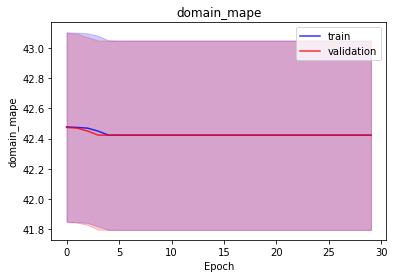

<b>latent_mae</b>: 0.3970 (min: 0.3608, max: 0.4332)

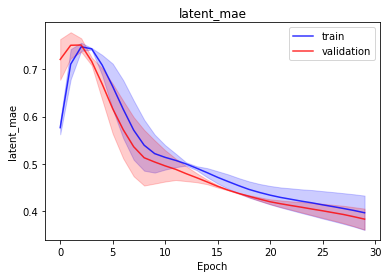

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 971007.3438 (min: 781359.1875, max: 1160655.5000)

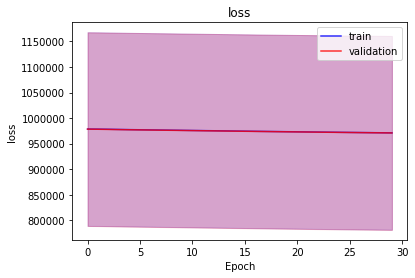

<b>bioma_loss</b>: 485498.5000 (min: 390676.5312, max: 580320.5000)

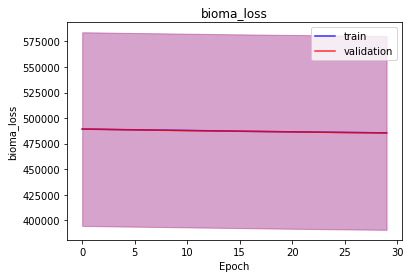

<b>domain_loss</b>: 485508.5000 (min: 390682.3125, max: 580334.6875)

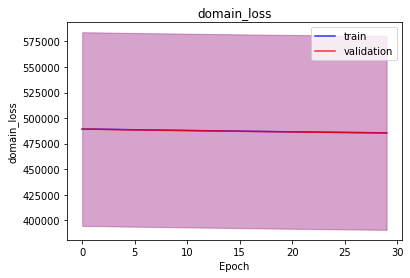

<b>latent_loss</b>: 0.2925 (min: 0.2899, max: 0.2951)

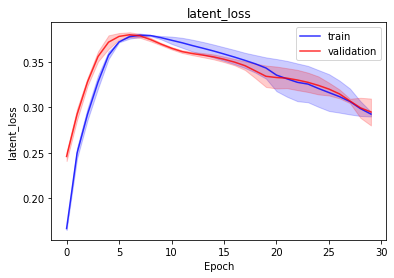

<b>bioma_mse</b>: 485498.5000 (min: 390676.5312, max: 580320.5000)

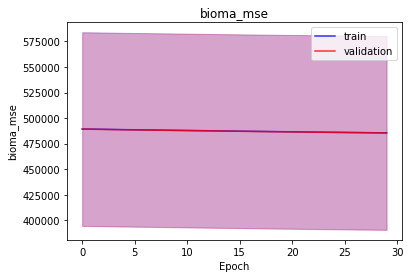

<b>bioma_mae</b>: 31.4551 (min: 31.3894, max: 31.5209)

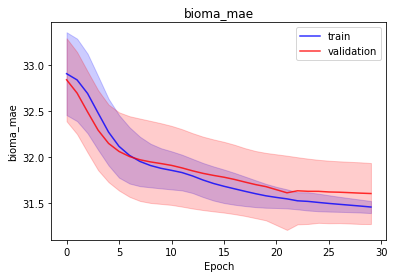

<b>bioma_mape</b>: 42.4235 (min: 41.7965, max: 43.0506)

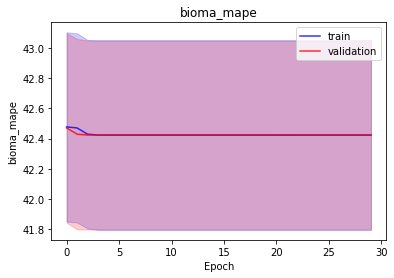

<b>domain_mse</b>: 485508.5000 (min: 390682.3125, max: 580334.6875)

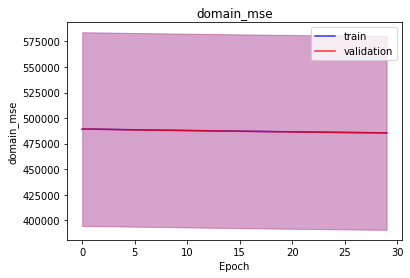

<b>domain_mae</b>: 31.6178 (min: 31.6108, max: 31.6248)

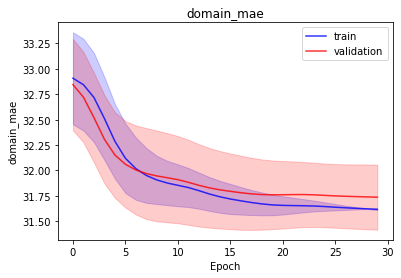

<b>domain_mape</b>: 42.4235 (min: 41.7964, max: 43.0506)

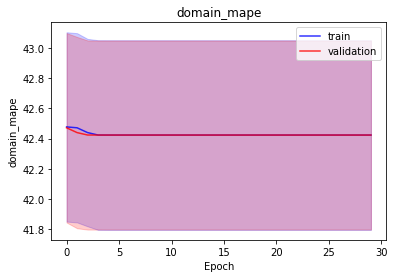

<b>latent_mae</b>: 0.2925 (min: 0.2899, max: 0.2951)

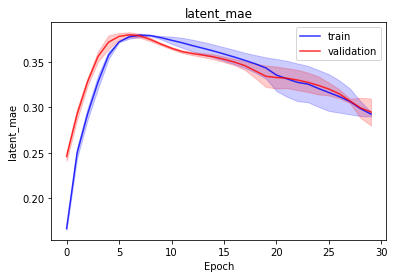

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 759430.2031 (min: 521509.0312, max: 997351.3750)

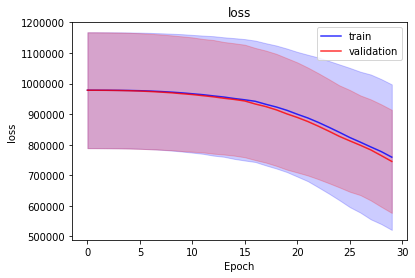

<b>bioma_loss</b>: 377596.3750 (min: 249282.9062, max: 505909.8438)

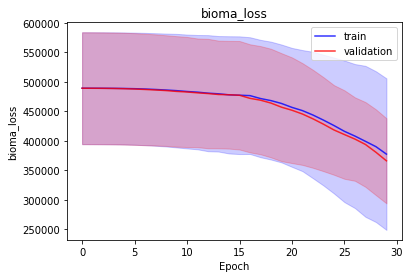

<b>domain_loss</b>: 381832.6875 (min: 272225.1250, max: 491440.2812)

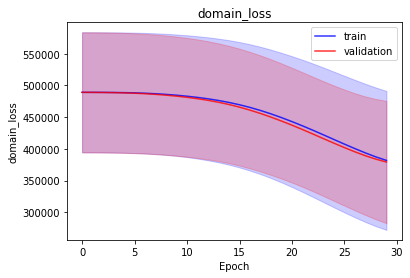

<b>latent_loss</b>: 1.1149 (min: 0.9988, max: 1.2310)

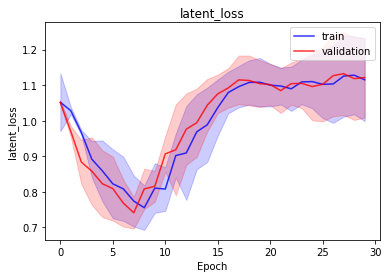

<b>bioma_mse</b>: 377596.3750 (min: 249282.9062, max: 505909.8438)

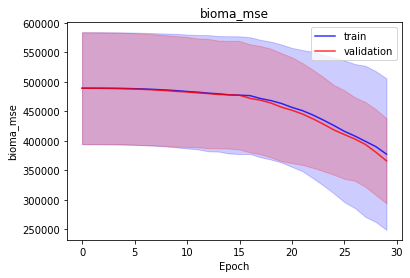

<b>bioma_mae</b>: 31.9733 (min: 30.2269, max: 33.7197)

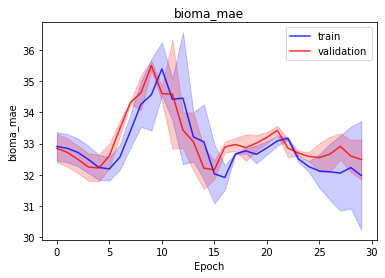

<b>bioma_mape</b>: 42.4244 (min: 41.7986, max: 43.0502)

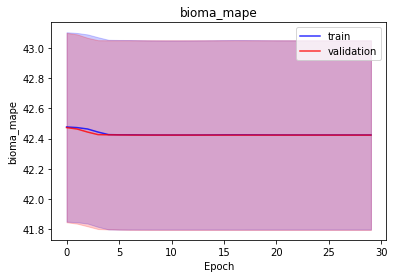

<b>domain_mse</b>: 381832.6875 (min: 272225.1250, max: 491440.2812)

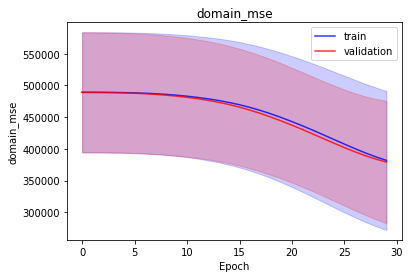

<b>domain_mae</b>: 35.5052 (min: 33.6277, max: 37.3826)

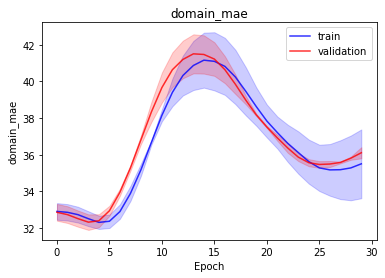

<b>domain_mape</b>: 42.4236 (min: 41.7986, max: 43.0486)

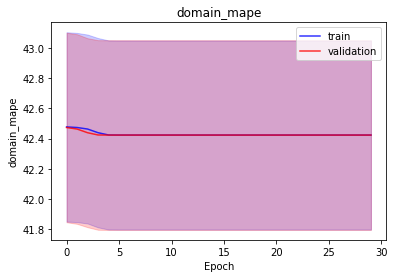

<b>latent_mae</b>: 1.1149 (min: 0.9988, max: 1.2310)

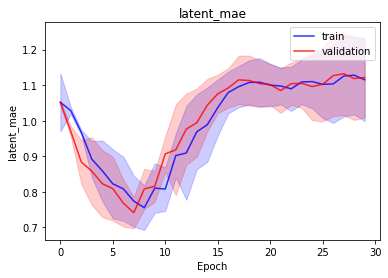

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 849844.5000 (min: 706909.5625, max: 992779.4375)

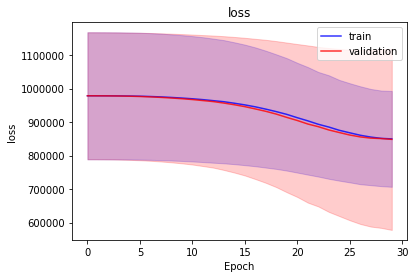

<b>bioma_loss</b>: 434306.7500 (min: 354798.2500, max: 513815.2500)

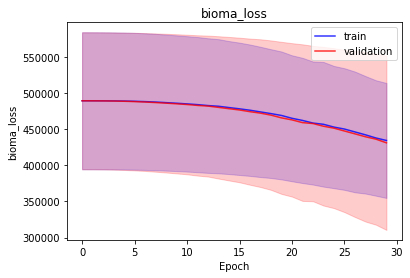

<b>domain_loss</b>: 415537.1250 (min: 352110.7188, max: 478963.5312)

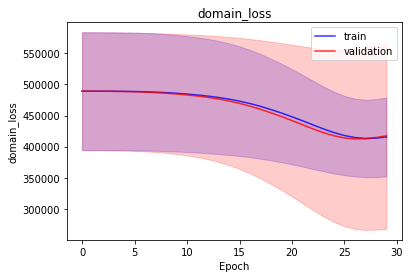

<b>latent_loss</b>: 0.6490 (min: 0.5924, max: 0.7056)

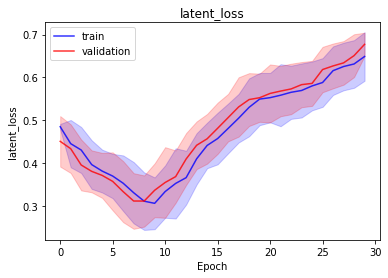

<b>bioma_mse</b>: 434306.7500 (min: 354798.2500, max: 513815.2500)

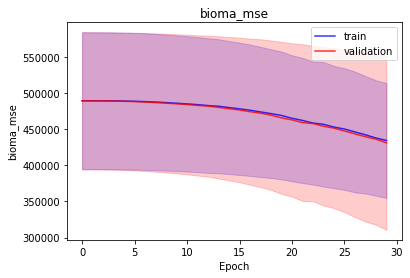

<b>bioma_mae</b>: 33.0133 (min: 32.8073, max: 33.2193)

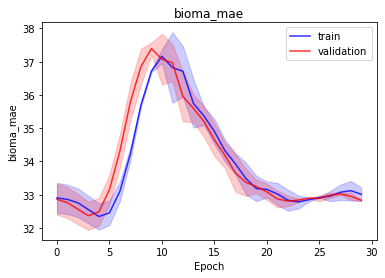

<b>bioma_mape</b>: 42.4235 (min: 41.7964, max: 43.0506)

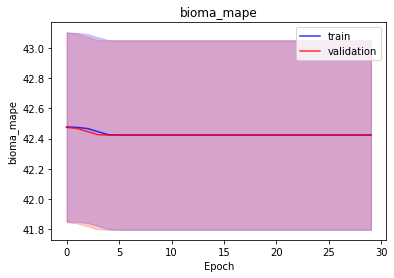

<b>domain_mse</b>: 415537.1250 (min: 352110.7188, max: 478963.5312)

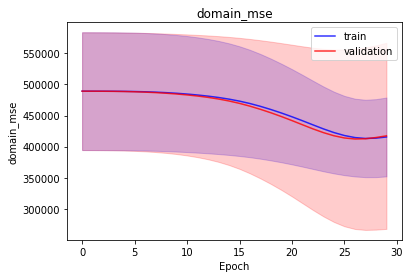

<b>domain_mae</b>: 38.5467 (min: 34.7800, max: 42.3134)

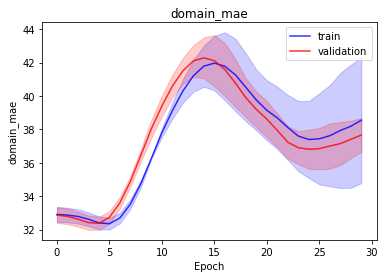

<b>domain_mape</b>: 42.4235 (min: 41.7964, max: 43.0506)

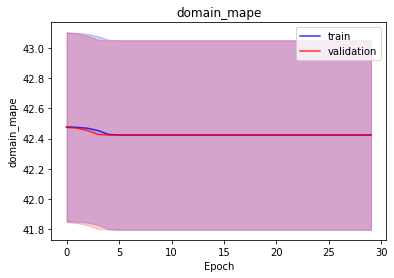

<b>latent_mae</b>: 0.6490 (min: 0.5924, max: 0.7056)

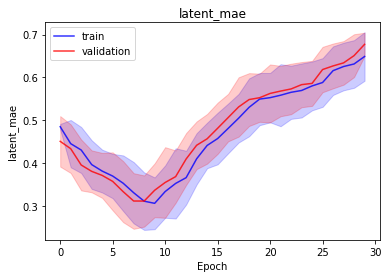

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974304.8750 (min: 785957.5000, max: 1162652.2500)

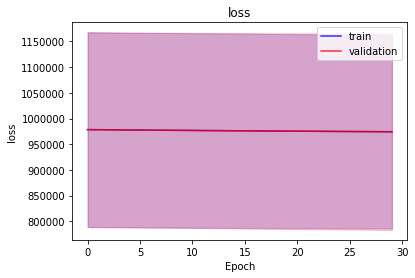

<b>bioma_loss</b>: 487152.3438 (min: 392978.6875, max: 581326.0000)

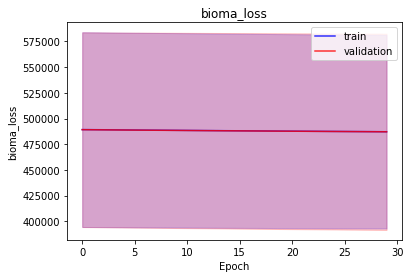

<b>domain_loss</b>: 487152.3438 (min: 392978.6875, max: 581326.0000)

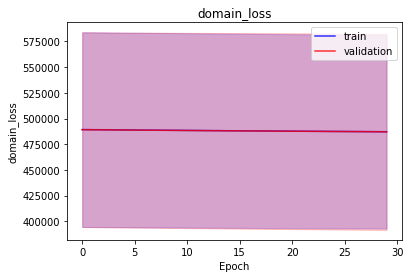

<b>latent_loss</b>: 0.1938 (min: 0.1244, max: 0.2631)

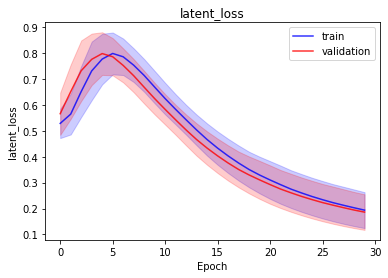

<b>bioma_mse</b>: 487152.3438 (min: 392978.6875, max: 581326.0000)

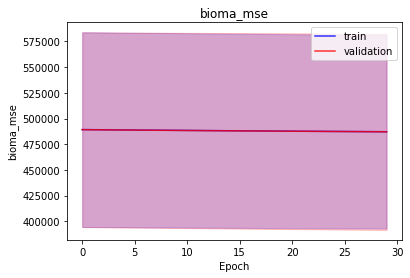

<b>bioma_mae</b>: 31.8988 (min: 31.8028, max: 31.9947)

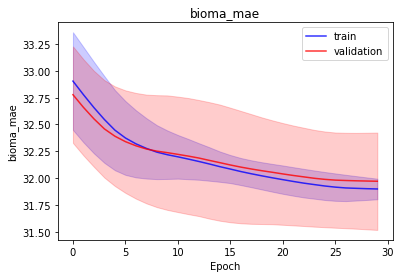

<b>bioma_mape</b>: 42.4236 (min: 41.7966, max: 43.0506)

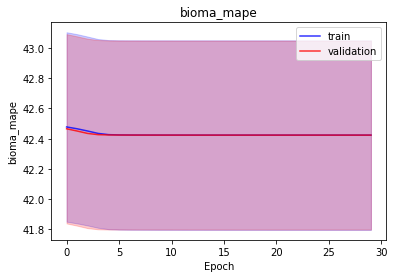

<b>domain_mse</b>: 487152.3438 (min: 392978.6875, max: 581326.0000)

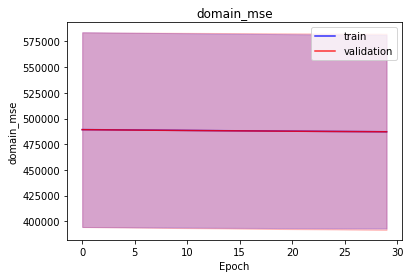

<b>domain_mae</b>: 31.8988 (min: 31.8029, max: 31.9947)

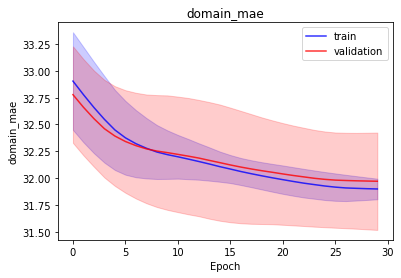

<b>domain_mape</b>: 42.4236 (min: 41.7966, max: 43.0506)

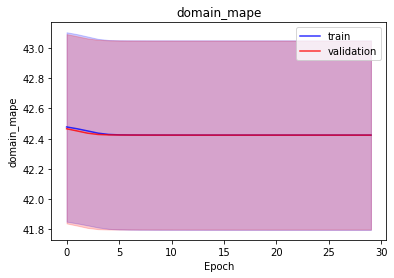

<b>latent_mae</b>: 0.1938 (min: 0.1244, max: 0.2631)

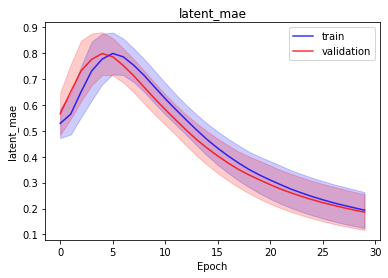

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976649.4688 (min: 787835.3125, max: 1165463.6250)

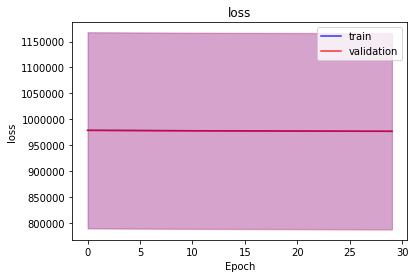

<b>bioma_loss</b>: 488324.6875 (min: 393917.5938, max: 582731.7500)

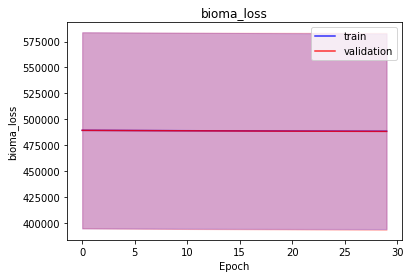

<b>domain_loss</b>: 488324.6875 (min: 393917.5938, max: 582731.7500)

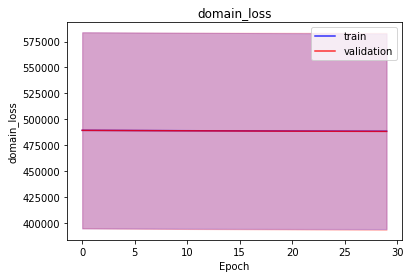

<b>latent_loss</b>: 0.1366 (min: 0.1346, max: 0.1387)

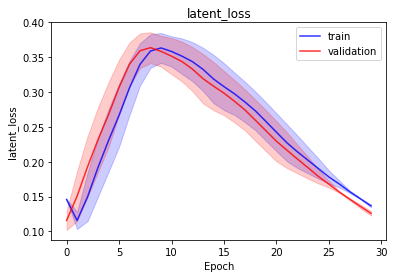

<b>bioma_mse</b>: 488324.6875 (min: 393917.5938, max: 582731.7500)

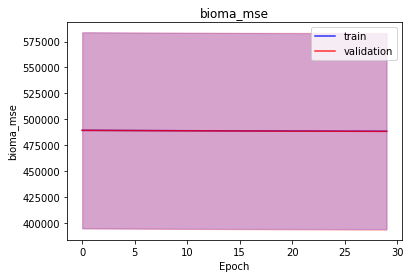

<b>bioma_mae</b>: 32.1269 (min: 31.9688, max: 32.2851)

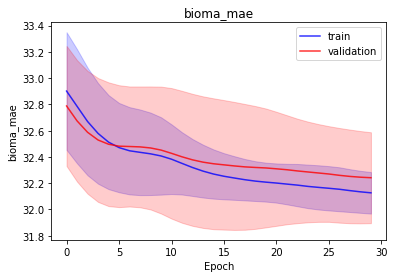

<b>bioma_mape</b>: 42.4245 (min: 41.7986, max: 43.0505)

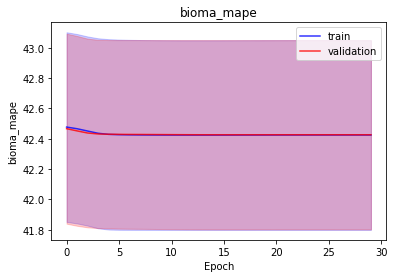

<b>domain_mse</b>: 488324.6875 (min: 393917.5938, max: 582731.7500)

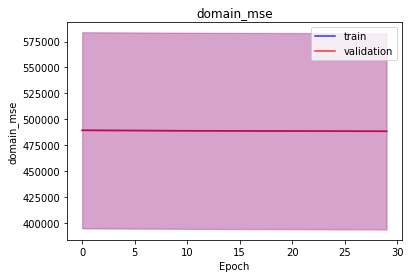

<b>domain_mae</b>: 32.1269 (min: 31.9688, max: 32.2851)

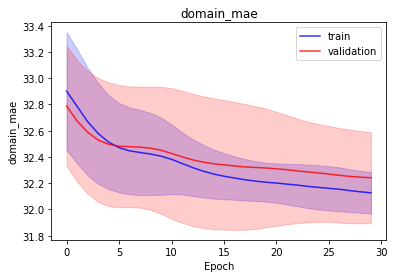

<b>domain_mape</b>: 42.4245 (min: 41.7986, max: 43.0505)

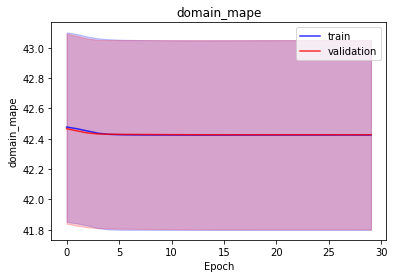

<b>latent_mae</b>: 0.1366 (min: 0.1346, max: 0.1387)

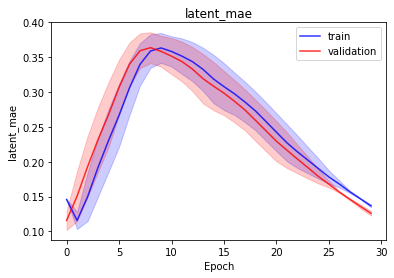

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974027.7500 (min: 784445.6250, max: 1163609.8750)

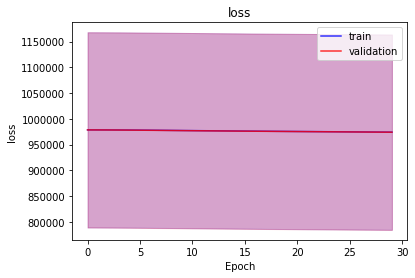

<b>bioma_loss</b>: 487010.1875 (min: 392220.4062, max: 581799.9375)

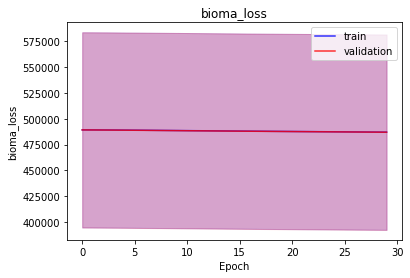

<b>domain_loss</b>: 487017.4375 (min: 392225.0938, max: 581809.8125)

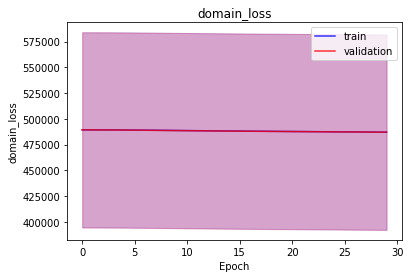

<b>latent_loss</b>: 0.1427 (min: 0.1299, max: 0.1555)

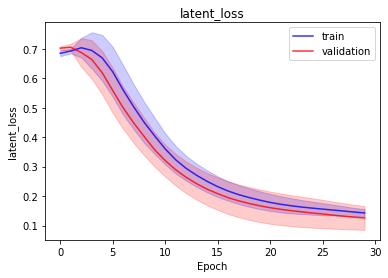

<b>bioma_mse</b>: 487010.1875 (min: 392220.4062, max: 581799.9375)

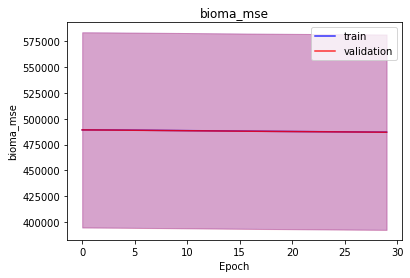

<b>bioma_mae</b>: 31.1947 (min: 31.0296, max: 31.3599)

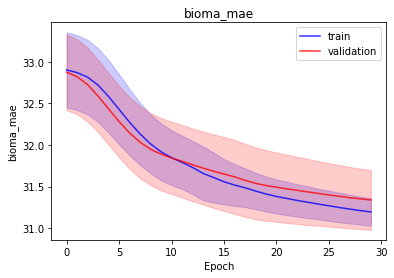

<b>bioma_mape</b>: 42.4264 (min: 41.8006, max: 43.0522)

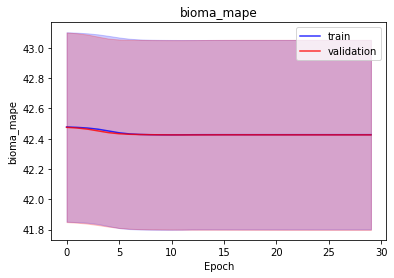

<b>domain_mse</b>: 487017.4375 (min: 392225.0938, max: 581809.8125)

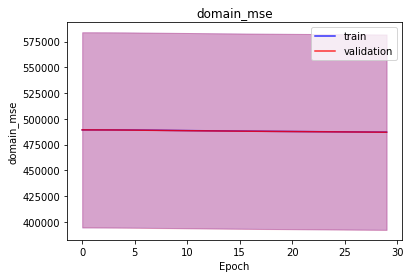

<b>domain_mae</b>: 31.4649 (min: 31.4001, max: 31.5296)

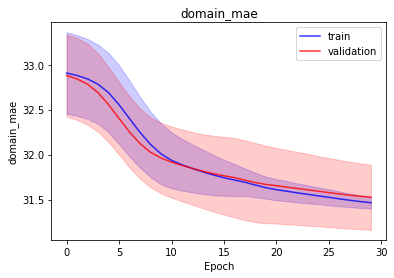

<b>domain_mape</b>: 42.4228 (min: 41.7965, max: 43.0491)

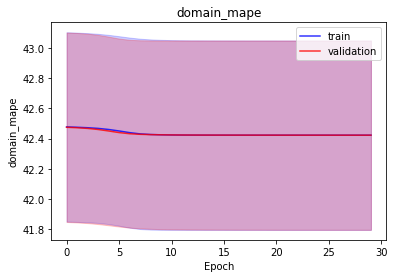

<b>latent_mae</b>: 0.1427 (min: 0.1299, max: 0.1555)

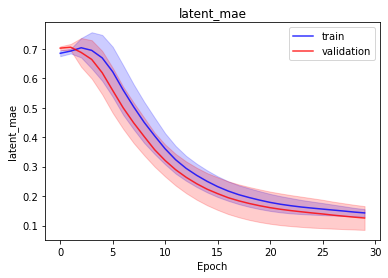

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974161.7812 (min: 784506.9375, max: 1163816.6250)

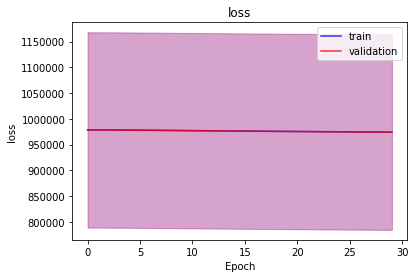

<b>bioma_loss</b>: 487079.2500 (min: 392253.5938, max: 581904.8750)

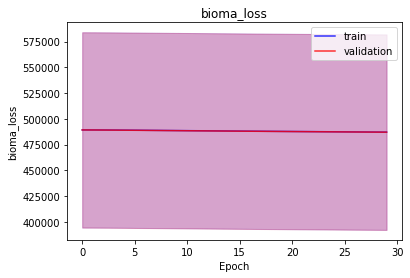

<b>domain_loss</b>: 487082.3750 (min: 392253.1562, max: 581911.6250)

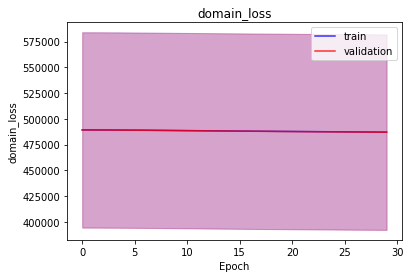

<b>latent_loss</b>: 0.1859 (min: 0.1852, max: 0.1865)

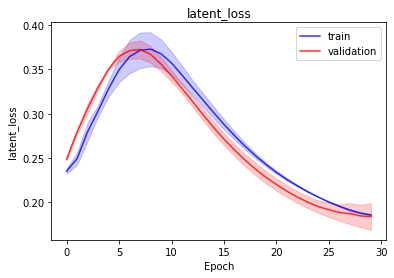

<b>bioma_mse</b>: 487079.2500 (min: 392253.5938, max: 581904.8750)

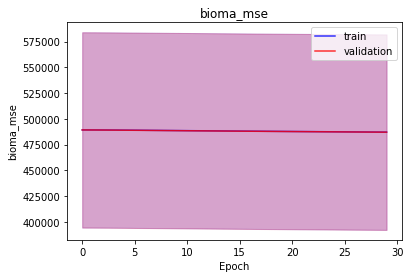

<b>bioma_mae</b>: 31.4217 (min: 31.2843, max: 31.5591)

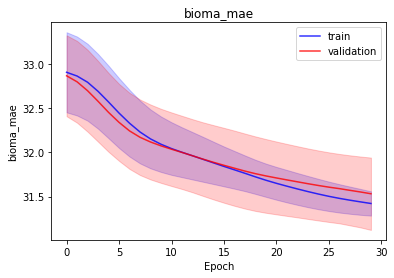

<b>bioma_mape</b>: 42.4253 (min: 41.8003, max: 43.0502)

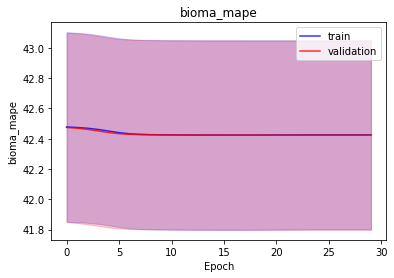

<b>domain_mse</b>: 487082.3750 (min: 392253.1562, max: 581911.6250)

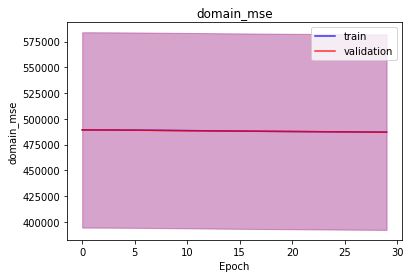

<b>domain_mae</b>: 31.5378 (min: 31.4642, max: 31.6115)

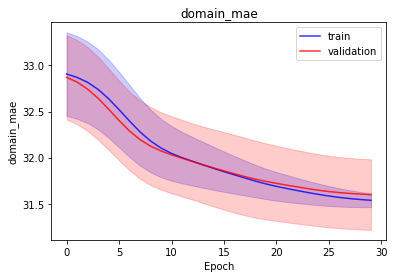

<b>domain_mape</b>: 42.4235 (min: 41.7966, max: 43.0504)

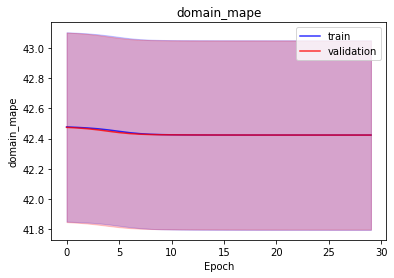

<b>latent_mae</b>: 0.1859 (min: 0.1852, max: 0.1865)

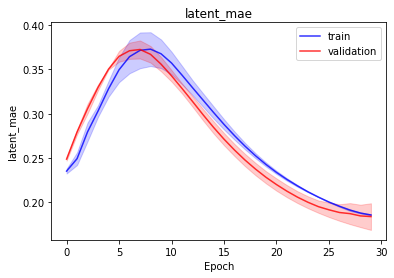

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 964237.5938 (min: 773663.9375, max: 1154811.2500)

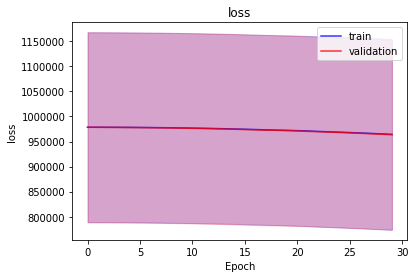

<b>bioma_loss</b>: 483018.3750 (min: 386848.9688, max: 579187.8125)

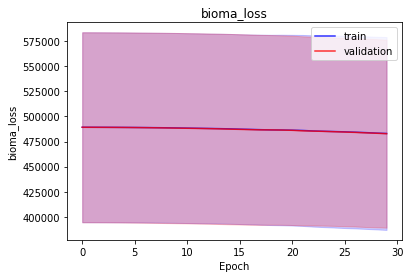

<b>domain_loss</b>: 481218.5625 (min: 386814.2500, max: 575622.8750)

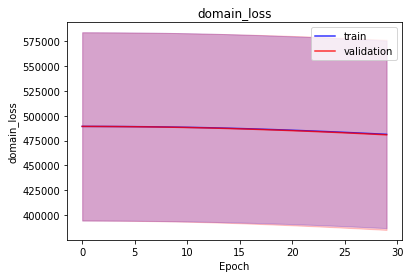

<b>latent_loss</b>: 0.6030 (min: 0.5482, max: 0.6578)

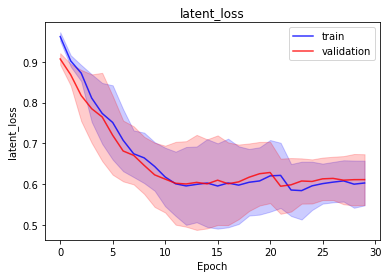

<b>bioma_mse</b>: 483018.3750 (min: 386848.9688, max: 579187.8125)

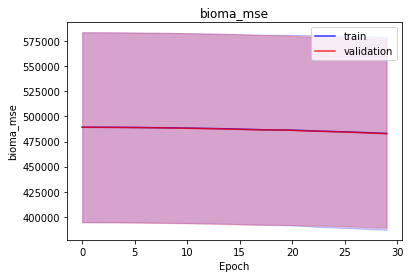

<b>bioma_mae</b>: 31.8468 (min: 30.8602, max: 32.8333)

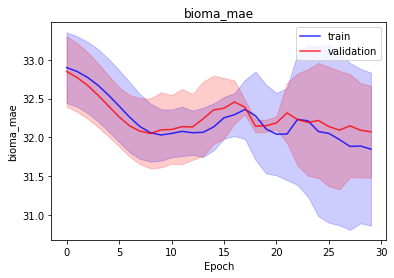

<b>bioma_mape</b>: 42.4231 (min: 41.8004, max: 43.0457)

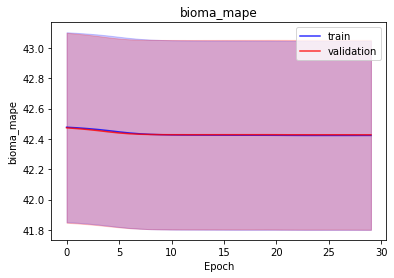

<b>domain_mse</b>: 481218.5625 (min: 386814.2500, max: 575622.8750)

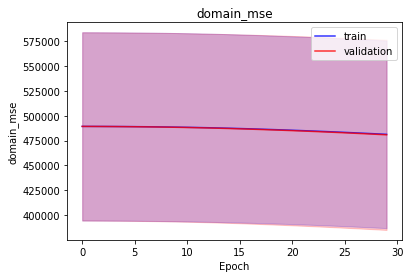

<b>domain_mae</b>: 33.8059 (min: 32.8986, max: 34.7133)

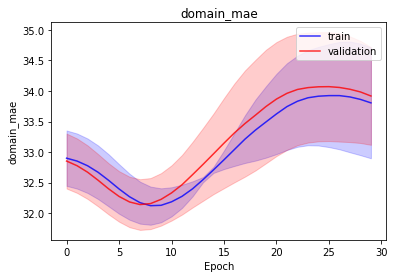

<b>domain_mape</b>: 42.4225 (min: 41.7965, max: 43.0486)

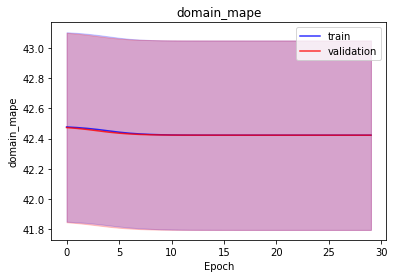

<b>latent_mae</b>: 0.6030 (min: 0.5482, max: 0.6578)

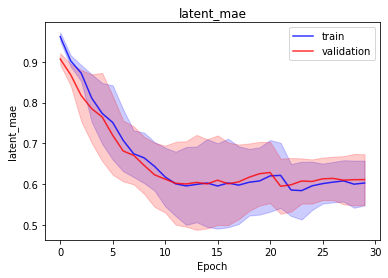

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 963969.2188 (min: 772355.5625, max: 1155582.8750)

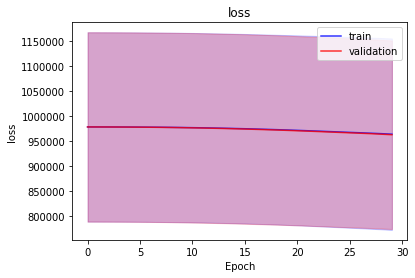

<b>bioma_loss</b>: 482754.2500 (min: 386440.1562, max: 579068.3750)

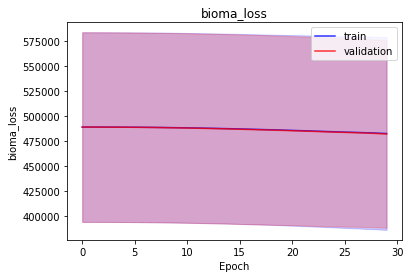

<b>domain_loss</b>: 481214.6875 (min: 385915.1875, max: 576514.1875)

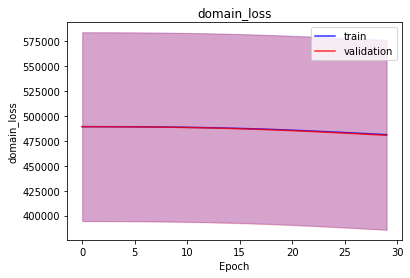

<b>latent_loss</b>: 0.2765 (min: 0.2078, max: 0.3452)

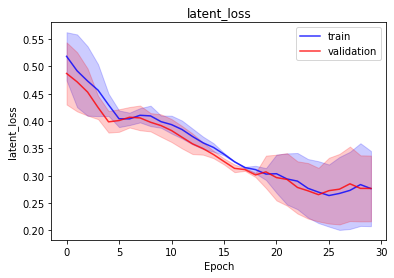

<b>bioma_mse</b>: 482754.2500 (min: 386440.1562, max: 579068.3750)

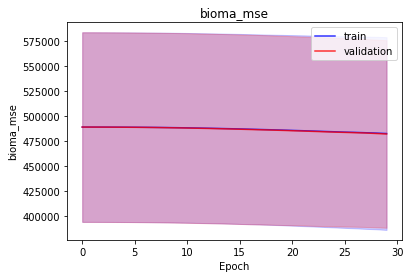

<b>bioma_mae</b>: 32.0127 (min: 31.3994, max: 32.6259)

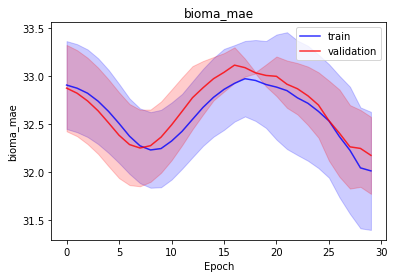

<b>bioma_mape</b>: 42.4244 (min: 41.7983, max: 43.0505)

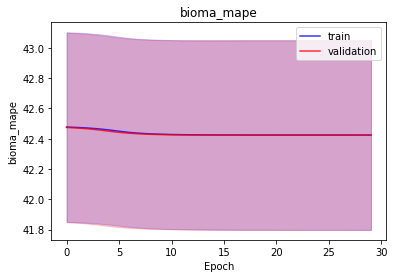

<b>domain_mse</b>: 481214.6875 (min: 385915.1875, max: 576514.1875)

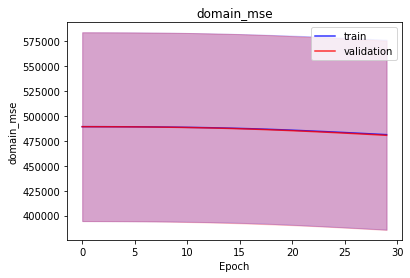

<b>domain_mae</b>: 33.7292 (min: 33.1879, max: 34.2705)

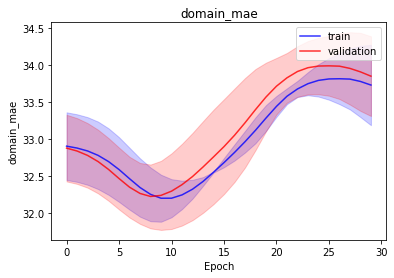

<b>domain_mape</b>: 42.4246 (min: 41.7986, max: 43.0506)

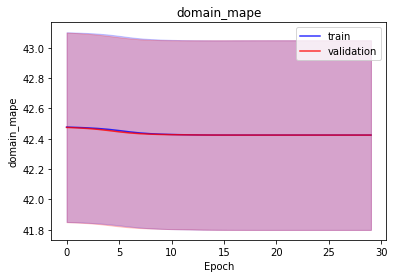

<b>latent_mae</b>: 0.2765 (min: 0.2078, max: 0.3452)

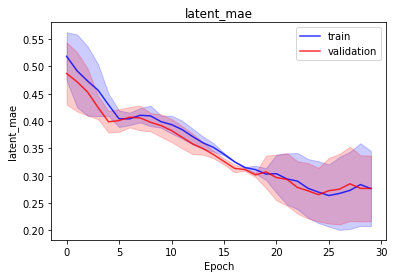

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976393.1562 (min: 786524.5625, max: 1166261.7500)

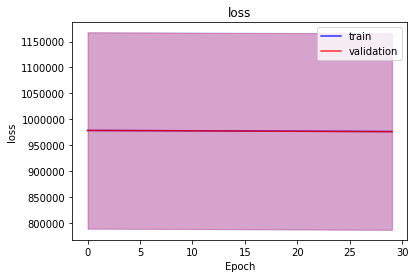

<b>bioma_loss</b>: 488194.5625 (min: 393261.0312, max: 583128.0625)

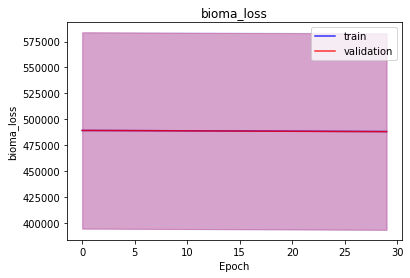

<b>domain_loss</b>: 488198.4375 (min: 393263.4375, max: 583133.4375)

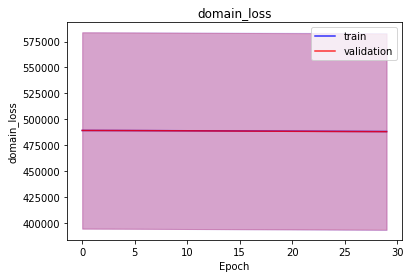

<b>latent_loss</b>: 0.1673 (min: 0.0832, max: 0.2513)

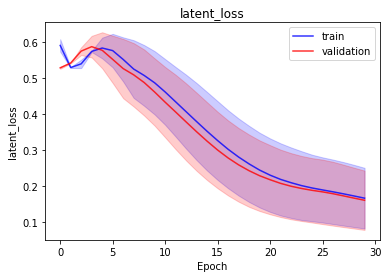

<b>bioma_mse</b>: 488194.5625 (min: 393261.0312, max: 583128.0625)

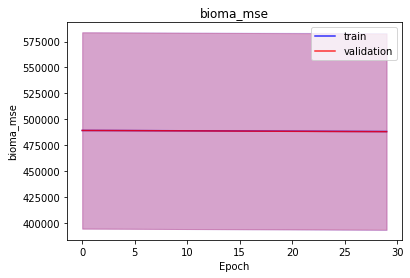

<b>bioma_mae</b>: 32.2392 (min: 31.9374, max: 32.5410)

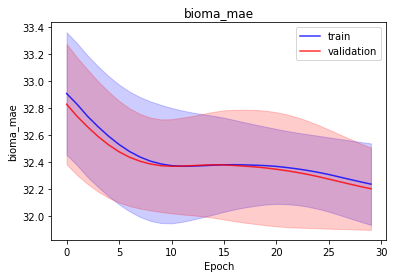

<b>bioma_mape</b>: 42.4267 (min: 41.8036, max: 43.0498)

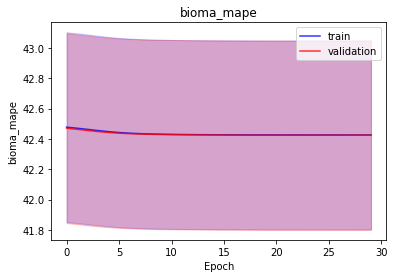

<b>domain_mse</b>: 488198.4375 (min: 393263.4375, max: 583133.4375)

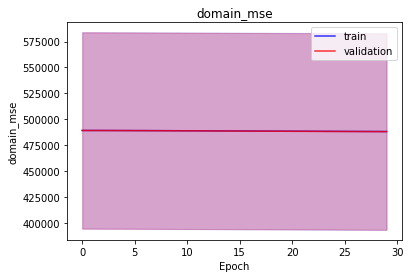

<b>domain_mae</b>: 32.2210 (min: 31.9077, max: 32.5344)

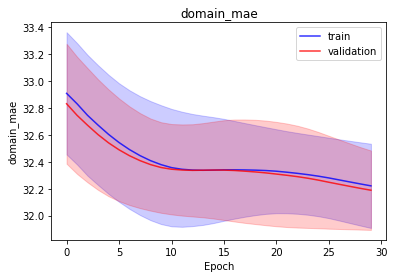

<b>domain_mape</b>: 42.4266 (min: 41.8035, max: 43.0498)

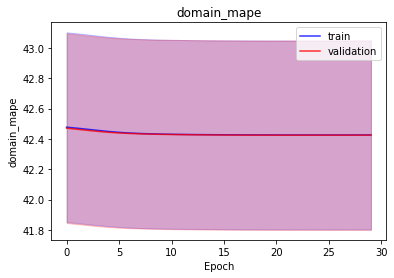

<b>latent_mae</b>: 0.1673 (min: 0.0832, max: 0.2513)

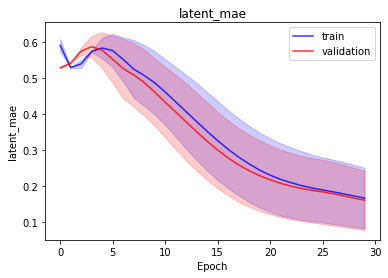

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976007.5625 (min: 786360.7500, max: 1165654.3750)

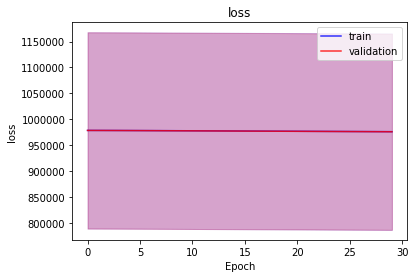

<b>bioma_loss</b>: 488000.7188 (min: 393177.1250, max: 582824.3125)

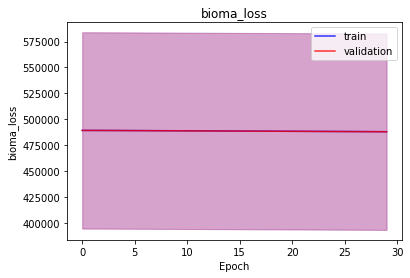

<b>domain_loss</b>: 488006.6875 (min: 393183.4375, max: 582829.9375)

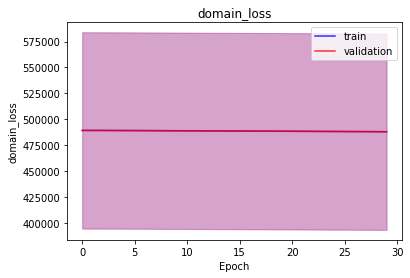

<b>latent_loss</b>: 0.1762 (min: 0.1749, max: 0.1776)

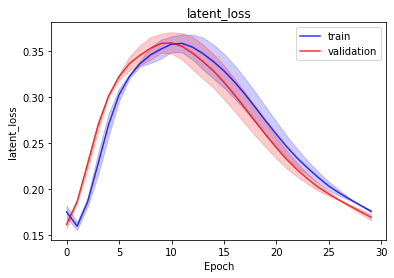

<b>bioma_mse</b>: 488000.7188 (min: 393177.1250, max: 582824.3125)

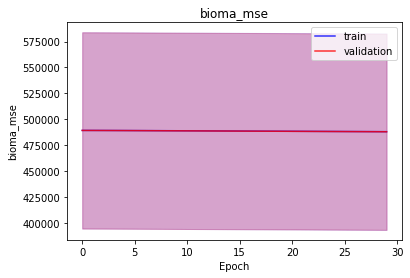

<b>bioma_mae</b>: 32.1583 (min: 31.9752, max: 32.3415)

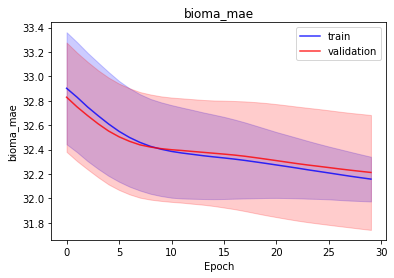

<b>bioma_mape</b>: 42.4245 (min: 41.7993, max: 43.0496)

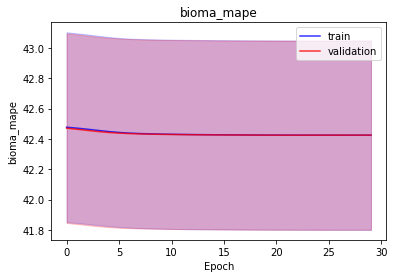

<b>domain_mse</b>: 488006.6875 (min: 393183.4375, max: 582829.9375)

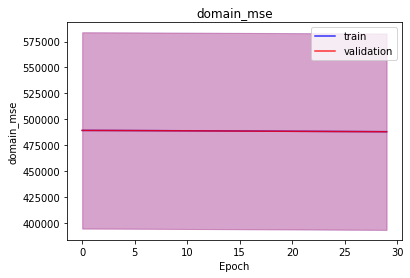

<b>domain_mae</b>: 32.1510 (min: 31.9669, max: 32.3351)

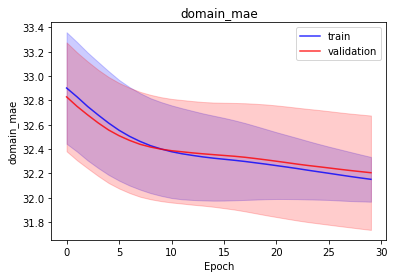

<b>domain_mape</b>: 42.4245 (min: 41.7994, max: 43.0496)

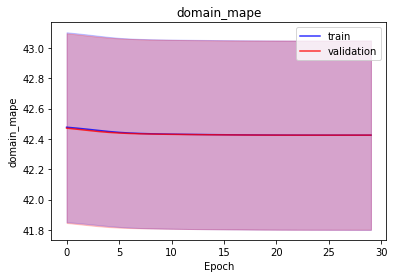

<b>latent_mae</b>: 0.1762 (min: 0.1749, max: 0.1776)

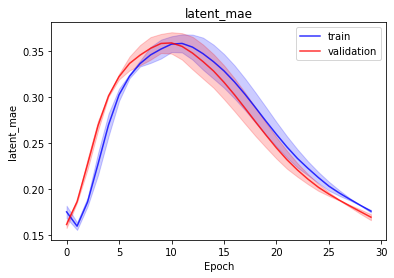

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977682.5000 (min: 788131.7500, max: 1167233.2500)

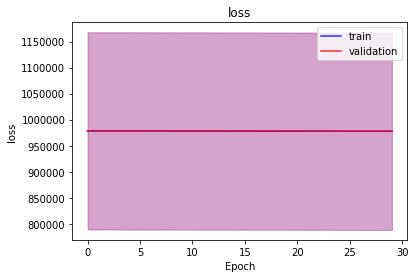

<b>bioma_loss</b>: 488860.0312 (min: 394089.2500, max: 583630.8125)

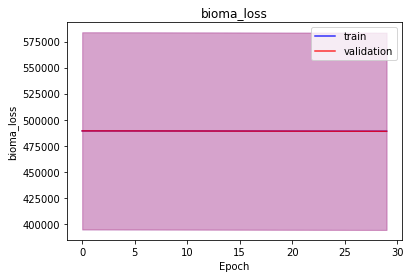

<b>domain_loss</b>: 488822.1875 (min: 394042.1250, max: 583602.2500)

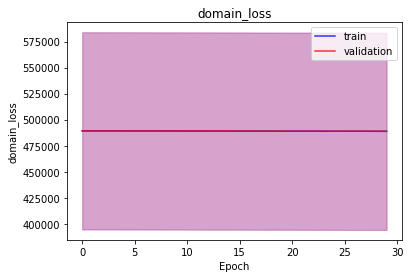

<b>latent_loss</b>: 0.3433 (min: 0.2863, max: 0.4003)

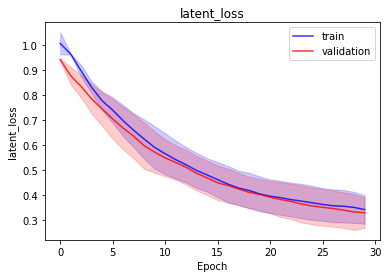

<b>bioma_mse</b>: 488860.0312 (min: 394089.2500, max: 583630.8125)

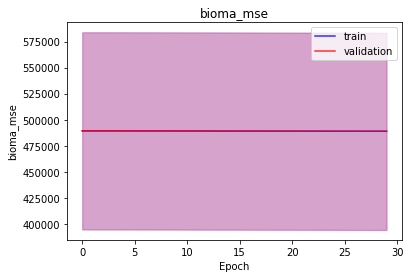

<b>bioma_mae</b>: 31.7646 (min: 31.3200, max: 32.2093)

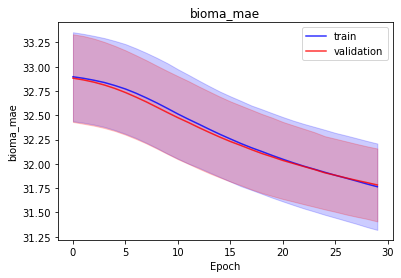

<b>bioma_mape</b>: 42.4318 (min: 41.8084, max: 43.0552)

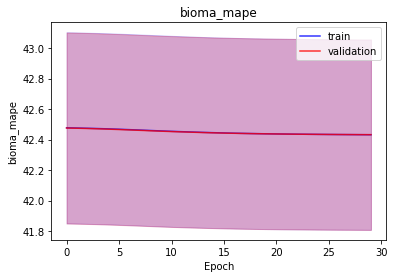

<b>domain_mse</b>: 488822.1875 (min: 394042.1250, max: 583602.2500)

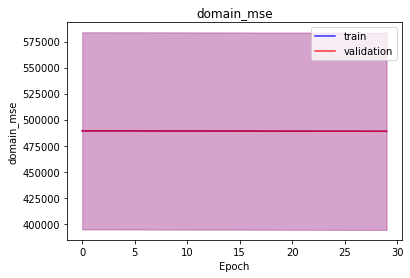

<b>domain_mae</b>: 31.9035 (min: 31.5540, max: 32.2531)

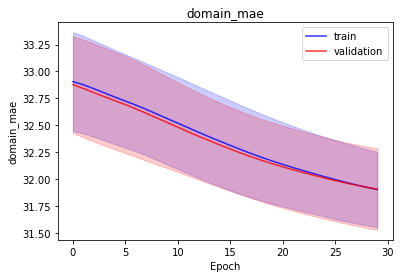

<b>domain_mape</b>: 42.4299 (min: 41.8068, max: 43.0530)

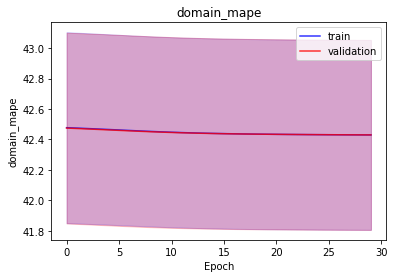

<b>latent_mae</b>: 0.3433 (min: 0.2863, max: 0.4003)

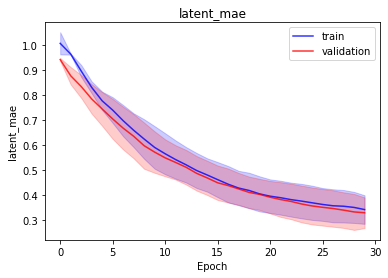

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977628.0625 (min: 788144.5000, max: 1167111.6250)

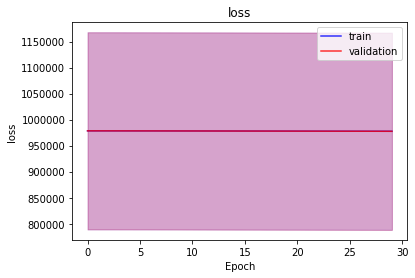

<b>bioma_loss</b>: 488781.8125 (min: 394011.8125, max: 583551.8125)

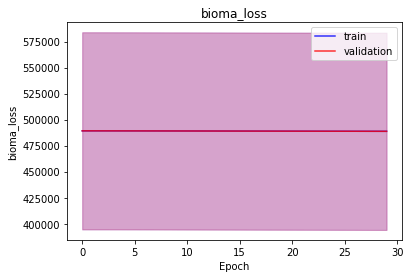

<b>domain_loss</b>: 488845.9688 (min: 394132.3125, max: 583559.6250)

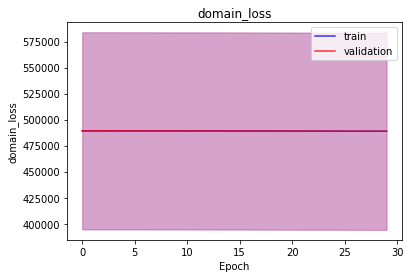

<b>latent_loss</b>: 0.2738 (min: 0.1827, max: 0.3650)

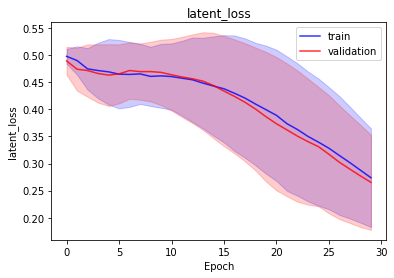

<b>bioma_mse</b>: 488781.8125 (min: 394011.8125, max: 583551.8125)

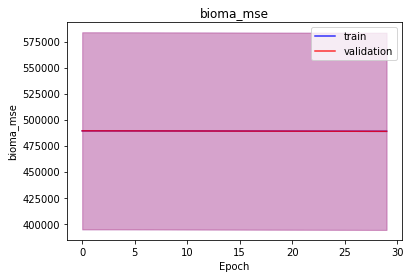

<b>bioma_mae</b>: 31.8178 (min: 31.4763, max: 32.1593)

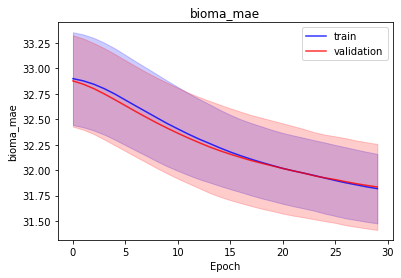

<b>bioma_mape</b>: 42.4297 (min: 41.8069, max: 43.0526)

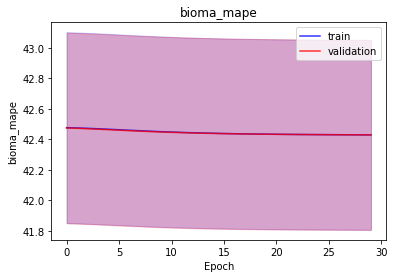

<b>domain_mse</b>: 488845.9688 (min: 394132.3125, max: 583559.6250)

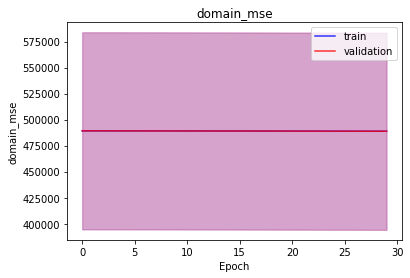

<b>domain_mae</b>: 31.9819 (min: 31.6193, max: 32.3445)

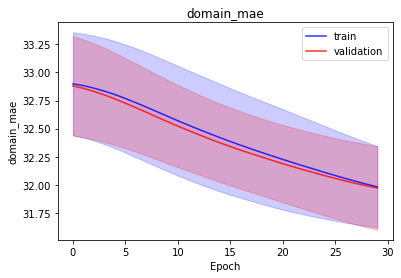

<b>domain_mape</b>: 42.4312 (min: 41.8071, max: 43.0552)

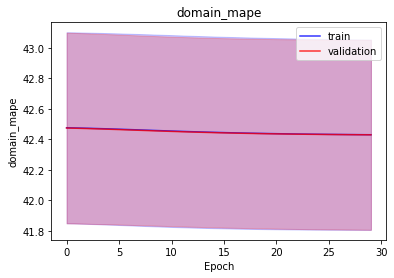

<b>latent_mae</b>: 0.2738 (min: 0.1827, max: 0.3650)

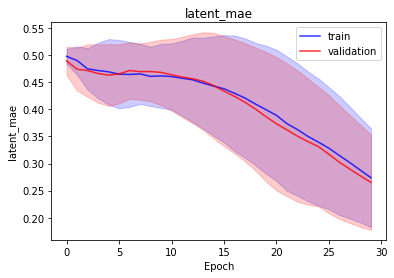

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977836.5312 (min: 788283.9375, max: 1167389.1250)

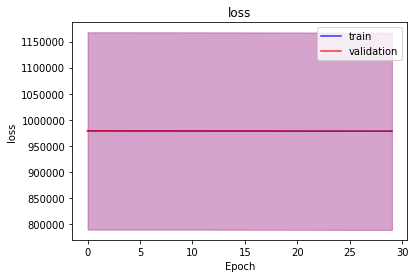

<b>bioma_loss</b>: 488910.8438 (min: 394129.6250, max: 583692.0625)

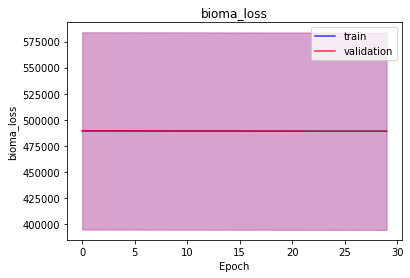

<b>domain_loss</b>: 488925.0000 (min: 394153.7188, max: 583696.3125)

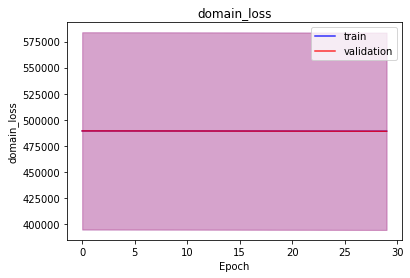

<b>latent_loss</b>: 0.6717 (min: 0.5772, max: 0.7661)

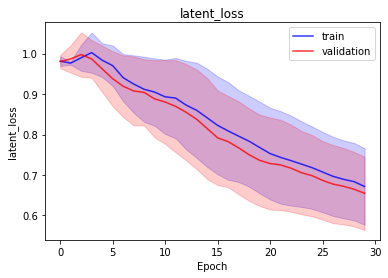

<b>bioma_mse</b>: 488910.8438 (min: 394129.6250, max: 583692.0625)

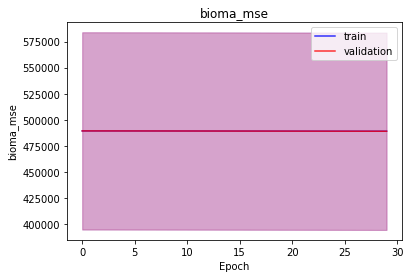

<b>bioma_mae</b>: 32.0081 (min: 31.7201, max: 32.2960)

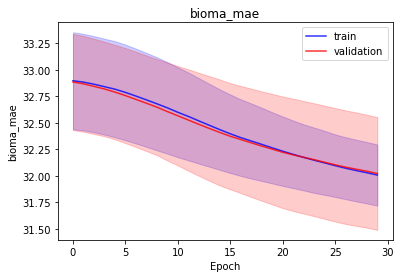

<b>bioma_mape</b>: 42.4322 (min: 41.8085, max: 43.0559)

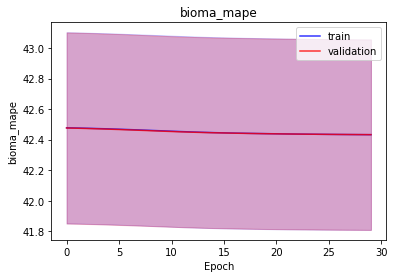

<b>domain_mse</b>: 488925.0000 (min: 394153.7188, max: 583696.3125)

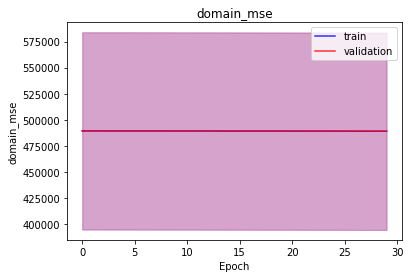

<b>domain_mae</b>: 32.1044 (min: 31.8813, max: 32.3274)

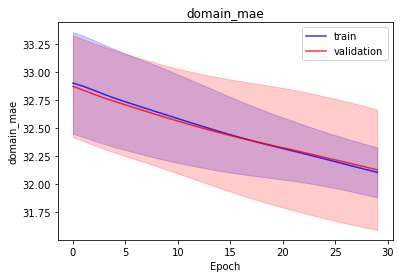

<b>domain_mape</b>: 42.4293 (min: 41.8059, max: 43.0528)

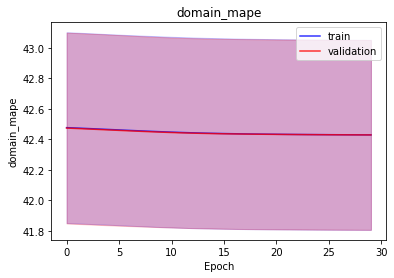

<b>latent_mae</b>: 0.6717 (min: 0.5772, max: 0.7661)

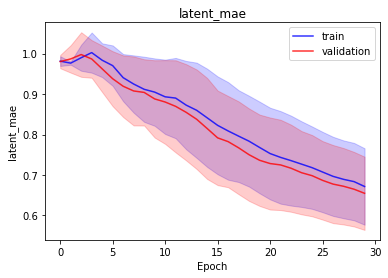

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977750.2188 (min: 788294.9375, max: 1167205.5000)

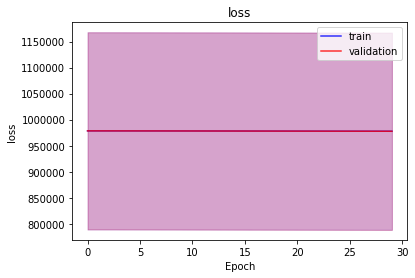

<b>bioma_loss</b>: 488856.4375 (min: 394129.0938, max: 583583.7500)

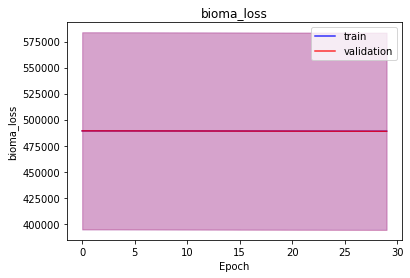

<b>domain_loss</b>: 488893.5312 (min: 394165.6875, max: 583621.3750)

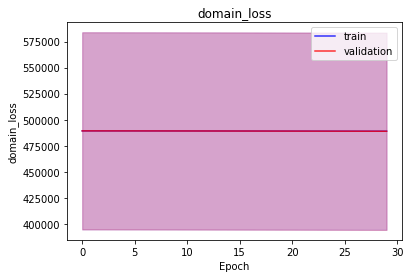

<b>latent_loss</b>: 0.2666 (min: 0.1823, max: 0.3509)

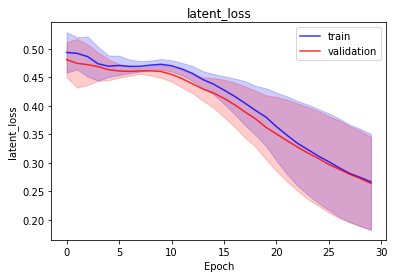

<b>bioma_mse</b>: 488856.4375 (min: 394129.0938, max: 583583.7500)

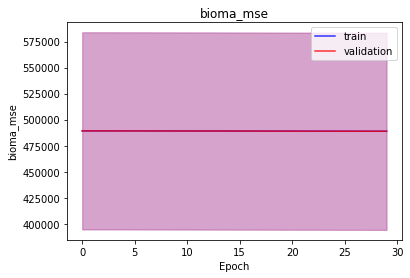

<b>bioma_mae</b>: 31.8042 (min: 31.4389, max: 32.1694)

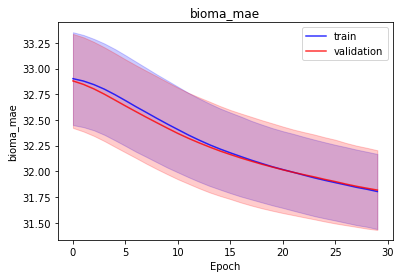

<b>bioma_mape</b>: 42.4299 (min: 41.8071, max: 43.0527)

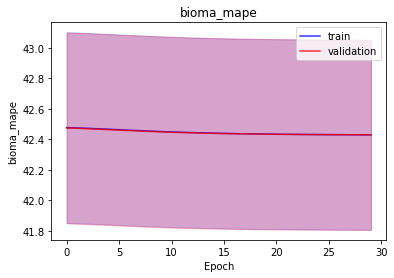

<b>domain_mse</b>: 488893.5312 (min: 394165.6875, max: 583621.3750)

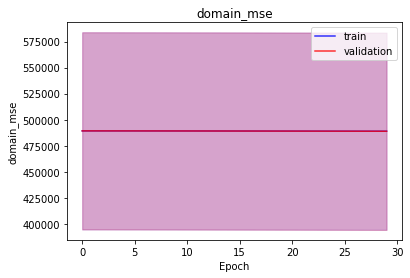

<b>domain_mae</b>: 31.9608 (min: 31.6354, max: 32.2863)

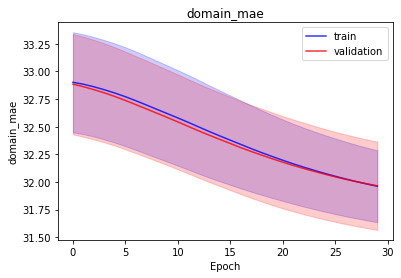

<b>domain_mape</b>: 42.4306 (min: 41.8077, max: 43.0536)

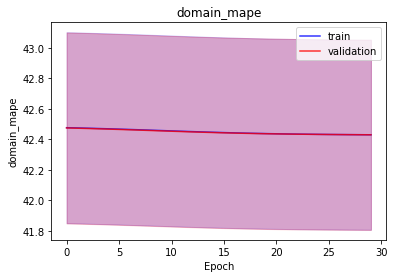

<b>latent_mae</b>: 0.2666 (min: 0.1823, max: 0.3509)

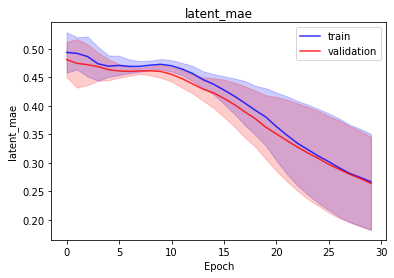

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977834.6250 (min: 788390.1250, max: 1167279.1250)

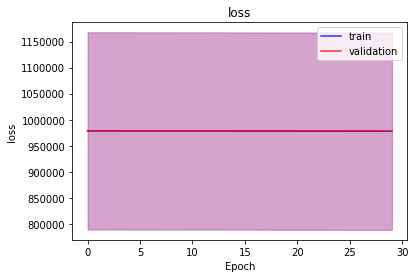

<b>bioma_loss</b>: 488894.1250 (min: 394146.7188, max: 583641.5000)

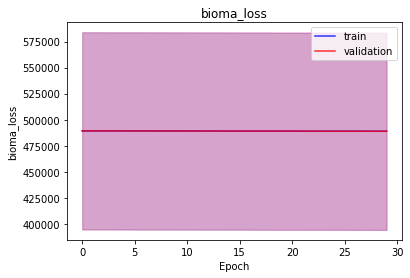

<b>domain_loss</b>: 488939.9375 (min: 394242.7188, max: 583637.1250)

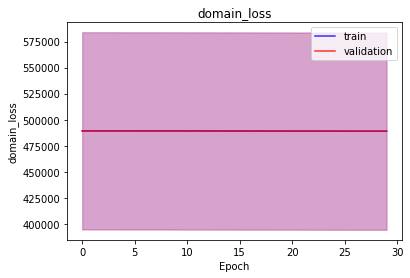

<b>latent_loss</b>: 0.5678 (min: 0.4718, max: 0.6638)

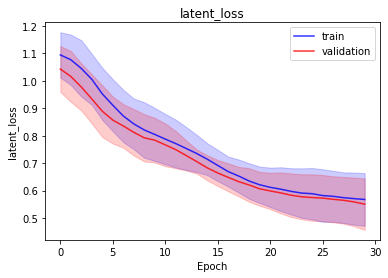

<b>bioma_mse</b>: 488894.1250 (min: 394146.7188, max: 583641.5000)

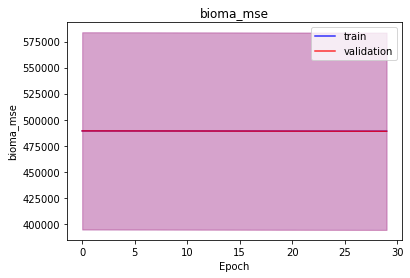

<b>bioma_mae</b>: 31.8768 (min: 31.4446, max: 32.3091)

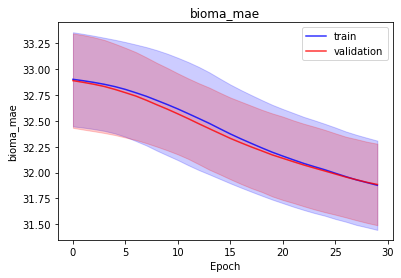

<b>bioma_mape</b>: 42.4326 (min: 41.8092, max: 43.0561)

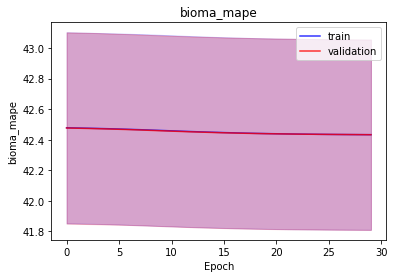

<b>domain_mse</b>: 488939.9375 (min: 394242.7188, max: 583637.1250)

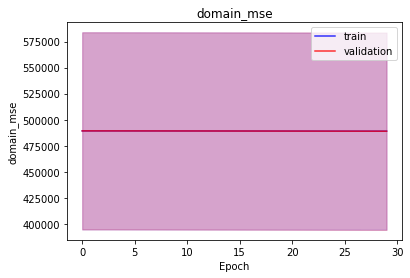

<b>domain_mae</b>: 31.9921 (min: 31.6031, max: 32.3812)

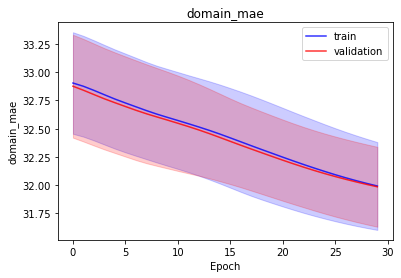

<b>domain_mape</b>: 42.4299 (min: 41.8076, max: 43.0522)

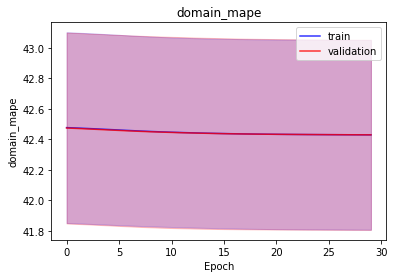

<b>latent_mae</b>: 0.5678 (min: 0.4718, max: 0.6638)

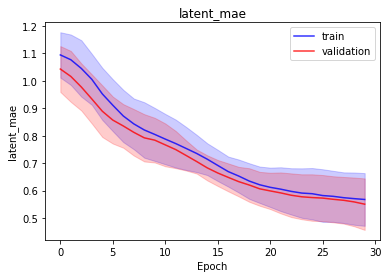

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977745.5938 (min: 788324.9375, max: 1167166.2500)

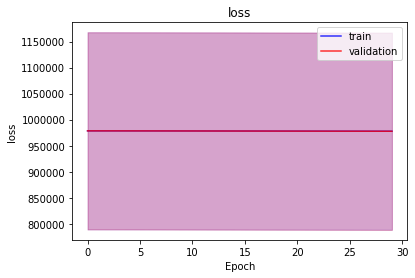

<b>bioma_loss</b>: 488866.5000 (min: 394149.1875, max: 583583.8125)

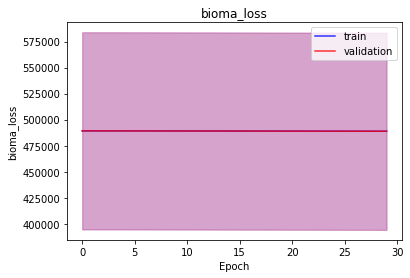

<b>domain_loss</b>: 488878.8750 (min: 394175.5312, max: 583582.2500)

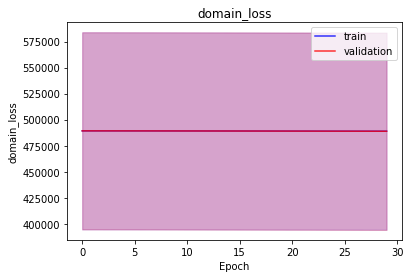

<b>latent_loss</b>: 0.2230 (min: 0.2186, max: 0.2273)

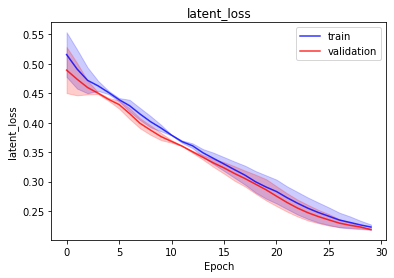

<b>bioma_mse</b>: 488866.5000 (min: 394149.1875, max: 583583.8125)

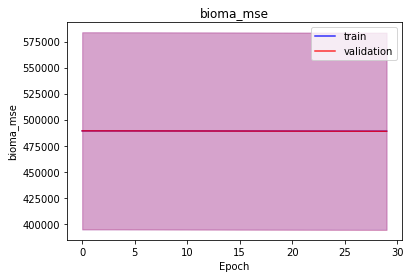

<b>bioma_mae</b>: 31.8706 (min: 31.5095, max: 32.2316)

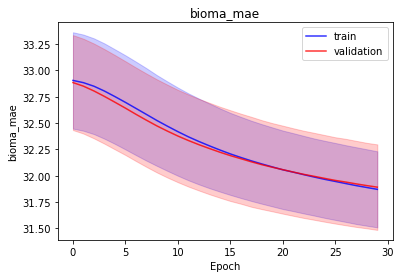

<b>bioma_mape</b>: 42.4299 (min: 41.8073, max: 43.0526)

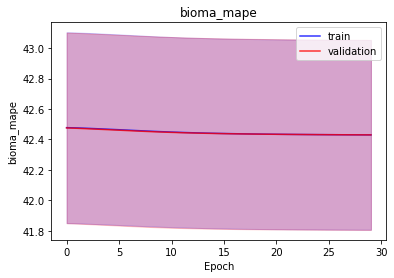

<b>domain_mse</b>: 488878.8750 (min: 394175.5312, max: 583582.2500)

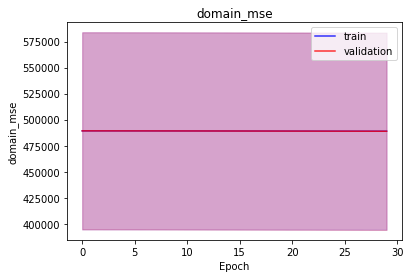

<b>domain_mae</b>: 31.9723 (min: 31.6425, max: 32.3020)

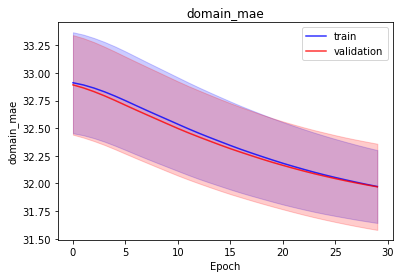

<b>domain_mape</b>: 42.4302 (min: 41.8074, max: 43.0531)

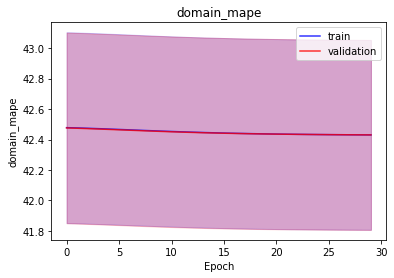

<b>latent_mae</b>: 0.2230 (min: 0.2186, max: 0.2273)

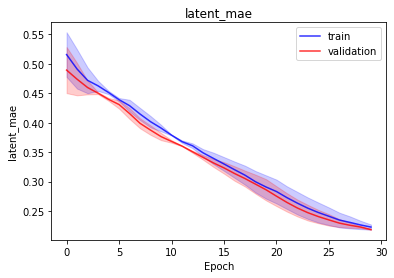

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 970190.2812 (min: 780145.8125, max: 1160234.7500)

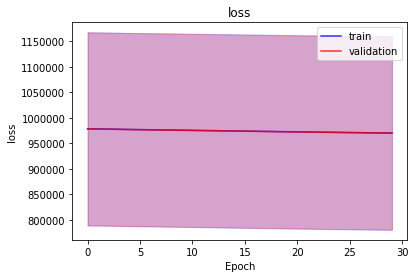

<b>bioma_loss</b>: 485089.2500 (min: 390072.6875, max: 580105.8125)

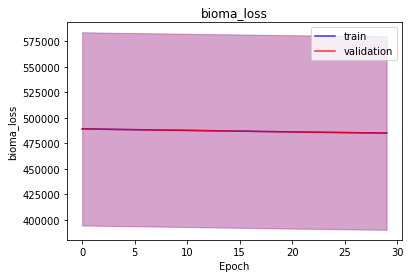

<b>domain_loss</b>: 485100.6250 (min: 390072.6875, max: 580128.5625)

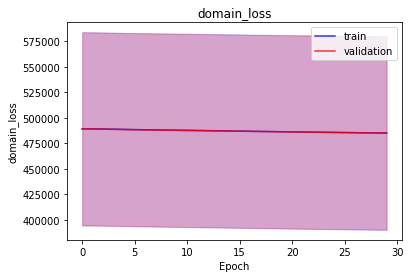

<b>latent_loss</b>: 0.3867 (min: 0.3617, max: 0.4117)

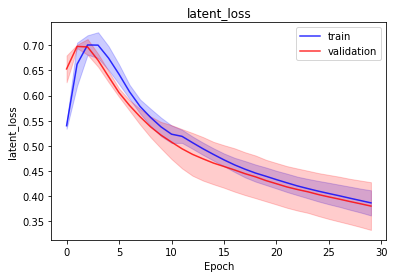

<b>bioma_mse</b>: 485089.2500 (min: 390072.6875, max: 580105.8125)

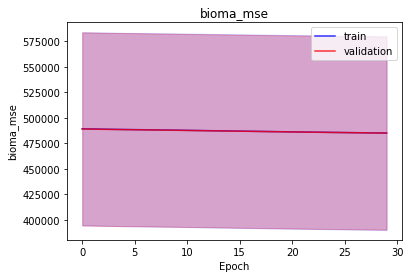

<b>bioma_mae</b>: 31.3007 (min: 31.2347, max: 31.3666)

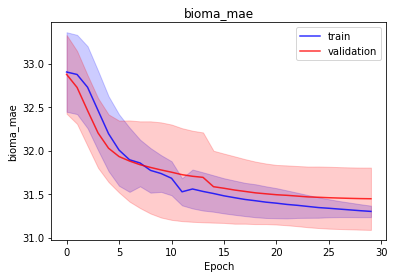

<b>bioma_mape</b>: 42.4246 (min: 41.8006, max: 43.0486)

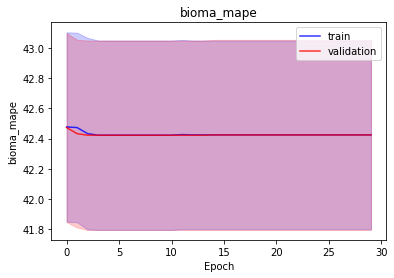

<b>domain_mse</b>: 485100.6250 (min: 390072.6875, max: 580128.5625)

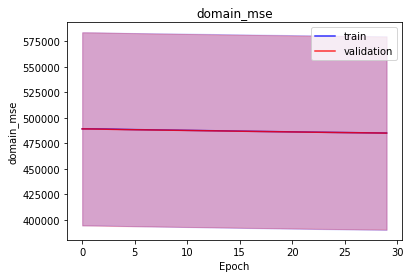

<b>domain_mae</b>: 31.5447 (min: 31.3667, max: 31.7227)

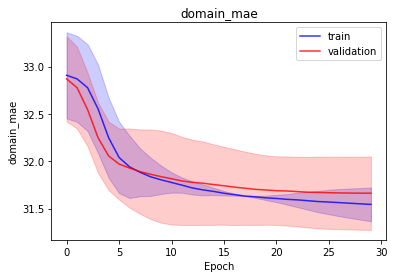

<b>domain_mape</b>: 42.4225 (min: 41.7965, max: 43.0486)

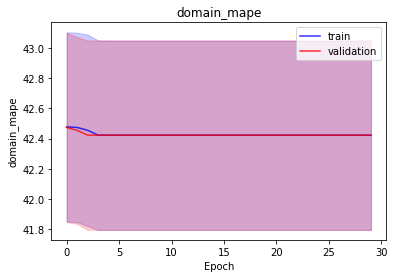

<b>latent_mae</b>: 0.3867 (min: 0.3617, max: 0.4117)

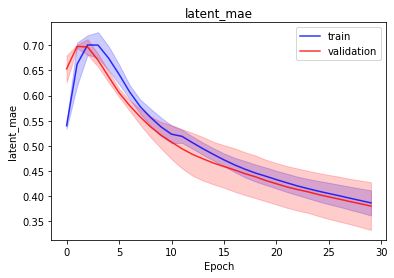

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 972420.6250 (min: 784648.2500, max: 1160193.0000)

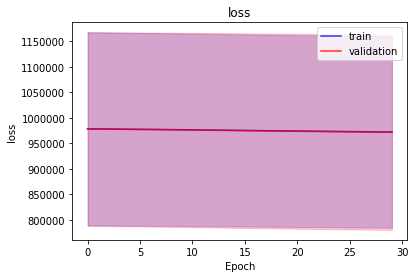

<b>bioma_loss</b>: 486210.1875 (min: 392324.0312, max: 580096.3750)

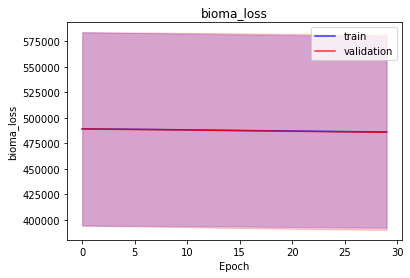

<b>domain_loss</b>: 486210.1875 (min: 392324.0312, max: 580096.3750)

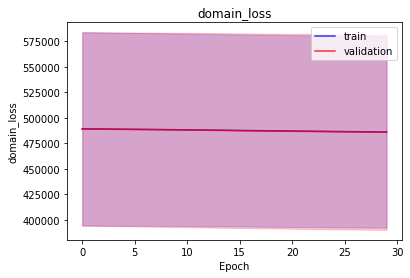

<b>latent_loss</b>: 0.2339 (min: 0.1923, max: 0.2755)

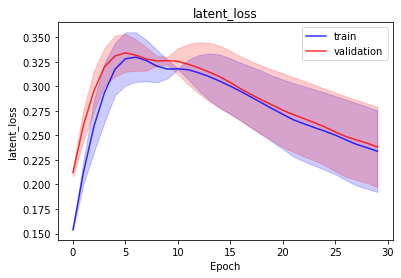

<b>bioma_mse</b>: 486210.1875 (min: 392324.0312, max: 580096.3750)

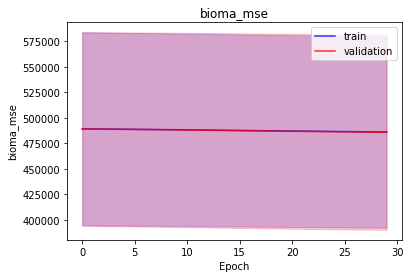

<b>bioma_mae</b>: 31.7277 (min: 31.6654, max: 31.7901)

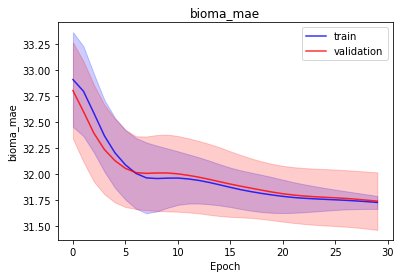

<b>bioma_mape</b>: 42.4239 (min: 41.7986, max: 43.0491)

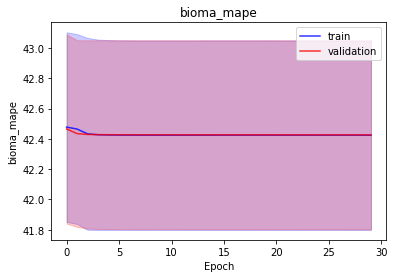

<b>domain_mse</b>: 486210.1875 (min: 392324.0312, max: 580096.3750)

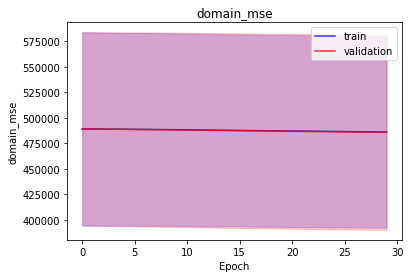

<b>domain_mae</b>: 31.7277 (min: 31.6654, max: 31.7901)

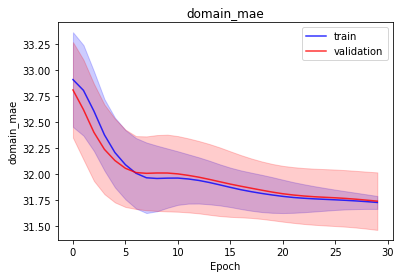

<b>domain_mape</b>: 42.4239 (min: 41.7986, max: 43.0491)

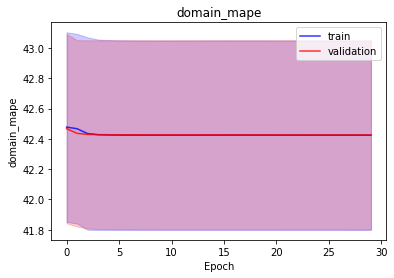

<b>latent_mae</b>: 0.2339 (min: 0.1923, max: 0.2755)

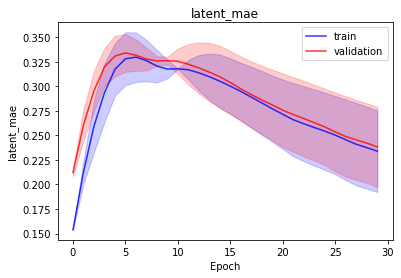

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 677322.7031 (min: 490248.9688, max: 864396.4375)

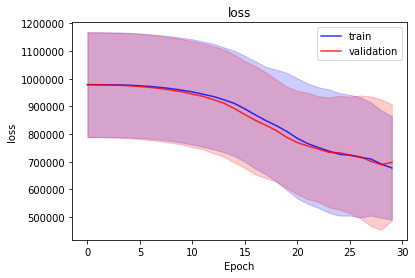

<b>bioma_loss</b>: 315456.0312 (min: 227714.5469, max: 403197.5312)

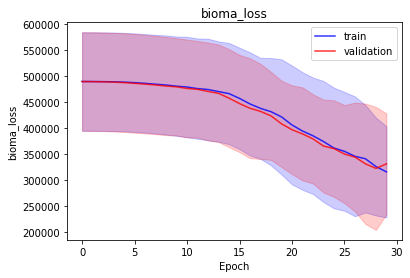

<b>domain_loss</b>: 361865.5625 (min: 262533.3438, max: 461197.7500)

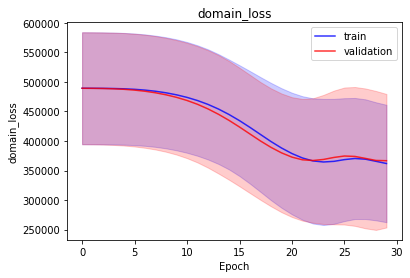

<b>latent_loss</b>: 1.1427 (min: 1.0906, max: 1.1949)

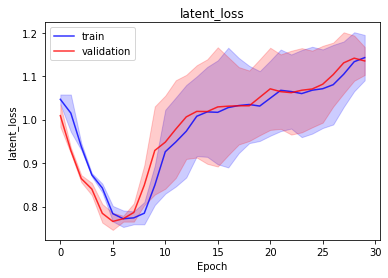

<b>bioma_mse</b>: 315456.0312 (min: 227714.5469, max: 403197.5312)

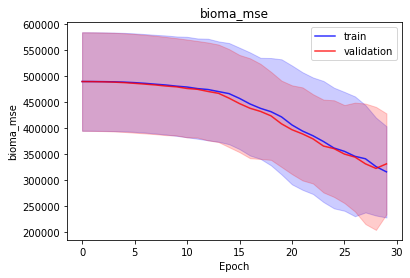

<b>bioma_mae</b>: 33.2482 (min: 32.4368, max: 34.0596)

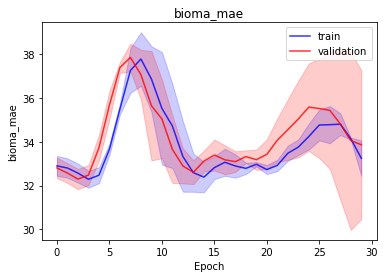

<b>bioma_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

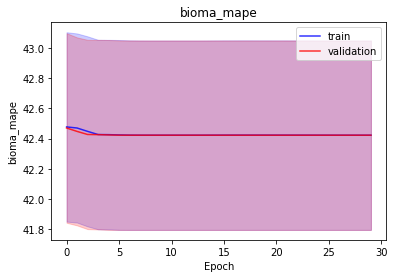

<b>domain_mse</b>: 361865.5625 (min: 262533.3438, max: 461197.7500)

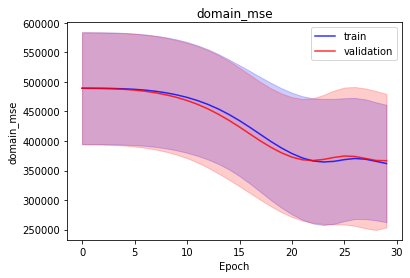

<b>domain_mae</b>: 37.2930 (min: 36.5083, max: 38.0776)

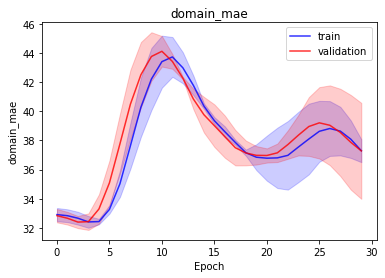

<b>domain_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

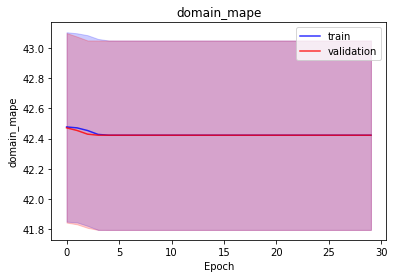

<b>latent_mae</b>: 1.1427 (min: 1.0906, max: 1.1949)

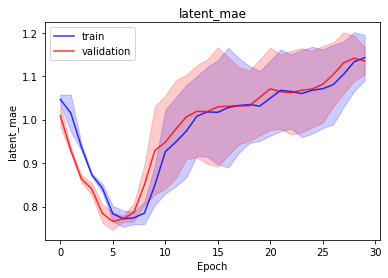

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 748972.7812 (min: 513772.2500, max: 984173.3125)

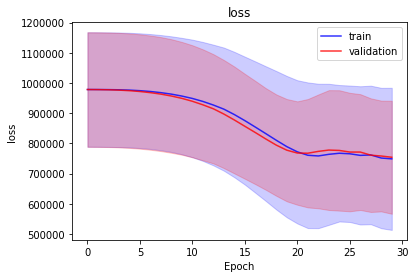

<b>bioma_loss</b>: 373634.1562 (min: 237444.6875, max: 509823.6250)

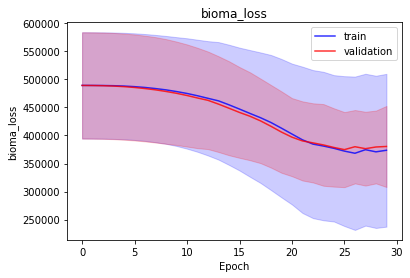

<b>domain_loss</b>: 375337.8750 (min: 276326.9375, max: 474348.8438)

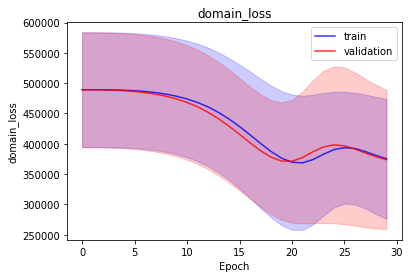

<b>latent_loss</b>: 0.7175 (min: 0.6392, max: 0.7959)

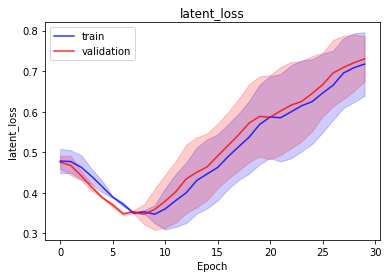

<b>bioma_mse</b>: 373634.1562 (min: 237444.6875, max: 509823.6250)

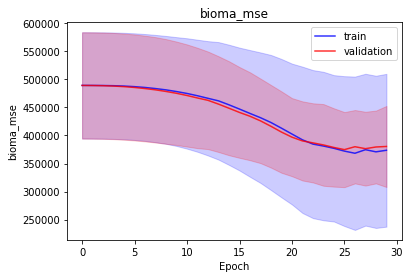

<b>bioma_mae</b>: 31.4471 (min: 31.2827, max: 31.6115)

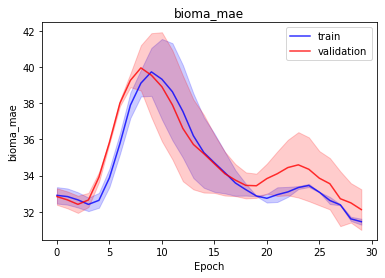

<b>bioma_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

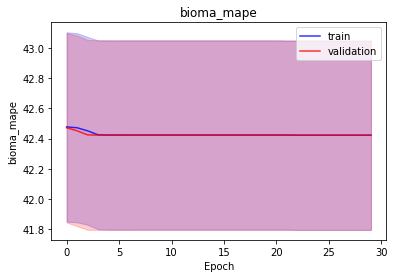

<b>domain_mse</b>: 375337.8750 (min: 276326.9375, max: 474348.8438)

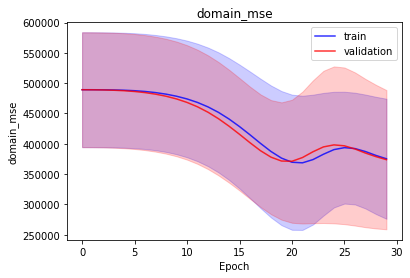

<b>domain_mae</b>: 39.0681 (min: 37.5069, max: 40.6293)

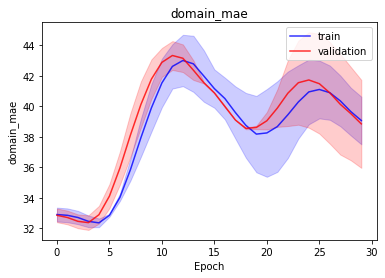

<b>domain_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

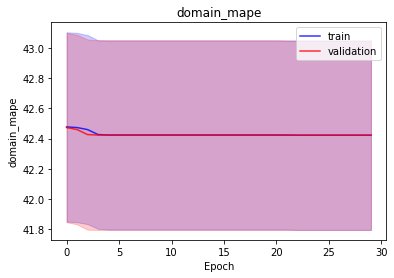

<b>latent_mae</b>: 0.7175 (min: 0.6392, max: 0.7959)

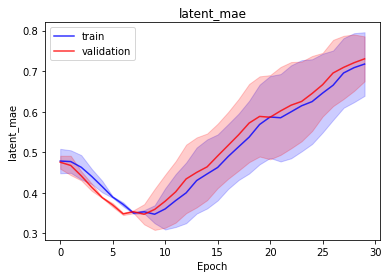

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 972578.1562 (min: 782797.9375, max: 1162358.3750)

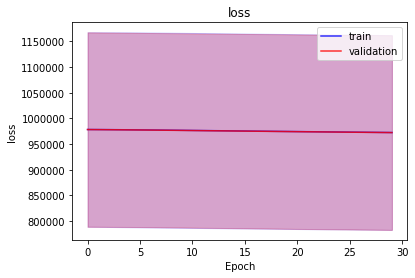

<b>bioma_loss</b>: 486289.0625 (min: 391398.9062, max: 581179.1875)

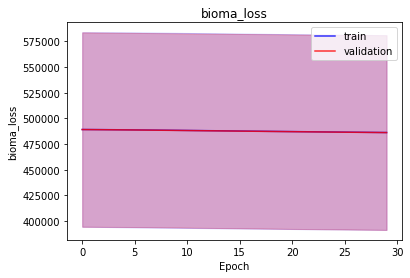

<b>domain_loss</b>: 486289.0625 (min: 391398.9062, max: 581179.1875)

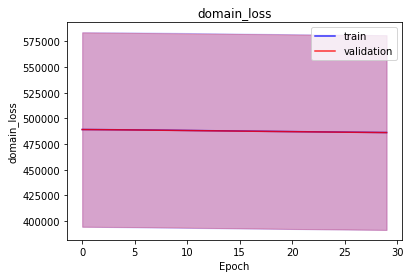

<b>latent_loss</b>: 0.1077 (min: 0.0609, max: 0.1544)

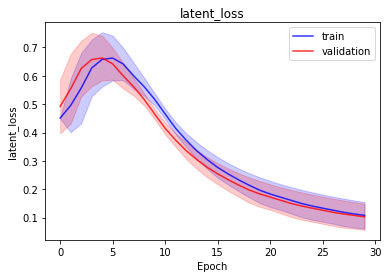

<b>bioma_mse</b>: 486289.0625 (min: 391398.9062, max: 581179.1875)

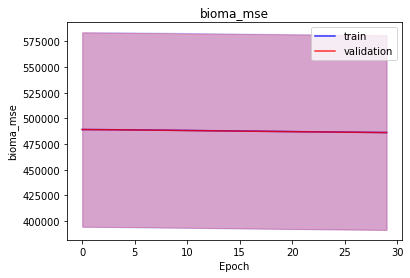

<b>bioma_mae</b>: 31.8409 (min: 31.7873, max: 31.8945)

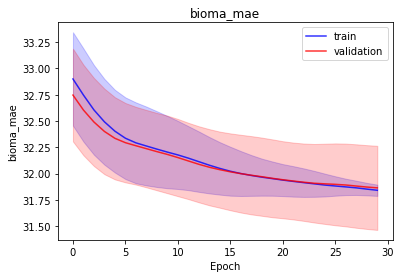

<b>bioma_mape</b>: 42.4249 (min: 41.8009, max: 43.0488)

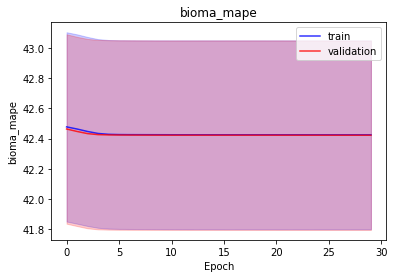

<b>domain_mse</b>: 486289.0625 (min: 391398.9062, max: 581179.1875)

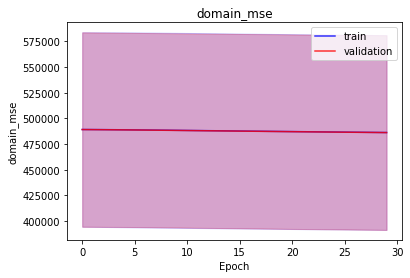

<b>domain_mae</b>: 31.8409 (min: 31.7873, max: 31.8945)

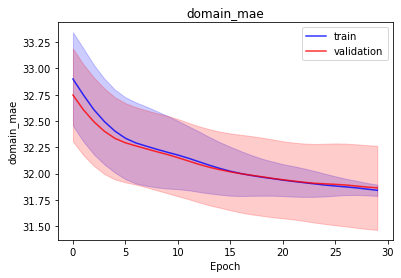

<b>domain_mape</b>: 42.4249 (min: 41.8009, max: 43.0488)

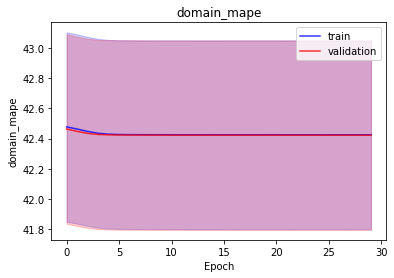

<b>latent_mae</b>: 0.1077 (min: 0.0609, max: 0.1544)

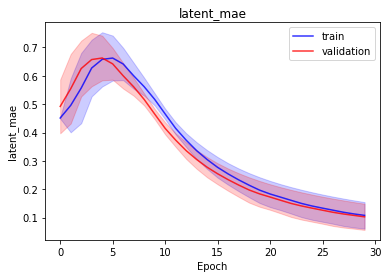

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974355.0312 (min: 786090.8125, max: 1162619.2500)

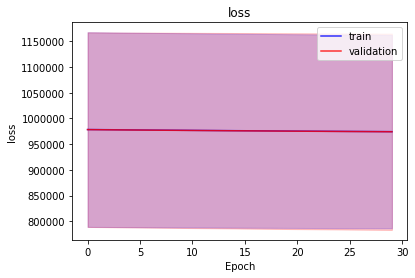

<b>bioma_loss</b>: 487177.4375 (min: 393045.3750, max: 581309.5000)

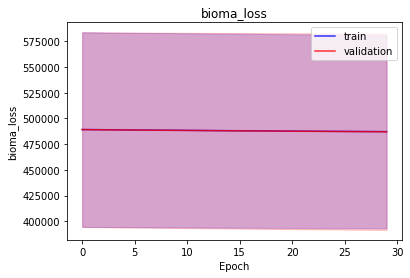

<b>domain_loss</b>: 487177.4375 (min: 393045.3750, max: 581309.5000)

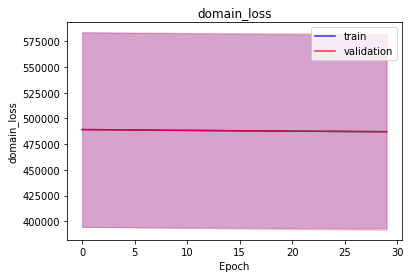

<b>latent_loss</b>: 0.1748 (min: 0.0771, max: 0.2726)

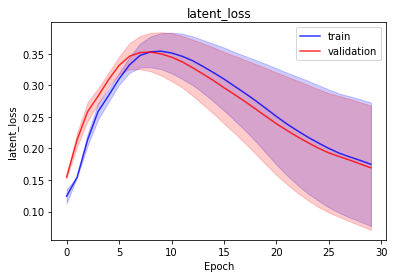

<b>bioma_mse</b>: 487177.4375 (min: 393045.3750, max: 581309.5000)

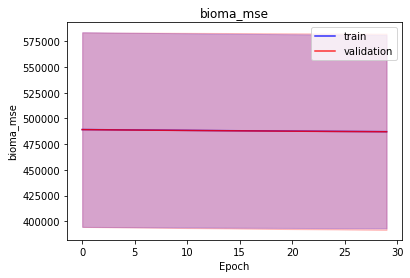

<b>bioma_mae</b>: 31.9708 (min: 31.8160, max: 32.1255)

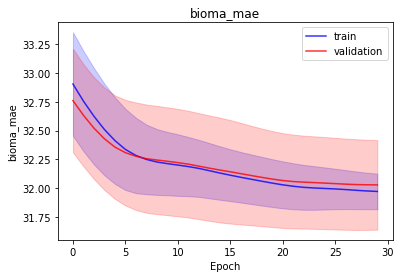

<b>bioma_mape</b>: 42.4236 (min: 41.7965, max: 43.0506)

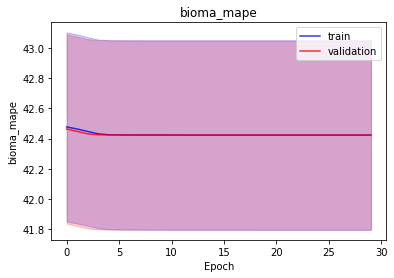

<b>domain_mse</b>: 487177.4375 (min: 393045.3750, max: 581309.5000)

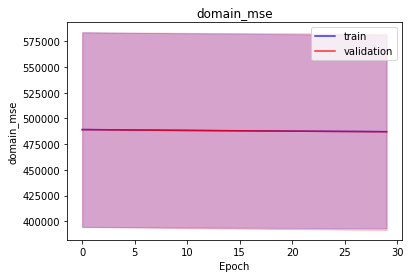

<b>domain_mae</b>: 31.9708 (min: 31.8160, max: 32.1255)

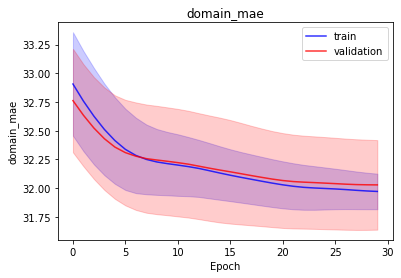

<b>domain_mape</b>: 42.4236 (min: 41.7965, max: 43.0506)

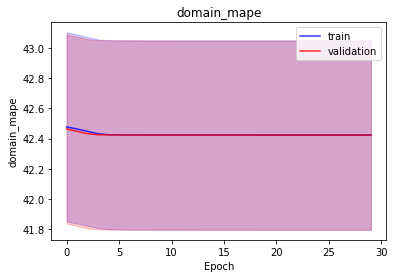

<b>latent_mae</b>: 0.1748 (min: 0.0771, max: 0.2726)

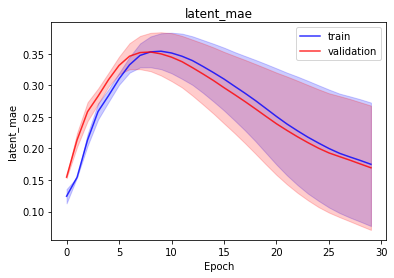

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973695.3438 (min: 783993.0625, max: 1163397.6250)

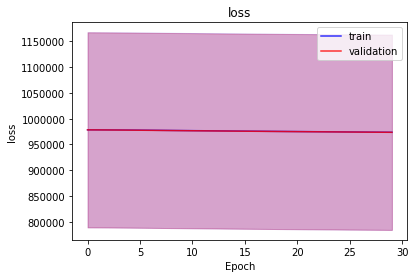

<b>bioma_loss</b>: 486842.1875 (min: 391993.9062, max: 581690.5000)

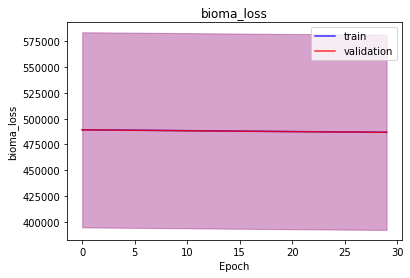

<b>domain_loss</b>: 486852.8750 (min: 391998.9688, max: 581706.8125)

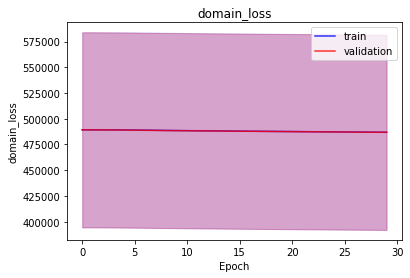

<b>latent_loss</b>: 0.3085 (min: 0.1898, max: 0.4272)

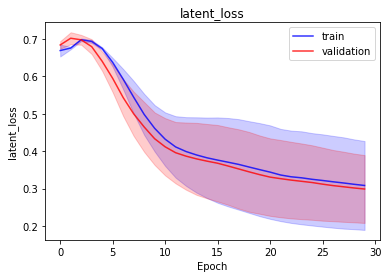

<b>bioma_mse</b>: 486842.1875 (min: 391993.9062, max: 581690.5000)

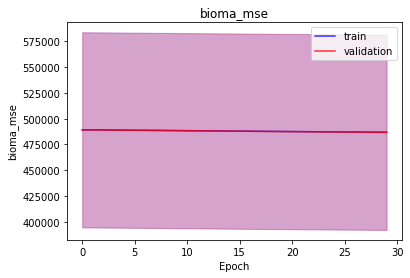

<b>bioma_mae</b>: 31.1134 (min: 30.9070, max: 31.3198)

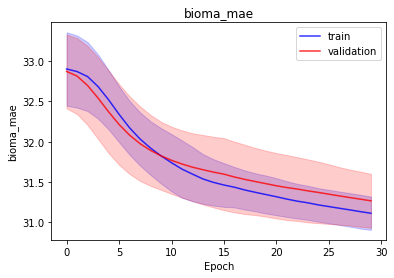

<b>bioma_mape</b>: 42.4267 (min: 41.8006, max: 43.0528)

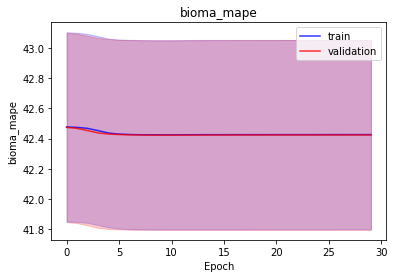

<b>domain_mse</b>: 486852.8750 (min: 391998.9688, max: 581706.8125)

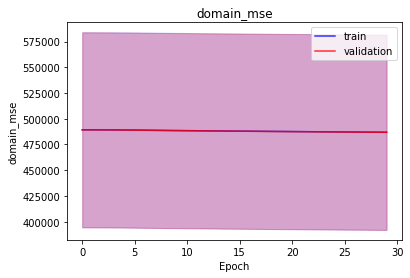

<b>domain_mae</b>: 31.3960 (min: 31.2961, max: 31.4959)

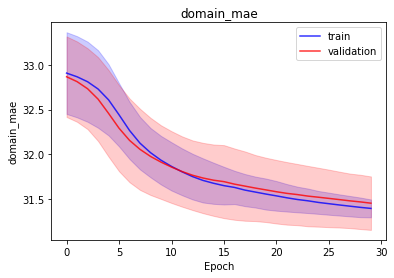

<b>domain_mape</b>: 42.4226 (min: 41.7966, max: 43.0487)

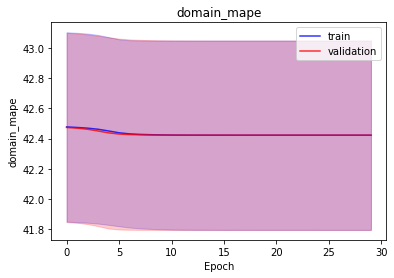

<b>latent_mae</b>: 0.3085 (min: 0.1898, max: 0.4272)

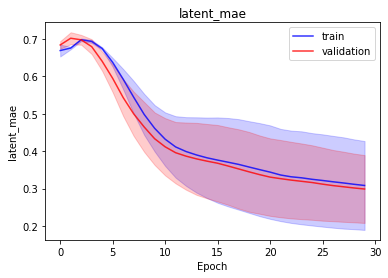

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974438.0938 (min: 785292.4375, max: 1163583.7500)

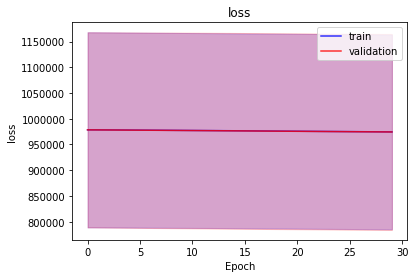

<b>bioma_loss</b>: 487217.8750 (min: 392645.9688, max: 581789.7500)

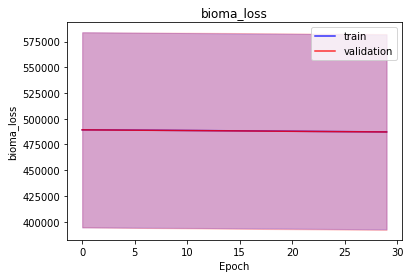

<b>domain_loss</b>: 487220.0625 (min: 392646.3125, max: 581793.8125)

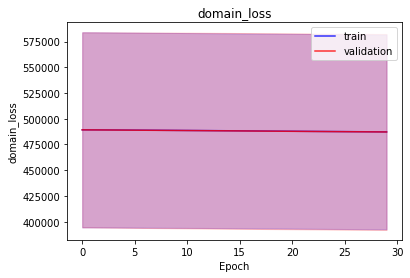

<b>latent_loss</b>: 0.2029 (min: 0.1880, max: 0.2179)

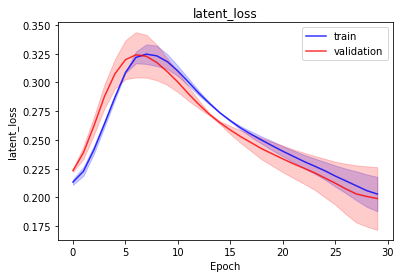

<b>bioma_mse</b>: 487217.8750 (min: 392645.9688, max: 581789.7500)

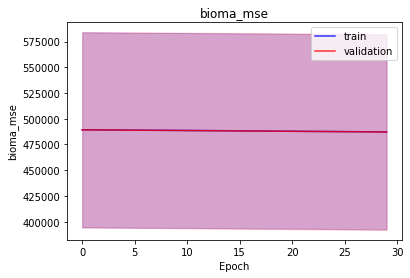

<b>bioma_mae</b>: 31.4632 (min: 31.2798, max: 31.6467)

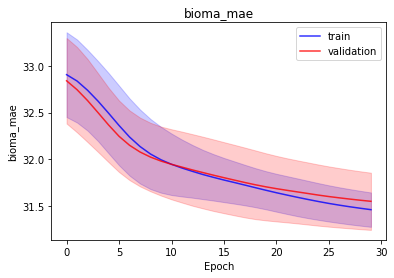

<b>bioma_mape</b>: 42.4239 (min: 41.7973, max: 43.0506)

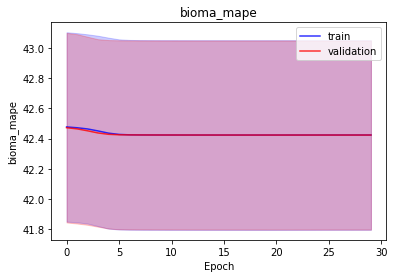

<b>domain_mse</b>: 487220.0625 (min: 392646.3125, max: 581793.8125)

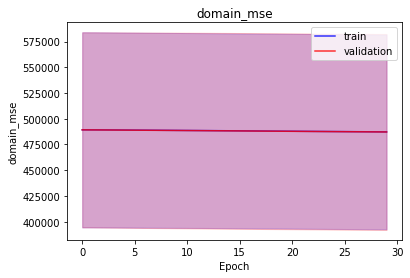

<b>domain_mae</b>: 31.5109 (min: 31.3690, max: 31.6528)

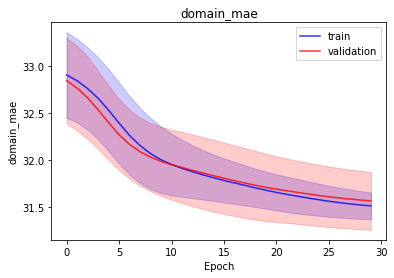

<b>domain_mape</b>: 42.4235 (min: 41.7965, max: 43.0506)

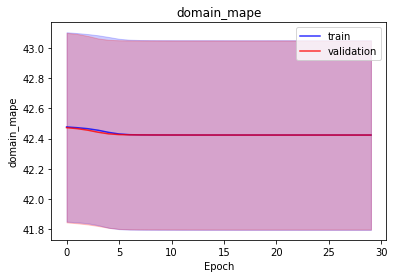

<b>latent_mae</b>: 0.2029 (min: 0.1880, max: 0.2179)

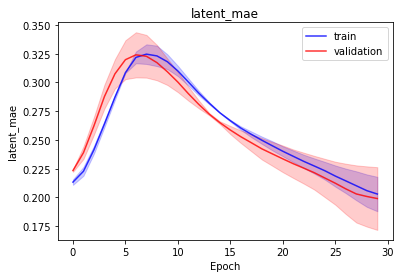

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 951772.5938 (min: 757174.3125, max: 1146370.8750)

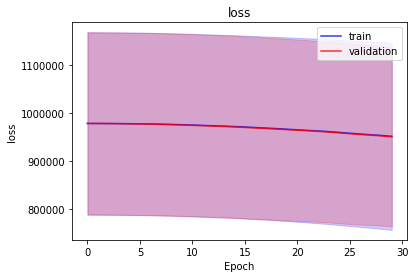

<b>bioma_loss</b>: 477588.0625 (min: 378892.6875, max: 576283.4375)

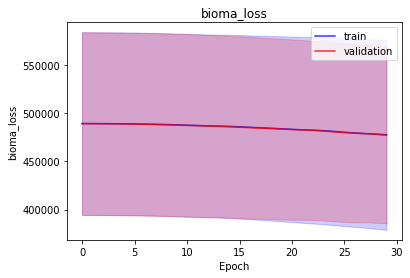

<b>domain_loss</b>: 474183.8125 (min: 378281.0938, max: 570086.5625)

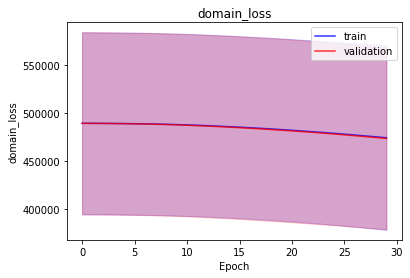

<b>latent_loss</b>: 0.7054 (min: 0.5909, max: 0.8200)

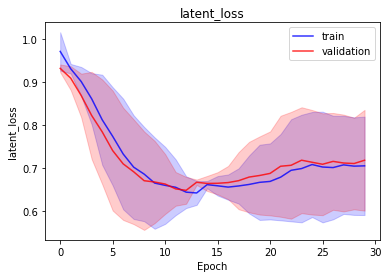

<b>bioma_mse</b>: 477588.0625 (min: 378892.6875, max: 576283.4375)

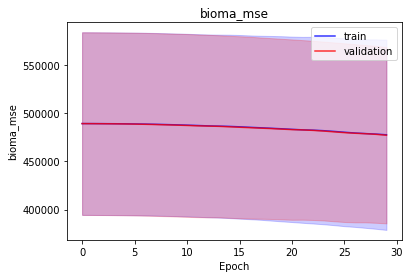

<b>bioma_mae</b>: 31.7211 (min: 30.8263, max: 32.6159)

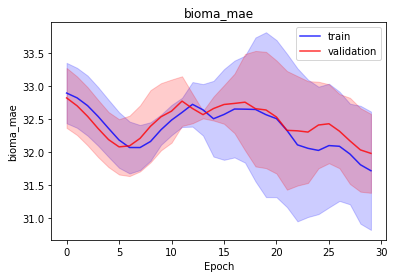

<b>bioma_mape</b>: 42.4267 (min: 41.8006, max: 43.0528)

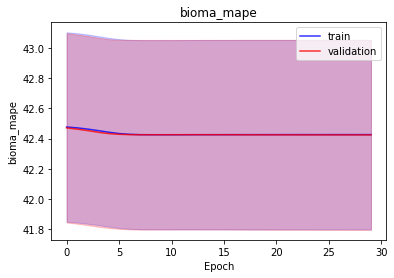

<b>domain_mse</b>: 474183.8125 (min: 378281.0938, max: 570086.5625)

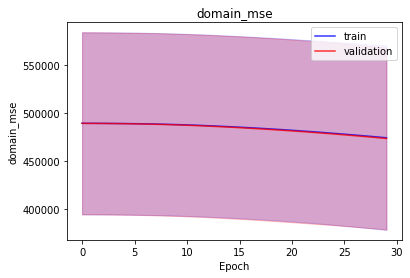

<b>domain_mae</b>: 33.2567 (min: 33.1224, max: 33.3910)

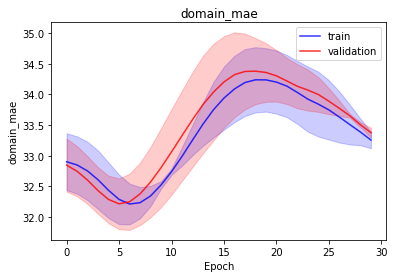

<b>domain_mape</b>: 42.4225 (min: 41.7964, max: 43.0486)

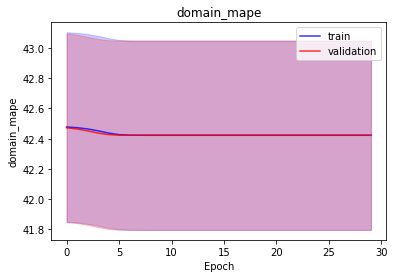

<b>latent_mae</b>: 0.7054 (min: 0.5909, max: 0.8200)

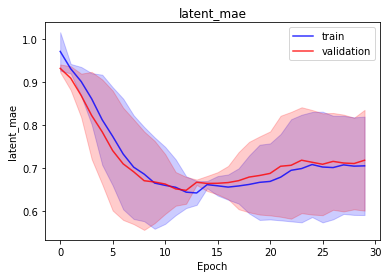

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 955622.7500 (min: 754501.3750, max: 1156744.1250)

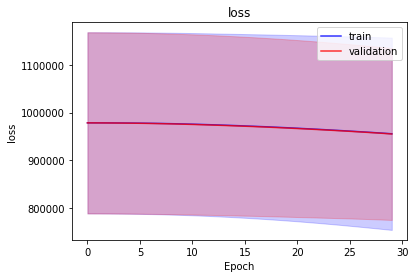

<b>bioma_loss</b>: 478951.0000 (min: 378317.8438, max: 579584.1250)

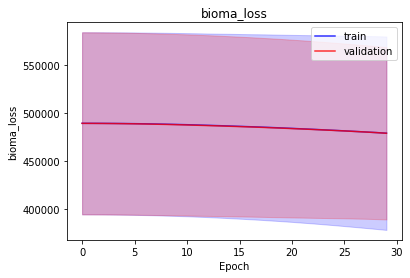

<b>domain_loss</b>: 476671.5625 (min: 376183.4062, max: 577159.6875)

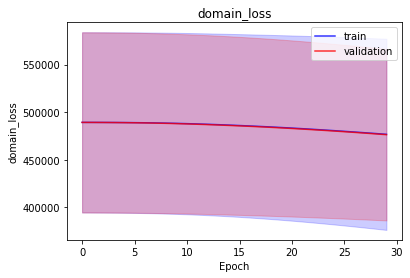

<b>latent_loss</b>: 0.2848 (min: 0.1512, max: 0.4184)

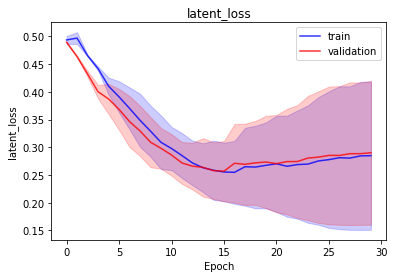

<b>bioma_mse</b>: 478951.0000 (min: 378317.8438, max: 579584.1250)

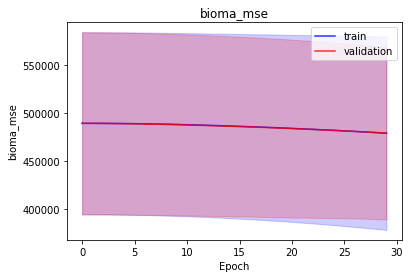

<b>bioma_mae</b>: 31.3452 (min: 30.7208, max: 31.9696)

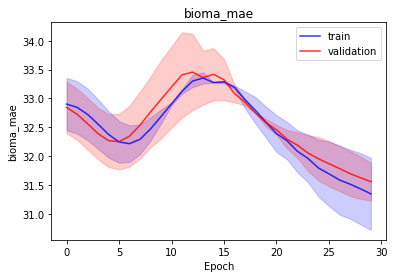

<b>bioma_mape</b>: 42.4247 (min: 41.8008, max: 43.0486)

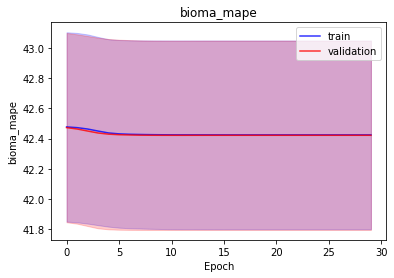

<b>domain_mse</b>: 476671.5625 (min: 376183.4062, max: 577159.6875)

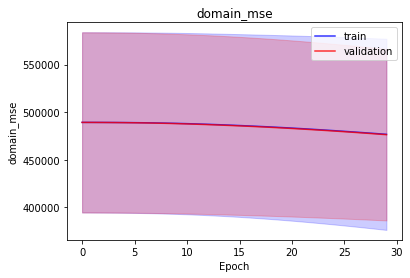

<b>domain_mae</b>: 33.6050 (min: 32.9436, max: 34.2665)

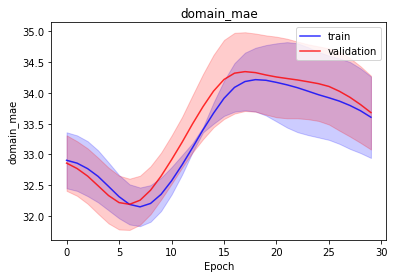

<b>domain_mape</b>: 42.4247 (min: 41.8008, max: 43.0486)

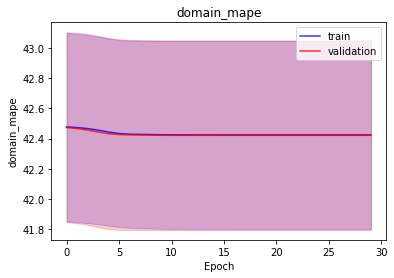

<b>latent_mae</b>: 0.2848 (min: 0.1512, max: 0.4184)

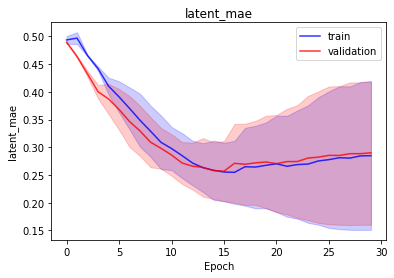

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976198.2812 (min: 788180.4375, max: 1164216.1250)

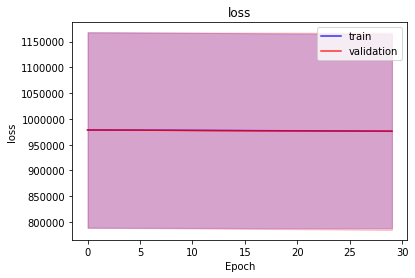

<b>bioma_loss</b>: 488097.5625 (min: 394090.1562, max: 582104.9375)

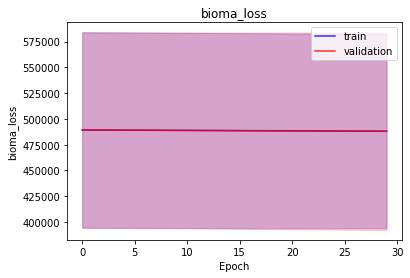

<b>domain_loss</b>: 488100.5625 (min: 394090.1562, max: 582110.9375)

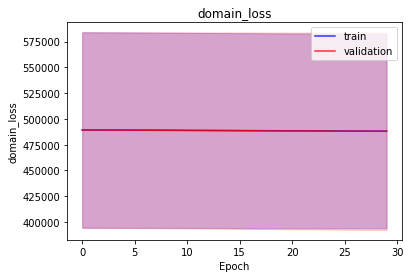

<b>latent_loss</b>: 0.1786 (min: 0.1104, max: 0.2468)

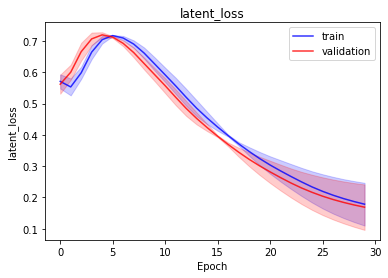

<b>bioma_mse</b>: 488097.5625 (min: 394090.1562, max: 582104.9375)

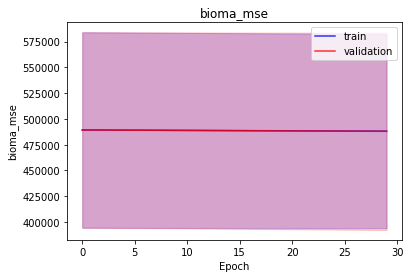

<b>bioma_mae</b>: 32.0287 (min: 31.6703, max: 32.3871)

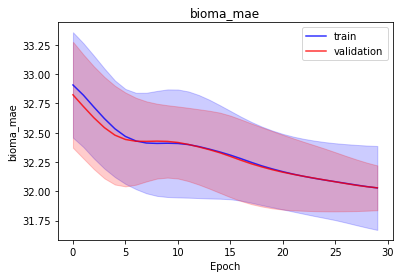

<b>bioma_mape</b>: 42.4257 (min: 41.8009, max: 43.0504)

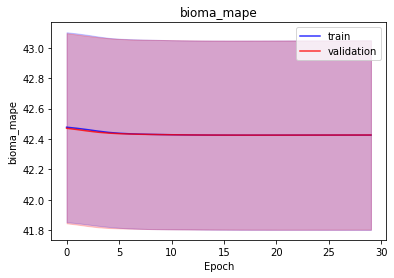

<b>domain_mse</b>: 488100.5625 (min: 394090.1562, max: 582110.9375)

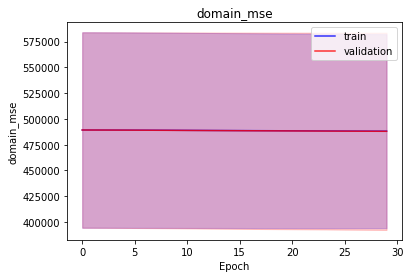

<b>domain_mae</b>: 32.0189 (min: 31.6509, max: 32.3870)

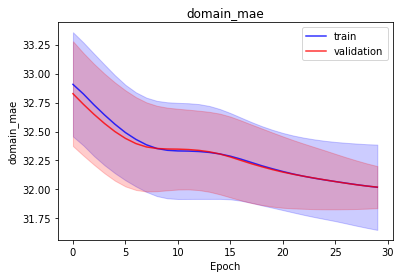

<b>domain_mape</b>: 42.4256 (min: 41.8008, max: 43.0504)

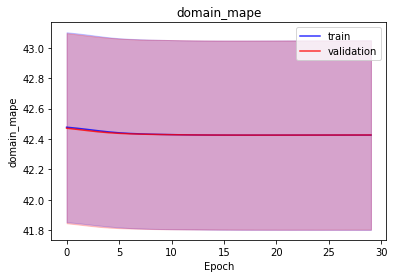

<b>latent_mae</b>: 0.1786 (min: 0.1104, max: 0.2468)

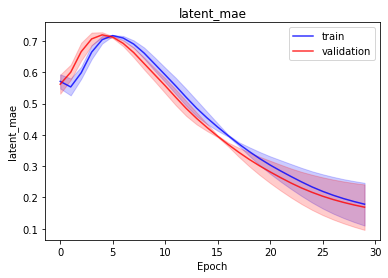

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976979.2812 (min: 786868.8125, max: 1167089.7500)

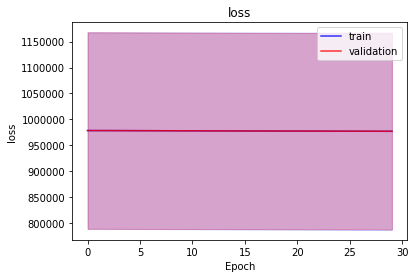

<b>bioma_loss</b>: 488489.3750 (min: 393434.0312, max: 583544.7500)

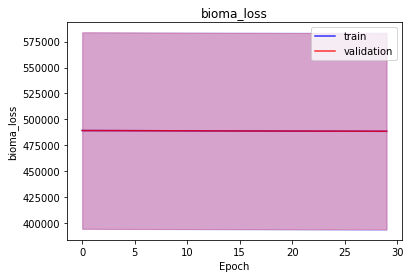

<b>domain_loss</b>: 488489.6875 (min: 393434.5625, max: 583544.8125)

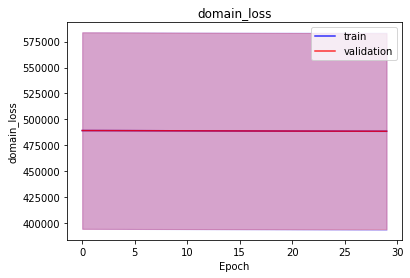

<b>latent_loss</b>: 0.2129 (min: 0.1967, max: 0.2291)

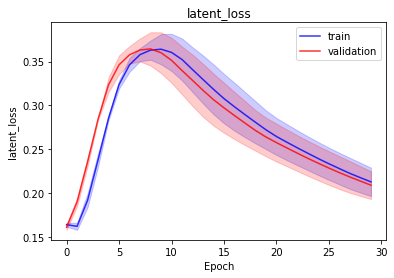

<b>bioma_mse</b>: 488489.3750 (min: 393434.0312, max: 583544.7500)

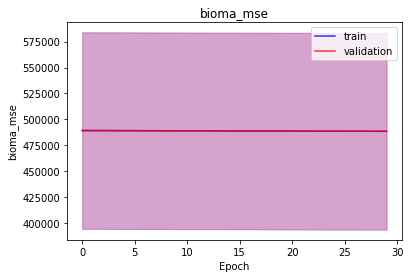

<b>bioma_mae</b>: 31.9893 (min: 31.7799, max: 32.1987)

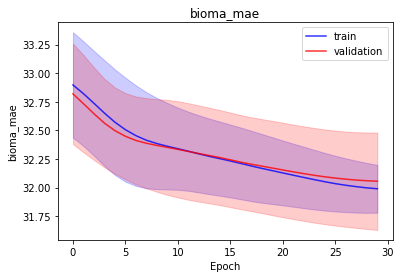

<b>bioma_mape</b>: 42.4268 (min: 41.8035, max: 43.0501)

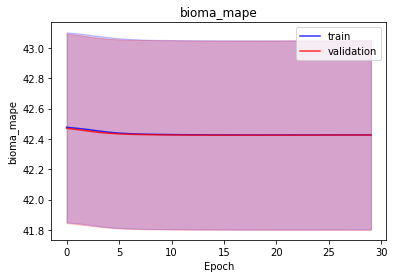

<b>domain_mse</b>: 488489.6875 (min: 393434.5625, max: 583544.8125)

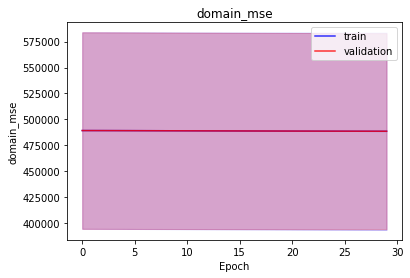

<b>domain_mae</b>: 31.9885 (min: 31.7793, max: 32.1977)

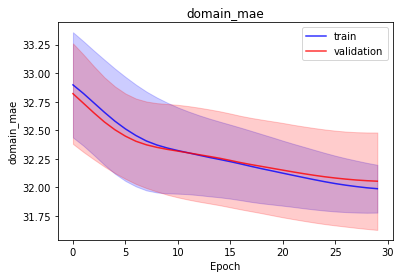

<b>domain_mape</b>: 42.4268 (min: 41.8035, max: 43.0501)

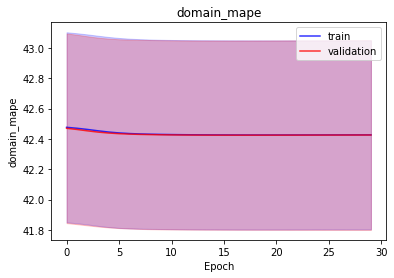

<b>latent_mae</b>: 0.2129 (min: 0.1967, max: 0.2291)

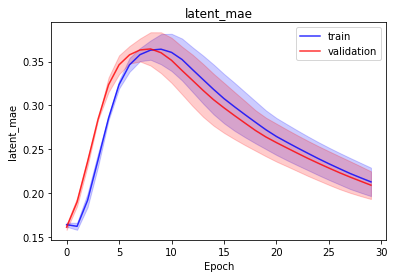

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977243.2812 (min: 787749.9375, max: 1166736.6250)

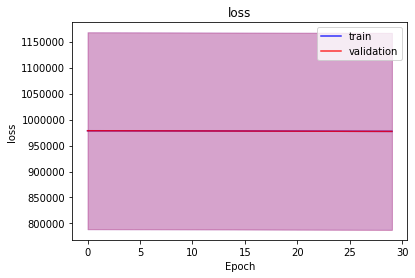

<b>bioma_loss</b>: 488494.3750 (min: 393666.8125, max: 583321.9375)

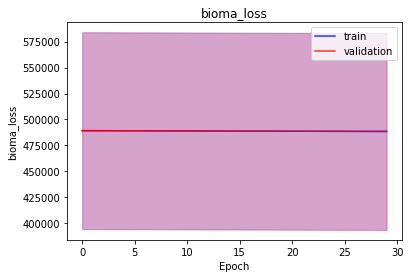

<b>domain_loss</b>: 488748.1875 (min: 394082.3750, max: 583414.0000)

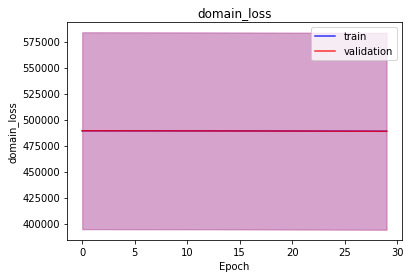

<b>latent_loss</b>: 0.6606 (min: 0.5659, max: 0.7554)

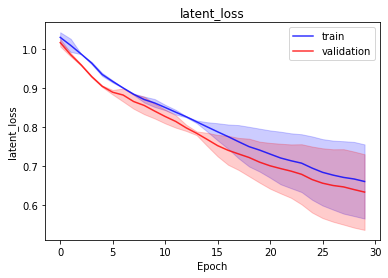

<b>bioma_mse</b>: 488494.3750 (min: 393666.8125, max: 583321.9375)

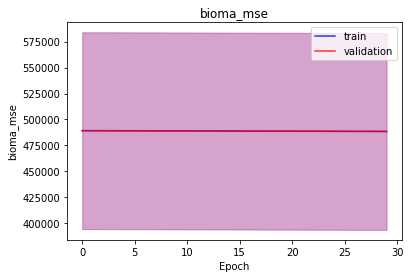

<b>bioma_mae</b>: 31.4503 (min: 31.0303, max: 31.8703)

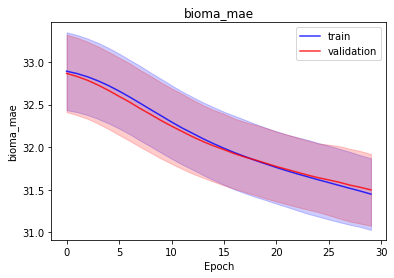

<b>bioma_mape</b>: 42.4274 (min: 41.8043, max: 43.0504)

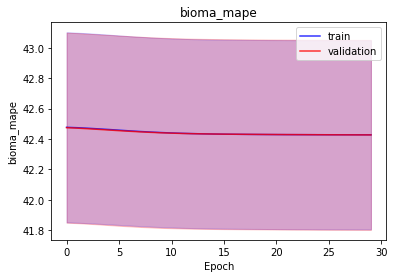

<b>domain_mse</b>: 488748.1875 (min: 394082.3750, max: 583414.0000)

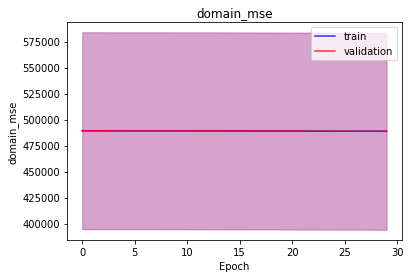

<b>domain_mae</b>: 31.6881 (min: 31.4458, max: 31.9305)

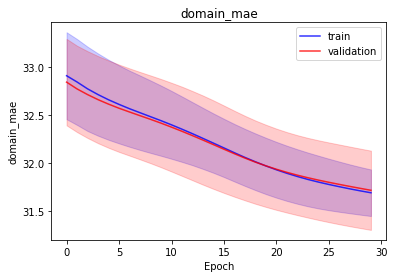

<b>domain_mape</b>: 42.4262 (min: 41.8037, max: 43.0487)

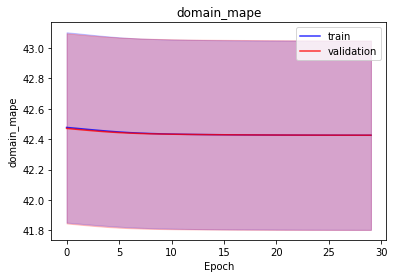

<b>latent_mae</b>: 0.6606 (min: 0.5659, max: 0.7554)

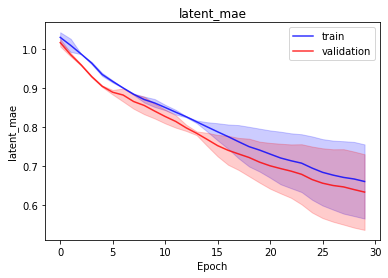

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977120.5625 (min: 787876.3750, max: 1166364.7500)

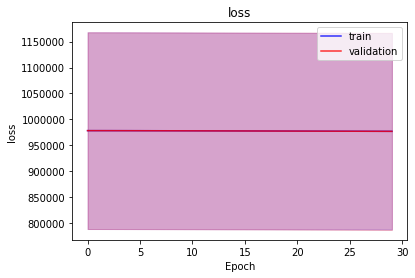

<b>bioma_loss</b>: 488561.6250 (min: 393920.0312, max: 583203.2500)

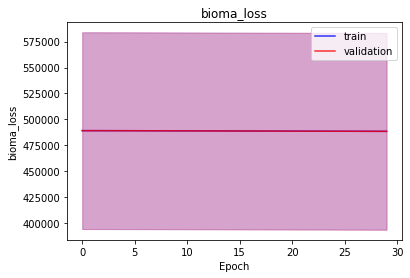

<b>domain_loss</b>: 488558.6875 (min: 393956.1562, max: 583161.2500)

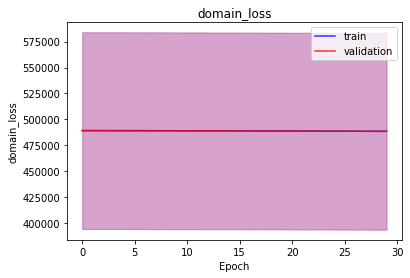

<b>latent_loss</b>: 0.2005 (min: 0.1836, max: 0.2175)

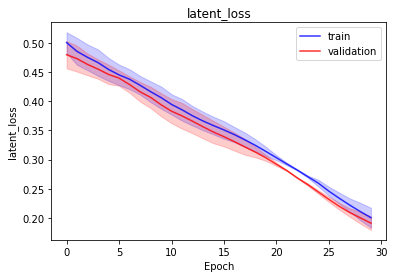

<b>bioma_mse</b>: 488561.6250 (min: 393920.0312, max: 583203.2500)

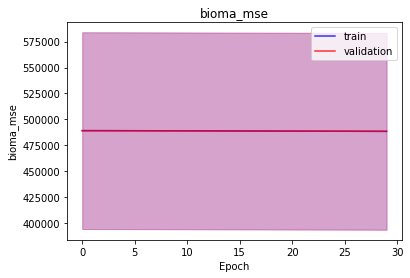

<b>bioma_mae</b>: 31.5858 (min: 31.2348, max: 31.9368)

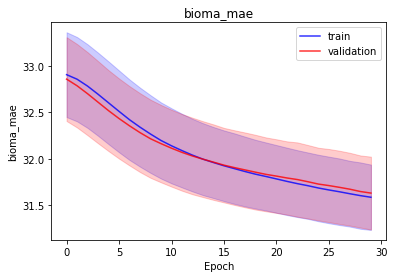

<b>bioma_mape</b>: 42.4268 (min: 41.8042, max: 43.0494)

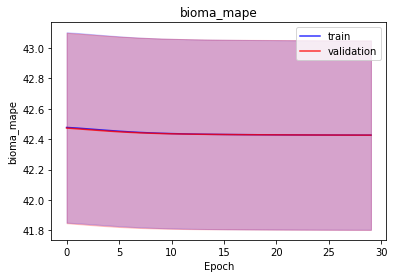

<b>domain_mse</b>: 488558.6875 (min: 393956.1562, max: 583161.2500)

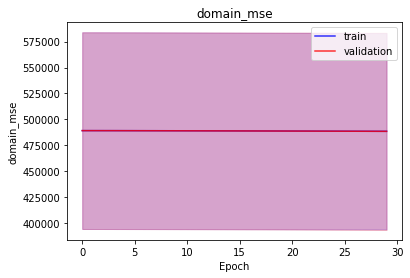

<b>domain_mae</b>: 31.7630 (min: 31.5096, max: 32.0164)

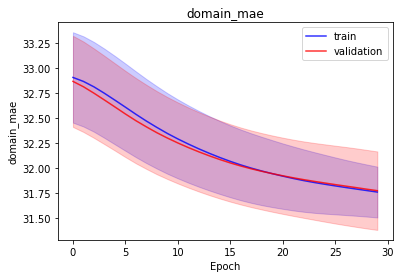

<b>domain_mape</b>: 42.4267 (min: 41.8036, max: 43.0497)

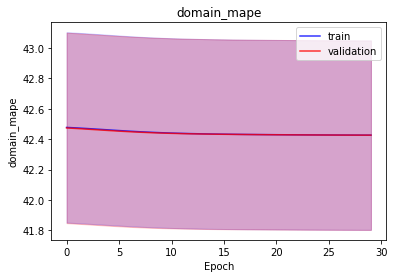

<b>latent_mae</b>: 0.2005 (min: 0.1836, max: 0.2175)

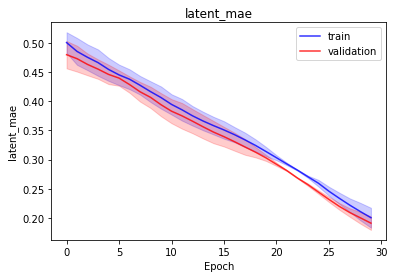

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977023.0938 (min: 787362.6875, max: 1166683.5000)

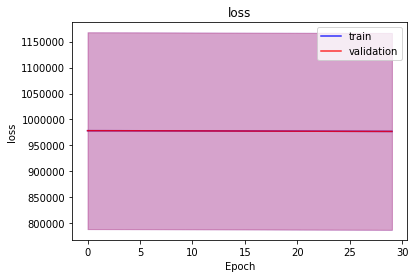

<b>bioma_loss</b>: 488534.9688 (min: 393708.1875, max: 583361.7500)

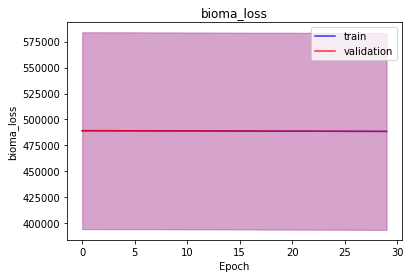

<b>domain_loss</b>: 488487.6250 (min: 393654.0312, max: 583321.1875)

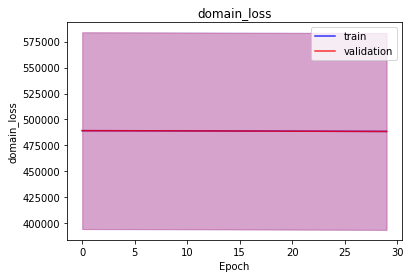

<b>latent_loss</b>: 0.4816 (min: 0.4109, max: 0.5522)

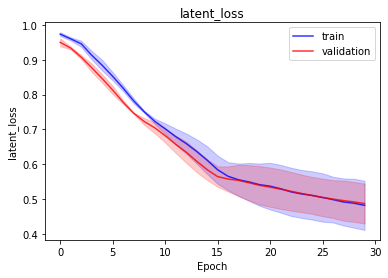

<b>bioma_mse</b>: 488534.9688 (min: 393708.1875, max: 583361.7500)

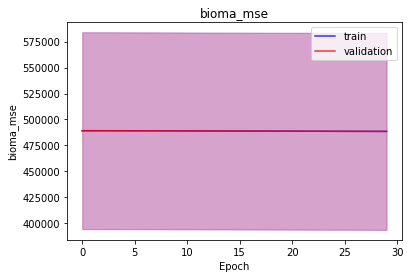

<b>bioma_mae</b>: 31.3815 (min: 30.9889, max: 31.7741)

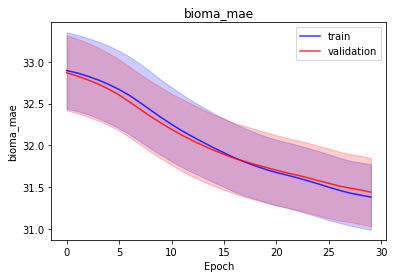

<b>bioma_mape</b>: 42.4275 (min: 41.8045, max: 43.0504)

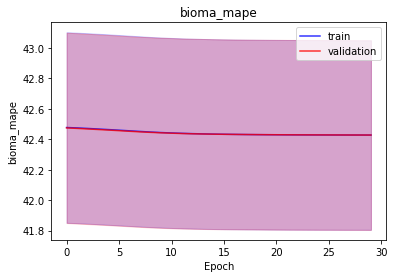

<b>domain_mse</b>: 488487.6250 (min: 393654.0312, max: 583321.1875)

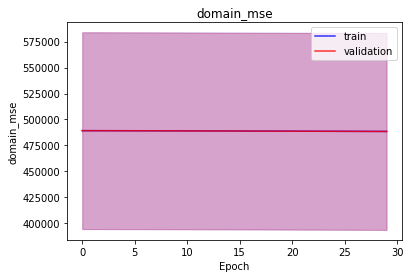

<b>domain_mae</b>: 31.6239 (min: 31.4022, max: 31.8456)

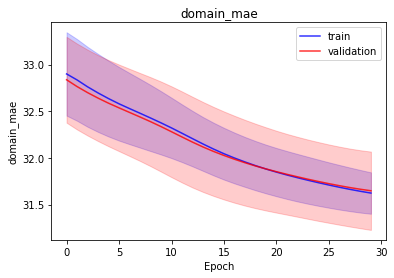

<b>domain_mape</b>: 42.4256 (min: 41.8027, max: 43.0485)

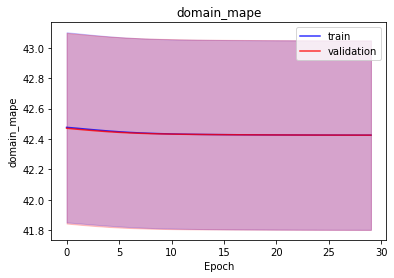

<b>latent_mae</b>: 0.4816 (min: 0.4109, max: 0.5522)

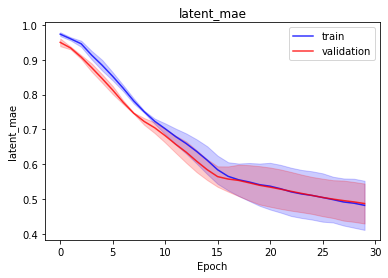

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976831.4375 (min: 787298.6250, max: 1166364.2500)

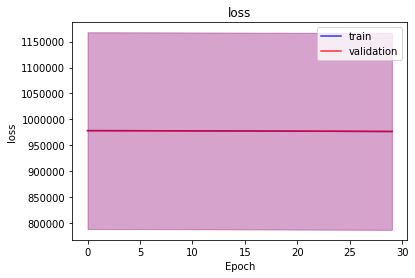

<b>bioma_loss</b>: 488425.8125 (min: 393646.9062, max: 583204.6875)

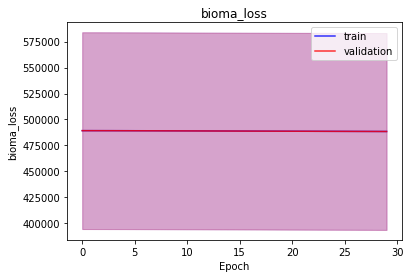

<b>domain_loss</b>: 488405.3438 (min: 393651.4375, max: 583159.2500)

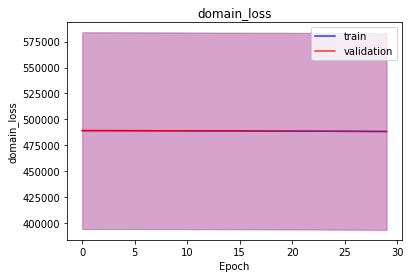

<b>latent_loss</b>: 0.2840 (min: 0.2776, max: 0.2903)

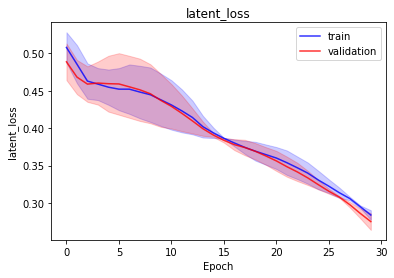

<b>bioma_mse</b>: 488425.8125 (min: 393646.9062, max: 583204.6875)

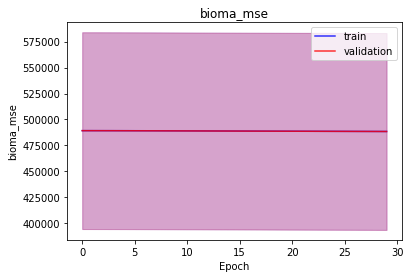

<b>bioma_mae</b>: 31.5296 (min: 31.1892, max: 31.8700)

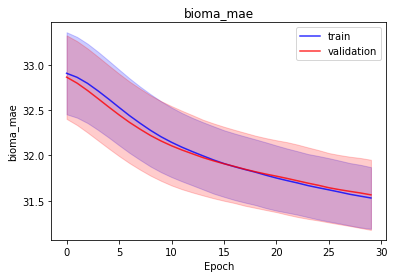

<b>bioma_mape</b>: 42.4271 (min: 41.8041, max: 43.0500)

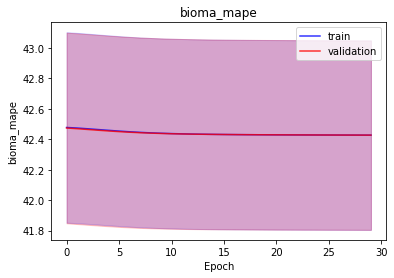

<b>domain_mse</b>: 488405.3438 (min: 393651.4375, max: 583159.2500)

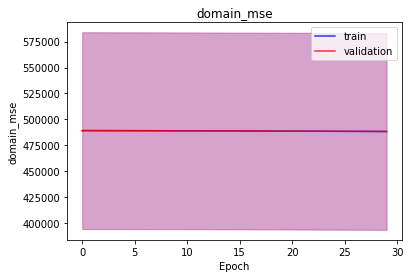

<b>domain_mae</b>: 31.7578 (min: 31.5088, max: 32.0067)

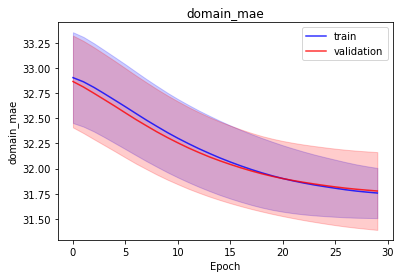

<b>domain_mape</b>: 42.4269 (min: 41.8039, max: 43.0500)

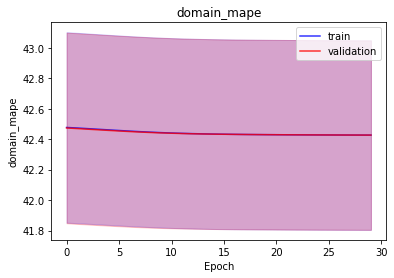

<b>latent_mae</b>: 0.2840 (min: 0.2776, max: 0.2903)

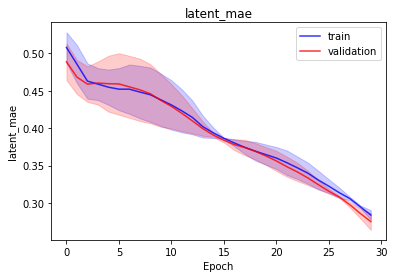

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977134.4062 (min: 787617.3125, max: 1166651.5000)

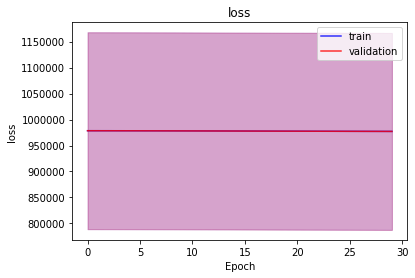

<b>bioma_loss</b>: 488513.0625 (min: 393700.9062, max: 583325.2500)

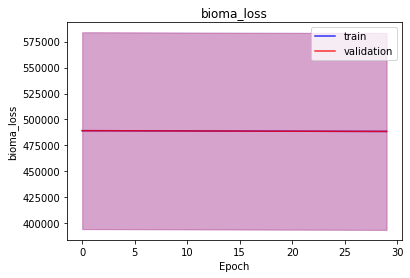

<b>domain_loss</b>: 488620.8125 (min: 393915.8438, max: 583325.7500)

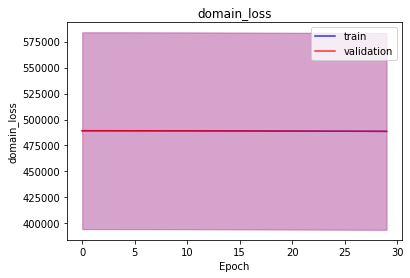

<b>latent_loss</b>: 0.5087 (min: 0.4841, max: 0.5333)

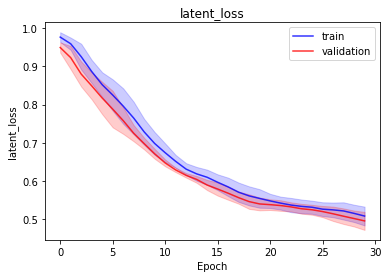

<b>bioma_mse</b>: 488513.0625 (min: 393700.9062, max: 583325.2500)

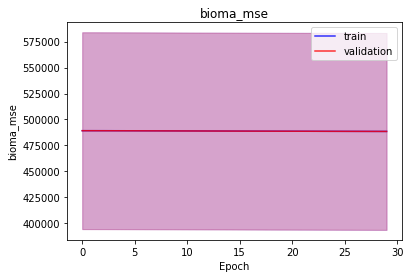

<b>bioma_mae</b>: 31.3482 (min: 30.9358, max: 31.7607)

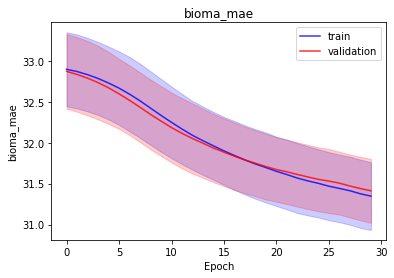

<b>bioma_mape</b>: 42.4279 (min: 41.8043, max: 43.0515)

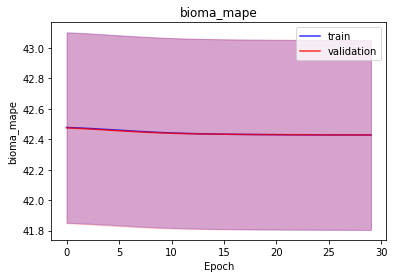

<b>domain_mse</b>: 488620.8125 (min: 393915.8438, max: 583325.7500)

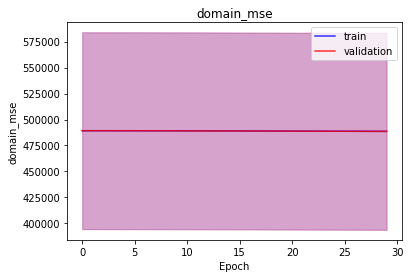

<b>domain_mae</b>: 31.6500 (min: 31.4033, max: 31.8966)

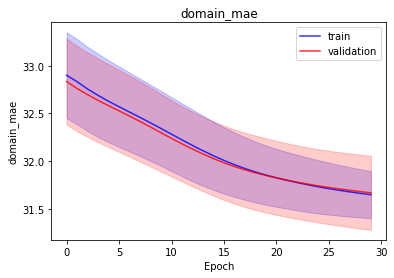

<b>domain_mape</b>: 42.4261 (min: 41.8031, max: 43.0492)

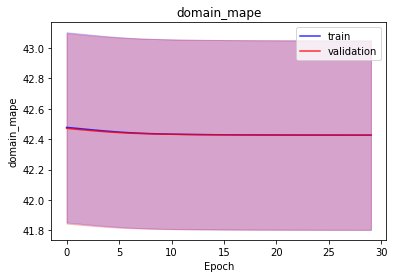

<b>latent_mae</b>: 0.5087 (min: 0.4841, max: 0.5333)

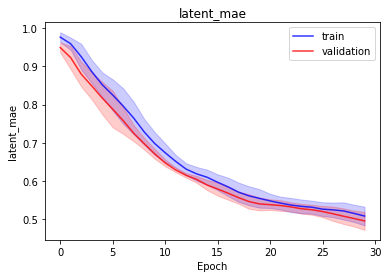

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | none |
| Output transform | ReLU |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977000.4375 (min: 787651.1250, max: 1166349.7500)

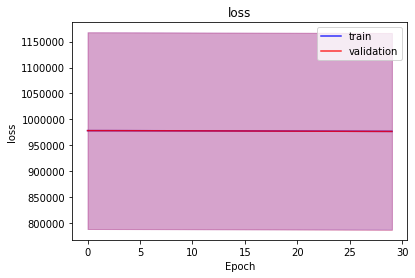

<b>bioma_loss</b>: 488493.4375 (min: 393820.8438, max: 583166.0625)

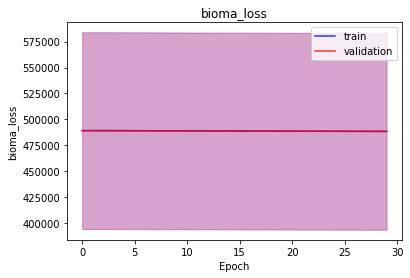

<b>domain_loss</b>: 488506.7500 (min: 393830.0938, max: 583183.3750)

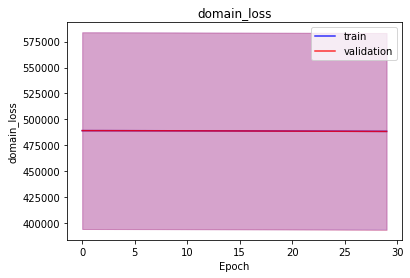

<b>latent_loss</b>: 0.2250 (min: 0.1894, max: 0.2607)

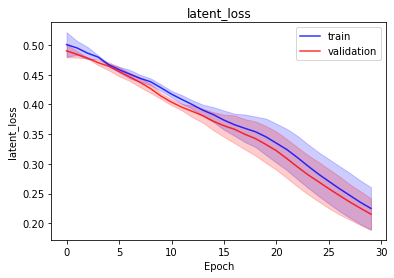

<b>bioma_mse</b>: 488493.4375 (min: 393820.8438, max: 583166.0625)

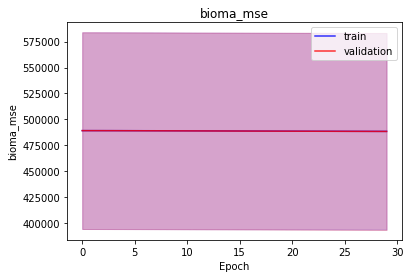

<b>bioma_mae</b>: 31.5583 (min: 31.2093, max: 31.9073)

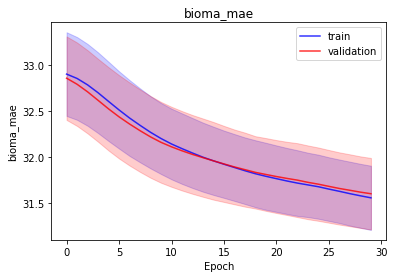

<b>bioma_mape</b>: 42.4264 (min: 41.8034, max: 43.0495)

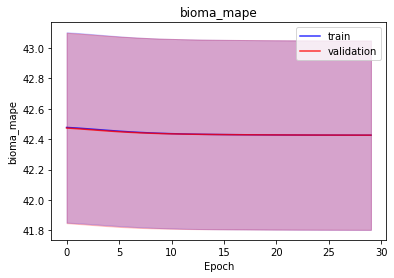

<b>domain_mse</b>: 488506.7500 (min: 393830.0938, max: 583183.3750)

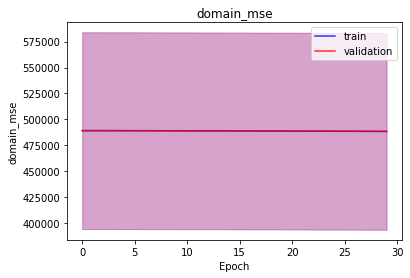

<b>domain_mae</b>: 31.7528 (min: 31.4899, max: 32.0158)

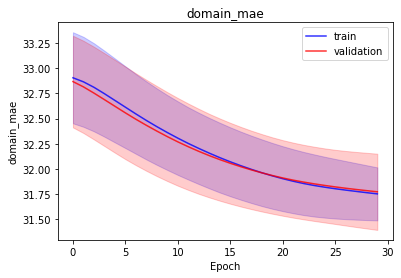

<b>domain_mape</b>: 42.4265 (min: 41.8035, max: 43.0494)

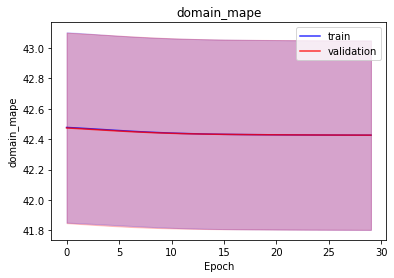

<b>latent_mae</b>: 0.2250 (min: 0.1894, max: 0.2607)

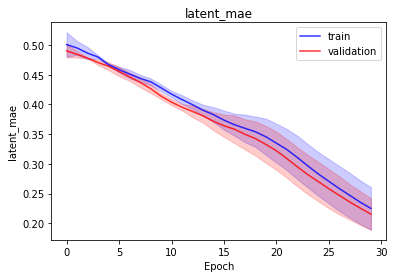

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 969590.1562 (min: 779772.0625, max: 1159408.2500)

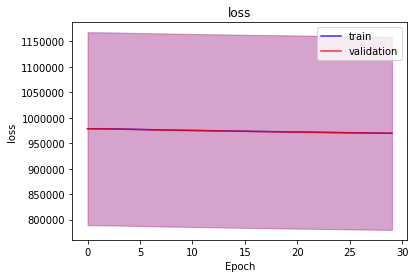

<b>bioma_loss</b>: 484792.1250 (min: 389886.0312, max: 579698.1875)

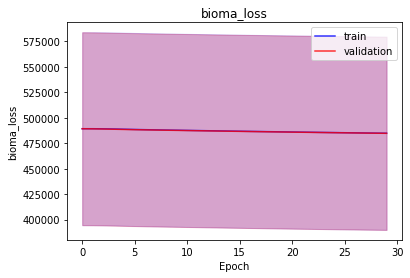

<b>domain_loss</b>: 484797.9375 (min: 389886.0312, max: 579709.8125)

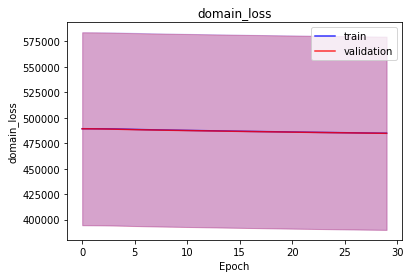

<b>latent_loss</b>: 0.1664 (min: 0.0284, max: 0.3044)

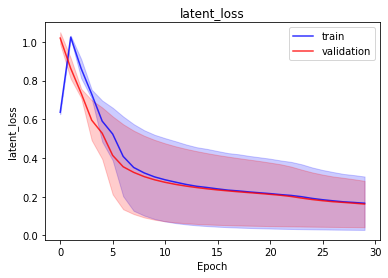

<b>bioma_mse</b>: 533.8011 (min: 515.3016, max: 552.3006)

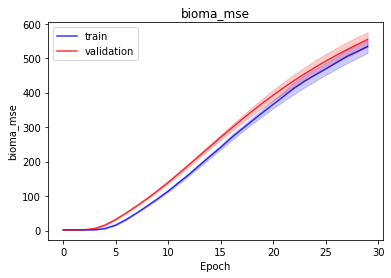

<b>bioma_mae</b>: 12.2425 (min: 11.8941, max: 12.5909)

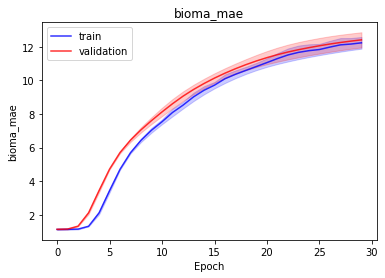

<b>bioma_mape</b>: nan (min: nan, max: nan)

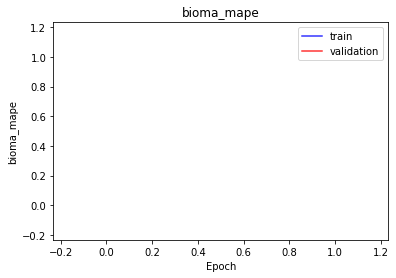

<b>domain_mse</b>: 539.6485 (min: 515.3016, max: 563.9954)

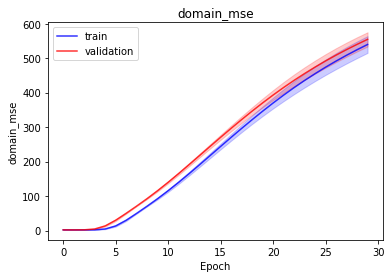

<b>domain_mae</b>: 12.3476 (min: 11.8941, max: 12.8011)

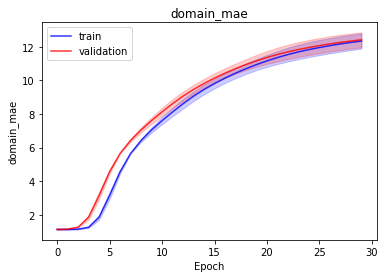

<b>domain_mape</b>: nan (min: nan, max: nan)

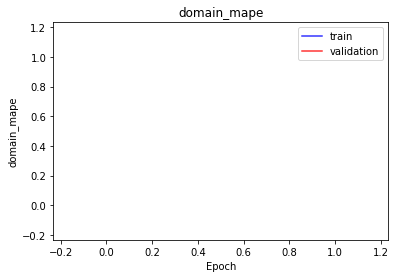

<b>latent_mae</b>: 0.1664 (min: 0.0284, max: 0.3044)

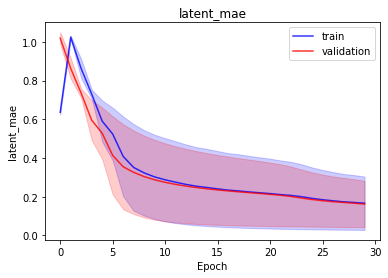

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 969559.0312 (min: 779777.3125, max: 1159340.7500)

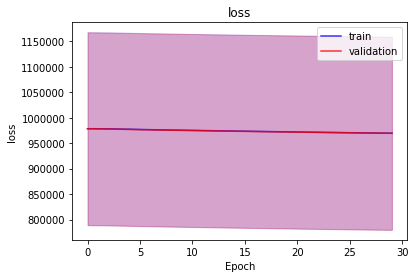

<b>bioma_loss</b>: 484778.8125 (min: 389888.5938, max: 579669.0625)

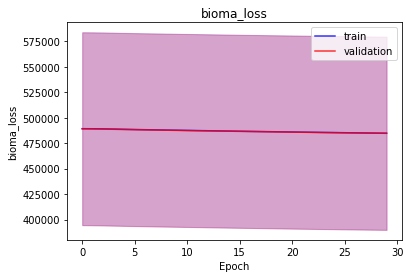

<b>domain_loss</b>: 484780.0625 (min: 389888.5938, max: 579671.5000)

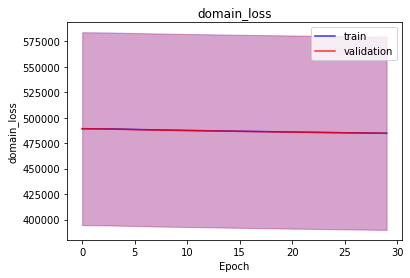

<b>latent_loss</b>: 0.2151 (min: 0.1552, max: 0.2749)

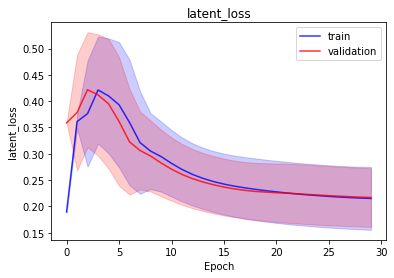

<b>bioma_mse</b>: 540.8359 (min: 518.4918, max: 563.1801)

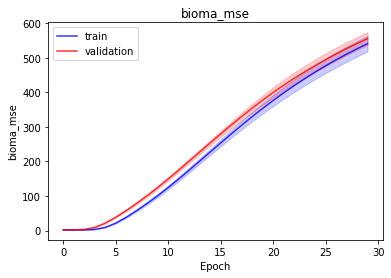

<b>bioma_mae</b>: 12.3339 (min: 11.9043, max: 12.7634)

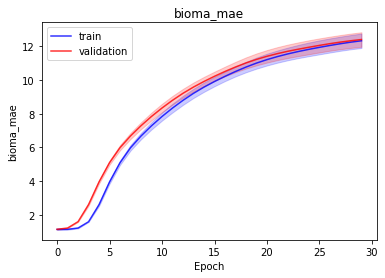

<b>bioma_mape</b>: nan (min: nan, max: nan)

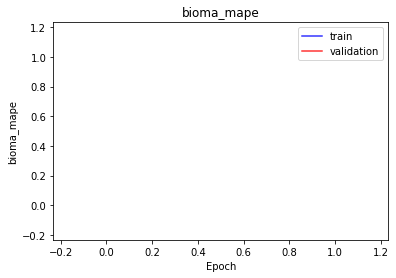

<b>domain_mse</b>: 542.0456 (min: 518.4918, max: 565.5994)

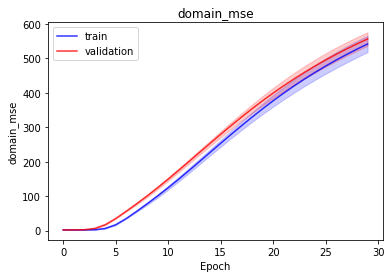

<b>domain_mae</b>: 12.3471 (min: 11.9043, max: 12.7899)

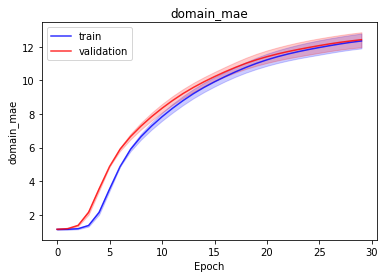

<b>domain_mape</b>: nan (min: nan, max: nan)

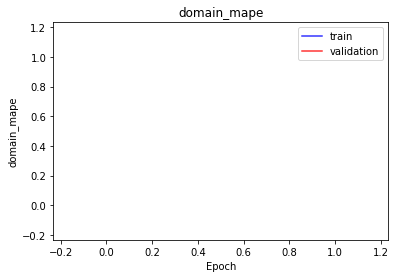

<b>latent_mae</b>: 0.2151 (min: 0.1552, max: 0.2749)

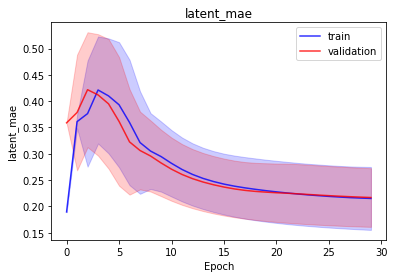

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 847345.5938 (min: 627109.3125, max: 1067581.8750)

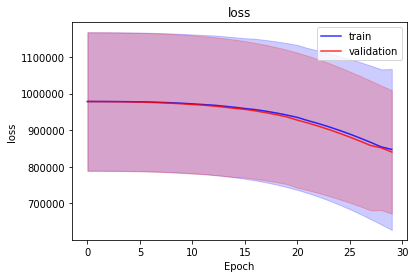

<b>bioma_loss</b>: 425461.2500 (min: 312662.5625, max: 538259.9375)

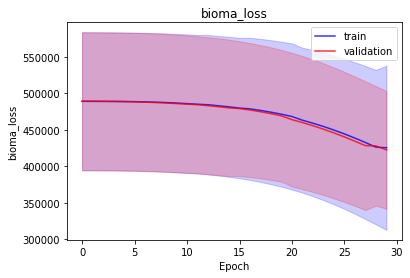

<b>domain_loss</b>: 421883.2500 (min: 314445.9062, max: 529320.6250)

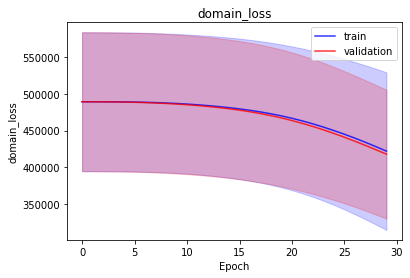

<b>latent_loss</b>: 1.1036 (min: 0.8112, max: 1.3960)

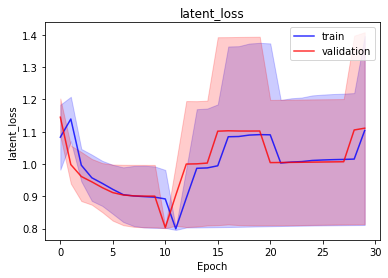

<b>bioma_mse</b>: 15255.0098 (min: 8230.7939, max: 22279.2266)

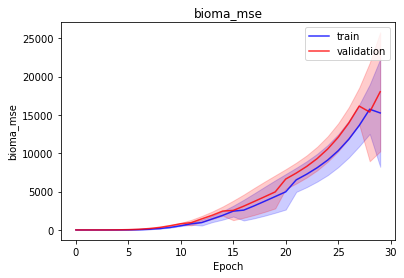

<b>bioma_mae</b>: 23.0139 (min: 17.6862, max: 28.3416)

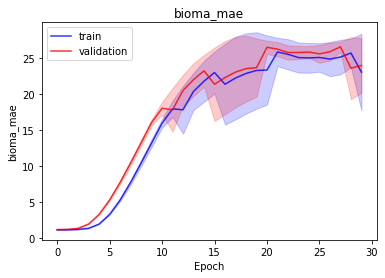

<b>bioma_mape</b>: nan (min: nan, max: nan)

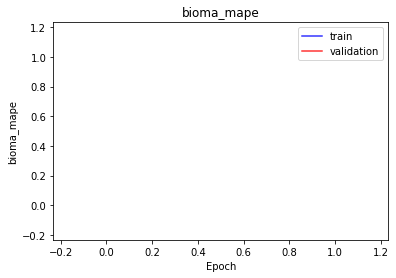

<b>domain_mse</b>: 18550.0527 (min: 15365.7861, max: 21734.3184)

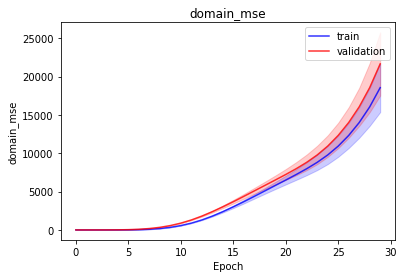

<b>domain_mae</b>: 26.5885 (min: 24.7646, max: 28.4123)

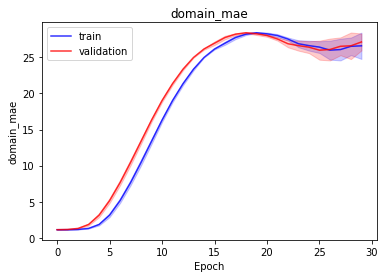

<b>domain_mape</b>: nan (min: nan, max: nan)

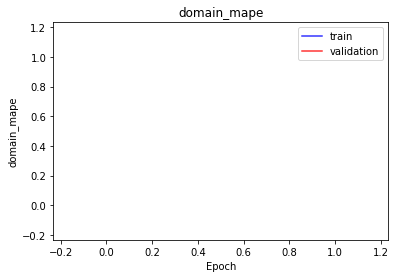

<b>latent_mae</b>: 1.1036 (min: 0.8112, max: 1.3960)

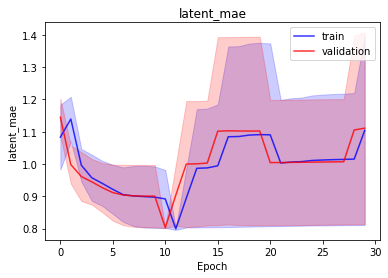

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 849921.5312 (min: 655756.1250, max: 1044086.9375)

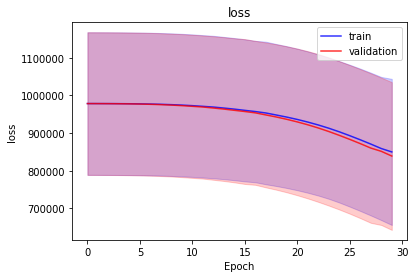

<b>bioma_loss</b>: 431474.0000 (min: 333614.7500, max: 529333.2500)

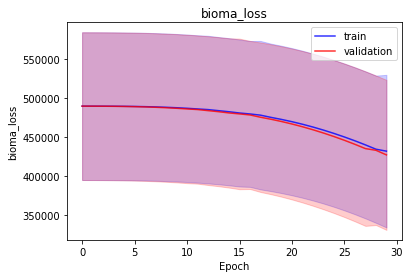

<b>domain_loss</b>: 418447.1875 (min: 322141.1875, max: 514753.1562)

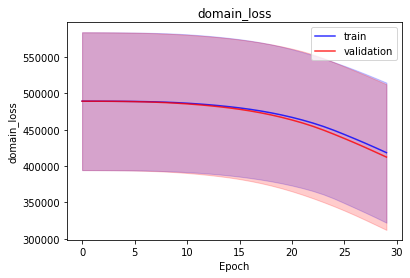

<b>latent_loss</b>: 0.3754 (min: 0.2138, max: 0.5370)

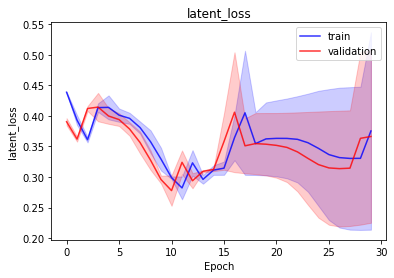

<b>bioma_mse</b>: 11866.2012 (min: 10861.4150, max: 12870.9863)

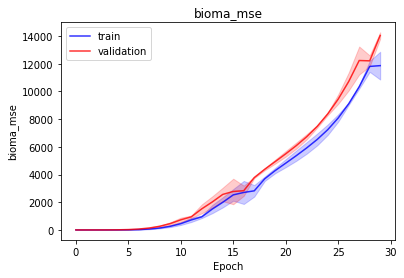

<b>bioma_mae</b>: 21.7160 (min: 19.5091, max: 23.9229)

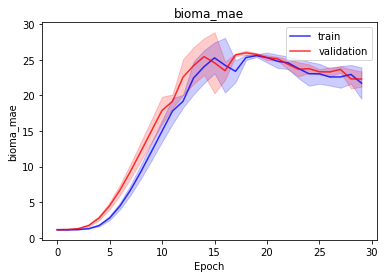

<b>bioma_mape</b>: nan (min: nan, max: nan)

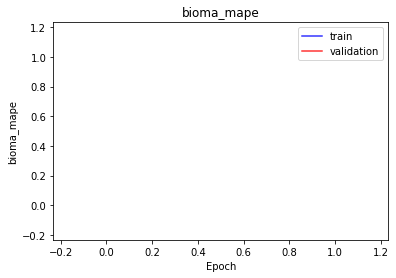

<b>domain_mse</b>: 22743.8457 (min: 21152.6992, max: 24334.9922)

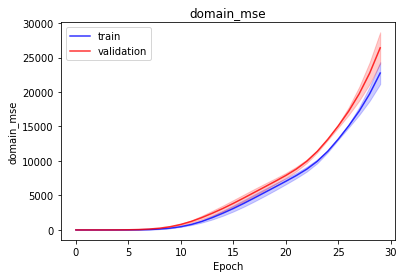

<b>domain_mae</b>: 30.6098 (min: 30.3035, max: 30.9161)

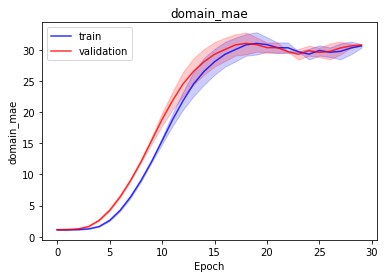

<b>domain_mape</b>: nan (min: nan, max: nan)

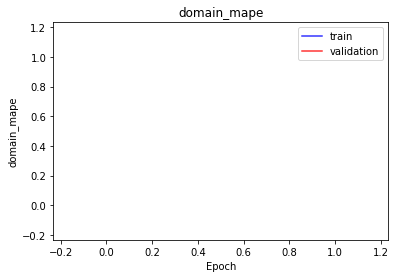

<b>latent_mae</b>: 0.3754 (min: 0.2138, max: 0.5370)

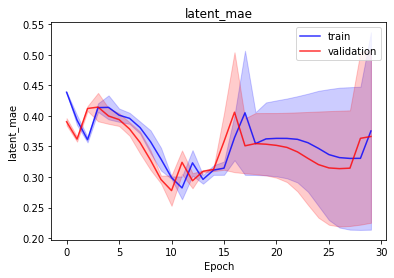

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 971337.7188 (min: 781395.3125, max: 1161280.1250)

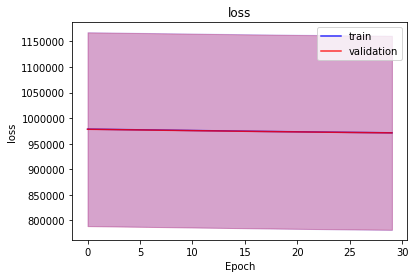

<b>bioma_loss</b>: 485668.8438 (min: 390697.6250, max: 580640.0625)

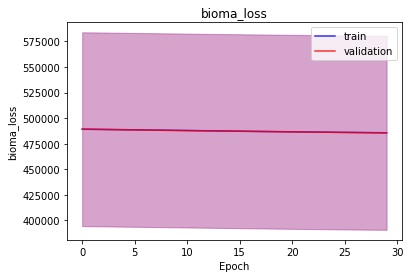

<b>domain_loss</b>: 485668.8438 (min: 390697.6250, max: 580640.0625)

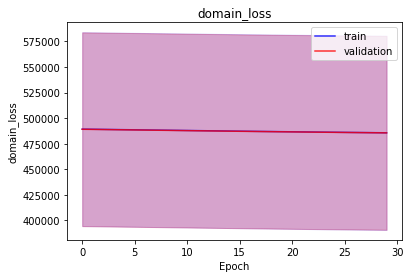

<b>latent_loss</b>: 0.0418 (min: 0.0418, max: 0.0419)

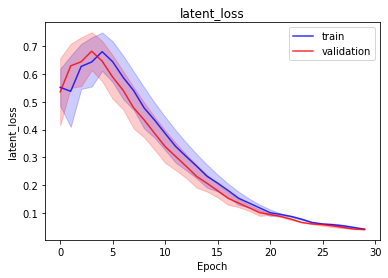

<b>bioma_mse</b>: 430.3231 (min: 426.0926, max: 434.5536)

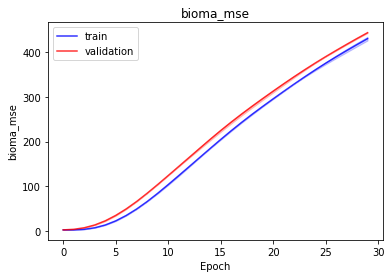

<b>bioma_mae</b>: 11.5489 (min: 11.2631, max: 11.8348)

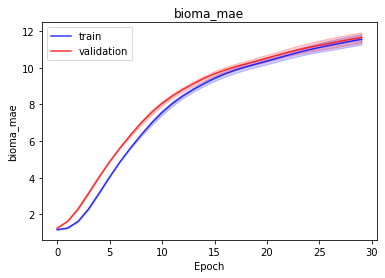

<b>bioma_mape</b>: nan (min: nan, max: nan)

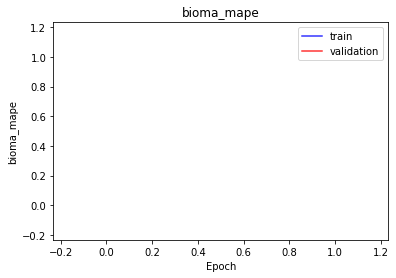

<b>domain_mse</b>: 430.3234 (min: 426.0937, max: 434.5532)

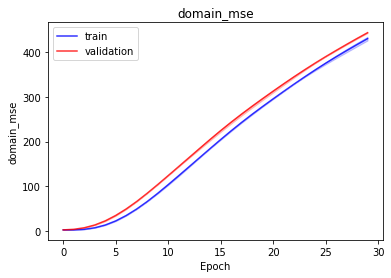

<b>domain_mae</b>: 11.5490 (min: 11.2632, max: 11.8347)

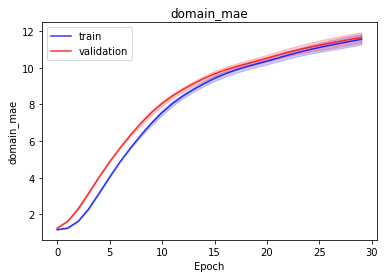

<b>domain_mape</b>: nan (min: nan, max: nan)

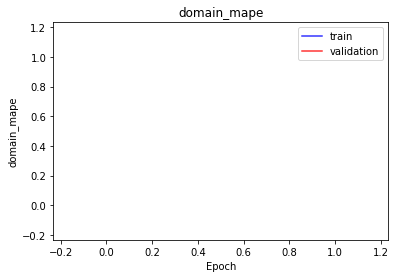

<b>latent_mae</b>: 0.0418 (min: 0.0418, max: 0.0419)

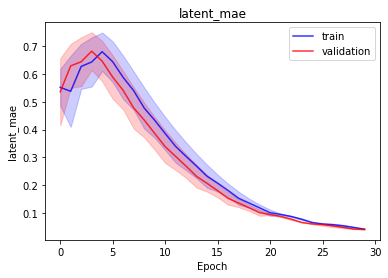

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 971549.5625 (min: 781803.8750, max: 1161295.2500)

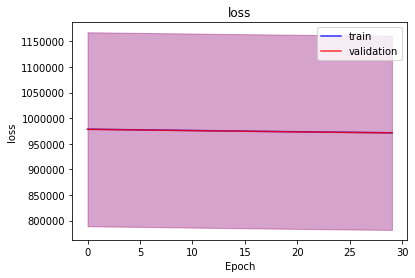

<b>bioma_loss</b>: 485774.6875 (min: 390901.8438, max: 580647.5625)

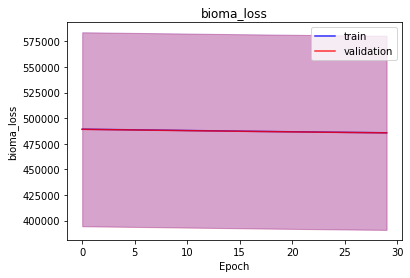

<b>domain_loss</b>: 485774.7188 (min: 390901.8750, max: 580647.5625)

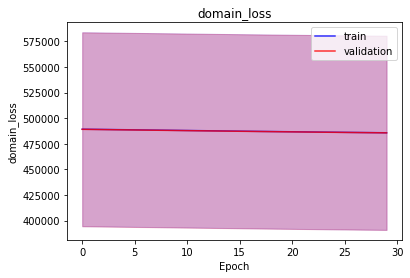

<b>latent_loss</b>: 0.1488 (min: 0.1314, max: 0.1661)

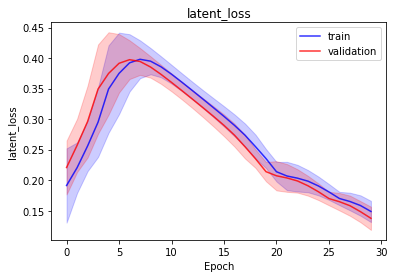

<b>bioma_mse</b>: 424.1039 (min: 411.0209, max: 437.1870)

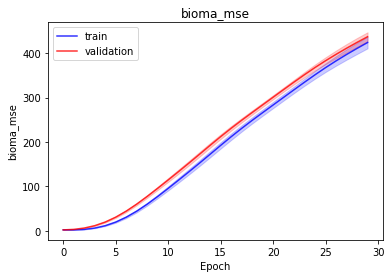

<b>bioma_mae</b>: 11.5344 (min: 11.1819, max: 11.8870)

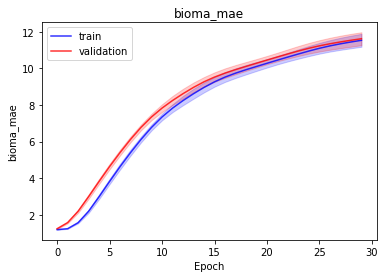

<b>bioma_mape</b>: nan (min: nan, max: nan)

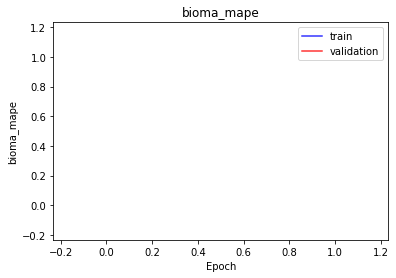

<b>domain_mse</b>: 424.0923 (min: 411.0193, max: 437.1652)

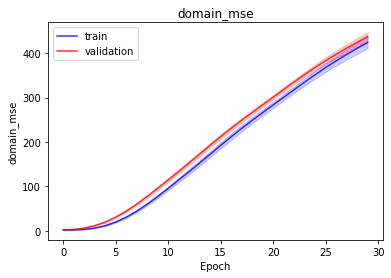

<b>domain_mae</b>: 11.5342 (min: 11.1819, max: 11.8866)

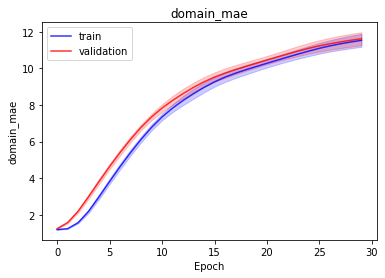

<b>domain_mape</b>: nan (min: nan, max: nan)

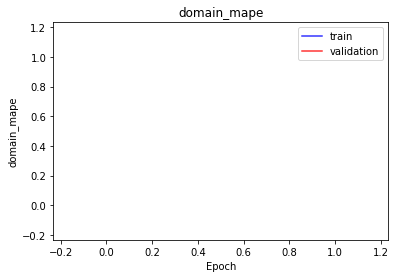

<b>latent_mae</b>: 0.1488 (min: 0.1314, max: 0.1661)

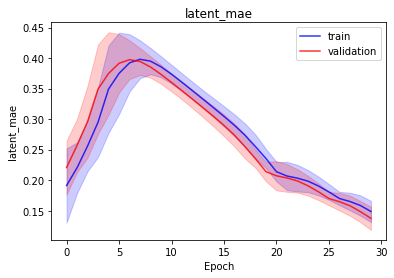

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973803.8125 (min: 784177.0000, max: 1163430.6250)

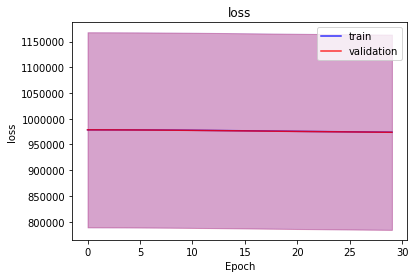

<b>bioma_loss</b>: 486895.3438 (min: 392083.6875, max: 581707.0000)

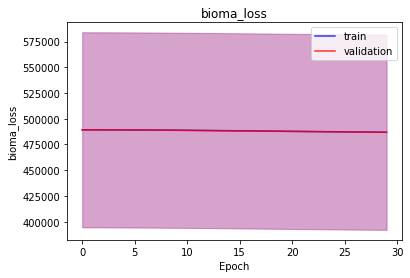

<b>domain_loss</b>: 486908.4375 (min: 392093.2500, max: 581723.6250)

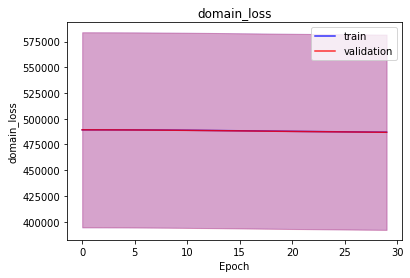

<b>latent_loss</b>: 0.0491 (min: 0.0362, max: 0.0621)

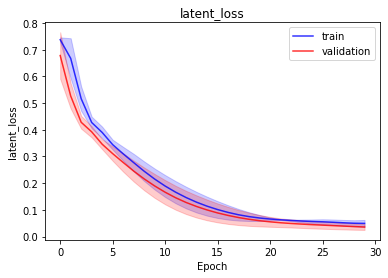

<b>bioma_mse</b>: 247.8702 (min: 239.9558, max: 255.7845)

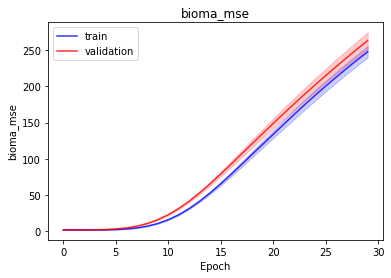

<b>bioma_mae</b>: 9.5989 (min: 9.3886, max: 9.8092)

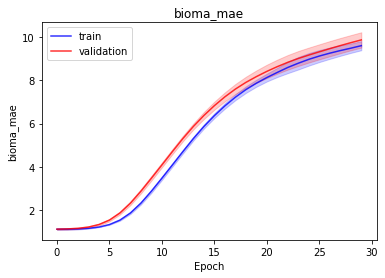

<b>bioma_mape</b>: nan (min: nan, max: nan)

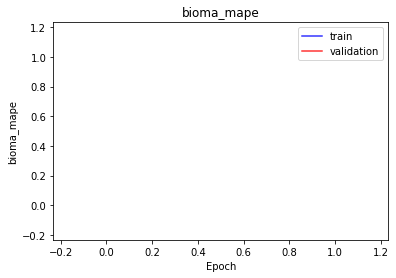

<b>domain_mse</b>: 256.9612 (min: 244.2271, max: 269.6953)

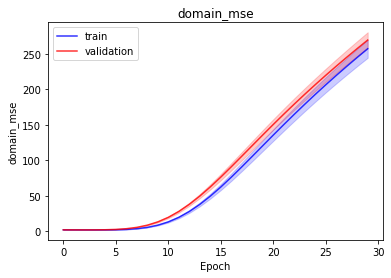

<b>domain_mae</b>: 9.8851 (min: 9.5310, max: 10.2393)

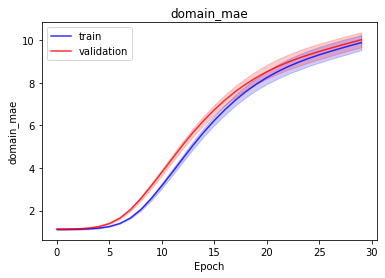

<b>domain_mape</b>: nan (min: nan, max: nan)

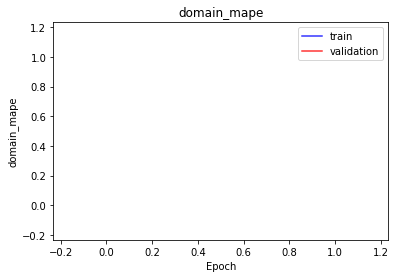

<b>latent_mae</b>: 0.0491 (min: 0.0362, max: 0.0621)

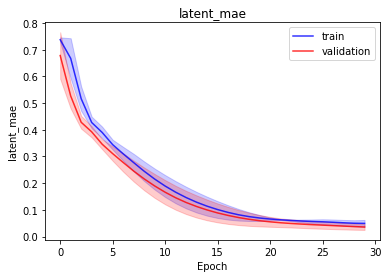

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973912.6562 (min: 784320.6875, max: 1163504.6250)

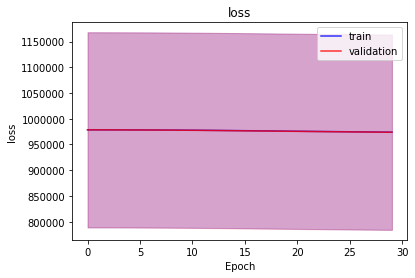

<b>bioma_loss</b>: 486947.5000 (min: 392145.7188, max: 581749.2500)

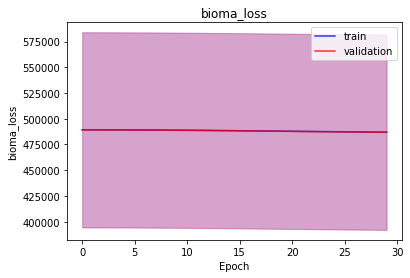

<b>domain_loss</b>: 486964.9375 (min: 392174.7188, max: 581755.1250)

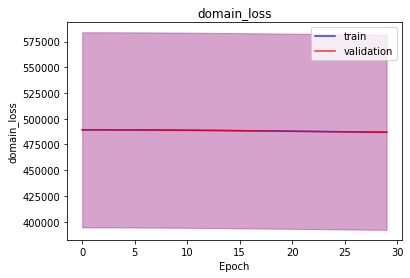

<b>latent_loss</b>: 0.2143 (min: 0.1924, max: 0.2363)

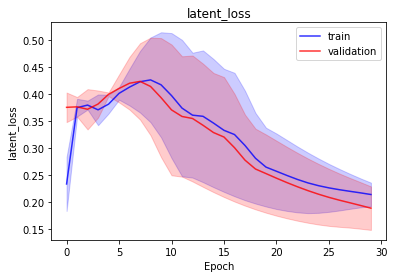

<b>bioma_mse</b>: 246.2515 (min: 243.2658, max: 249.2373)

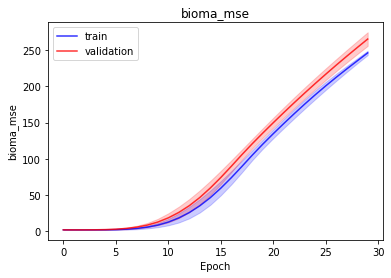

<b>bioma_mae</b>: 9.6014 (min: 9.4764, max: 9.7265)

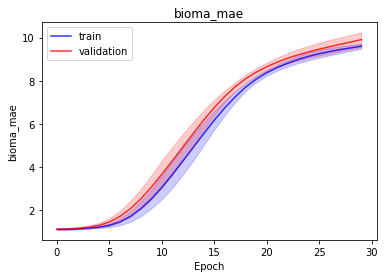

<b>bioma_mape</b>: nan (min: nan, max: nan)

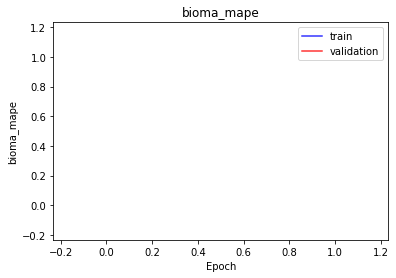

<b>domain_mse</b>: 256.0143 (min: 239.3490, max: 272.6795)

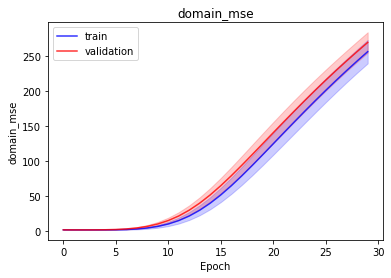

<b>domain_mae</b>: 9.8474 (min: 9.4106, max: 10.2842)

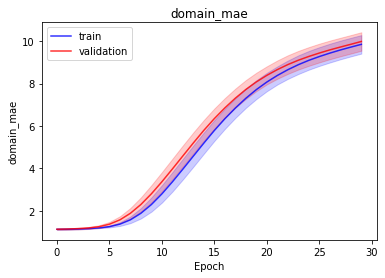

<b>domain_mape</b>: nan (min: nan, max: nan)

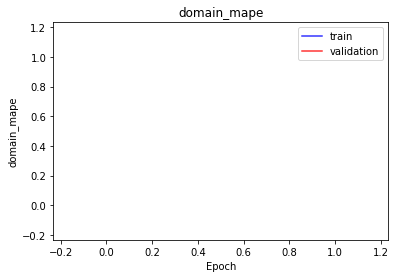

<b>latent_mae</b>: 0.2143 (min: 0.1924, max: 0.2363)

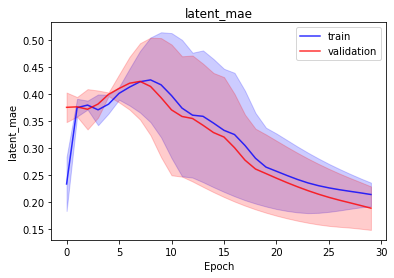

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974232.9688 (min: 784532.1875, max: 1163933.7500)

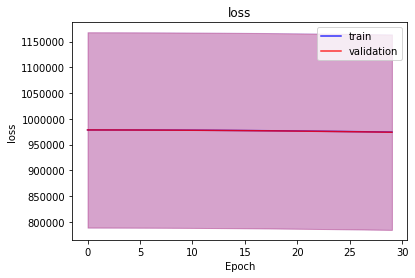

<b>bioma_loss</b>: 487059.6250 (min: 392234.9062, max: 581884.3125)

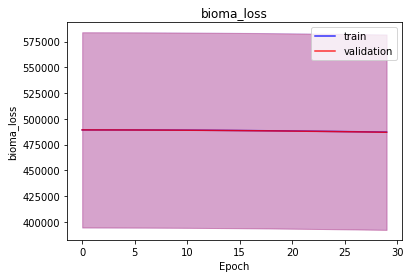

<b>domain_loss</b>: 487172.1875 (min: 392296.4688, max: 582047.9375)

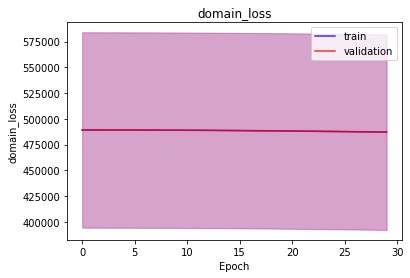

<b>latent_loss</b>: 1.1709 (min: 0.8049, max: 1.5369)

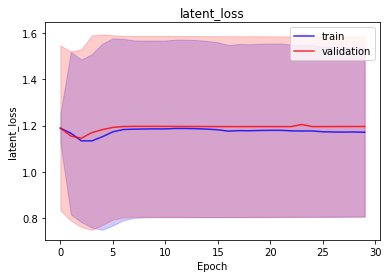

<b>bioma_mse</b>: 278.0589 (min: 264.8351, max: 291.2827)

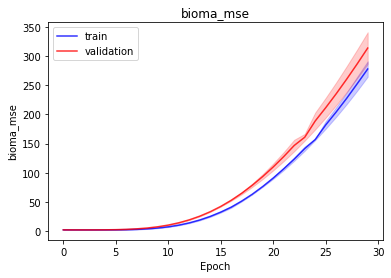

<b>bioma_mae</b>: 10.7151 (min: 10.3049, max: 11.1252)

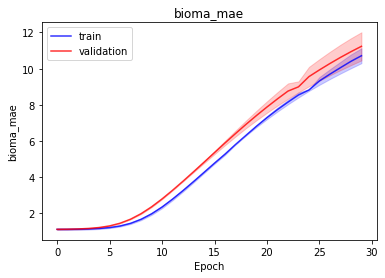

<b>bioma_mape</b>: nan (min: nan, max: nan)

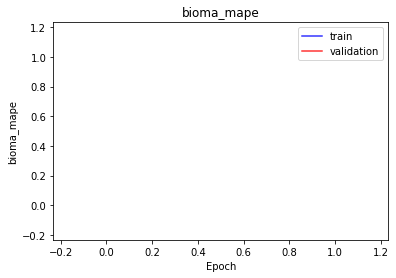

<b>domain_mse</b>: 262.7938 (min: 259.9854, max: 265.6023)

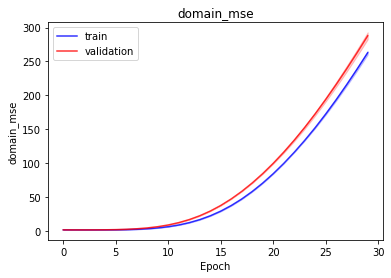

<b>domain_mae</b>: 10.6012 (min: 10.4573, max: 10.7450)

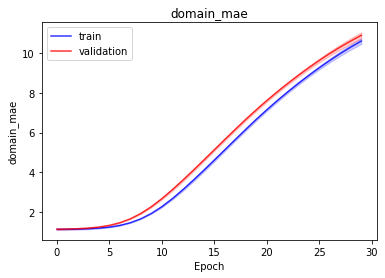

<b>domain_mape</b>: nan (min: nan, max: nan)

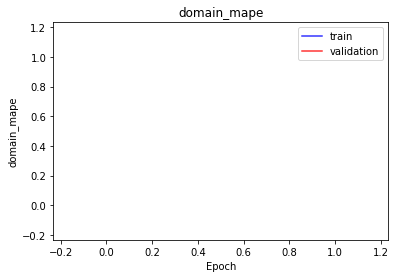

<b>latent_mae</b>: 1.1709 (min: 0.8049, max: 1.5369)

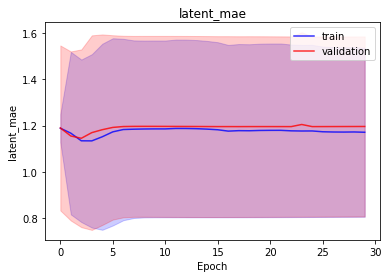

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973663.0625 (min: 783189.0000, max: 1164137.1250)

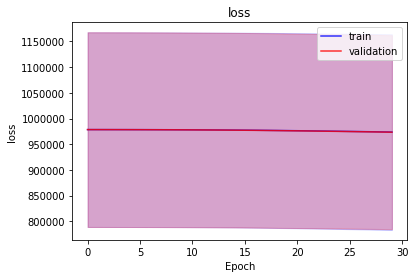

<b>bioma_loss</b>: 486800.1250 (min: 391585.9062, max: 582014.3750)

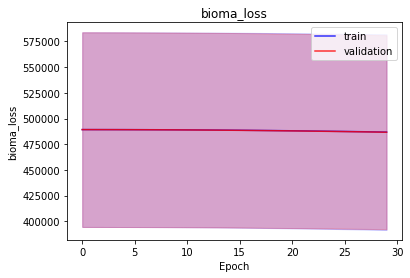

<b>domain_loss</b>: 486862.6875 (min: 391602.9062, max: 582122.5000)

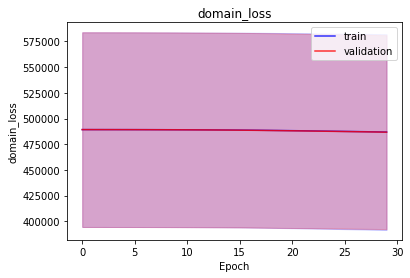

<b>latent_loss</b>: 0.2195 (min: 0.2076, max: 0.2315)

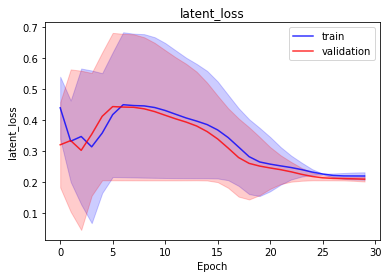

<b>bioma_mse</b>: 331.2009 (min: 253.8057, max: 408.5961)

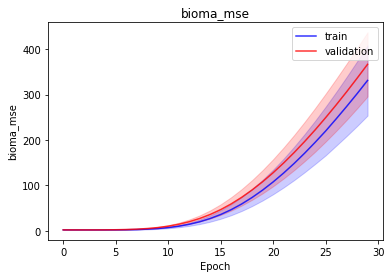

<b>bioma_mae</b>: 11.3747 (min: 10.6555, max: 12.0939)

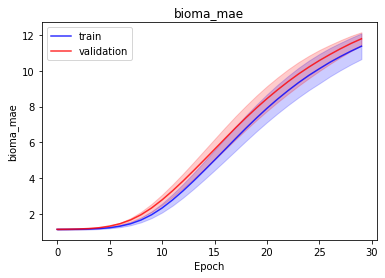

<b>bioma_mape</b>: nan (min: nan, max: nan)

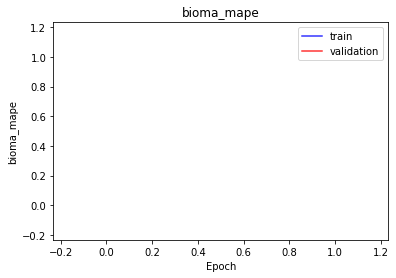

<b>domain_mse</b>: 329.6164 (min: 246.3387, max: 412.8941)

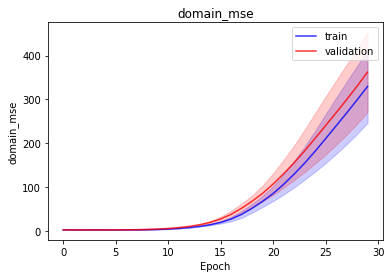

<b>domain_mae</b>: 11.4296 (min: 10.6264, max: 12.2327)

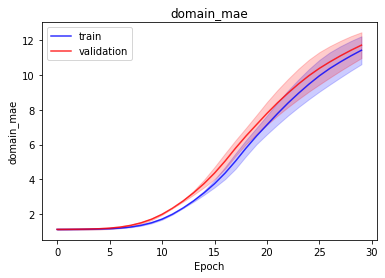

<b>domain_mape</b>: nan (min: nan, max: nan)

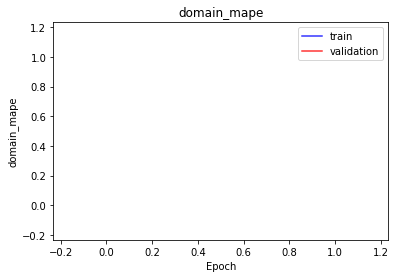

<b>latent_mae</b>: 0.2195 (min: 0.2076, max: 0.2315)

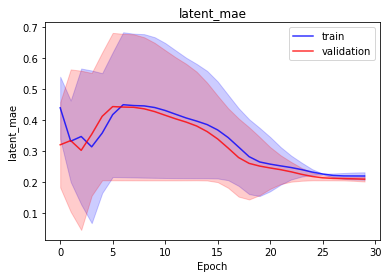

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974541.4688 (min: 784869.0625, max: 1164213.8750)

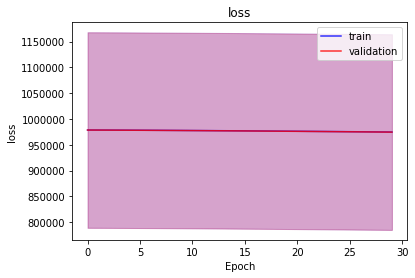

<b>bioma_loss</b>: 487224.5625 (min: 392416.7188, max: 582032.4375)

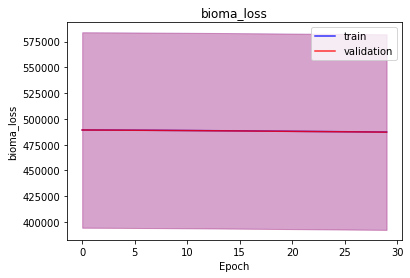

<b>domain_loss</b>: 487316.7188 (min: 392452.3125, max: 582181.1250)

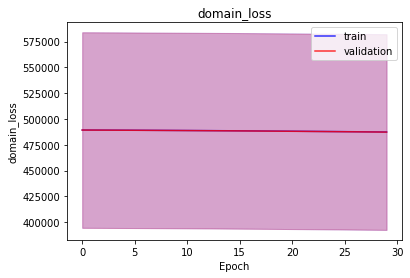

<b>latent_loss</b>: 0.2002 (min: 0.0824, max: 0.3180)

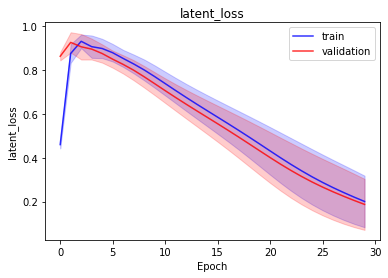

<b>bioma_mse</b>: 236.4070 (min: 223.8166, max: 248.9974)

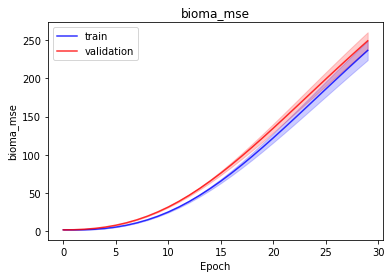

<b>bioma_mae</b>: 9.9659 (min: 9.5437, max: 10.3881)

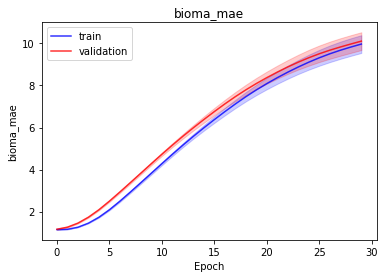

<b>bioma_mape</b>: nan (min: nan, max: nan)

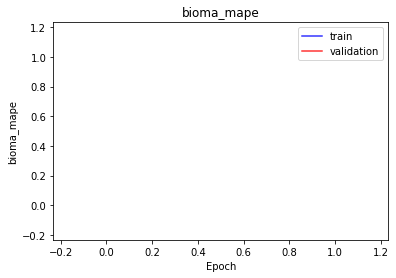

<b>domain_mse</b>: 210.5064 (min: 206.1524, max: 214.8604)

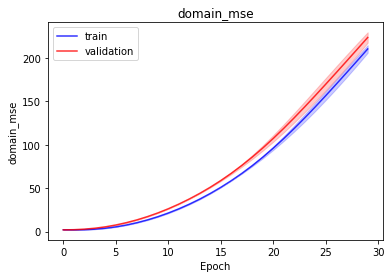

<b>domain_mae</b>: 9.4268 (min: 9.3608, max: 9.4929)

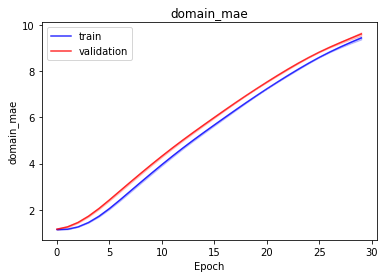

<b>domain_mape</b>: nan (min: nan, max: nan)

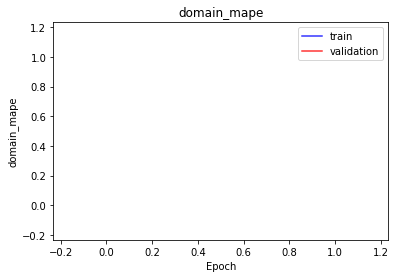

<b>latent_mae</b>: 0.2002 (min: 0.0824, max: 0.3180)

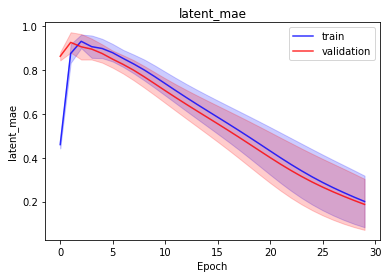

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974515.7812 (min: 784865.3125, max: 1164166.2500)

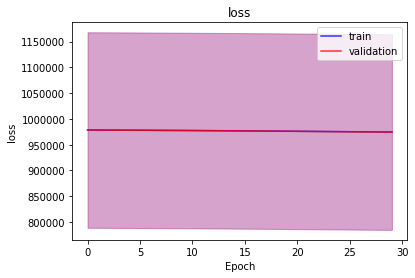

<b>bioma_loss</b>: 487218.4375 (min: 392399.1562, max: 582037.7500)

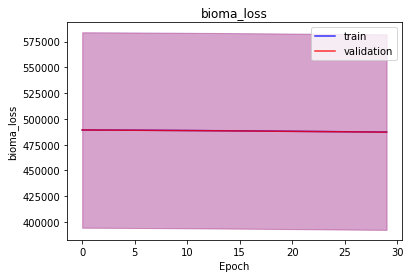

<b>domain_loss</b>: 487297.1562 (min: 392466.0000, max: 582128.3125)

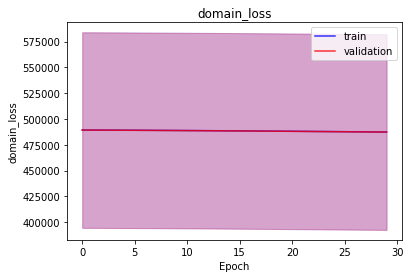

<b>latent_loss</b>: 0.1849 (min: 0.1654, max: 0.2044)

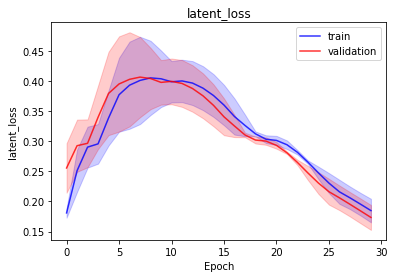

<b>bioma_mse</b>: 231.2272 (min: 222.6996, max: 239.7548)

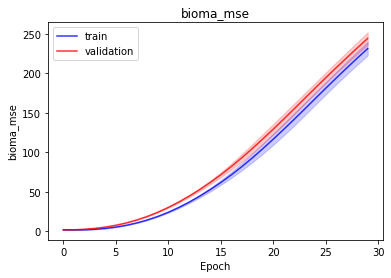

<b>bioma_mae</b>: 9.8695 (min: 9.5689, max: 10.1701)

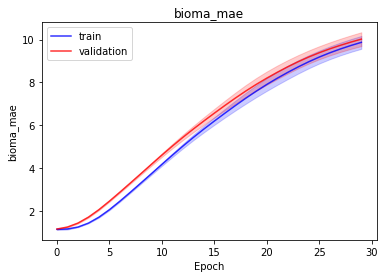

<b>bioma_mape</b>: nan (min: nan, max: nan)

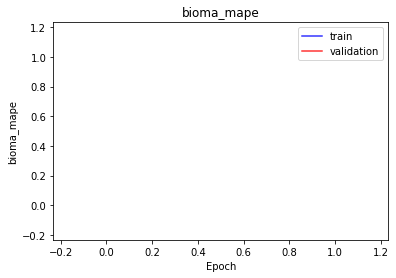

<b>domain_mse</b>: 211.0997 (min: 205.8151, max: 216.3843)

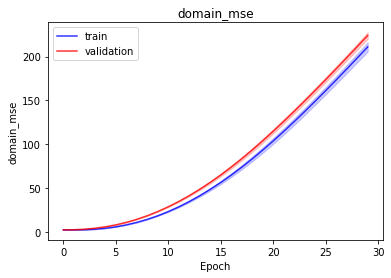

<b>domain_mae</b>: 9.4510 (min: 9.2182, max: 9.6837)

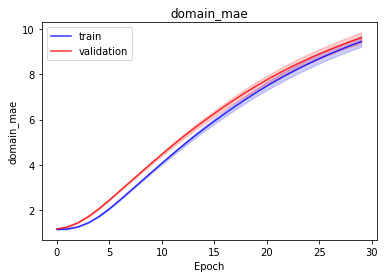

<b>domain_mape</b>: nan (min: nan, max: nan)

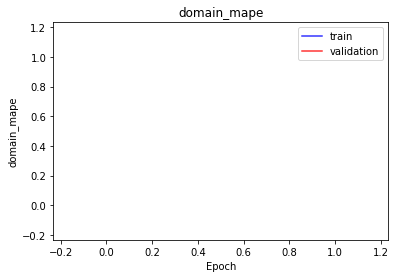

<b>latent_mae</b>: 0.1849 (min: 0.1654, max: 0.2044)

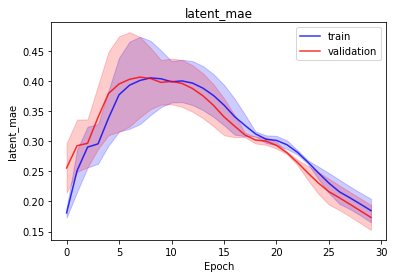

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978303.2812 (min: 788765.1875, max: 1167841.3750)

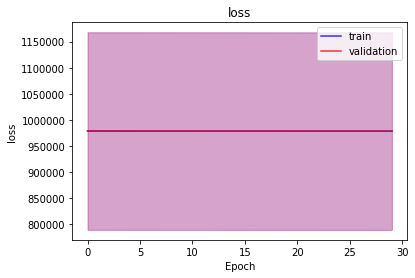

<b>bioma_loss</b>: 489152.8438 (min: 394383.4375, max: 583922.2500)

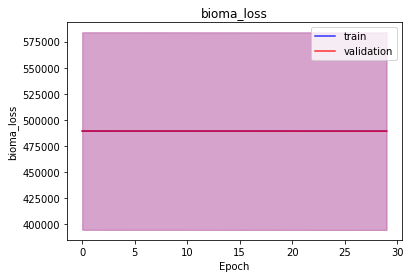

<b>domain_loss</b>: 489149.7500 (min: 394381.1250, max: 583918.3750)

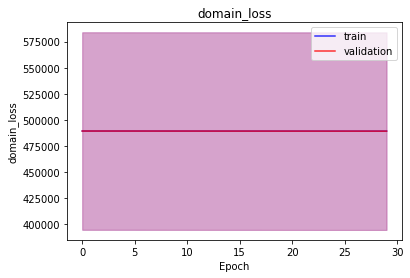

<b>latent_loss</b>: 0.7080 (min: 0.6079, max: 0.8082)

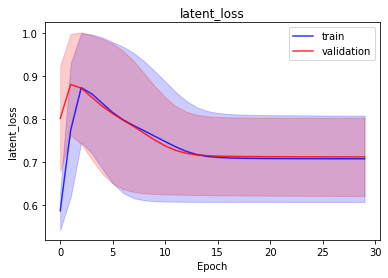

<b>bioma_mse</b>: 2.2157 (min: 2.1703, max: 2.2611)

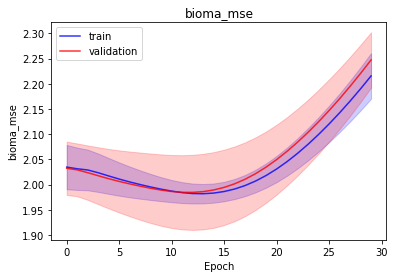

<b>bioma_mae</b>: 1.2713 (min: 1.2465, max: 1.2960)

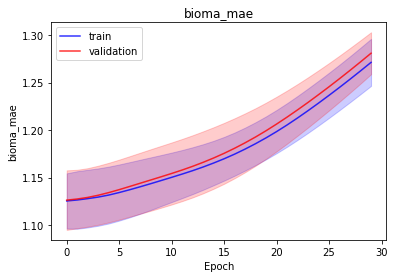

<b>bioma_mape</b>: nan (min: nan, max: nan)

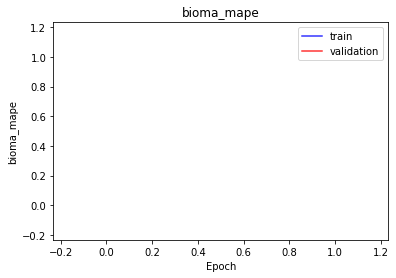

<b>domain_mse</b>: 2.2375 (min: 2.1904, max: 2.2847)

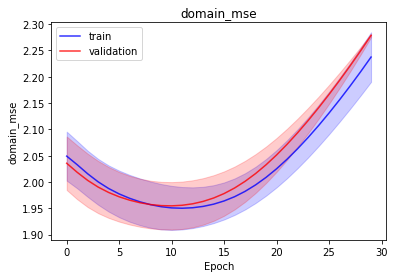

<b>domain_mae</b>: 1.2937 (min: 1.2750, max: 1.3124)

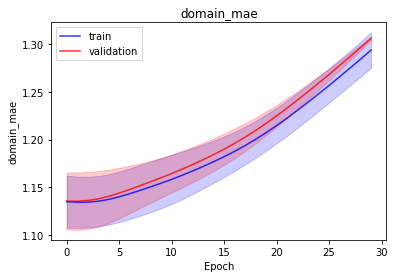

<b>domain_mape</b>: nan (min: nan, max: nan)

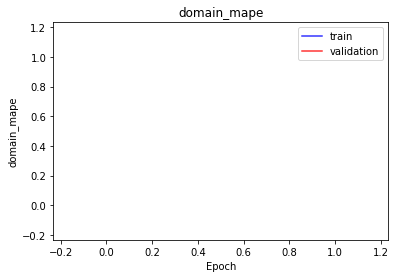

<b>latent_mae</b>: 0.7080 (min: 0.6079, max: 0.8082)

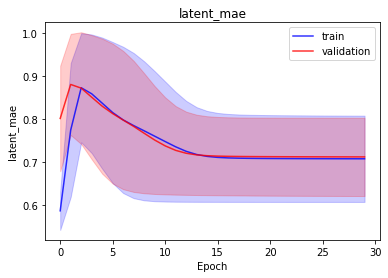

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978268.0312 (min: 788755.9375, max: 1167780.1250)

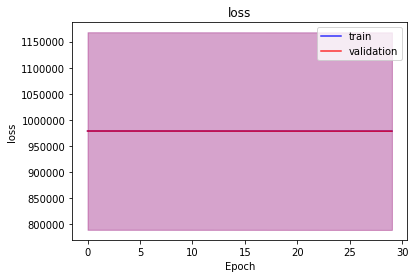

<b>bioma_loss</b>: 489132.9688 (min: 394380.1250, max: 583885.8125)

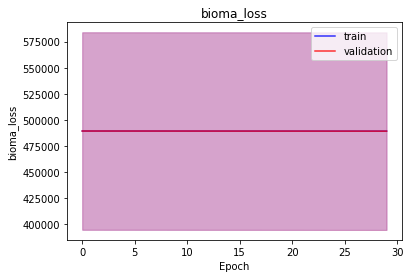

<b>domain_loss</b>: 489134.8125 (min: 394375.4688, max: 583894.1250)

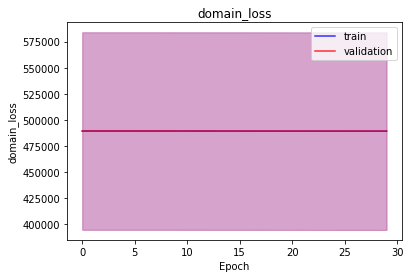

<b>latent_loss</b>: 0.2177 (min: 0.1289, max: 0.3064)

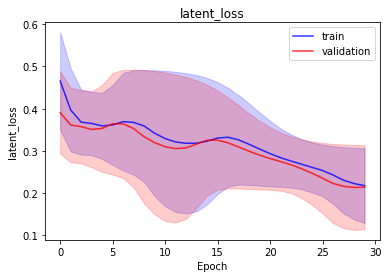

<b>bioma_mse</b>: 2.4642 (min: 2.3008, max: 2.6275)

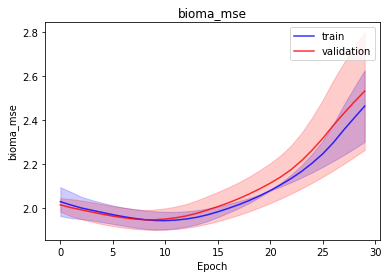

<b>bioma_mae</b>: 1.3583 (min: 1.3156, max: 1.4011)

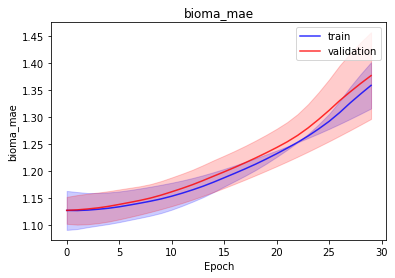

<b>bioma_mape</b>: nan (min: nan, max: nan)

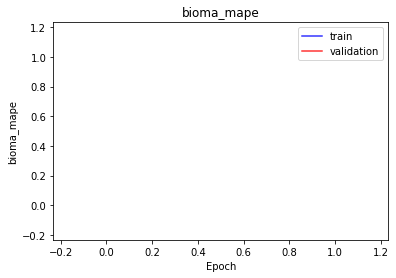

<b>domain_mse</b>: 2.5240 (min: 2.4934, max: 2.5546)

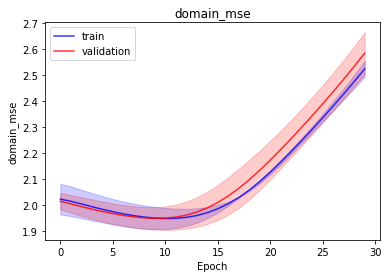

<b>domain_mae</b>: 1.3819 (min: 1.3749, max: 1.3889)

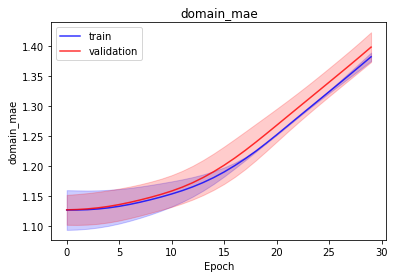

<b>domain_mape</b>: nan (min: nan, max: nan)

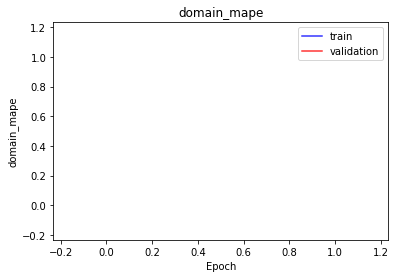

<b>latent_mae</b>: 0.2177 (min: 0.1289, max: 0.3064)

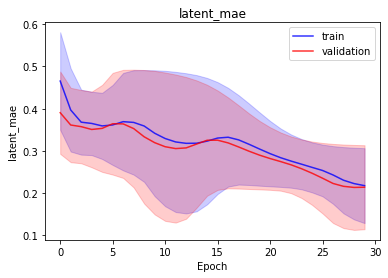

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978248.3438 (min: 788710.4375, max: 1167786.2500)

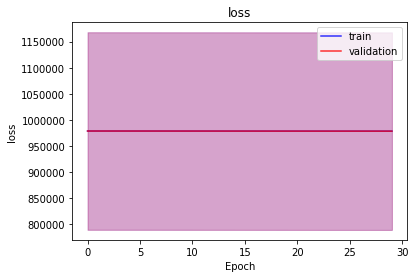

<b>bioma_loss</b>: 489125.8125 (min: 394355.6875, max: 583895.9375)

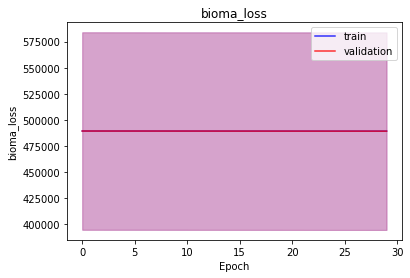

<b>domain_loss</b>: 489122.1875 (min: 394354.5938, max: 583889.8125)

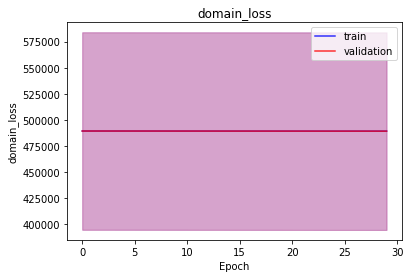

<b>latent_loss</b>: 0.3233 (min: 0.2145, max: 0.4321)

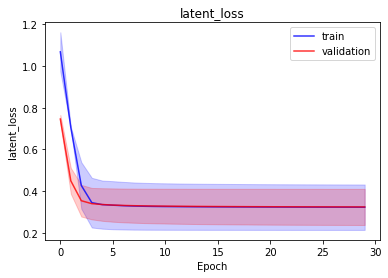

<b>bioma_mse</b>: 2.5045 (min: 2.4387, max: 2.5702)

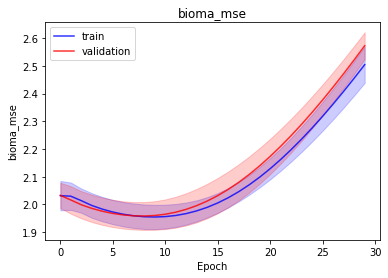

<b>bioma_mae</b>: 1.3626 (min: 1.3338, max: 1.3914)

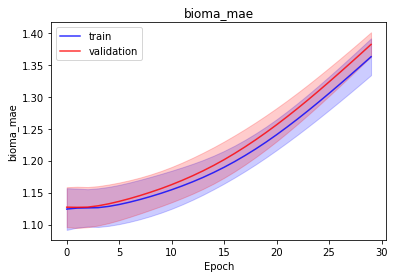

<b>bioma_mape</b>: nan (min: nan, max: nan)

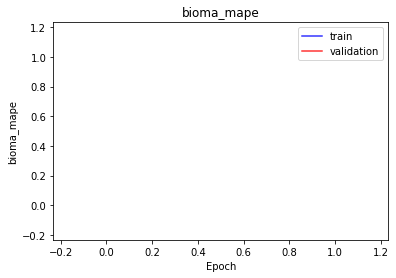

<b>domain_mse</b>: 2.6114 (min: 2.5950, max: 2.6278)

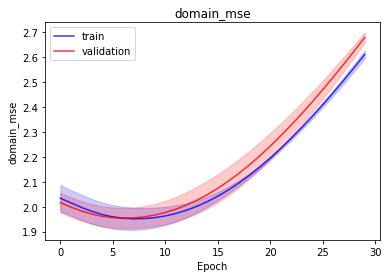

<b>domain_mae</b>: 1.4093 (min: 1.4026, max: 1.4161)

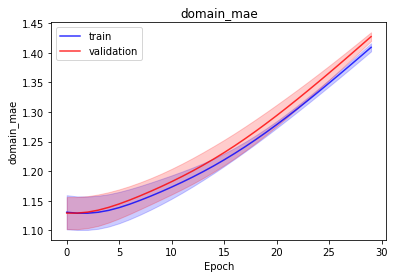

<b>domain_mape</b>: nan (min: nan, max: nan)

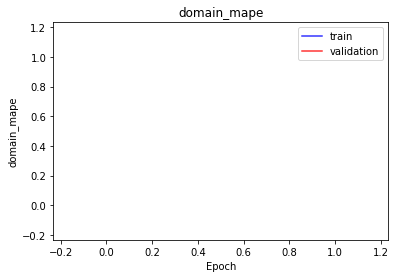

<b>latent_mae</b>: 0.3233 (min: 0.2145, max: 0.4321)

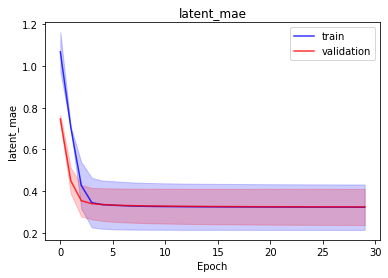

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978313.8750 (min: 788806.7500, max: 1167821.0000)

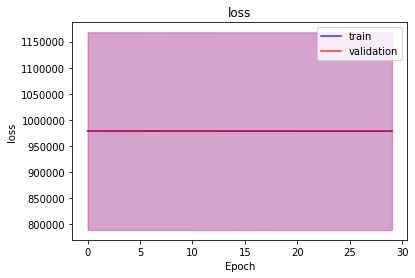

<b>bioma_loss</b>: 489166.0000 (min: 394415.9062, max: 583916.0625)

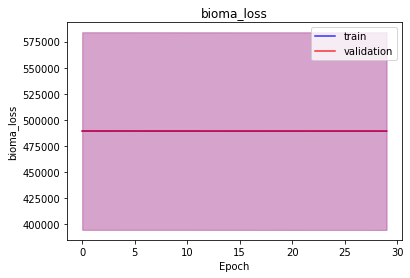

<b>domain_loss</b>: 489147.4375 (min: 394390.3125, max: 583904.5625)

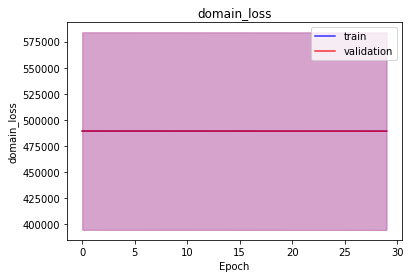

<b>latent_loss</b>: 0.4560 (min: 0.4123, max: 0.4997)

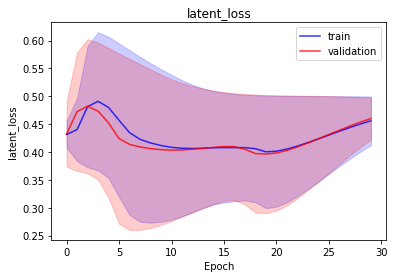

<b>bioma_mse</b>: 2.1053 (min: 2.0097, max: 2.2009)

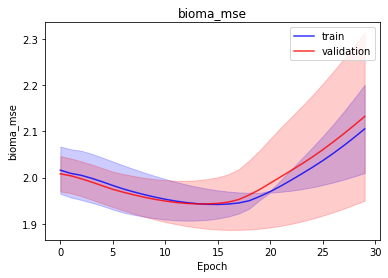

<b>bioma_mae</b>: 1.2444 (min: 1.2144, max: 1.2744)

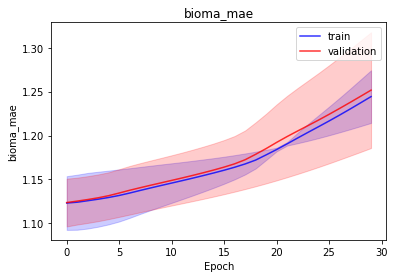

<b>bioma_mape</b>: nan (min: nan, max: nan)

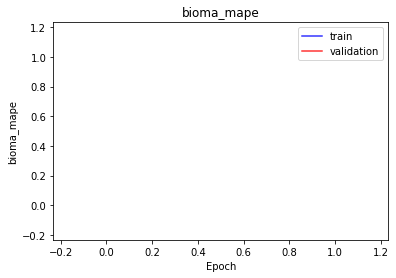

<b>domain_mse</b>: 2.3804 (min: 2.3328, max: 2.4281)

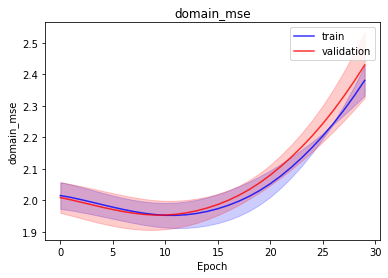

<b>domain_mae</b>: 1.3385 (min: 1.3260, max: 1.3510)

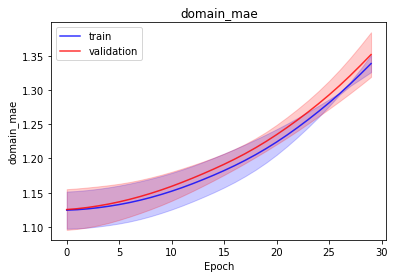

<b>domain_mape</b>: nan (min: nan, max: nan)

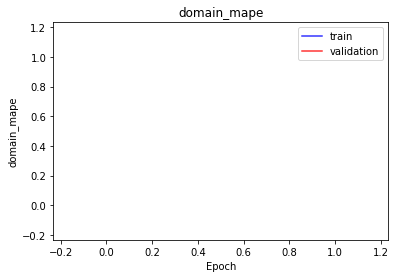

<b>latent_mae</b>: 0.4560 (min: 0.4123, max: 0.4997)

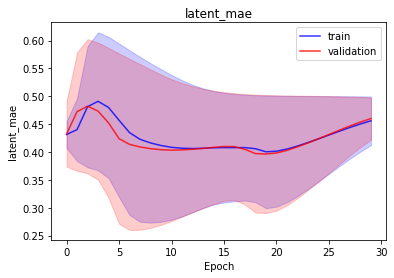

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978254.6562 (min: 788718.9375, max: 1167790.3750)

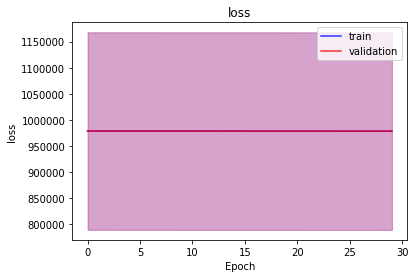

<b>bioma_loss</b>: 489127.8750 (min: 394359.4688, max: 583896.2500)

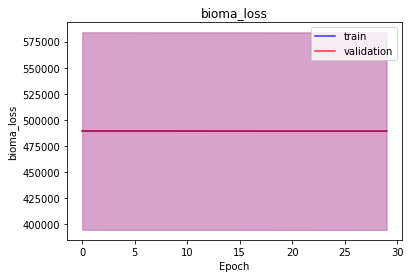

<b>domain_loss</b>: 489126.5000 (min: 394359.2812, max: 583893.7500)

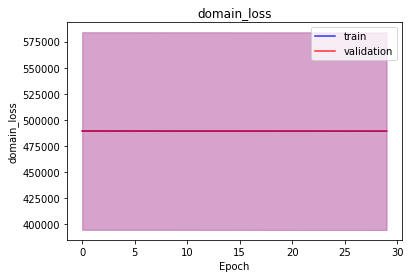

<b>latent_loss</b>: 0.3172 (min: 0.2146, max: 0.4198)

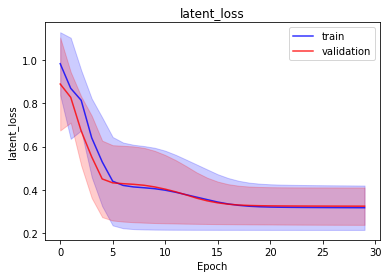

<b>bioma_mse</b>: 2.4747 (min: 2.4406, max: 2.5089)

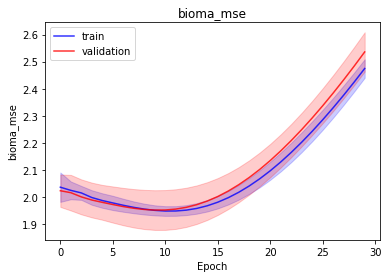

<b>bioma_mae</b>: 1.3555 (min: 1.3394, max: 1.3716)

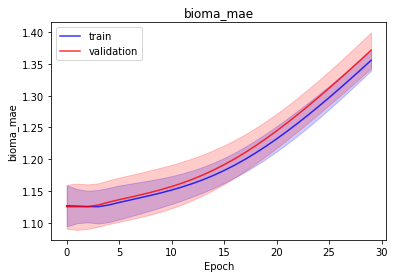

<b>bioma_mape</b>: nan (min: nan, max: nan)

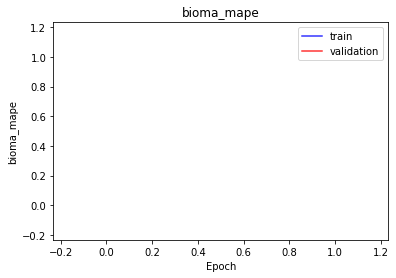

<b>domain_mse</b>: 2.5223 (min: 2.4192, max: 2.6253)

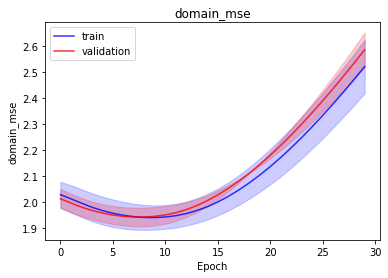

<b>domain_mae</b>: 1.3823 (min: 1.3512, max: 1.4134)

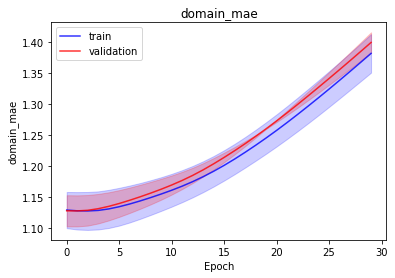

<b>domain_mape</b>: nan (min: nan, max: nan)

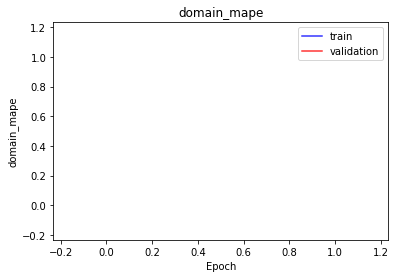

<b>latent_mae</b>: 0.3172 (min: 0.2146, max: 0.4198)

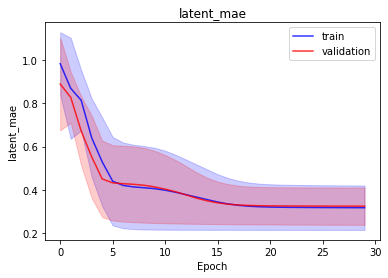

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 978289.0625 (min: 788756.2500, max: 1167821.8750)

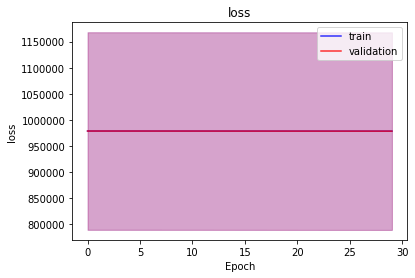

<b>bioma_loss</b>: 489148.1875 (min: 394380.4062, max: 583915.9375)

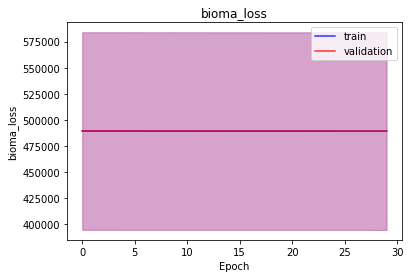

<b>domain_loss</b>: 489140.4375 (min: 394375.3750, max: 583905.5000)

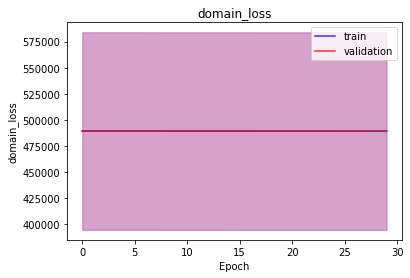

<b>latent_loss</b>: 0.4575 (min: 0.4293, max: 0.4857)

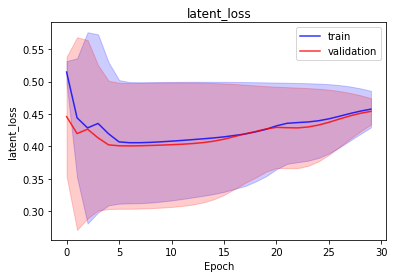

<b>bioma_mse</b>: 2.2173 (min: 2.1465, max: 2.2881)

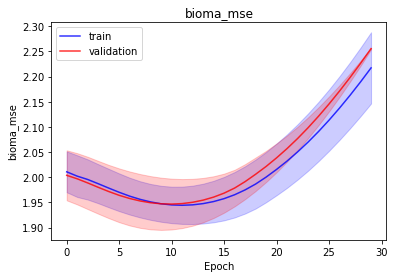

<b>bioma_mae</b>: 1.2842 (min: 1.2568, max: 1.3117)

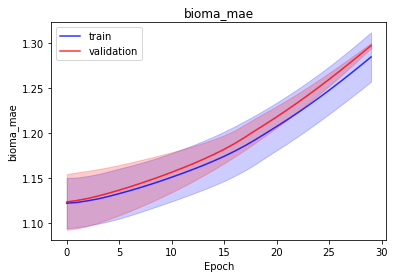

<b>bioma_mape</b>: nan (min: nan, max: nan)

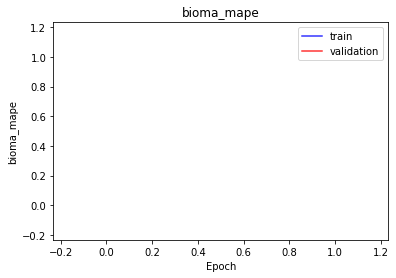

<b>domain_mse</b>: 2.4378 (min: 2.3941, max: 2.4815)

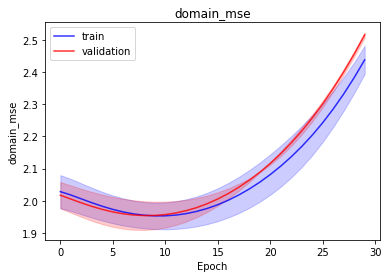

<b>domain_mae</b>: 1.3558 (min: 1.3413, max: 1.3703)

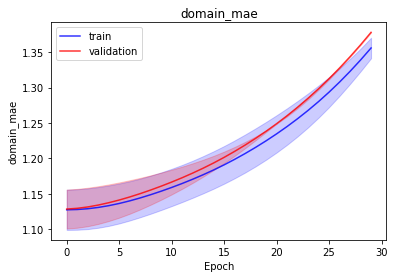

<b>domain_mape</b>: nan (min: nan, max: nan)

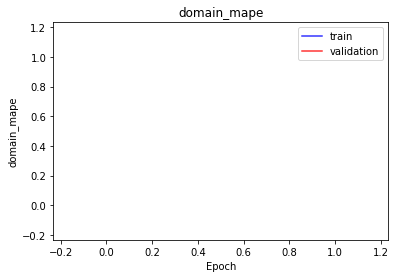

<b>latent_mae</b>: 0.4575 (min: 0.4293, max: 0.4857)

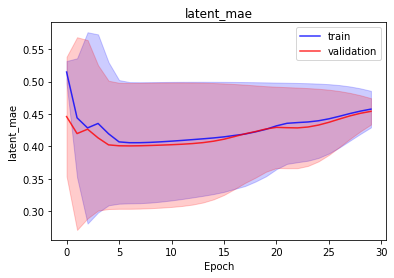

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 969513.4062 (min: 779691.4375, max: 1159335.3750)

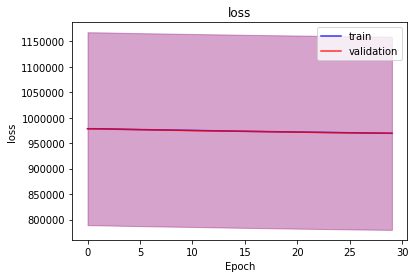

<b>bioma_loss</b>: 484756.5938 (min: 389845.6250, max: 579667.5625)

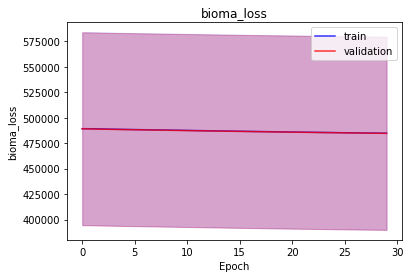

<b>domain_loss</b>: 484756.5938 (min: 389845.6250, max: 579667.5625)

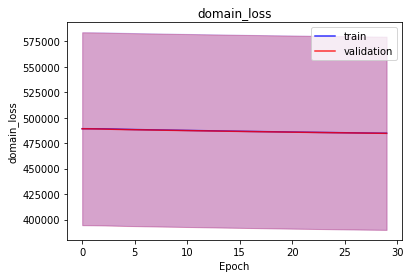

<b>latent_loss</b>: 0.2126 (min: 0.2048, max: 0.2205)

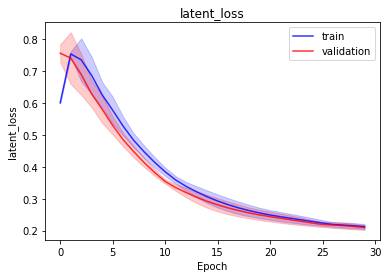

<b>bioma_mse</b>: 540.0762 (min: 519.7650, max: 560.3875)

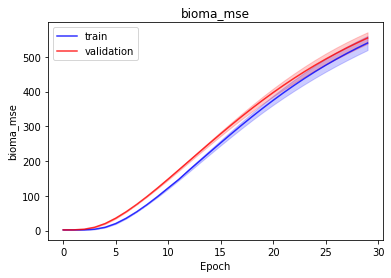

<b>bioma_mae</b>: 12.3341 (min: 11.9211, max: 12.7471)

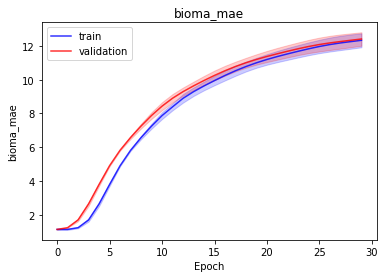

<b>bioma_mape</b>: nan (min: nan, max: nan)

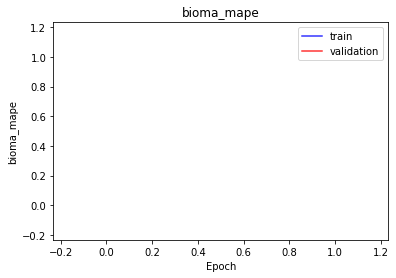

<b>domain_mse</b>: 540.0762 (min: 519.7650, max: 560.3875)

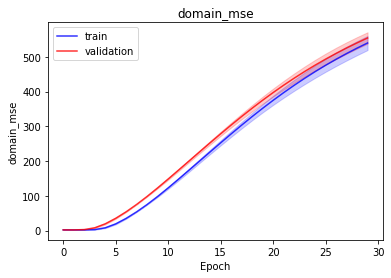

<b>domain_mae</b>: 12.3341 (min: 11.9211, max: 12.7471)

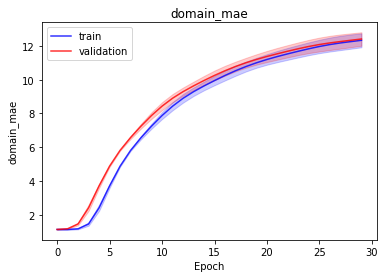

<b>domain_mape</b>: nan (min: nan, max: nan)

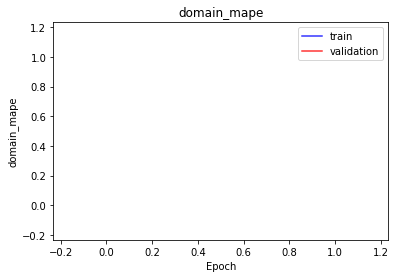

<b>latent_mae</b>: 0.2126 (min: 0.2048, max: 0.2205)

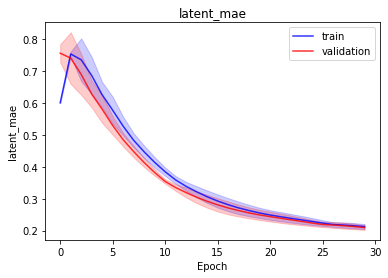

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 969425.5938 (min: 779621.8125, max: 1159229.3750)

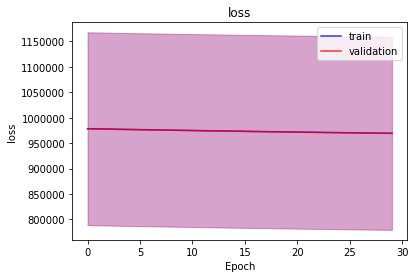

<b>bioma_loss</b>: 484712.6250 (min: 389810.7500, max: 579614.5000)

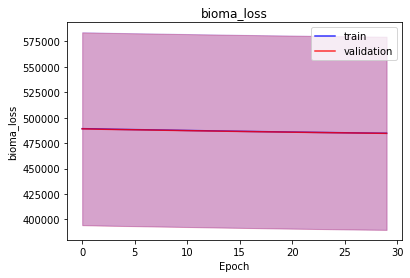

<b>domain_loss</b>: 484712.6250 (min: 389810.7500, max: 579614.5000)

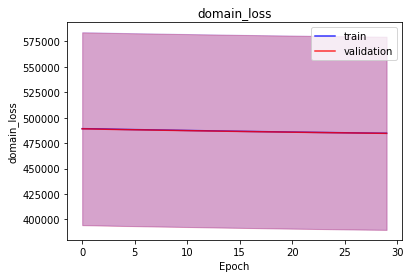

<b>latent_loss</b>: 0.3375 (min: 0.3323, max: 0.3427)

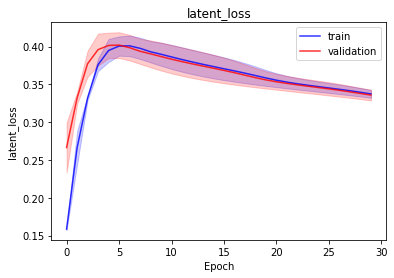

<b>bioma_mse</b>: 541.2003 (min: 520.0469, max: 562.3536)

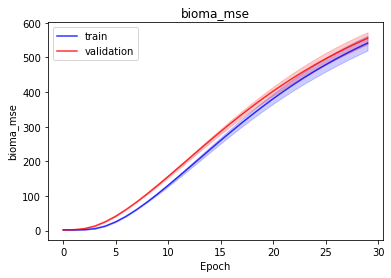

<b>bioma_mae</b>: 12.3475 (min: 11.9138, max: 12.7812)

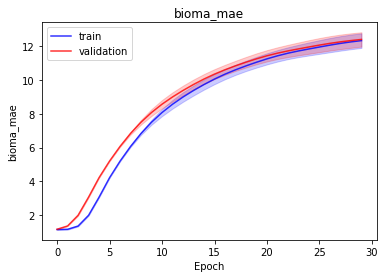

<b>bioma_mape</b>: nan (min: nan, max: nan)

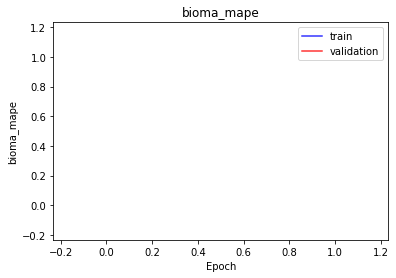

<b>domain_mse</b>: 541.2003 (min: 520.0469, max: 562.3536)

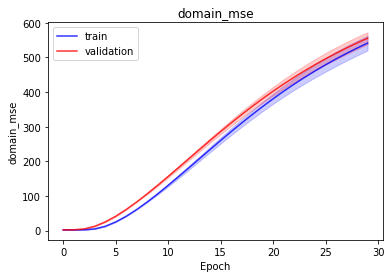

<b>domain_mae</b>: 12.3475 (min: 11.9138, max: 12.7812)

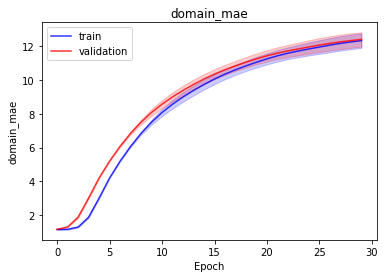

<b>domain_mape</b>: nan (min: nan, max: nan)

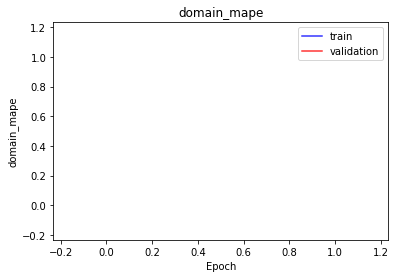

<b>latent_mae</b>: 0.3375 (min: 0.3323, max: 0.3427)

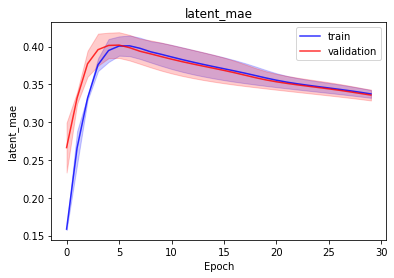

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 735978.8125 (min: 535495.8750, max: 936461.7500)

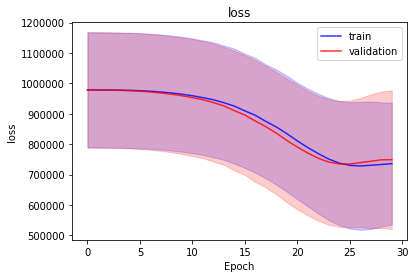

<b>bioma_loss</b>: 364714.0000 (min: 266518.0000, max: 462909.9688)

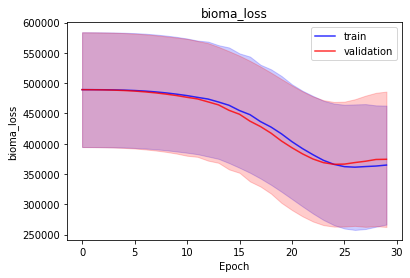

<b>domain_loss</b>: 371264.2500 (min: 268977.3750, max: 473551.1250)

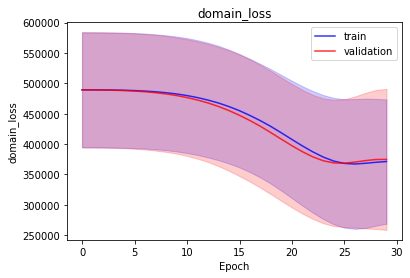

<b>latent_loss</b>: 0.5757 (min: 0.5173, max: 0.6341)

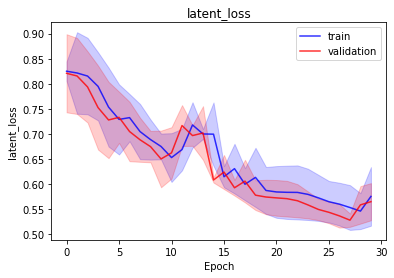

<b>bioma_mse</b>: 213372.7656 (min: 202209.3750, max: 224536.1562)

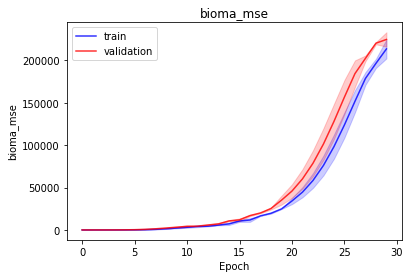

<b>bioma_mae</b>: 56.3255 (min: 56.1862, max: 56.4648)

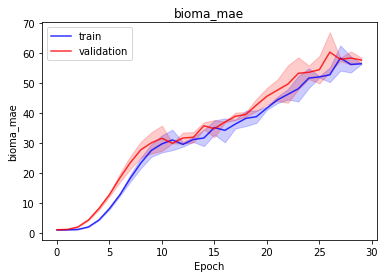

<b>bioma_mape</b>: nan (min: nan, max: nan)

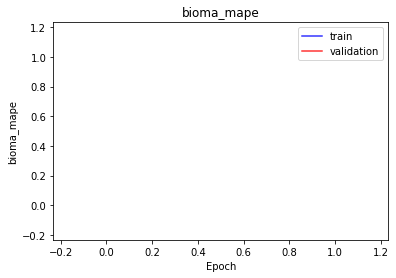

<b>domain_mse</b>: 199914.2500 (min: 180206.6250, max: 219621.8594)

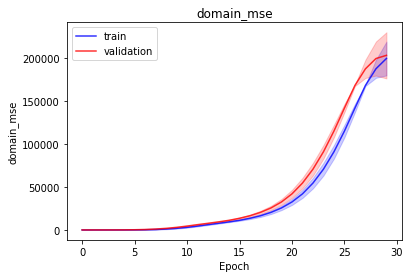

<b>domain_mae</b>: 55.9322 (min: 55.4678, max: 56.3966)

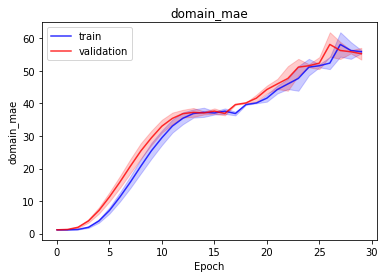

<b>domain_mape</b>: nan (min: nan, max: nan)

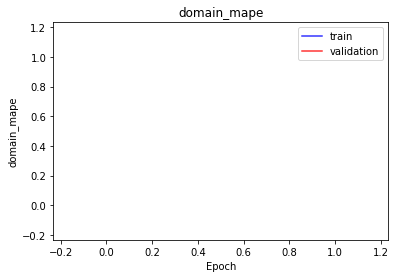

<b>latent_mae</b>: 0.5757 (min: 0.5173, max: 0.6341)

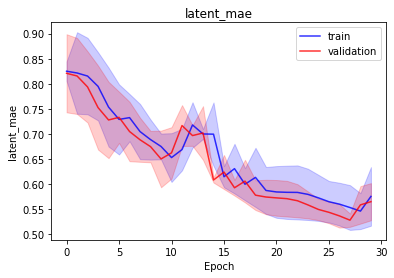

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 730797.6875 (min: 526841.8125, max: 934753.5625)

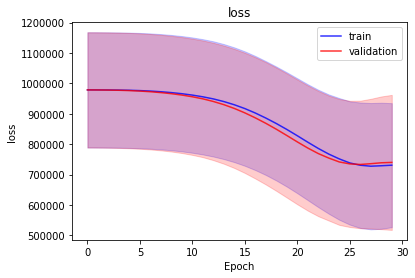

<b>bioma_loss</b>: 356015.6562 (min: 257140.6406, max: 454890.6875)

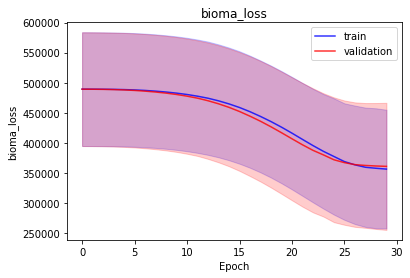

<b>domain_loss</b>: 374781.6562 (min: 269700.7812, max: 479862.5312)

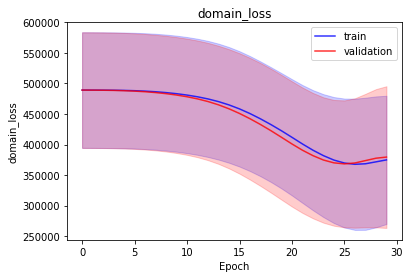

<b>latent_loss</b>: 0.3282 (min: 0.2884, max: 0.3681)

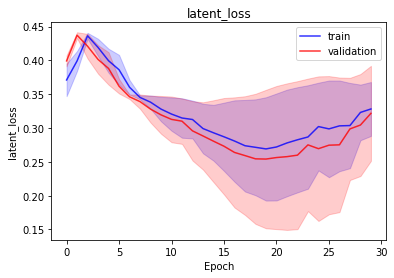

<b>bioma_mse</b>: 140361.2031 (min: 130164.1406, max: 150558.2656)

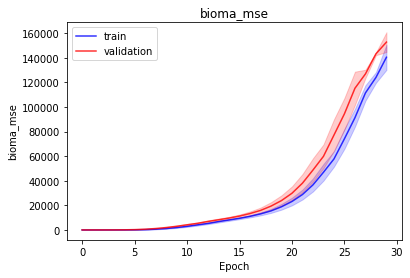

<b>bioma_mae</b>: 46.3583 (min: 44.2777, max: 48.4390)

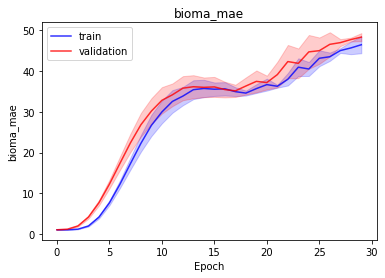

<b>bioma_mape</b>: nan (min: nan, max: nan)

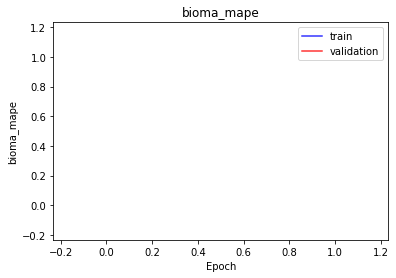

<b>domain_mse</b>: 213961.5000 (min: 201702.4375, max: 226220.5469)

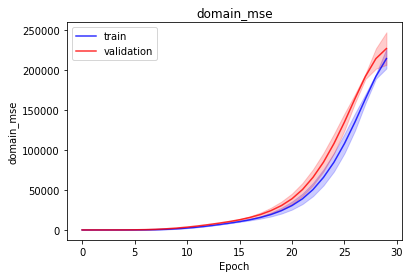

<b>domain_mae</b>: 58.6161 (min: 57.5868, max: 59.6455)

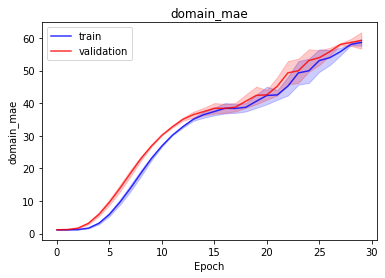

<b>domain_mape</b>: nan (min: nan, max: nan)

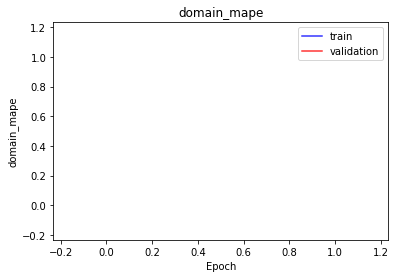

<b>latent_mae</b>: 0.3282 (min: 0.2884, max: 0.3681)

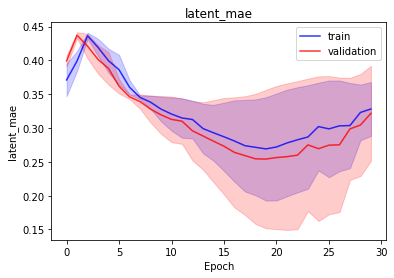

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 971596.9375 (min: 781890.7500, max: 1161303.1250)

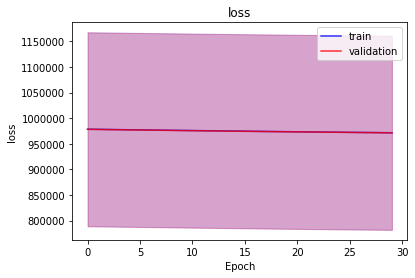

<b>bioma_loss</b>: 485798.4062 (min: 390945.3125, max: 580651.5000)

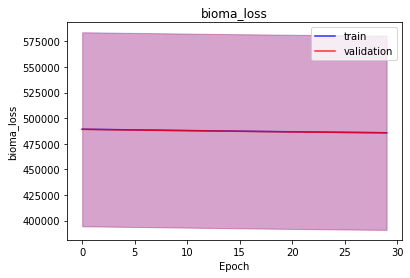

<b>domain_loss</b>: 485798.4062 (min: 390945.3125, max: 580651.5000)

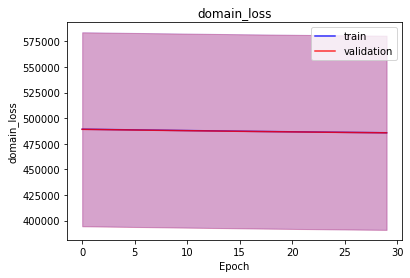

<b>latent_loss</b>: 0.1277 (min: 0.1127, max: 0.1426)

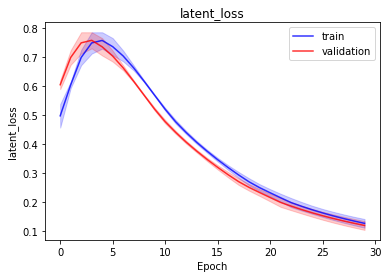

<b>bioma_mse</b>: 409.0590 (min: 391.2807, max: 426.8373)

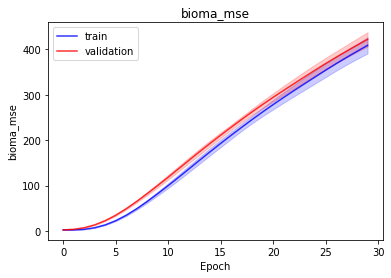

<b>bioma_mae</b>: 11.4148 (min: 11.0314, max: 11.7982)

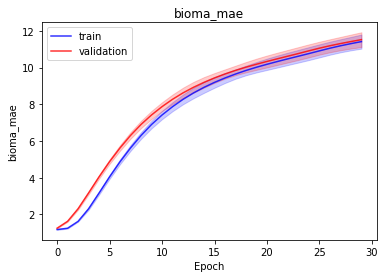

<b>bioma_mape</b>: nan (min: nan, max: nan)

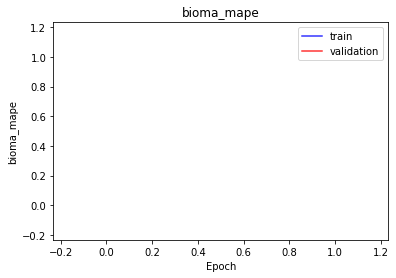

<b>domain_mse</b>: 409.0681 (min: 391.2837, max: 426.8524)

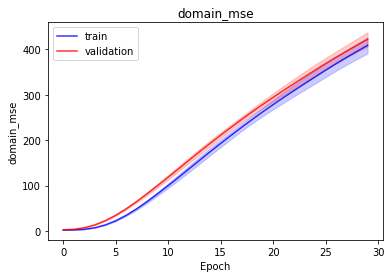

<b>domain_mae</b>: 11.4150 (min: 11.0315, max: 11.7985)

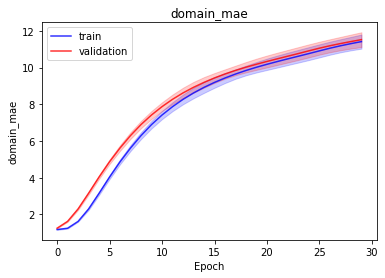

<b>domain_mape</b>: nan (min: nan, max: nan)

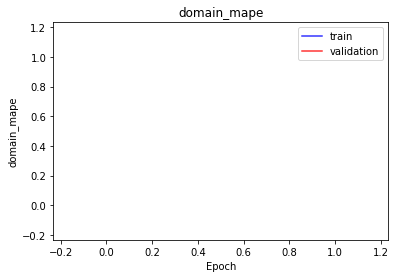

<b>latent_mae</b>: 0.1277 (min: 0.1127, max: 0.1426)

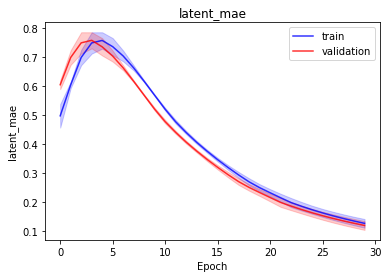

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 971585.2812 (min: 781943.9375, max: 1161226.6250)

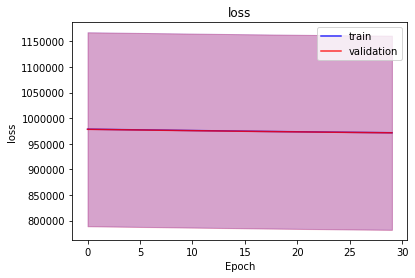

<b>bioma_loss</b>: 485792.5312 (min: 390971.8750, max: 580613.1875)

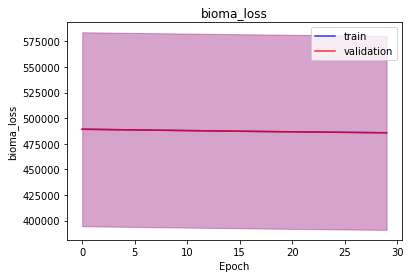

<b>domain_loss</b>: 485792.5312 (min: 390971.8750, max: 580613.1875)

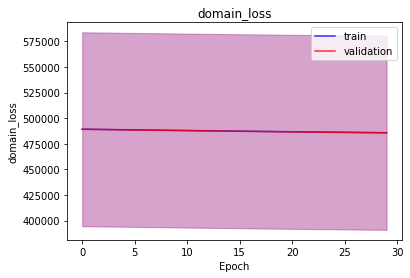

<b>latent_loss</b>: 0.2157 (min: 0.2014, max: 0.2300)

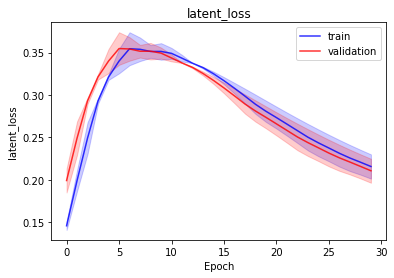

<b>bioma_mse</b>: 412.4062 (min: 390.3902, max: 434.4222)

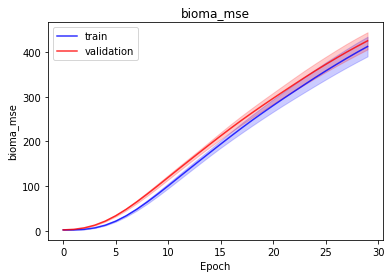

<b>bioma_mae</b>: 11.4378 (min: 11.0203, max: 11.8553)

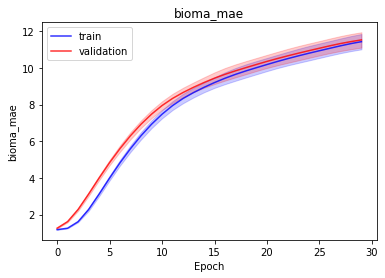

<b>bioma_mape</b>: nan (min: nan, max: nan)

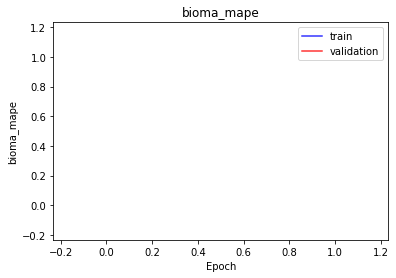

<b>domain_mse</b>: 412.4045 (min: 390.3955, max: 434.4135)

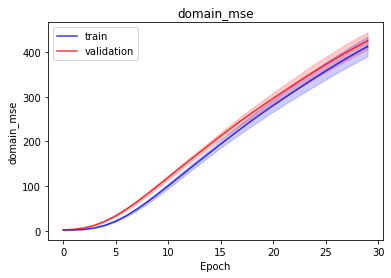

<b>domain_mae</b>: 11.4377 (min: 11.0204, max: 11.8550)

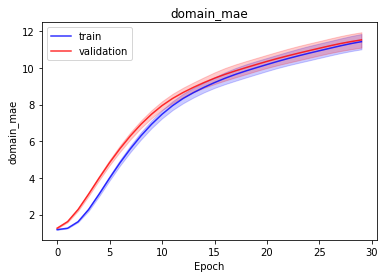

<b>domain_mape</b>: nan (min: nan, max: nan)

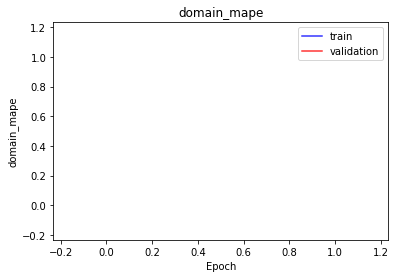

<b>latent_mae</b>: 0.2157 (min: 0.2014, max: 0.2300)

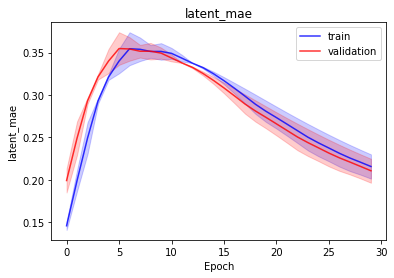

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973587.3125 (min: 783936.7500, max: 1163237.8750)

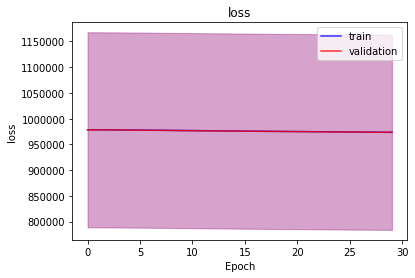

<b>bioma_loss</b>: 486789.5938 (min: 391965.8125, max: 581613.3750)

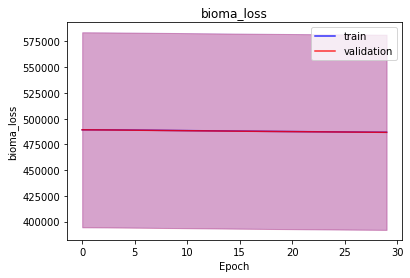

<b>domain_loss</b>: 486797.6250 (min: 391970.8750, max: 581624.3750)

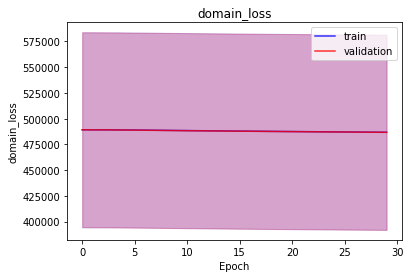

<b>latent_loss</b>: 0.0741 (min: 0.0619, max: 0.0863)

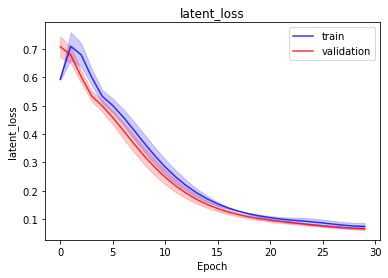

<b>bioma_mse</b>: 242.4731 (min: 232.5219, max: 252.4243)

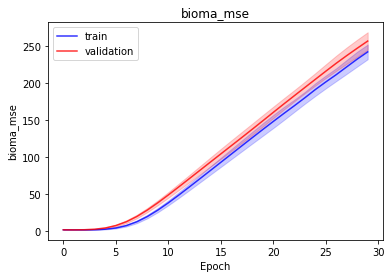

<b>bioma_mae</b>: 9.6154 (min: 9.3704, max: 9.8603)

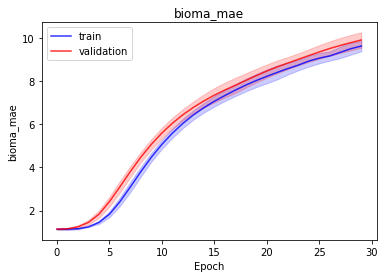

<b>bioma_mape</b>: nan (min: nan, max: nan)

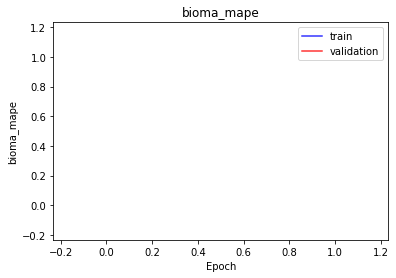

<b>domain_mse</b>: 250.3787 (min: 237.4360, max: 263.3214)

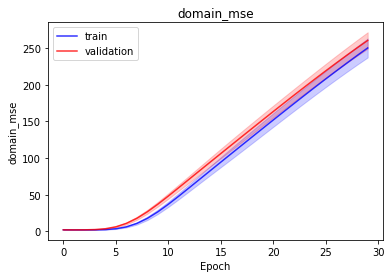

<b>domain_mae</b>: 9.8430 (min: 9.5110, max: 10.1750)

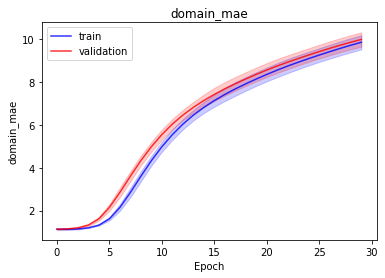

<b>domain_mape</b>: nan (min: nan, max: nan)

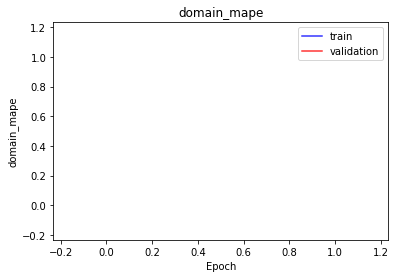

<b>latent_mae</b>: 0.0741 (min: 0.0619, max: 0.0863)

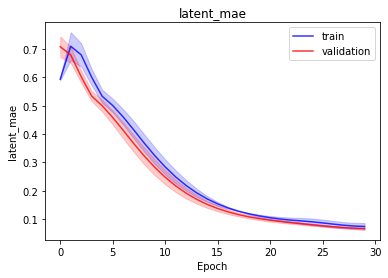

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973622.8438 (min: 784007.0625, max: 1163238.6250)

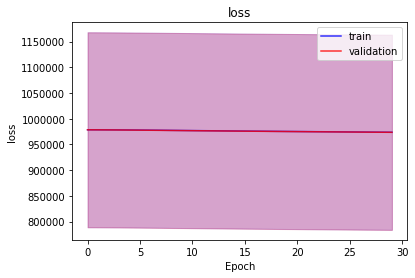

<b>bioma_loss</b>: 486810.9375 (min: 392003.1250, max: 581618.7500)

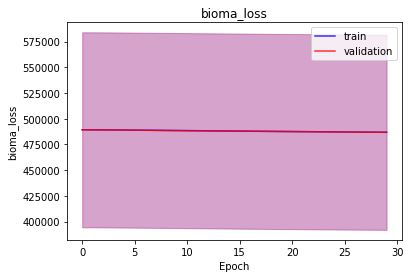

<b>domain_loss</b>: 486811.7500 (min: 392003.7188, max: 581619.7500)

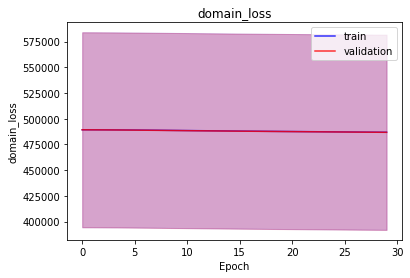

<b>latent_loss</b>: 0.1672 (min: 0.1628, max: 0.1715)

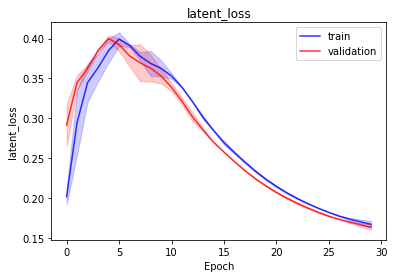

<b>bioma_mse</b>: 244.6356 (min: 232.9808, max: 256.2904)

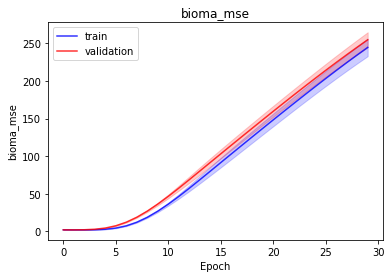

<b>bioma_mae</b>: 9.7188 (min: 9.4223, max: 10.0153)

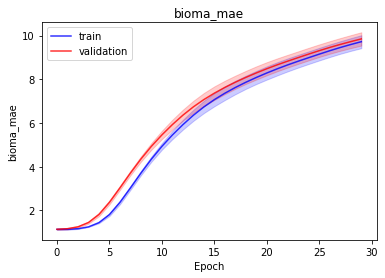

<b>bioma_mape</b>: nan (min: nan, max: nan)

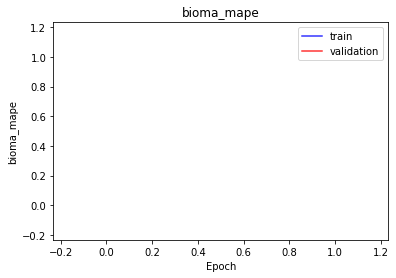

<b>domain_mse</b>: 244.7368 (min: 232.9003, max: 256.5734)

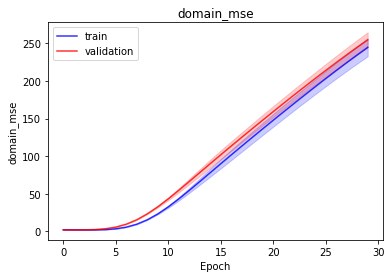

<b>domain_mae</b>: 9.7203 (min: 9.4203, max: 10.0202)

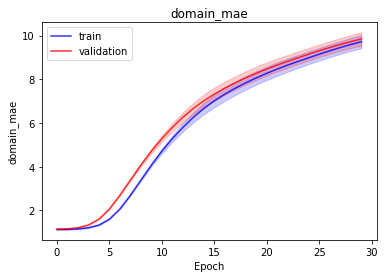

<b>domain_mape</b>: nan (min: nan, max: nan)

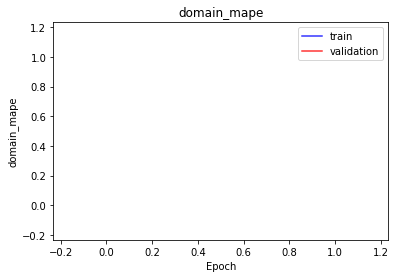

<b>latent_mae</b>: 0.1672 (min: 0.1628, max: 0.1715)

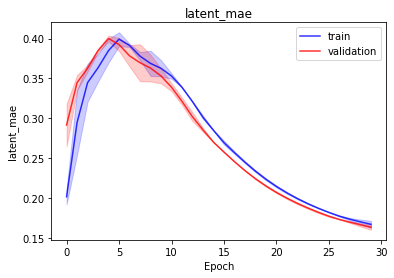

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 959605.7500 (min: 768194.8750, max: 1151016.6250)

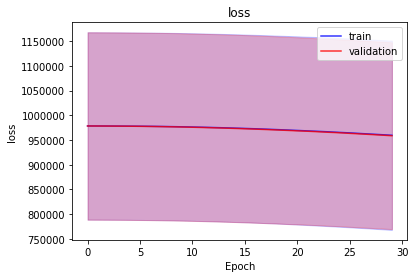

<b>bioma_loss</b>: 479630.4375 (min: 384115.2812, max: 575145.6250)

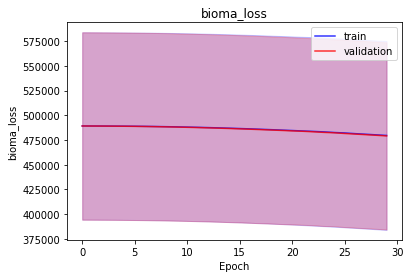

<b>domain_loss</b>: 479974.8750 (min: 384079.3750, max: 575870.3750)

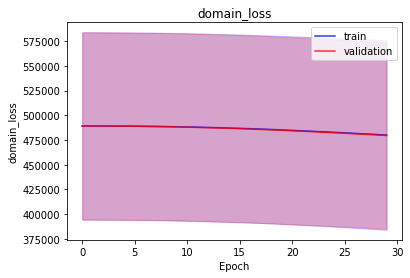

<b>latent_loss</b>: 0.4367 (min: 0.2576, max: 0.6159)

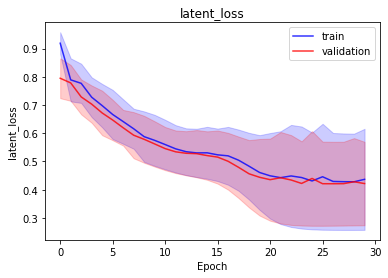

<b>bioma_mse</b>: 1729.2236 (min: 1657.9108, max: 1800.5366)

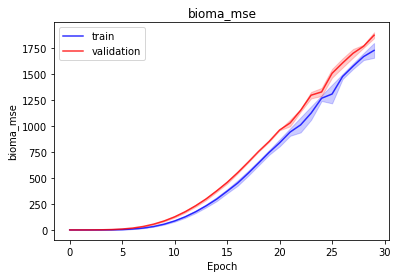

<b>bioma_mae</b>: 16.8529 (min: 16.5127, max: 17.1932)

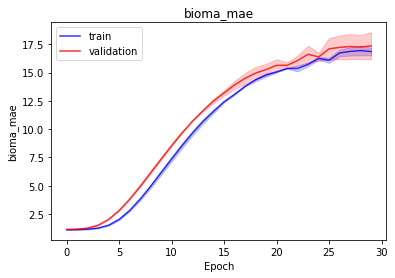

<b>bioma_mape</b>: nan (min: nan, max: nan)

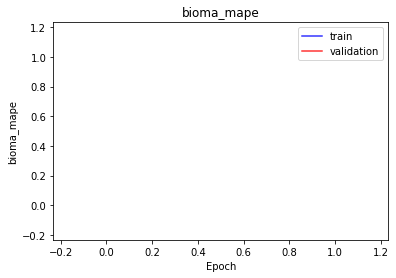

<b>domain_mse</b>: 1717.9159 (min: 1552.4502, max: 1883.3816)

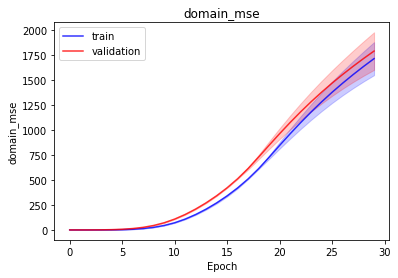

<b>domain_mae</b>: 17.2626 (min: 17.1793, max: 17.3458)

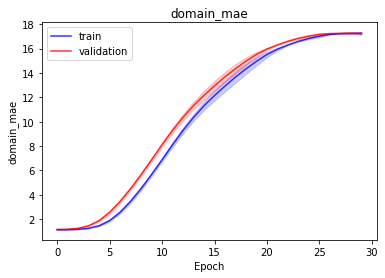

<b>domain_mape</b>: nan (min: nan, max: nan)

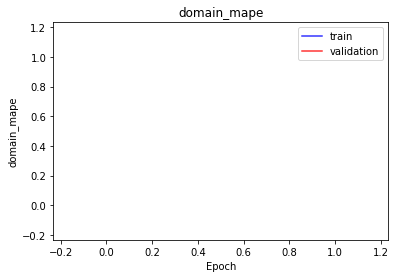

<b>latent_mae</b>: 0.4367 (min: 0.2576, max: 0.6159)

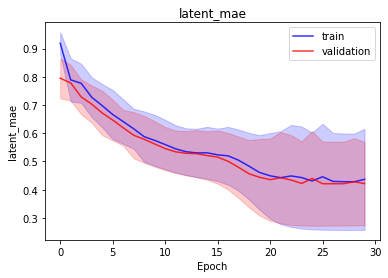

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 960686.6250 (min: 771965.0000, max: 1149408.2500)

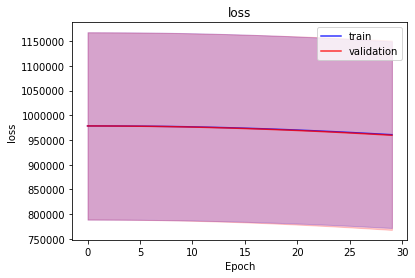

<b>bioma_loss</b>: 481015.8438 (min: 386794.5625, max: 575237.1250)

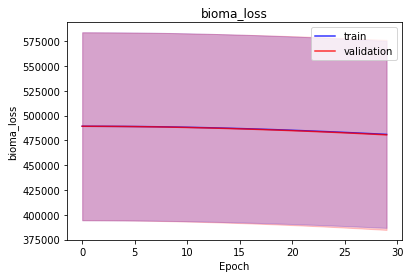

<b>domain_loss</b>: 479670.5000 (min: 385170.1562, max: 574170.8125)

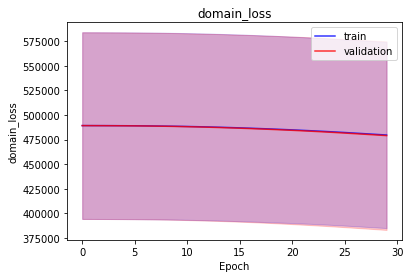

<b>latent_loss</b>: 0.2319 (min: 0.2155, max: 0.2484)

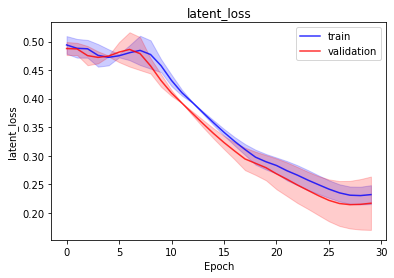

<b>bioma_mse</b>: 1293.3337 (min: 1164.6611, max: 1422.0063)

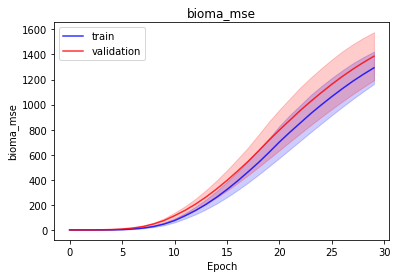

<b>bioma_mae</b>: 15.0961 (min: 14.4922, max: 15.7000)

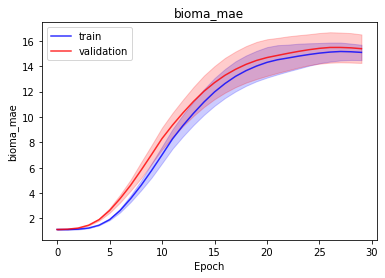

<b>bioma_mape</b>: nan (min: nan, max: nan)

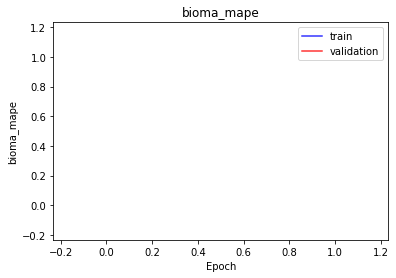

<b>domain_mse</b>: 2046.4094 (min: 1911.4393, max: 2181.3794)

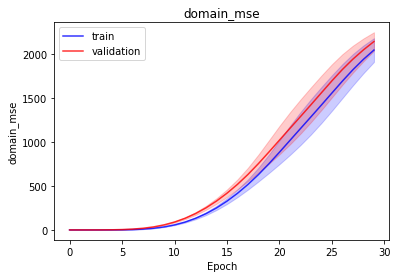

<b>domain_mae</b>: 19.1387 (min: 18.4889, max: 19.7885)

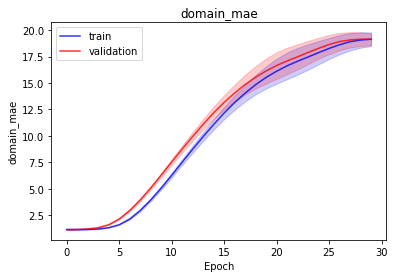

<b>domain_mape</b>: nan (min: nan, max: nan)

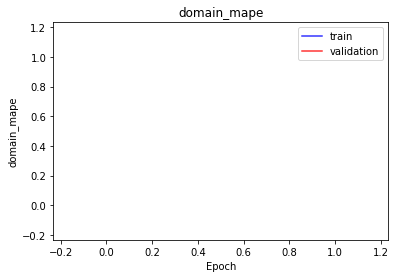

<b>latent_mae</b>: 0.2319 (min: 0.2155, max: 0.2484)

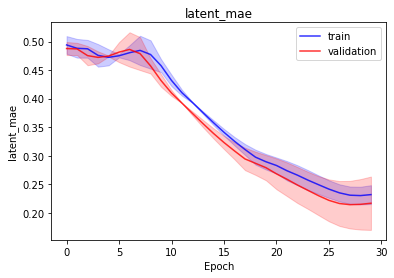

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973764.6875 (min: 784196.7500, max: 1163332.6250)

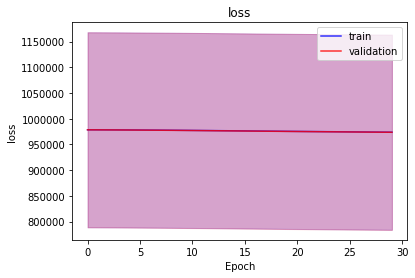

<b>bioma_loss</b>: 486879.3438 (min: 392094.1250, max: 581664.5625)

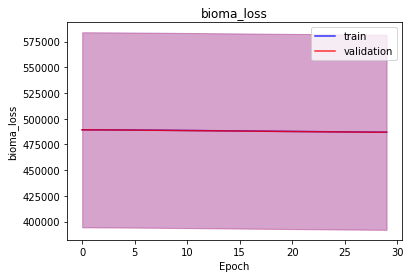

<b>domain_loss</b>: 486885.2500 (min: 392102.4688, max: 581668.0000)

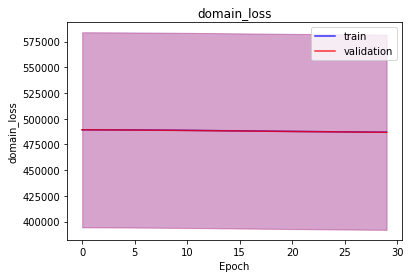

<b>latent_loss</b>: 0.1119 (min: 0.0712, max: 0.1526)

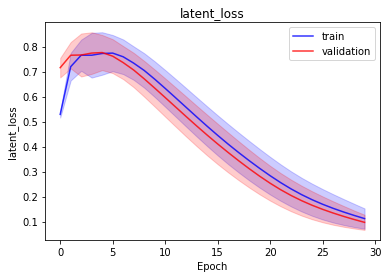

<b>bioma_mse</b>: 278.1241 (min: 266.3531, max: 289.8952)

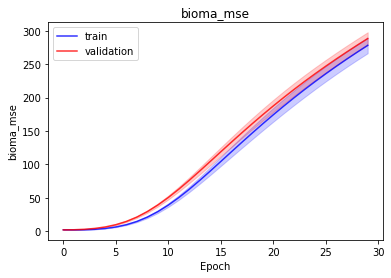

<b>bioma_mae</b>: 10.1412 (min: 9.8648, max: 10.4175)

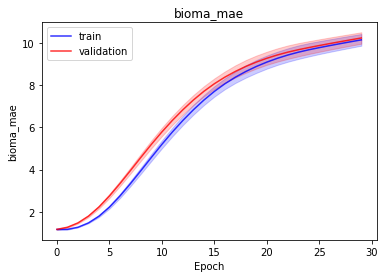

<b>bioma_mape</b>: nan (min: nan, max: nan)

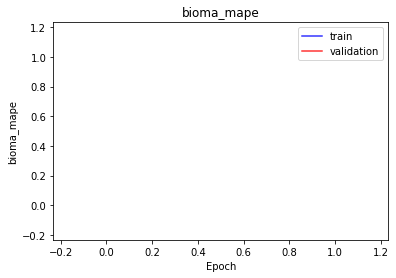

<b>domain_mse</b>: 276.0555 (min: 263.4685, max: 288.6424)

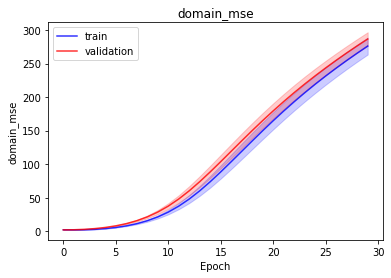

<b>domain_mae</b>: 10.0999 (min: 9.8072, max: 10.3926)

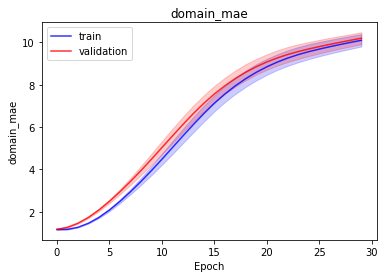

<b>domain_mape</b>: nan (min: nan, max: nan)

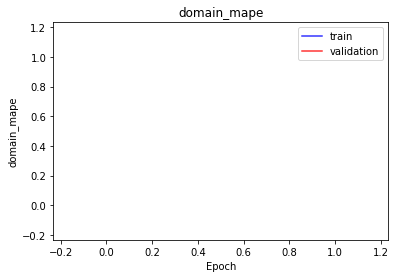

<b>latent_mae</b>: 0.1119 (min: 0.0712, max: 0.1526)

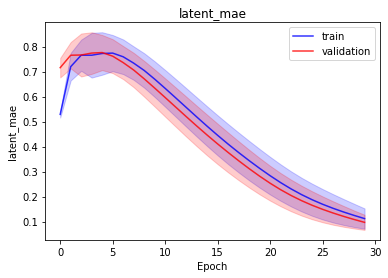

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973763.7500 (min: 784083.5000, max: 1163444.0000)

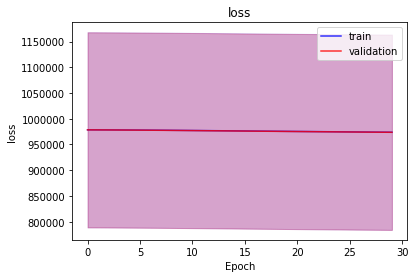

<b>bioma_loss</b>: 486877.8750 (min: 392038.2500, max: 581717.5000)

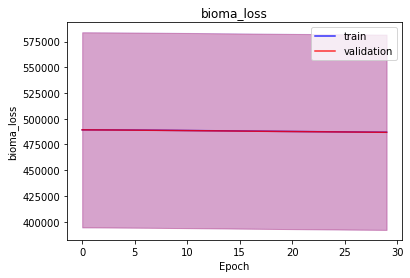

<b>domain_loss</b>: 486885.7500 (min: 392045.1250, max: 581726.3750)

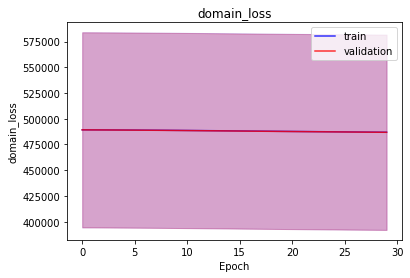

<b>latent_loss</b>: 0.1569 (min: 0.1472, max: 0.1667)

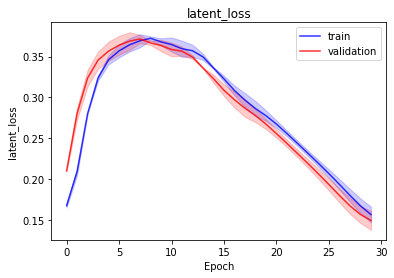

<b>bioma_mse</b>: 274.0004 (min: 263.3820, max: 284.6187)

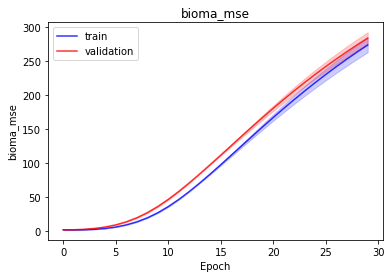

<b>bioma_mae</b>: 10.1212 (min: 9.8062, max: 10.4362)

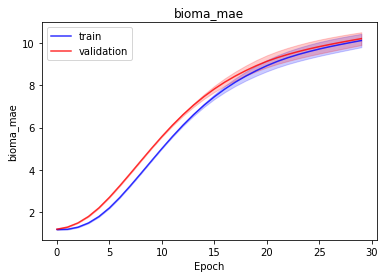

<b>bioma_mape</b>: nan (min: nan, max: nan)

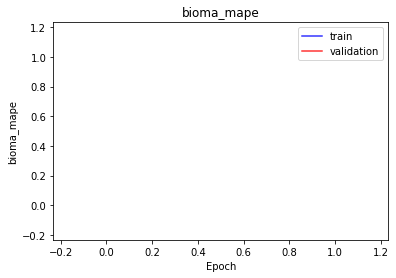

<b>domain_mse</b>: 271.4641 (min: 261.3771, max: 281.5512)

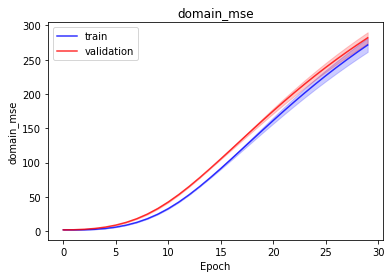

<b>domain_mae</b>: 10.0717 (min: 9.7668, max: 10.3765)

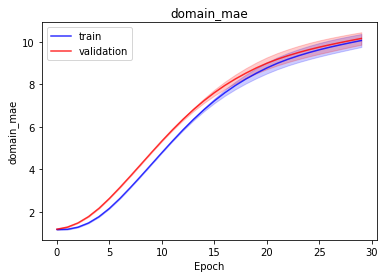

<b>domain_mape</b>: nan (min: nan, max: nan)

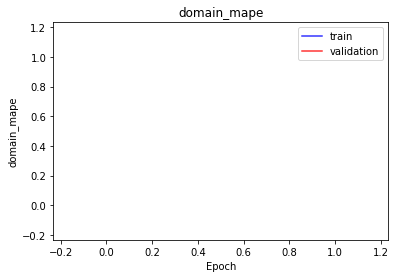

<b>latent_mae</b>: 0.1569 (min: 0.1472, max: 0.1667)

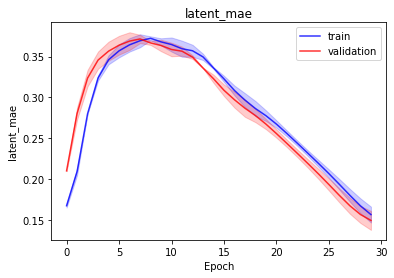

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977678.3438 (min: 788207.6875, max: 1167149.0000)

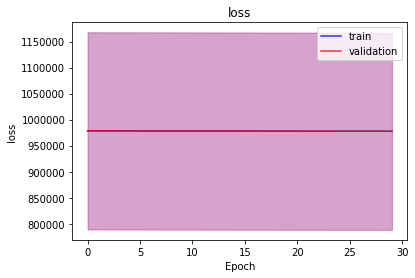

<b>bioma_loss</b>: 488842.1250 (min: 394102.7188, max: 583581.5000)

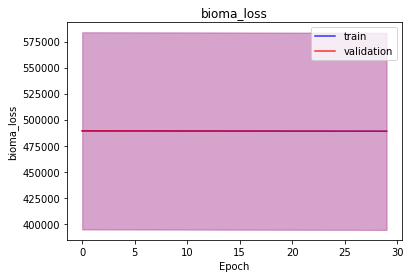

<b>domain_loss</b>: 488835.6875 (min: 394104.3125, max: 583567.0625)

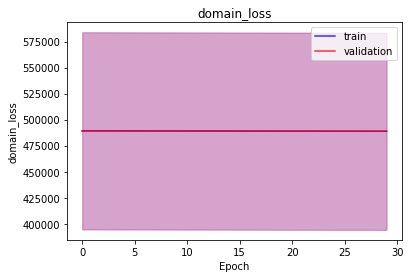

<b>latent_loss</b>: 0.6119 (min: 0.5446, max: 0.6792)

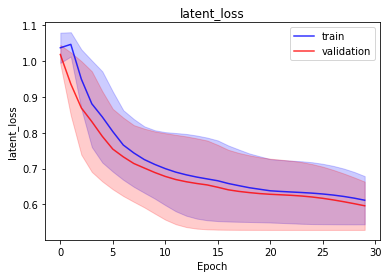

<b>bioma_mse</b>: 13.2523 (min: 11.3038, max: 15.2008)

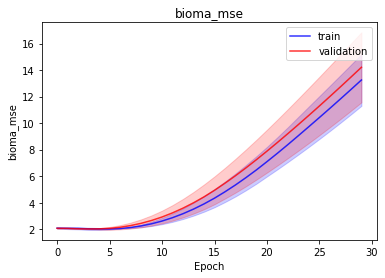

<b>bioma_mae</b>: 3.1194 (min: 2.9093, max: 3.3296)

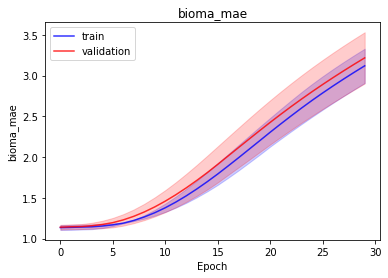

<b>bioma_mape</b>: nan (min: nan, max: nan)

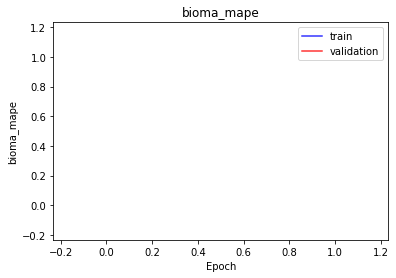

<b>domain_mse</b>: 13.3138 (min: 11.0522, max: 15.5753)

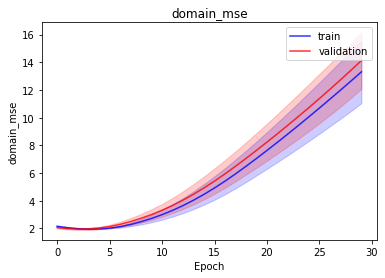

<b>domain_mae</b>: 3.1696 (min: 2.9181, max: 3.4212)

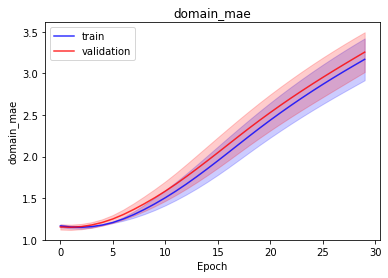

<b>domain_mape</b>: nan (min: nan, max: nan)

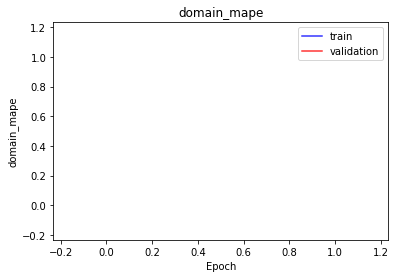

<b>latent_mae</b>: 0.6119 (min: 0.5446, max: 0.6792)

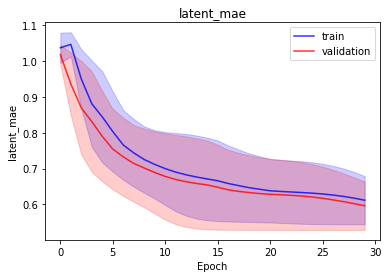

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977672.8750 (min: 788136.0000, max: 1167209.7500)

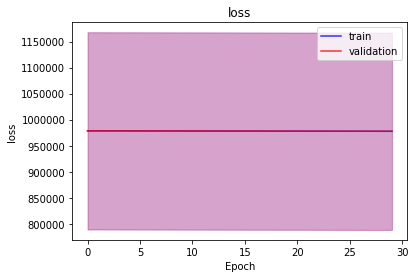

<b>bioma_loss</b>: 488863.0625 (min: 394110.9062, max: 583615.1875)

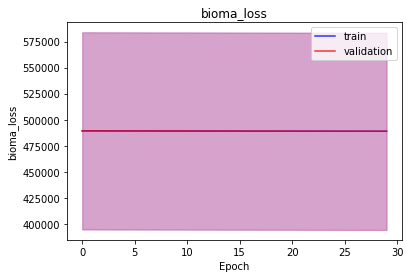

<b>domain_loss</b>: 488809.5000 (min: 394024.7188, max: 583594.3125)

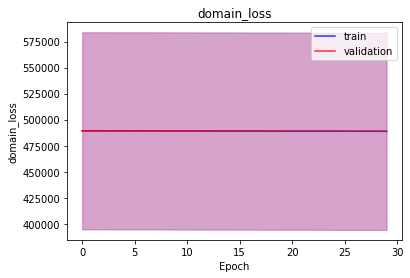

<b>latent_loss</b>: 0.3440 (min: 0.3064, max: 0.3815)

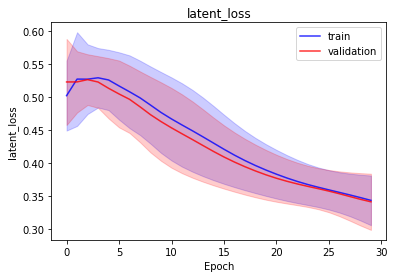

<b>bioma_mse</b>: 11.4028 (min: 10.3846, max: 12.4209)

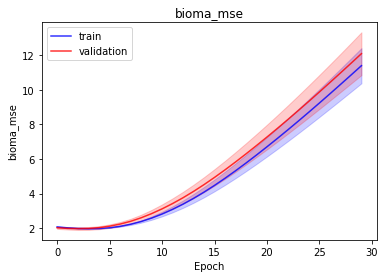

<b>bioma_mae</b>: 2.9452 (min: 2.8143, max: 3.0761)

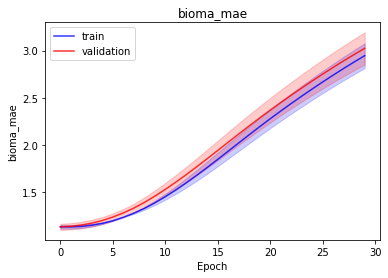

<b>bioma_mape</b>: nan (min: nan, max: nan)

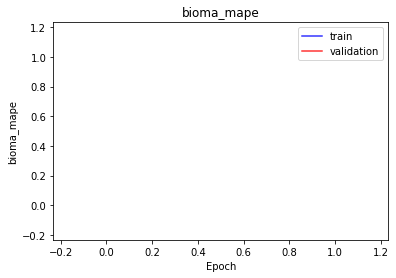

<b>domain_mse</b>: 17.5057 (min: 16.2293, max: 18.7822)

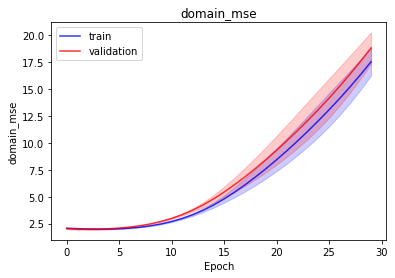

<b>domain_mae</b>: 3.6034 (min: 3.4939, max: 3.7129)

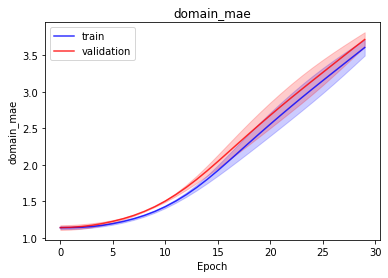

<b>domain_mape</b>: nan (min: nan, max: nan)

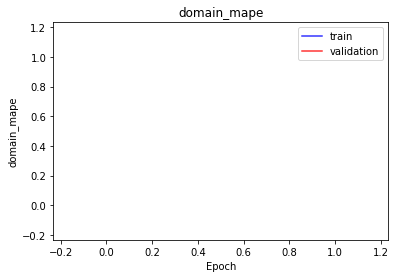

<b>latent_mae</b>: 0.3440 (min: 0.3064, max: 0.3815)

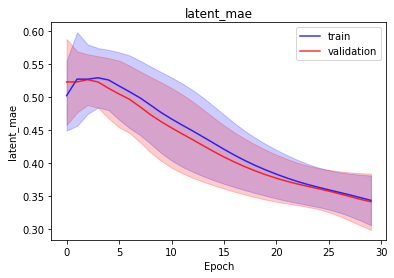

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977665.2500 (min: 788171.7500, max: 1167158.7500)

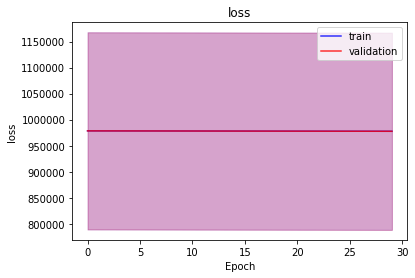

<b>bioma_loss</b>: 488838.8125 (min: 394096.0312, max: 583581.6250)

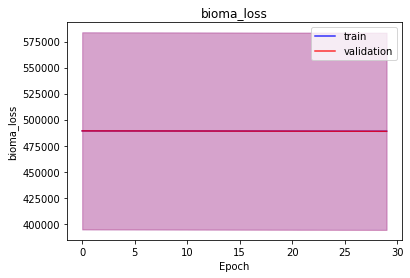

<b>domain_loss</b>: 488825.8750 (min: 394075.0938, max: 583576.6250)

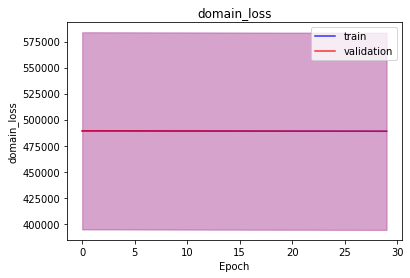

<b>latent_loss</b>: 0.5745 (min: 0.5271, max: 0.6219)

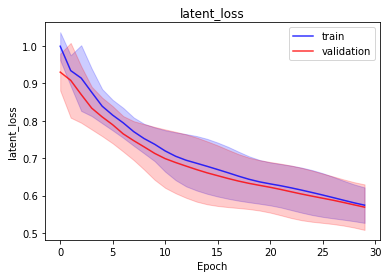

<b>bioma_mse</b>: 13.2534 (min: 11.9805, max: 14.5264)

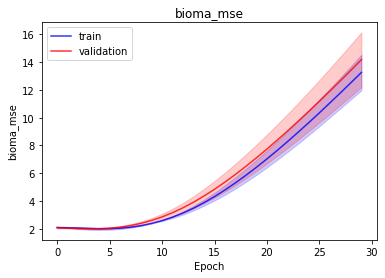

<b>bioma_mae</b>: 3.1254 (min: 2.9860, max: 3.2649)

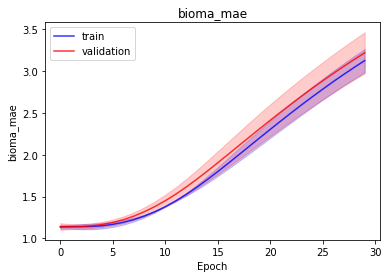

<b>bioma_mape</b>: nan (min: nan, max: nan)

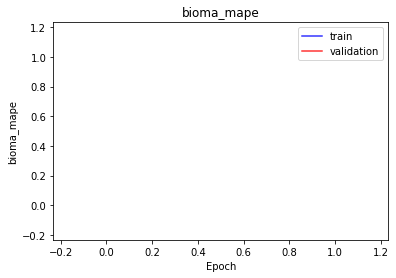

<b>domain_mse</b>: 13.9008 (min: 12.3759, max: 15.4257)

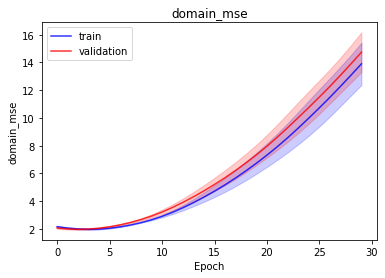

<b>domain_mae</b>: 3.2372 (min: 3.0642, max: 3.4102)

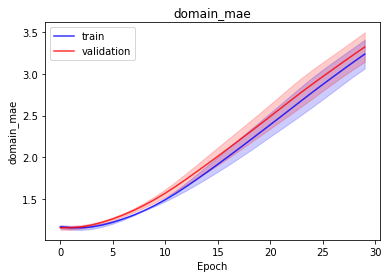

<b>domain_mape</b>: nan (min: nan, max: nan)

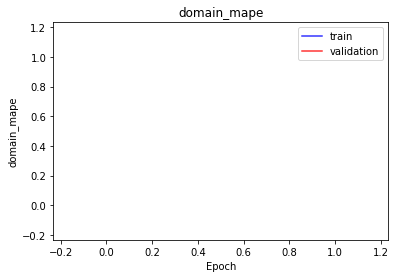

<b>latent_mae</b>: 0.5745 (min: 0.5271, max: 0.6219)

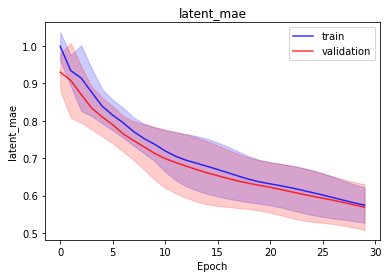

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977769.3750 (min: 788258.0000, max: 1167280.7500)

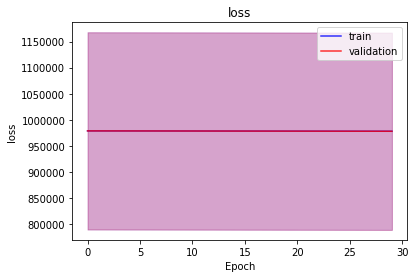

<b>bioma_loss</b>: 488921.5000 (min: 394174.6250, max: 583668.3750)

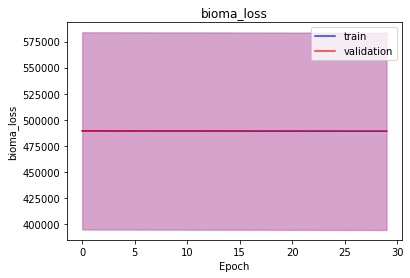

<b>domain_loss</b>: 488847.4375 (min: 394083.0312, max: 583611.8125)

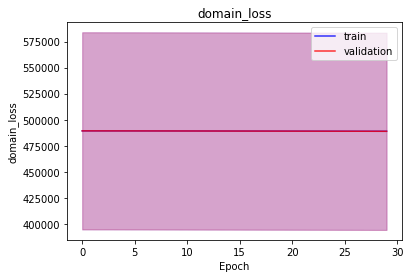

<b>latent_loss</b>: 0.4150 (min: 0.3842, max: 0.4458)

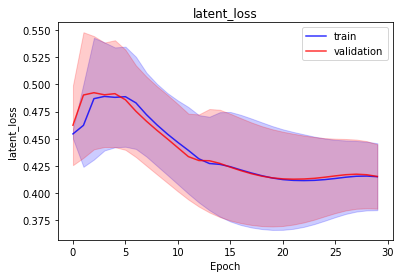

<b>bioma_mse</b>: 8.8463 (min: 7.7665, max: 9.9262)

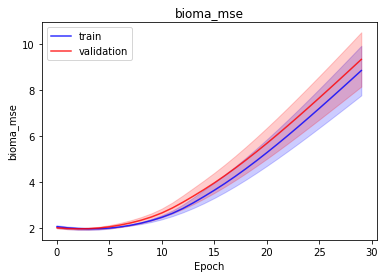

<b>bioma_mae</b>: 2.6114 (min: 2.4533, max: 2.7695)

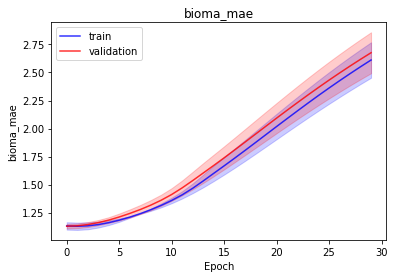

<b>bioma_mape</b>: nan (min: nan, max: nan)

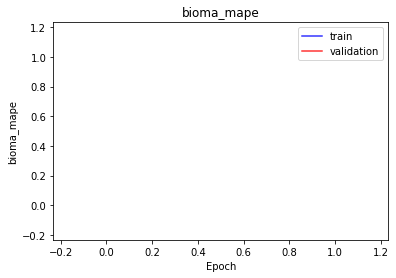

<b>domain_mse</b>: 15.9869 (min: 15.4938, max: 16.4800)

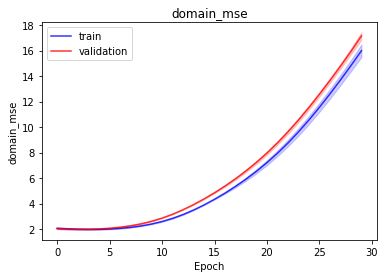

<b>domain_mae</b>: 3.4695 (min: 3.4162, max: 3.5229)

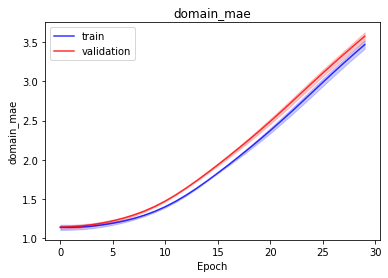

<b>domain_mape</b>: nan (min: nan, max: nan)

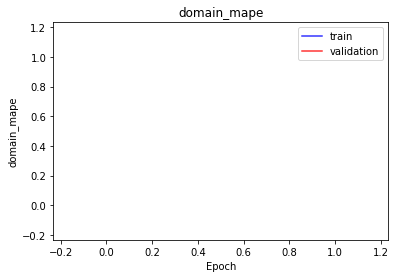

<b>latent_mae</b>: 0.4150 (min: 0.3842, max: 0.4458)

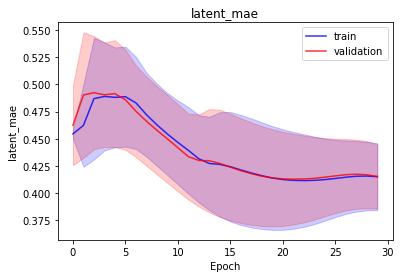

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977588.3438 (min: 788106.8125, max: 1167069.8750)

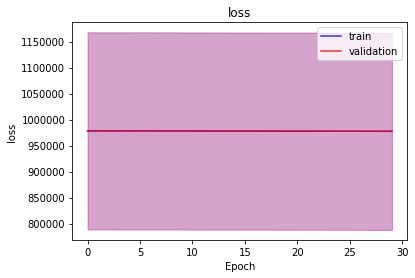

<b>bioma_loss</b>: 488800.0312 (min: 394061.2500, max: 583538.8125)

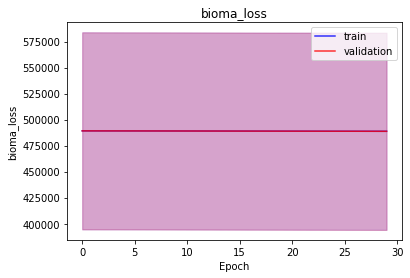

<b>domain_loss</b>: 488787.8125 (min: 394045.0312, max: 583530.6250)

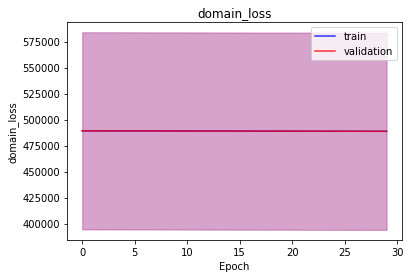

<b>latent_loss</b>: 0.4286 (min: 0.3205, max: 0.5367)

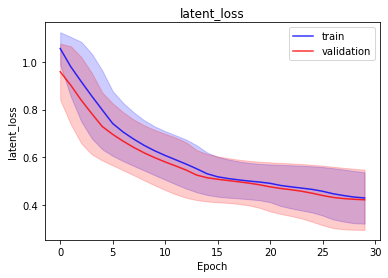

<b>bioma_mse</b>: 14.8261 (min: 13.1300, max: 16.5222)

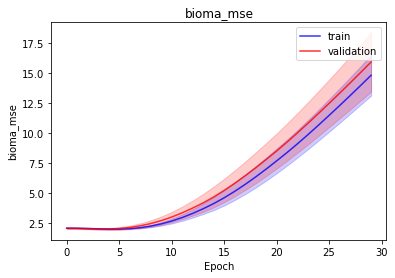

<b>bioma_mae</b>: 3.2886 (min: 3.1210, max: 3.4562)

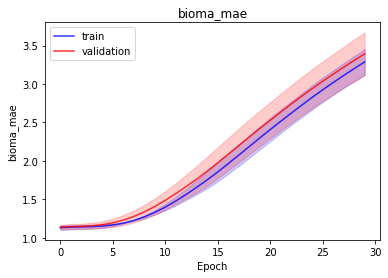

<b>bioma_mape</b>: nan (min: nan, max: nan)

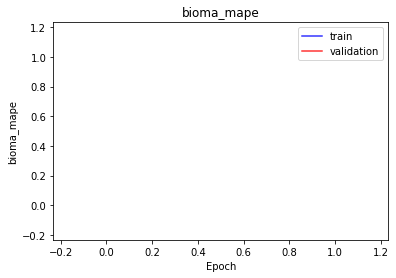

<b>domain_mse</b>: 15.5880 (min: 13.3173, max: 17.8588)

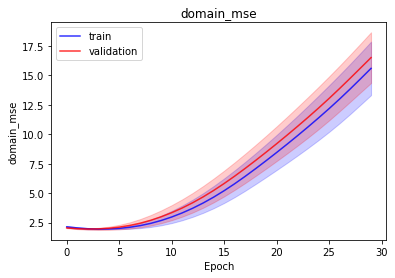

<b>domain_mae</b>: 3.3979 (min: 3.1698, max: 3.6261)

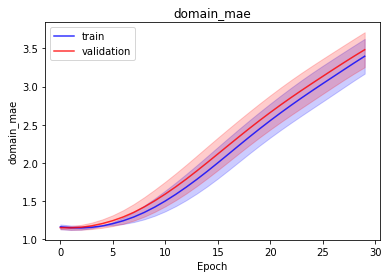

<b>domain_mape</b>: nan (min: nan, max: nan)

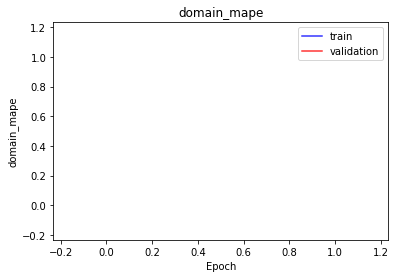

<b>latent_mae</b>: 0.4286 (min: 0.3205, max: 0.5367)

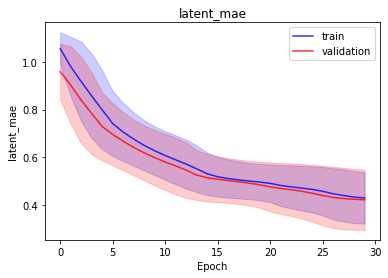

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 977765.4688 (min: 788164.4375, max: 1167366.5000)

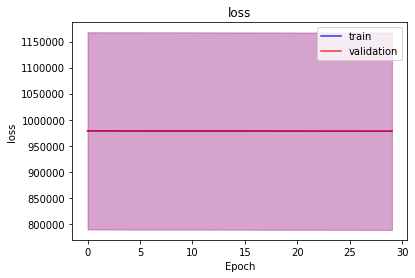

<b>bioma_loss</b>: 488918.6875 (min: 394116.5938, max: 583720.7500)

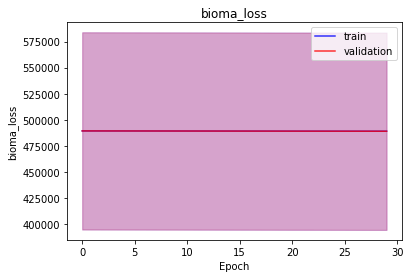

<b>domain_loss</b>: 488846.4688 (min: 394047.5625, max: 583645.3750)

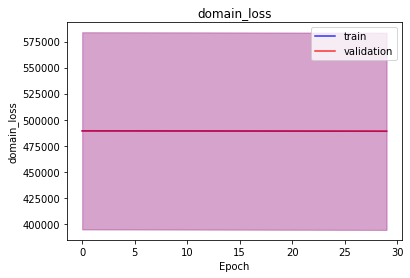

<b>latent_loss</b>: 0.3769 (min: 0.3370, max: 0.4168)

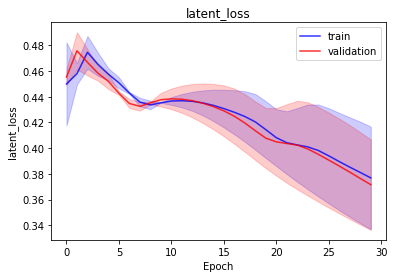

<b>bioma_mse</b>: 9.0566 (min: 7.6783, max: 10.4350)

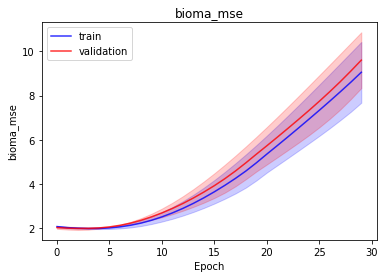

<b>bioma_mae</b>: 2.6329 (min: 2.4423, max: 2.8235)

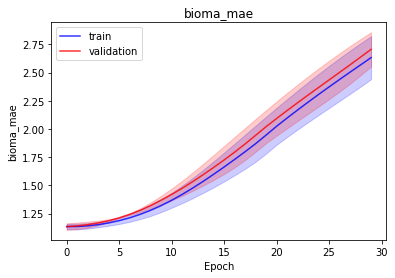

<b>bioma_mape</b>: nan (min: nan, max: nan)

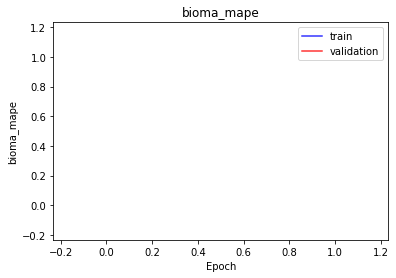

<b>domain_mse</b>: 15.3564 (min: 14.1638, max: 16.5491)

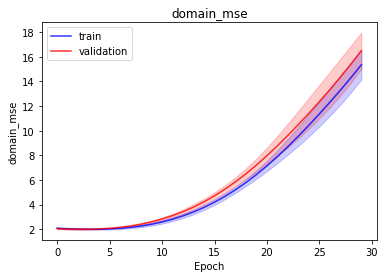

<b>domain_mae</b>: 3.3977 (min: 3.2870, max: 3.5084)

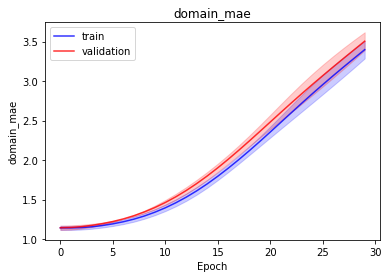

<b>domain_mape</b>: nan (min: nan, max: nan)

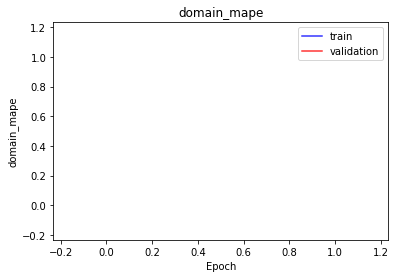

<b>latent_mae</b>: 0.3769 (min: 0.3370, max: 0.4168)

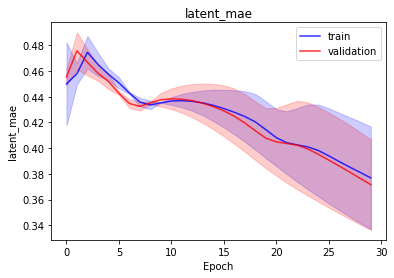

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 969516.0938 (min: 779707.1875, max: 1159325.0000)

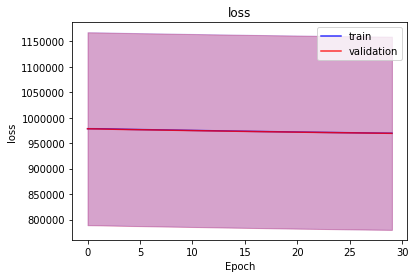

<b>bioma_loss</b>: 484757.9062 (min: 389853.4375, max: 579662.3750)

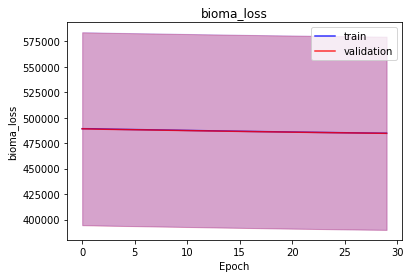

<b>domain_loss</b>: 484757.9375 (min: 389853.4375, max: 579662.4375)

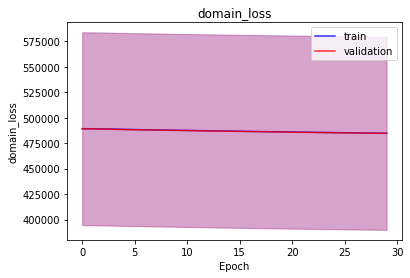

<b>latent_loss</b>: 0.2990 (min: 0.2869, max: 0.3111)

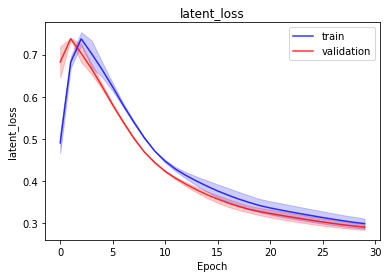

<b>bioma_mse</b>: 541.5291 (min: 520.5878, max: 562.4702)

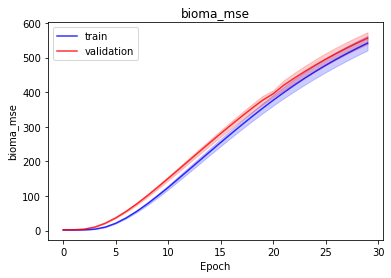

<b>bioma_mae</b>: 12.3612 (min: 11.9463, max: 12.7762)

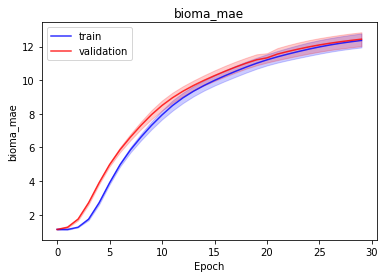

<b>bioma_mape</b>: nan (min: nan, max: nan)

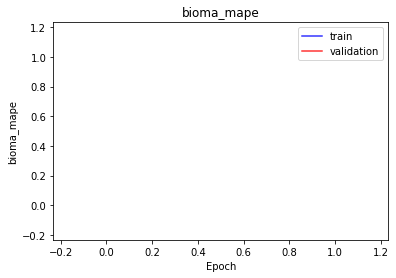

<b>domain_mse</b>: 541.5837 (min: 520.5878, max: 562.5797)

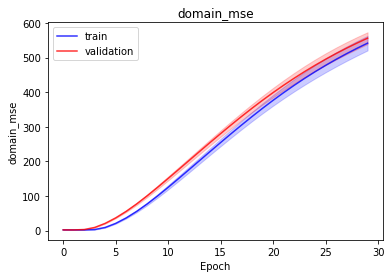

<b>domain_mae</b>: 12.3622 (min: 11.9463, max: 12.7781)

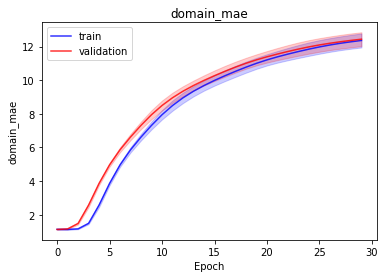

<b>domain_mape</b>: nan (min: nan, max: nan)

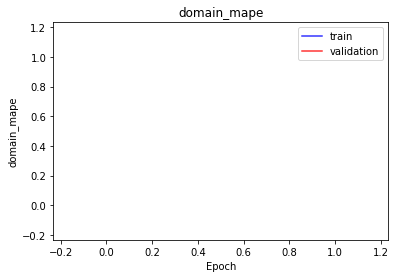

<b>latent_mae</b>: 0.2990 (min: 0.2869, max: 0.3111)

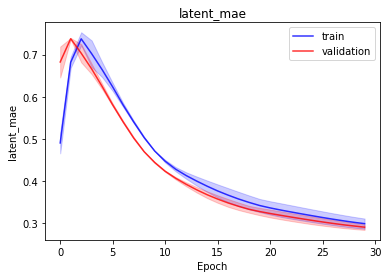

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 969438.6875 (min: 779631.5000, max: 1159245.8750)

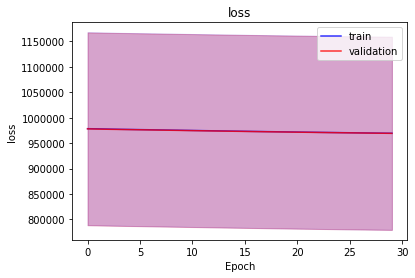

<b>bioma_loss</b>: 484719.1875 (min: 389815.5938, max: 579622.7500)

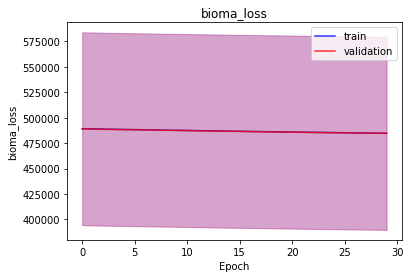

<b>domain_loss</b>: 484719.1875 (min: 389815.5938, max: 579622.7500)

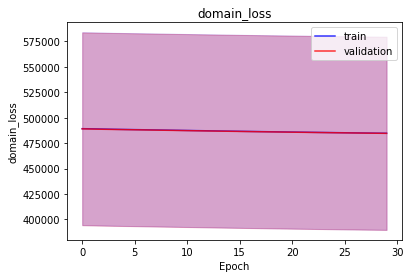

<b>latent_loss</b>: 0.3269 (min: 0.3008, max: 0.3529)

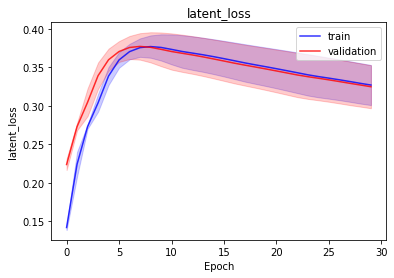

<b>bioma_mse</b>: 541.0506 (min: 519.6228, max: 562.4784)

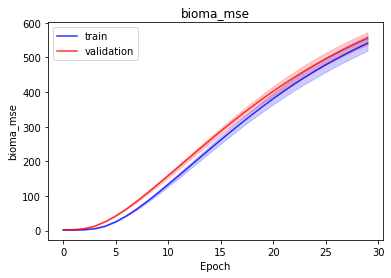

<b>bioma_mae</b>: 12.3497 (min: 11.9390, max: 12.7604)

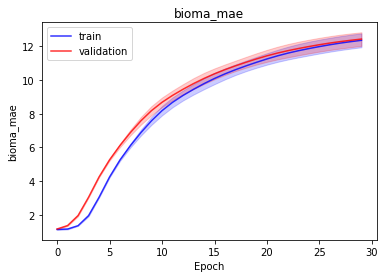

<b>bioma_mape</b>: nan (min: nan, max: nan)

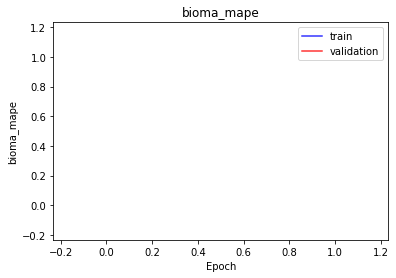

<b>domain_mse</b>: 541.0506 (min: 519.6228, max: 562.4784)

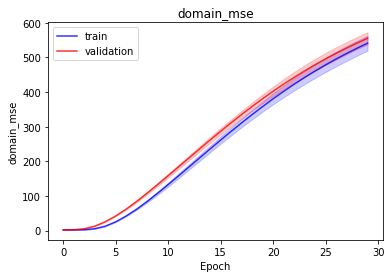

<b>domain_mae</b>: 12.3497 (min: 11.9390, max: 12.7604)

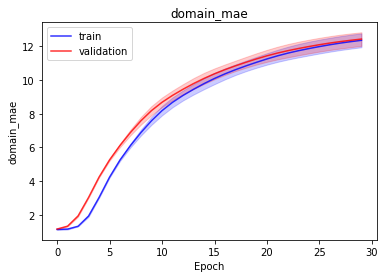

<b>domain_mape</b>: nan (min: nan, max: nan)

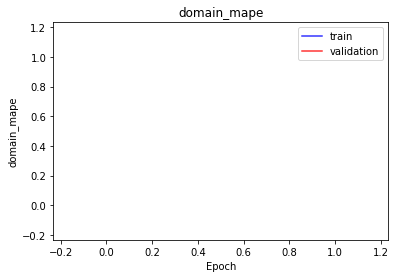

<b>latent_mae</b>: 0.3269 (min: 0.3008, max: 0.3529)

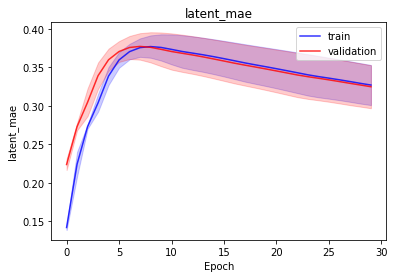

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 708603.0938 (min: 514889.1250, max: 902317.0625)

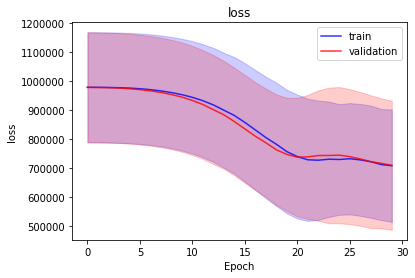

<b>bioma_loss</b>: 352516.7812 (min: 255802.8125, max: 449230.7500)

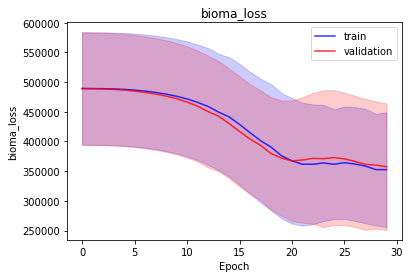

<b>domain_loss</b>: 356085.5312 (min: 259085.4844, max: 453085.5625)

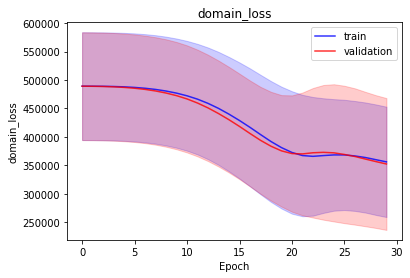

<b>latent_loss</b>: 0.7804 (min: 0.7560, max: 0.8049)

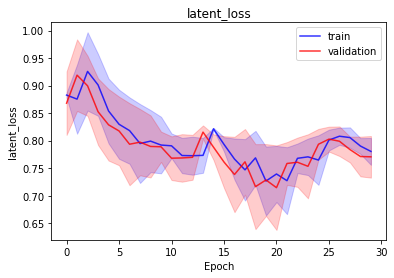

<b>bioma_mse</b>: 160864.8438 (min: 139873.8594, max: 181855.8125)

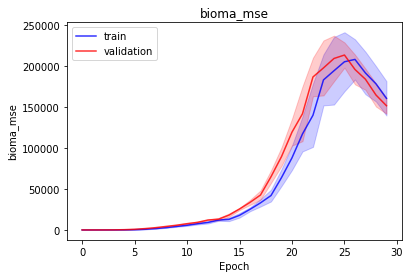

<b>bioma_mae</b>: 46.5172 (min: 39.9708, max: 53.0635)

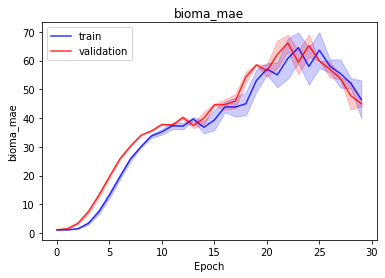

<b>bioma_mape</b>: nan (min: nan, max: nan)

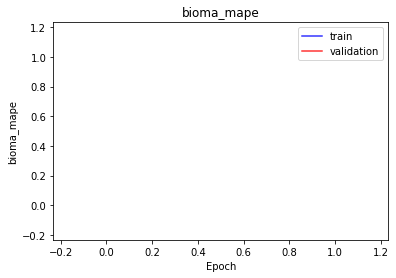

<b>domain_mse</b>: 167818.2031 (min: 152420.5938, max: 183215.8125)

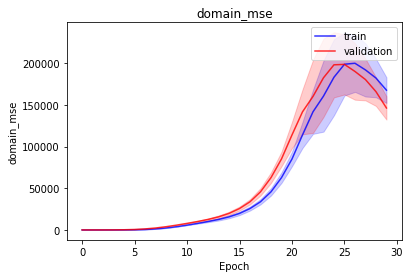

<b>domain_mae</b>: 48.9927 (min: 43.5941, max: 54.3912)

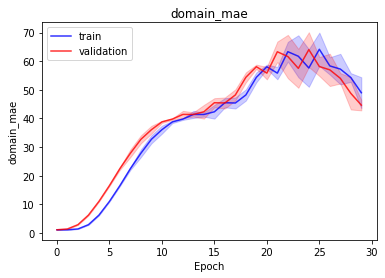

<b>domain_mape</b>: nan (min: nan, max: nan)

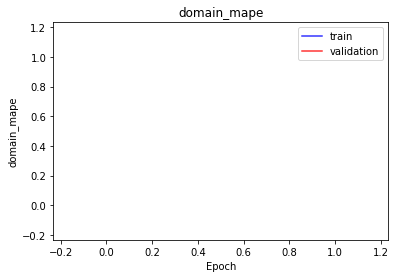

<b>latent_mae</b>: 0.7804 (min: 0.7560, max: 0.8049)

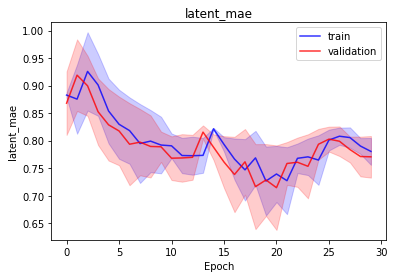

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 723280.9375 (min: 525253.6250, max: 921308.2500)

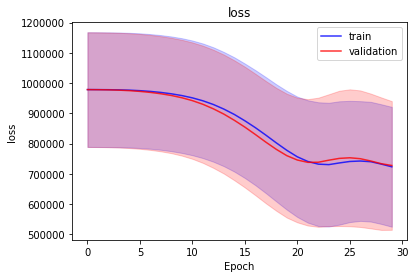

<b>bioma_loss</b>: 348640.6875 (min: 254771.9062, max: 442509.4375)

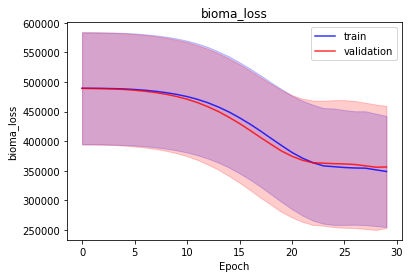

<b>domain_loss</b>: 374639.9375 (min: 270481.4062, max: 478798.4375)

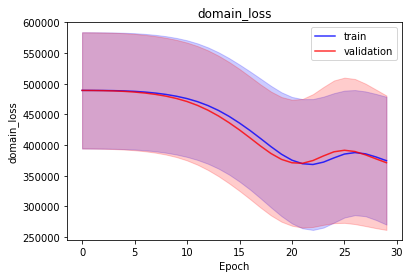

<b>latent_loss</b>: 0.3270 (min: 0.3044, max: 0.3495)

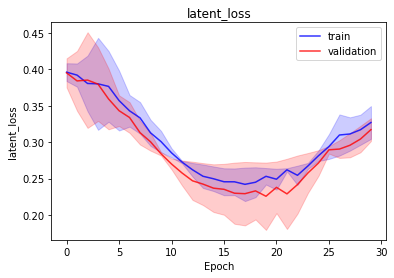

<b>bioma_mse</b>: 139402.4375 (min: 114262.2188, max: 164542.6562)

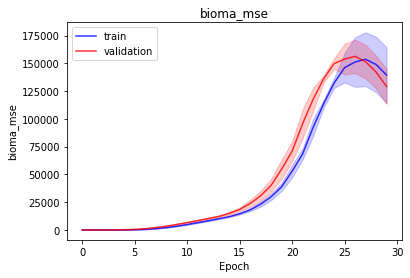

<b>bioma_mae</b>: 45.0333 (min: 40.5473, max: 49.5194)

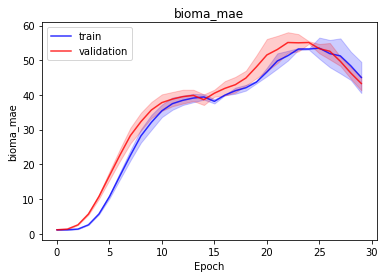

<b>bioma_mape</b>: nan (min: nan, max: nan)

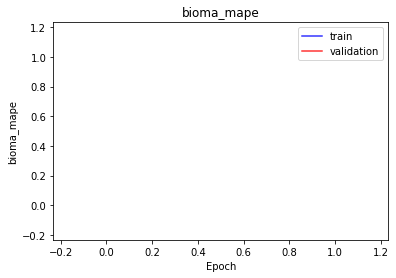

<b>domain_mse</b>: 230802.0938 (min: 215535.8125, max: 246068.3750)

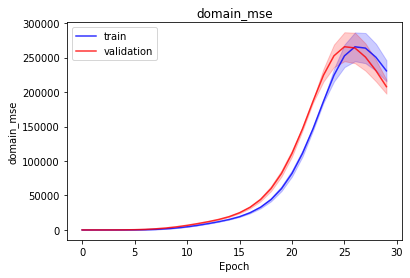

<b>domain_mae</b>: 59.7416 (min: 58.6206, max: 60.8626)

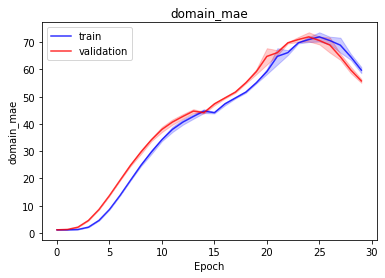

<b>domain_mape</b>: nan (min: nan, max: nan)

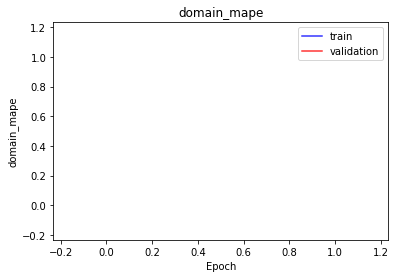

<b>latent_mae</b>: 0.3270 (min: 0.3044, max: 0.3495)

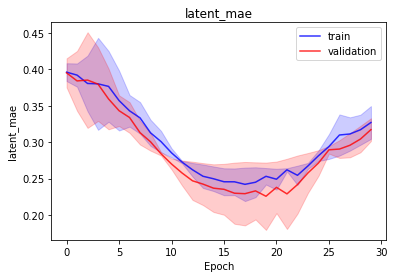

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 971902.7500 (min: 782144.6250, max: 1161660.8750)

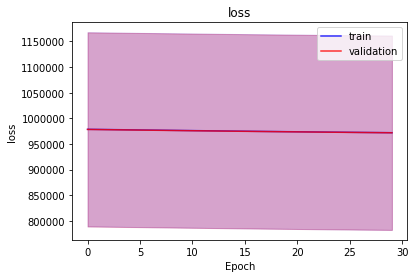

<b>bioma_loss</b>: 485951.2812 (min: 391072.2500, max: 580830.3125)

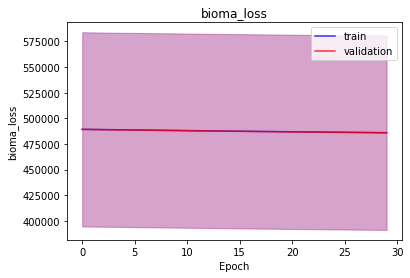

<b>domain_loss</b>: 485951.3125 (min: 391072.2500, max: 580830.3750)

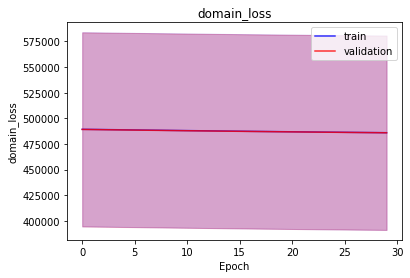

<b>latent_loss</b>: 0.1340 (min: 0.1211, max: 0.1469)

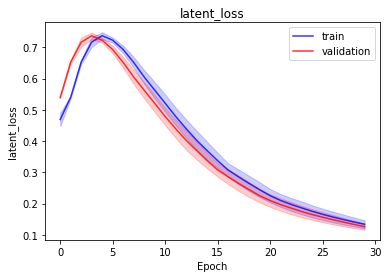

<b>bioma_mse</b>: 388.6888 (min: 379.2671, max: 398.1104)

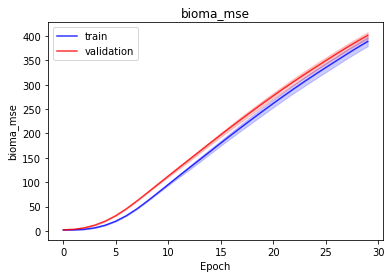

<b>bioma_mae</b>: 11.2622 (min: 10.9943, max: 11.5301)

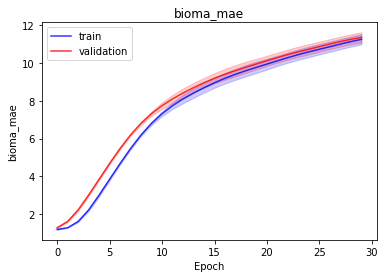

<b>bioma_mape</b>: nan (min: nan, max: nan)

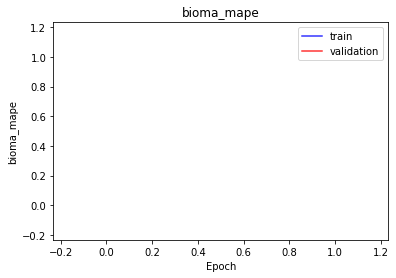

<b>domain_mse</b>: 388.6867 (min: 379.2625, max: 398.1109)

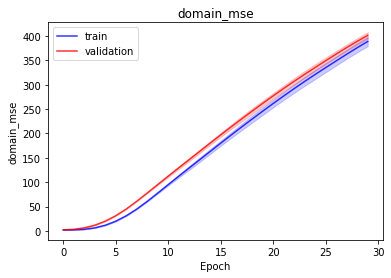

<b>domain_mae</b>: 11.2621 (min: 10.9942, max: 11.5301)

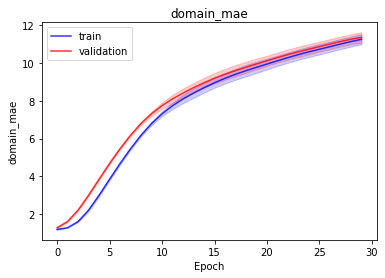

<b>domain_mape</b>: nan (min: nan, max: nan)

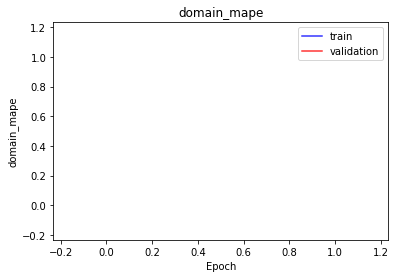

<b>latent_mae</b>: 0.1340 (min: 0.1211, max: 0.1469)

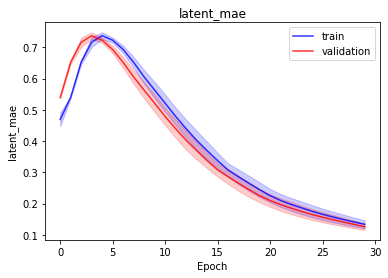

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 971815.2500 (min: 781975.0000, max: 1161655.5000)

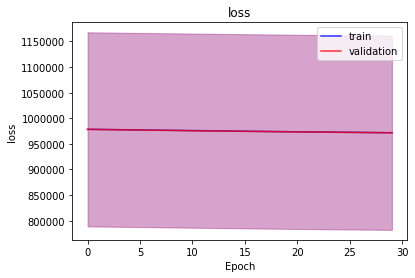

<b>bioma_loss</b>: 485907.5000 (min: 390987.3750, max: 580827.6250)

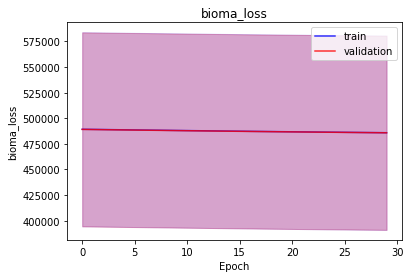

<b>domain_loss</b>: 485907.5000 (min: 390987.3750, max: 580827.6250)

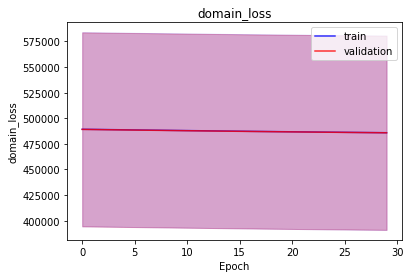

<b>latent_loss</b>: 0.2386 (min: 0.2190, max: 0.2583)

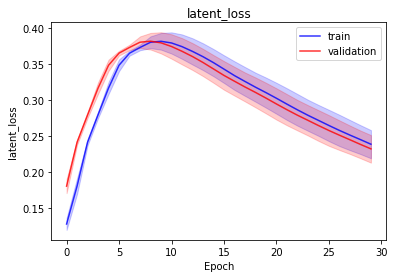

<b>bioma_mse</b>: 392.5050 (min: 385.3699, max: 399.6402)

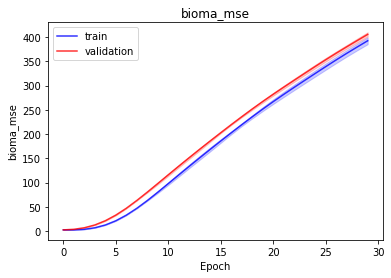

<b>bioma_mae</b>: 11.2695 (min: 11.0086, max: 11.5305)

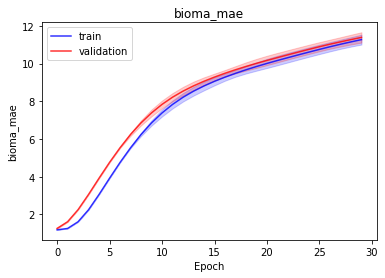

<b>bioma_mape</b>: nan (min: nan, max: nan)

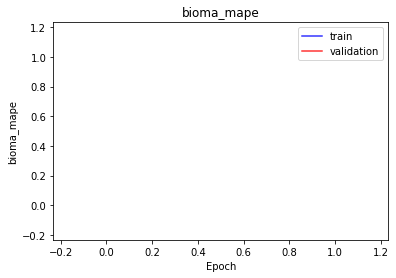

<b>domain_mse</b>: 392.4987 (min: 385.3504, max: 399.6469)

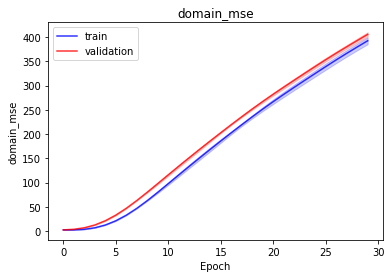

<b>domain_mae</b>: 11.2694 (min: 11.0081, max: 11.5307)

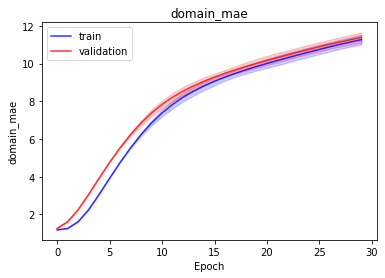

<b>domain_mape</b>: nan (min: nan, max: nan)

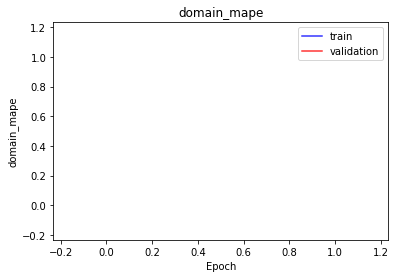

<b>latent_mae</b>: 0.2386 (min: 0.2190, max: 0.2583)

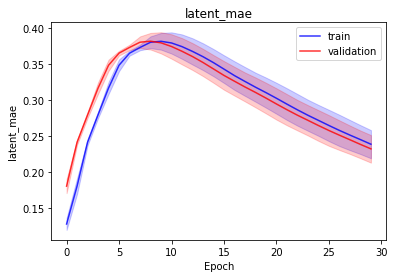

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973521.5312 (min: 783850.0625, max: 1163193.0000)

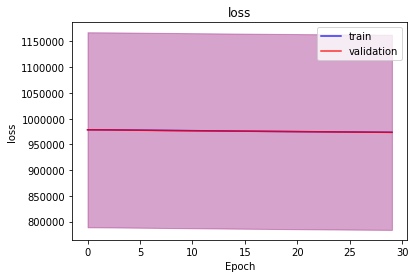

<b>bioma_loss</b>: 486758.0000 (min: 391922.3750, max: 581593.6250)

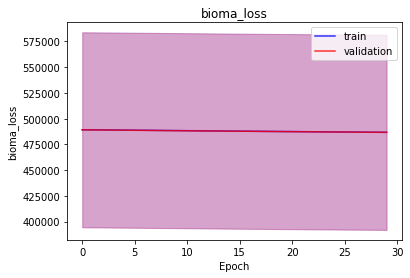

<b>domain_loss</b>: 486763.4062 (min: 391927.5625, max: 581599.2500)

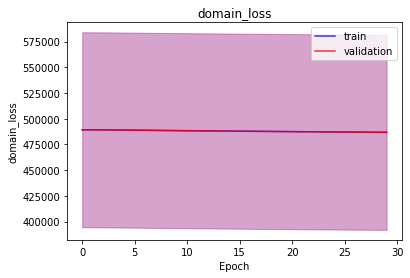

<b>latent_loss</b>: 0.1191 (min: 0.1128, max: 0.1253)

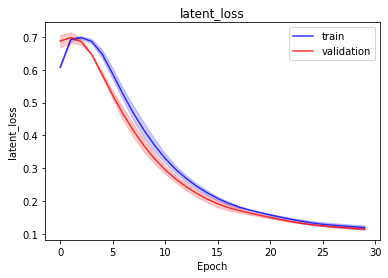

<b>bioma_mse</b>: 244.8304 (min: 235.1322, max: 254.5286)

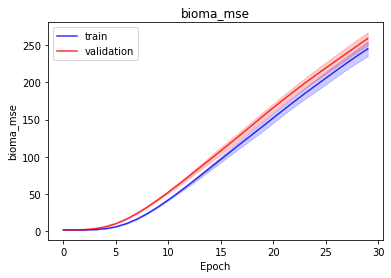

<b>bioma_mae</b>: 9.6680 (min: 9.3923, max: 9.9437)

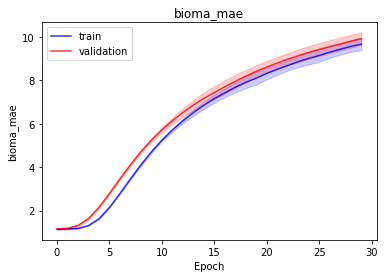

<b>bioma_mape</b>: nan (min: nan, max: nan)

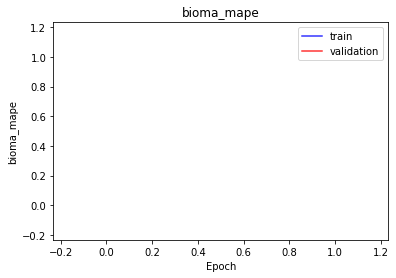

<b>domain_mse</b>: 250.2163 (min: 240.3355, max: 260.0971)

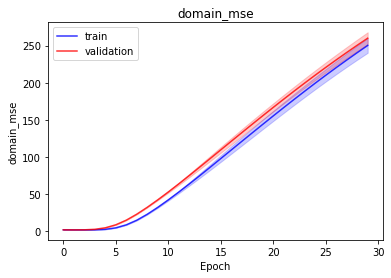

<b>domain_mae</b>: 9.8319 (min: 9.5513, max: 10.1126)

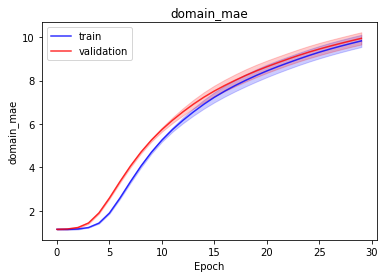

<b>domain_mape</b>: nan (min: nan, max: nan)

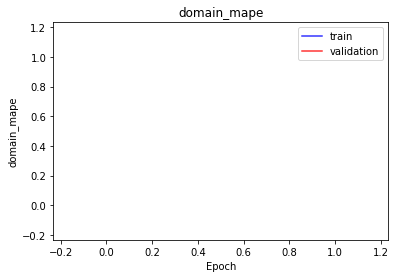

<b>latent_mae</b>: 0.1191 (min: 0.1128, max: 0.1253)

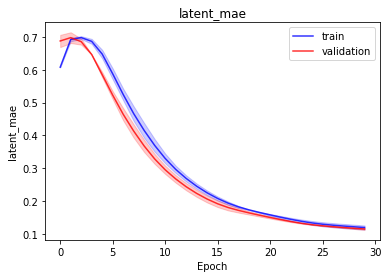

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973579.7812 (min: 783958.9375, max: 1163200.6250)

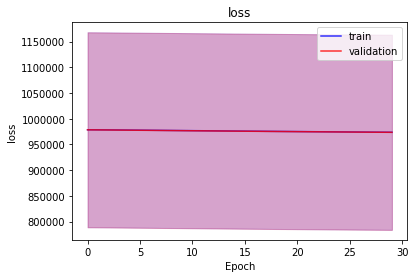

<b>bioma_loss</b>: 486789.7812 (min: 391979.3750, max: 581600.1875)

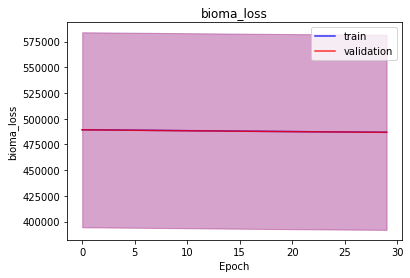

<b>domain_loss</b>: 486789.7812 (min: 391979.3750, max: 581600.1875)

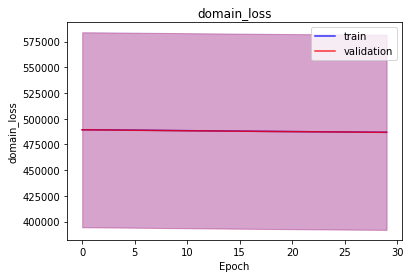

<b>latent_loss</b>: 0.2070 (min: 0.2041, max: 0.2098)

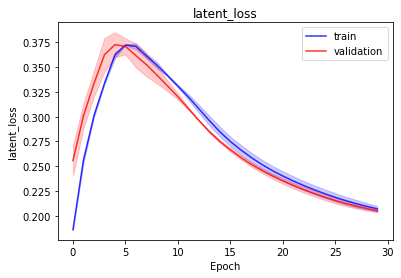

<b>bioma_mse</b>: 243.4318 (min: 232.2831, max: 254.5804)

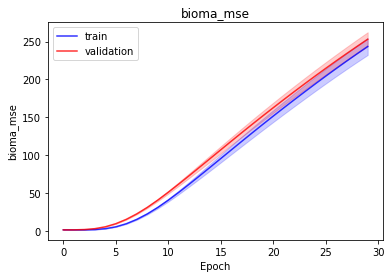

<b>bioma_mae</b>: 9.7067 (min: 9.3980, max: 10.0155)

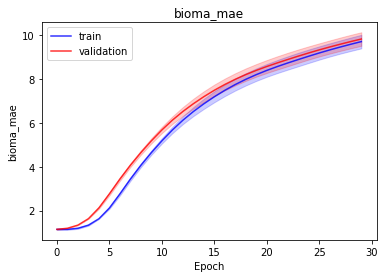

<b>bioma_mape</b>: nan (min: nan, max: nan)

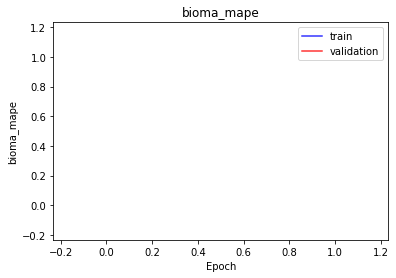

<b>domain_mse</b>: 243.4287 (min: 232.2796, max: 254.5779)

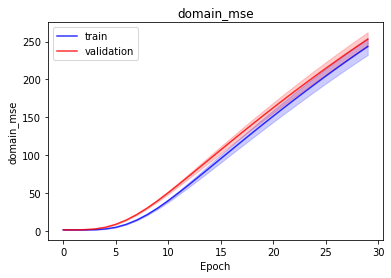

<b>domain_mae</b>: 9.7067 (min: 9.3980, max: 10.0154)

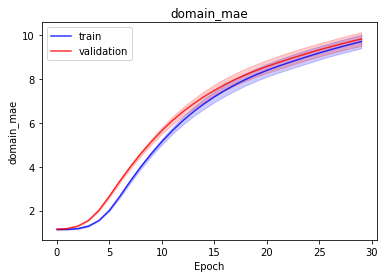

<b>domain_mape</b>: nan (min: nan, max: nan)

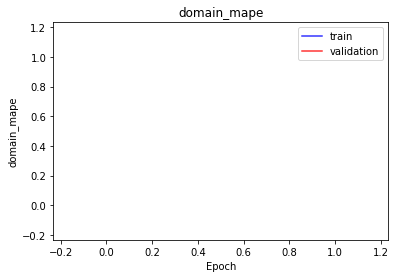

<b>latent_mae</b>: 0.2070 (min: 0.2041, max: 0.2098)

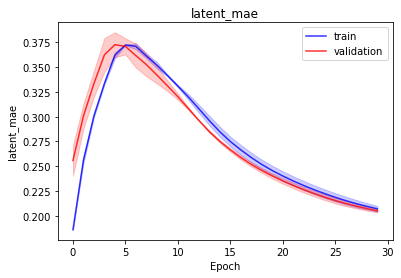

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 943899.2500 (min: 749515.3750, max: 1138283.1250)

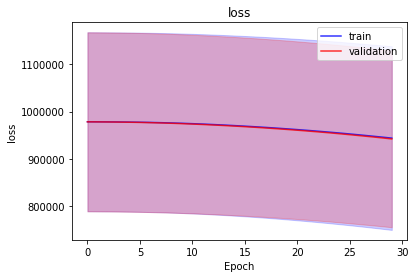

<b>bioma_loss</b>: 471575.3750 (min: 374668.1562, max: 568482.5625)

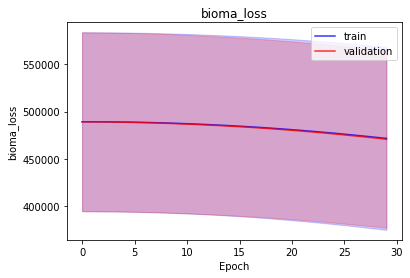

<b>domain_loss</b>: 472323.4688 (min: 374847.0000, max: 569799.9375)

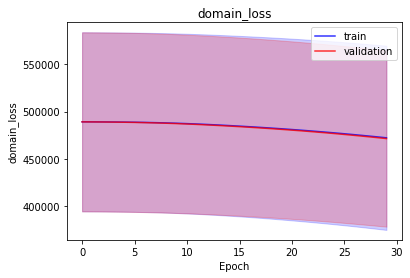

<b>latent_loss</b>: 0.4515 (min: 0.2199, max: 0.6832)

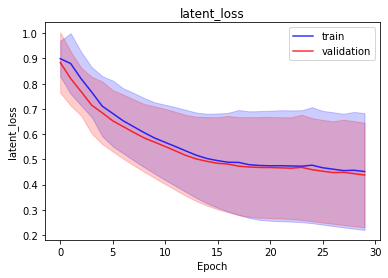

<b>bioma_mse</b>: 2804.1343 (min: 2491.3240, max: 3116.9446)

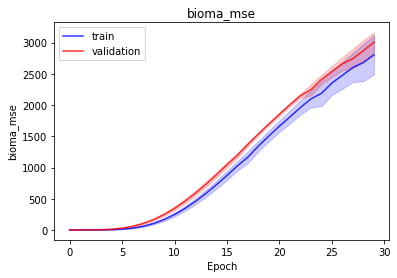

<b>bioma_mae</b>: 17.0789 (min: 17.0473, max: 17.1106)

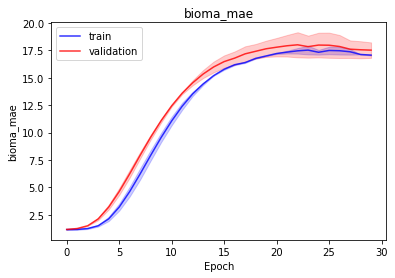

<b>bioma_mape</b>: nan (min: nan, max: nan)

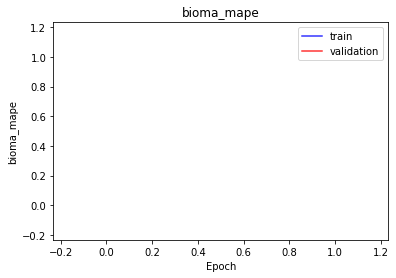

<b>domain_mse</b>: 2731.3489 (min: 2322.1060, max: 3140.5918)

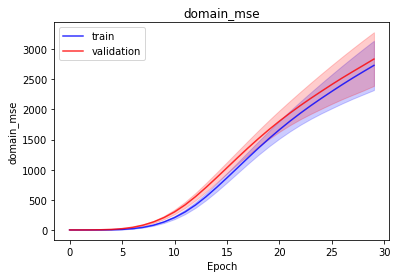

<b>domain_mae</b>: 17.4235 (min: 17.3120, max: 17.5350)

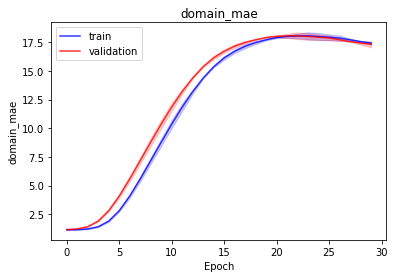

<b>domain_mape</b>: nan (min: nan, max: nan)

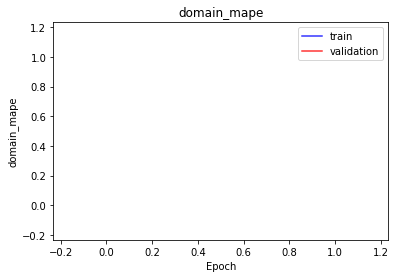

<b>latent_mae</b>: 0.4515 (min: 0.2199, max: 0.6832)

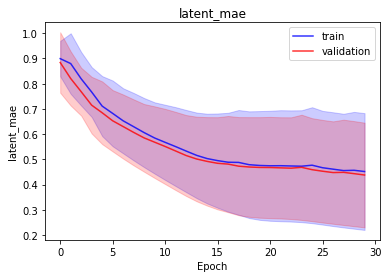

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 947049.7188 (min: 755041.9375, max: 1139057.5000)

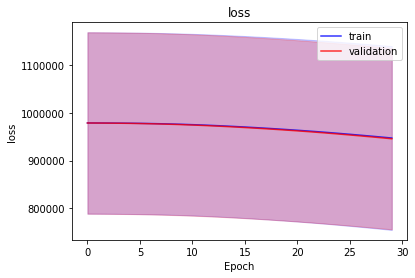

<b>bioma_loss</b>: 474861.5000 (min: 379123.8438, max: 570599.1250)

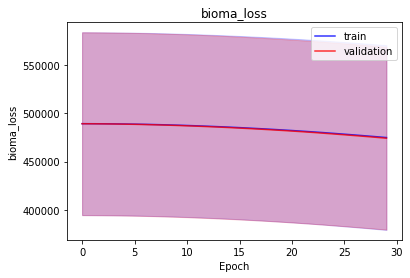

<b>domain_loss</b>: 472187.9375 (min: 375917.8438, max: 568458.0625)

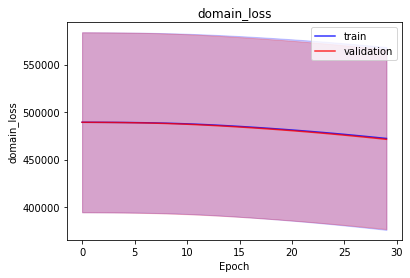

<b>latent_loss</b>: 0.2402 (min: 0.2269, max: 0.2536)

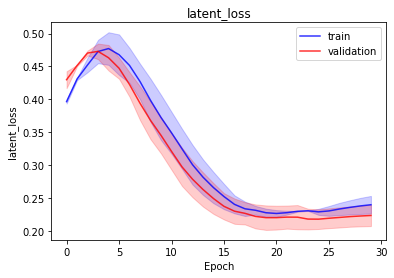

<b>bioma_mse</b>: 1932.9579 (min: 1744.7322, max: 2121.1836)

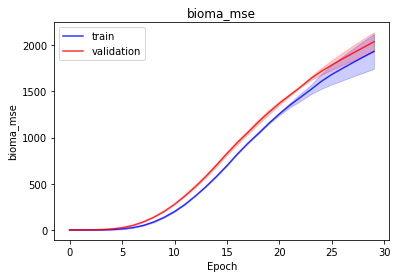

<b>bioma_mae</b>: 14.7873 (min: 14.6606, max: 14.9139)

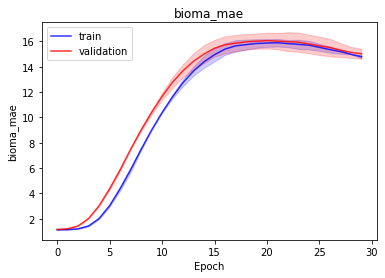

<b>bioma_mape</b>: nan (min: nan, max: nan)

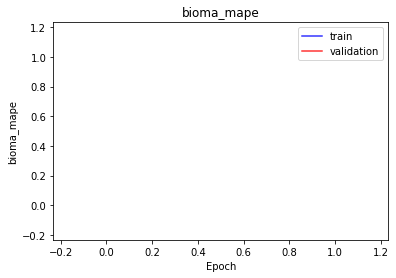

<b>domain_mse</b>: 3138.0803 (min: 2838.4890, max: 3437.6716)

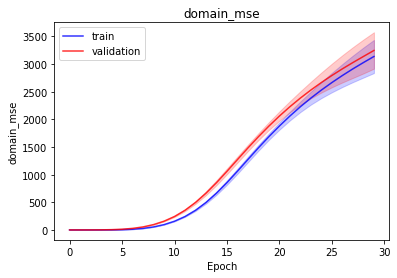

<b>domain_mae</b>: 19.0077 (min: 18.9616, max: 19.0539)

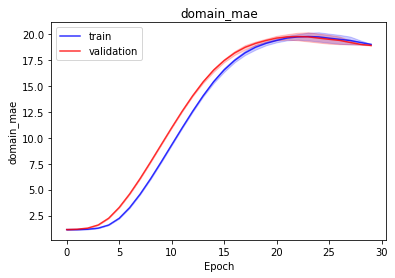

<b>domain_mape</b>: nan (min: nan, max: nan)

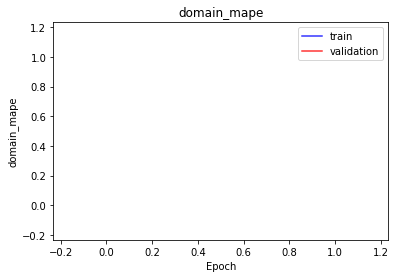

<b>latent_mae</b>: 0.2402 (min: 0.2269, max: 0.2536)

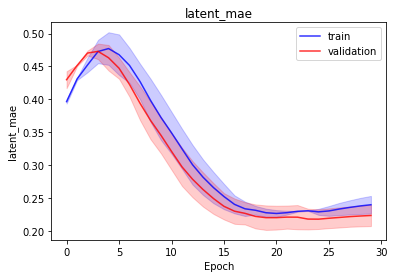

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 973950.5312 (min: 784258.1875, max: 1163642.8750)

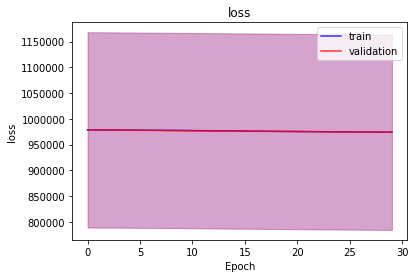

<b>bioma_loss</b>: 486974.8750 (min: 392128.9062, max: 581820.8750)

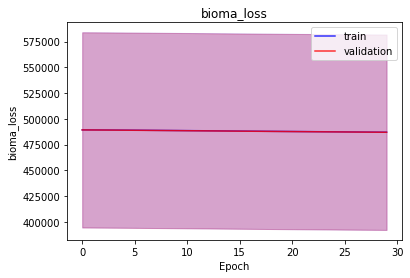

<b>domain_loss</b>: 486975.5000 (min: 392129.1562, max: 581821.8125)

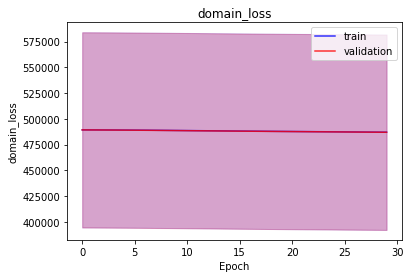

<b>latent_loss</b>: 0.1040 (min: 0.0721, max: 0.1360)

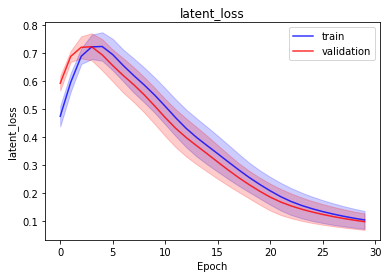

<b>bioma_mse</b>: 250.2423 (min: 244.7403, max: 255.7444)

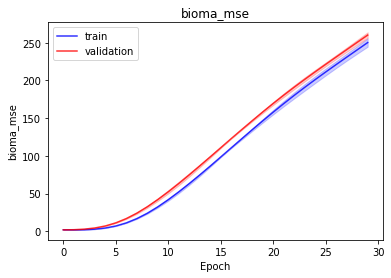

<b>bioma_mae</b>: 9.7791 (min: 9.5397, max: 10.0185)

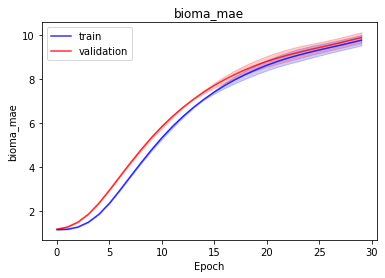

<b>bioma_mape</b>: nan (min: nan, max: nan)

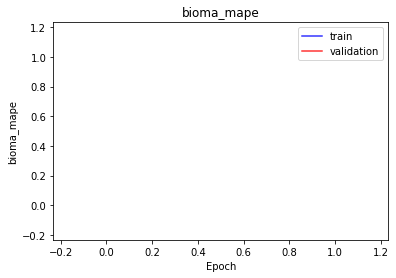

<b>domain_mse</b>: 250.0253 (min: 244.7320, max: 255.3186)

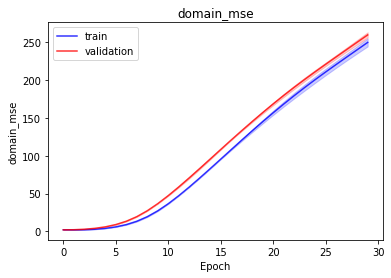

<b>domain_mae</b>: 9.7734 (min: 9.5399, max: 10.0070)

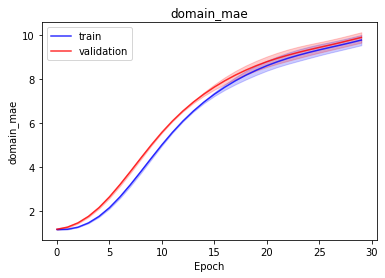

<b>domain_mape</b>: nan (min: nan, max: nan)

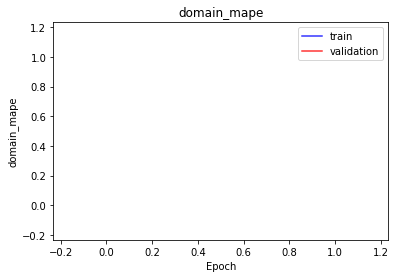

<b>latent_mae</b>: 0.1040 (min: 0.0721, max: 0.1360)

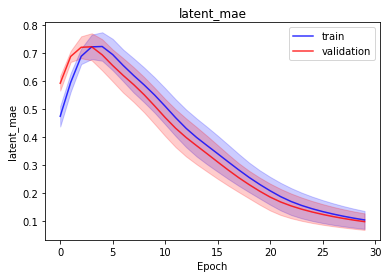

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 974150.7188 (min: 784556.0625, max: 1163745.3750)

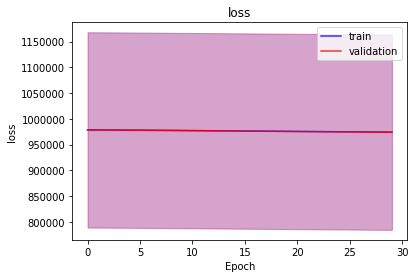

<b>bioma_loss</b>: 487074.8750 (min: 392277.6875, max: 581872.0625)

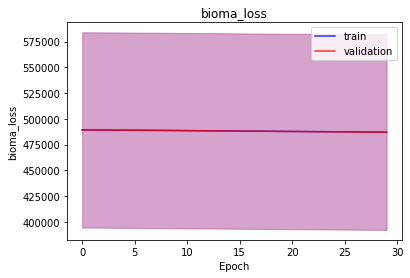

<b>domain_loss</b>: 487075.6875 (min: 392278.1562, max: 581873.2500)

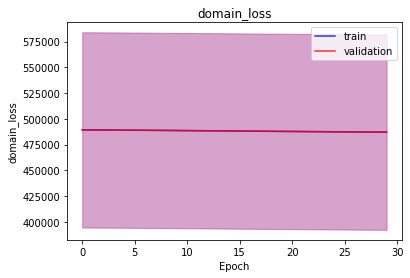

<b>latent_loss</b>: 0.1896 (min: 0.1857, max: 0.1935)

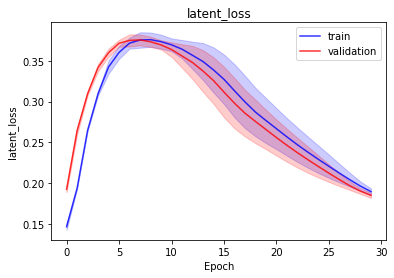

<b>bioma_mse</b>: 235.6720 (min: 224.6818, max: 246.6623)

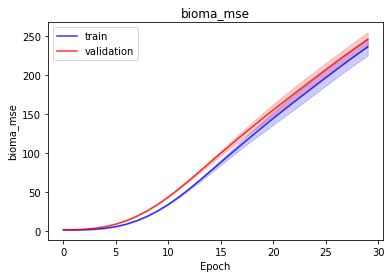

<b>bioma_mae</b>: 9.6395 (min: 9.3427, max: 9.9363)

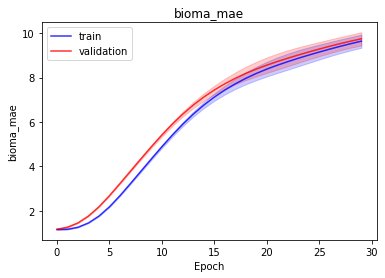

<b>bioma_mape</b>: nan (min: nan, max: nan)

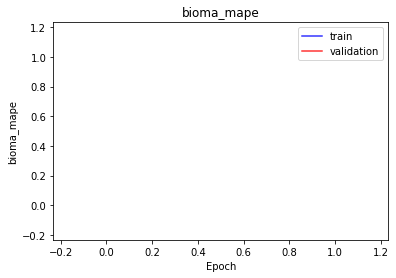

<b>domain_mse</b>: 235.4723 (min: 224.6731, max: 246.2715)

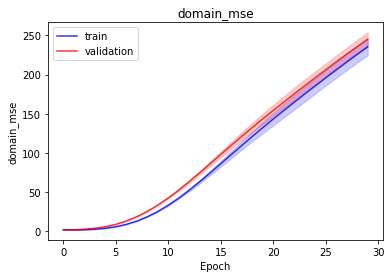

<b>domain_mae</b>: 9.6354 (min: 9.3439, max: 9.9269)

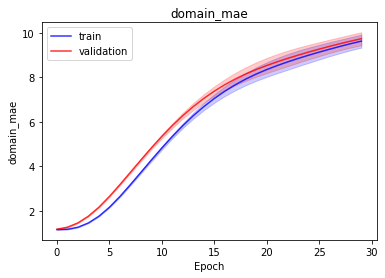

<b>domain_mape</b>: nan (min: nan, max: nan)

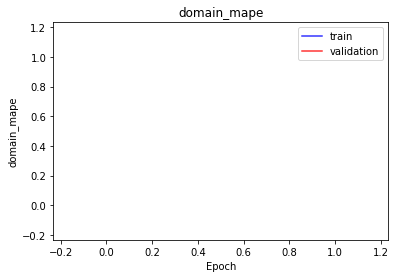

<b>latent_mae</b>: 0.1896 (min: 0.1857, max: 0.1935)

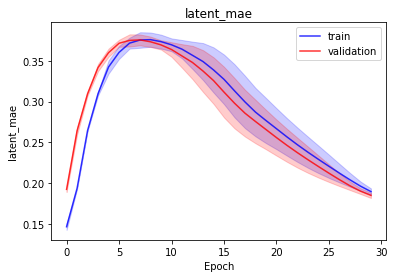

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976854.1562 (min: 787366.0625, max: 1166342.2500)

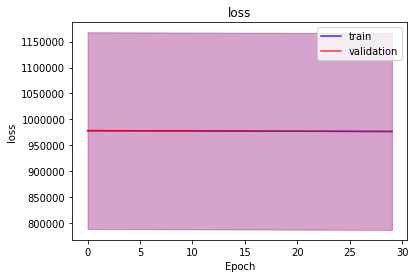

<b>bioma_loss</b>: 488435.5625 (min: 393688.5625, max: 583182.5625)

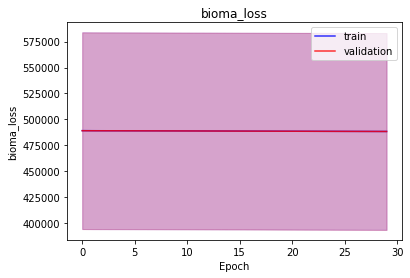

<b>domain_loss</b>: 488418.1250 (min: 393677.0000, max: 583159.2500)

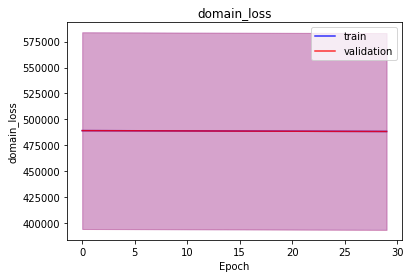

<b>latent_loss</b>: 0.4737 (min: 0.4408, max: 0.5065)

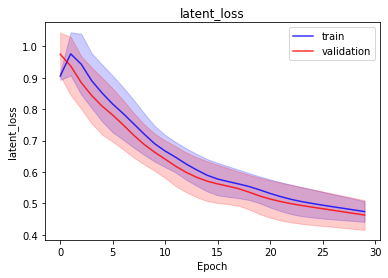

<b>bioma_mse</b>: 39.9993 (min: 37.7880, max: 42.2106)

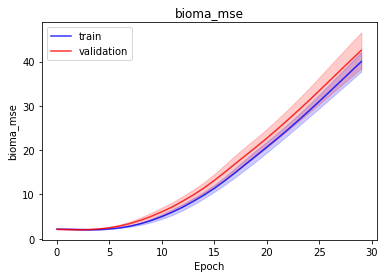

<b>bioma_mae</b>: 5.0216 (min: 4.8935, max: 5.1496)

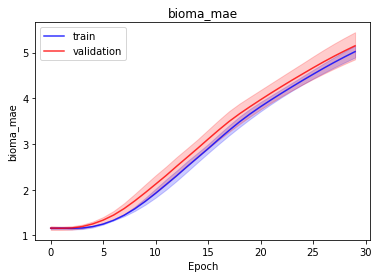

<b>bioma_mape</b>: nan (min: nan, max: nan)

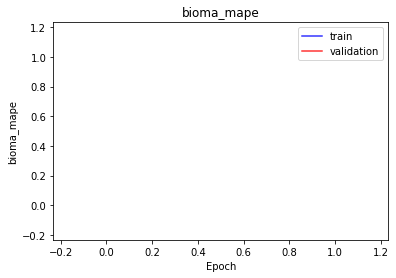

<b>domain_mse</b>: 42.7280 (min: 38.3893, max: 47.0668)

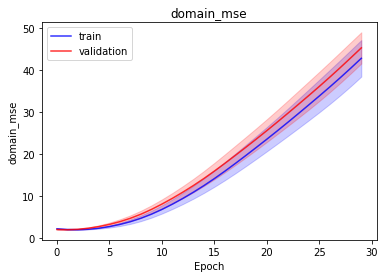

<b>domain_mae</b>: 5.2024 (min: 4.9611, max: 5.4438)

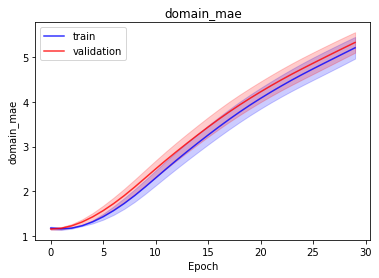

<b>domain_mape</b>: nan (min: nan, max: nan)

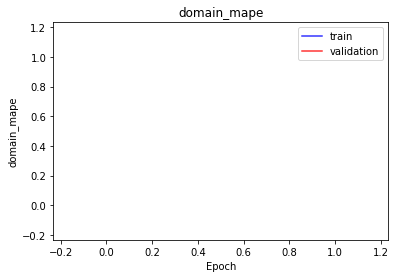

<b>latent_mae</b>: 0.4737 (min: 0.4408, max: 0.5065)

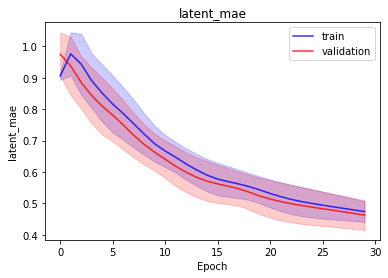

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976928.4062 (min: 787460.9375, max: 1166395.8750)

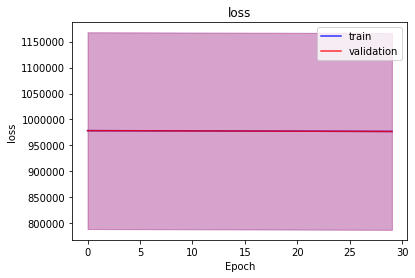

<b>bioma_loss</b>: 488532.3125 (min: 393804.4062, max: 583260.1875)

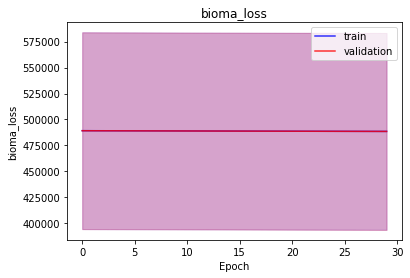

<b>domain_loss</b>: 488395.7500 (min: 393656.1562, max: 583135.3750)

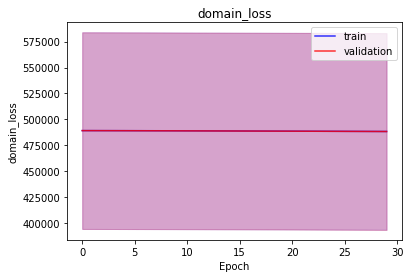

<b>latent_loss</b>: 0.3465 (min: 0.3298, max: 0.3632)

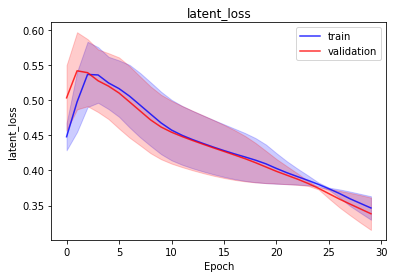

<b>bioma_mse</b>: 34.7335 (min: 29.1056, max: 40.3615)

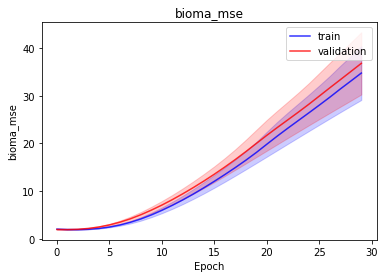

<b>bioma_mae</b>: 4.7406 (min: 4.3941, max: 5.0871)

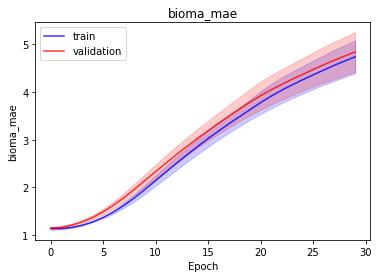

<b>bioma_mape</b>: nan (min: nan, max: nan)

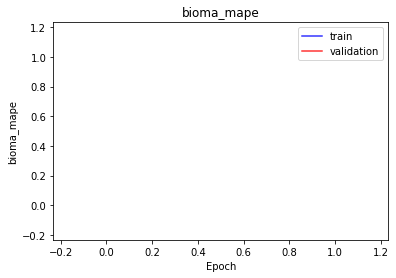

<b>domain_mse</b>: 58.9003 (min: 51.0908, max: 66.7098)

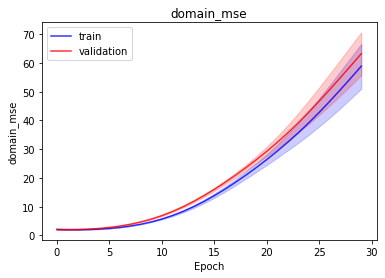

<b>domain_mae</b>: 6.0292 (min: 5.6570, max: 6.4014)

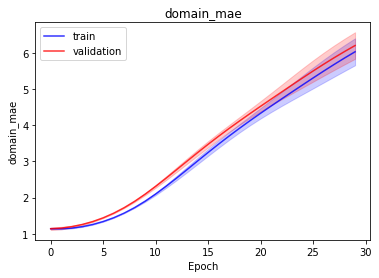

<b>domain_mape</b>: nan (min: nan, max: nan)

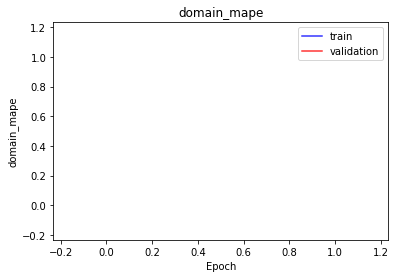

<b>latent_mae</b>: 0.3465 (min: 0.3298, max: 0.3632)

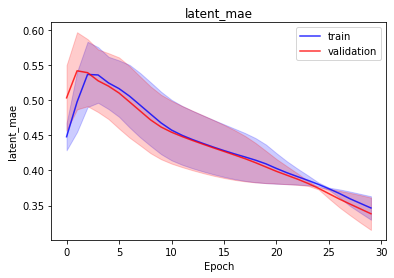

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976825.1875 (min: 787326.0000, max: 1166324.3750)

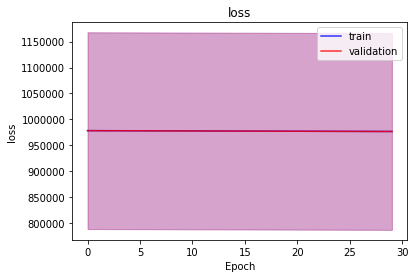

<b>bioma_loss</b>: 488417.8750 (min: 393673.0312, max: 583162.7500)

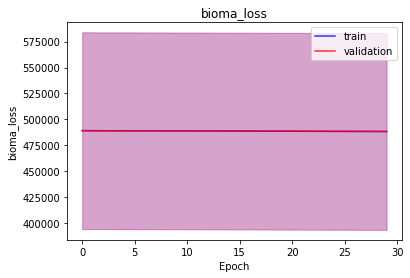

<b>domain_loss</b>: 488406.9375 (min: 393652.5312, max: 583161.3125)

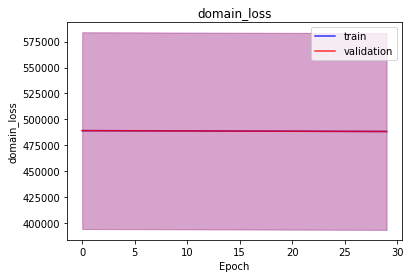

<b>latent_loss</b>: 0.4335 (min: 0.4036, max: 0.4635)

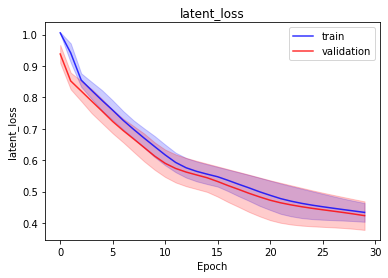

<b>bioma_mse</b>: 44.6285 (min: 41.2331, max: 48.0238)

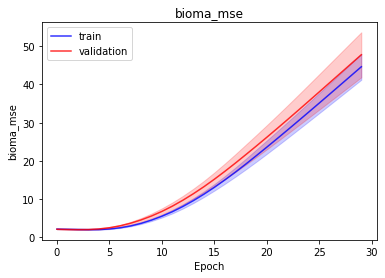

<b>bioma_mae</b>: 5.2469 (min: 5.0692, max: 5.4245)

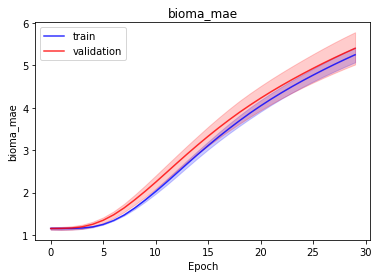

<b>bioma_mape</b>: nan (min: nan, max: nan)

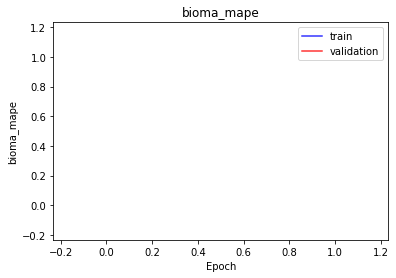

<b>domain_mse</b>: 44.5893 (min: 41.7963, max: 47.3823)

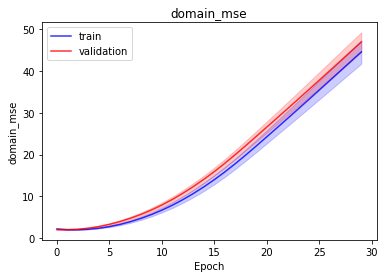

<b>domain_mae</b>: 5.3005 (min: 5.1380, max: 5.4631)

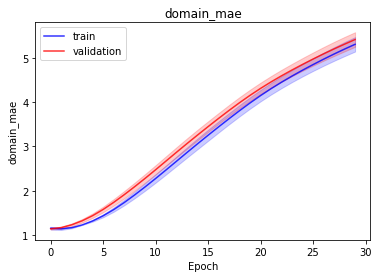

<b>domain_mape</b>: nan (min: nan, max: nan)

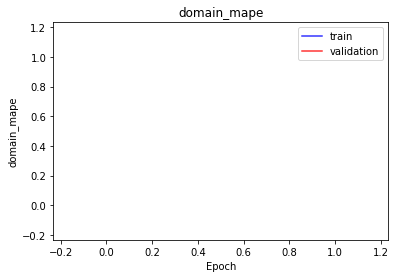

<b>latent_mae</b>: 0.4335 (min: 0.4036, max: 0.4635)

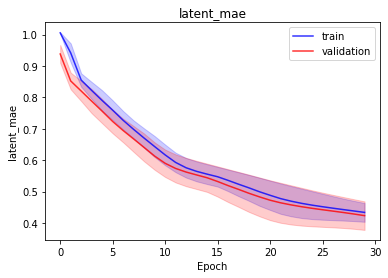

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976920.8125 (min: 787512.2500, max: 1166329.3750)

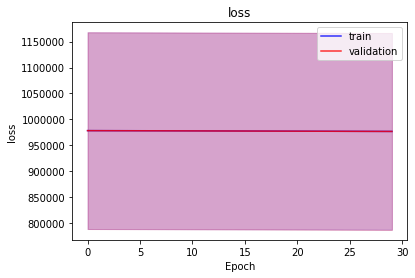

<b>bioma_loss</b>: 488513.1250 (min: 393830.0938, max: 583196.1875)

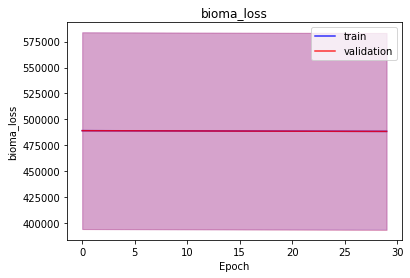

<b>domain_loss</b>: 488407.3750 (min: 393681.8125, max: 583132.9375)

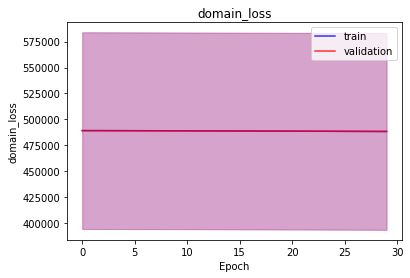

<b>latent_loss</b>: 0.3083 (min: 0.2550, max: 0.3617)

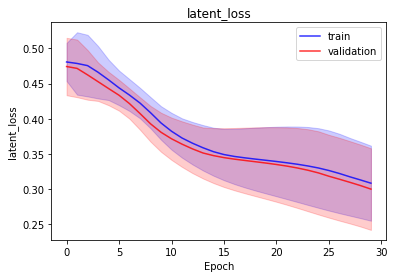

<b>bioma_mse</b>: 36.7741 (min: 28.3134, max: 45.2348)

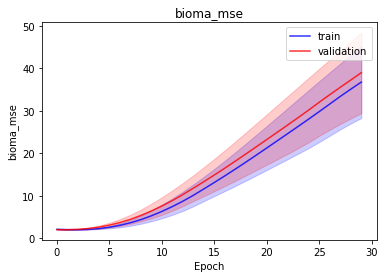

<b>bioma_mae</b>: 4.8502 (min: 4.3457, max: 5.3547)

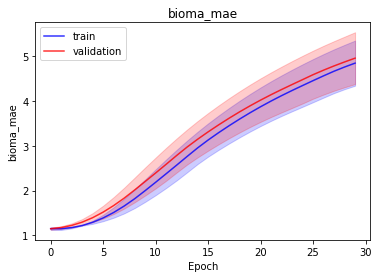

<b>bioma_mape</b>: nan (min: nan, max: nan)

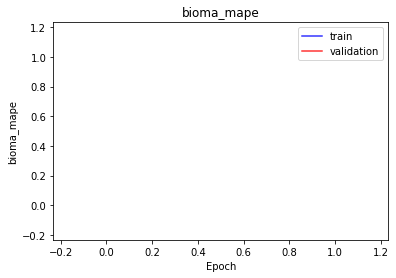

<b>domain_mse</b>: 55.1401 (min: 50.3539, max: 59.9263)

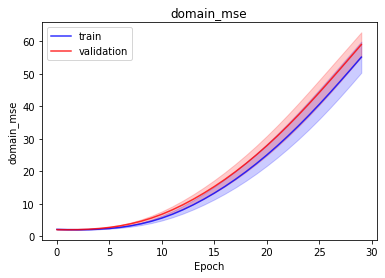

<b>domain_mae</b>: 5.8696 (min: 5.6507, max: 6.0885)

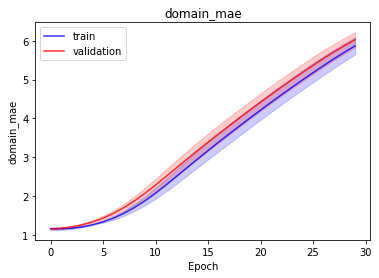

<b>domain_mape</b>: nan (min: nan, max: nan)

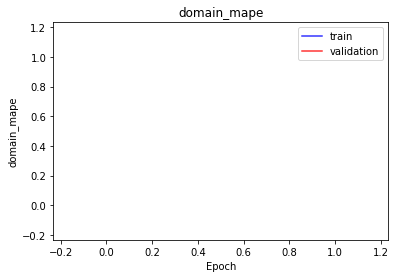

<b>latent_mae</b>: 0.3083 (min: 0.2550, max: 0.3617)

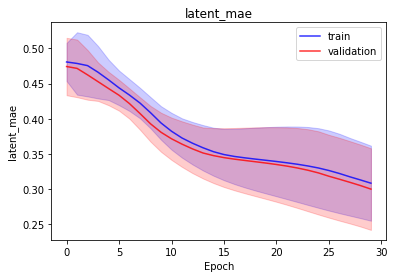

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976858.3125 (min: 787345.6250, max: 1166371.0000)

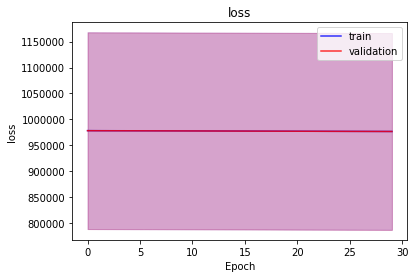

<b>bioma_loss</b>: 488438.2188 (min: 393684.8125, max: 583191.6250)

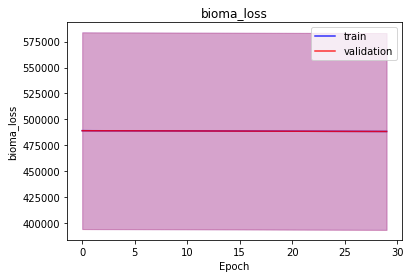

<b>domain_loss</b>: 488419.6250 (min: 393660.3125, max: 583178.9375)

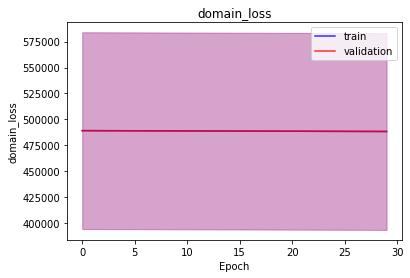

<b>latent_loss</b>: 0.4681 (min: 0.4419, max: 0.4943)

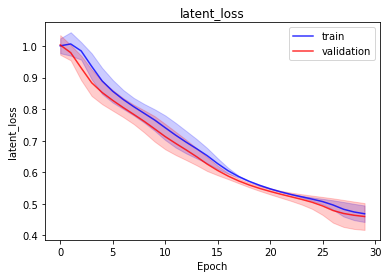

<b>bioma_mse</b>: 40.6478 (min: 38.5059, max: 42.7897)

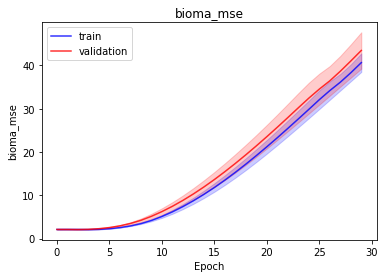

<b>bioma_mae</b>: 5.0390 (min: 4.9258, max: 5.1523)

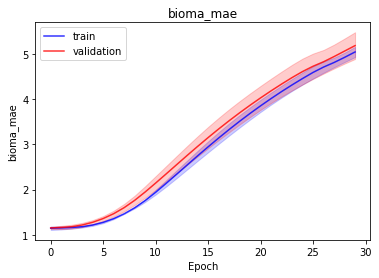

<b>bioma_mape</b>: nan (min: nan, max: nan)

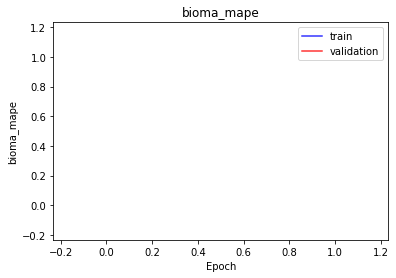

<b>domain_mse</b>: 43.3026 (min: 39.9001, max: 46.7050)

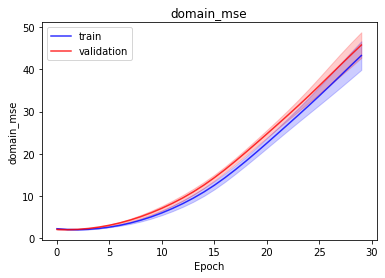

<b>domain_mae</b>: 5.2402 (min: 5.0305, max: 5.4498)

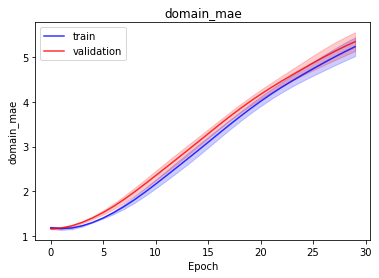

<b>domain_mape</b>: nan (min: nan, max: nan)

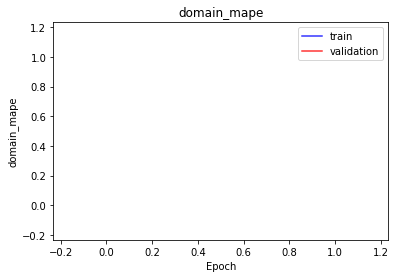

<b>latent_mae</b>: 0.4681 (min: 0.4419, max: 0.4943)

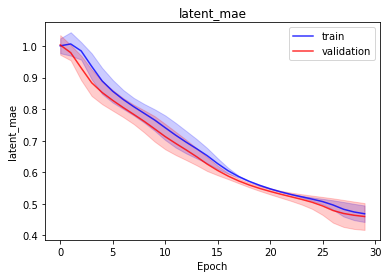

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | CenterLogRatio |
| Output transform | none |
| Reconstruction Loss | MeanSquaredError |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: 976819.5938 (min: 787162.6875, max: 1166476.5000)

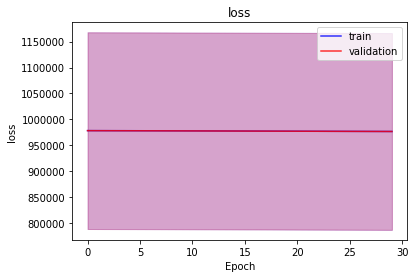

<b>bioma_loss</b>: 488488.5625 (min: 393660.7188, max: 583316.4375)

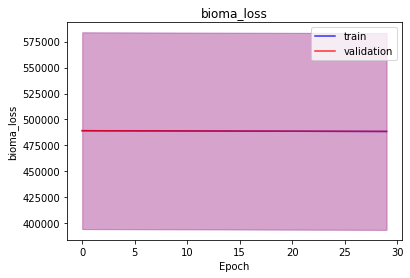

<b>domain_loss</b>: 488330.7188 (min: 393501.6875, max: 583159.7500)

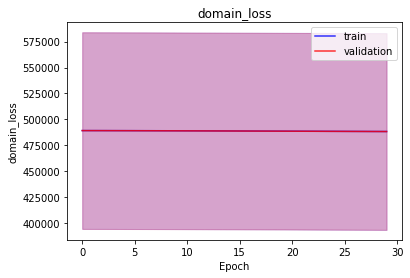

<b>latent_loss</b>: 0.2989 (min: 0.2962, max: 0.3017)

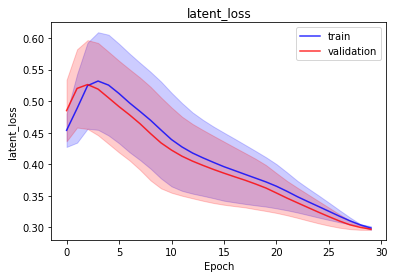

<b>bioma_mse</b>: 36.4682 (min: 32.7847, max: 40.1517)

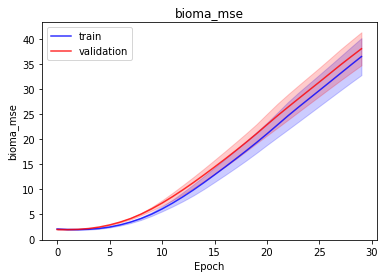

<b>bioma_mae</b>: 4.8255 (min: 4.6543, max: 4.9967)

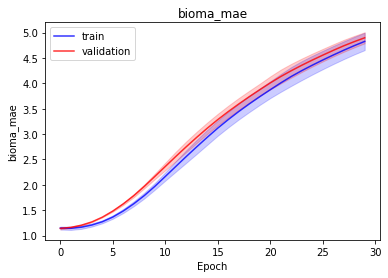

<b>bioma_mape</b>: nan (min: nan, max: nan)

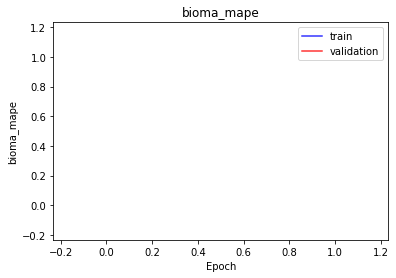

<b>domain_mse</b>: 63.1867 (min: 60.0724, max: 66.3010)

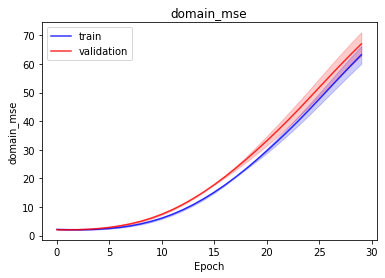

<b>domain_mae</b>: 6.1980 (min: 6.1218, max: 6.2743)

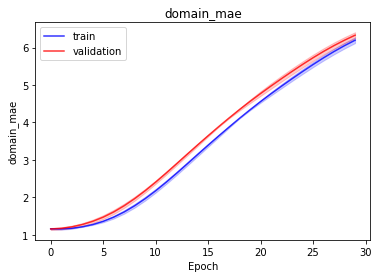

<b>domain_mape</b>: nan (min: nan, max: nan)

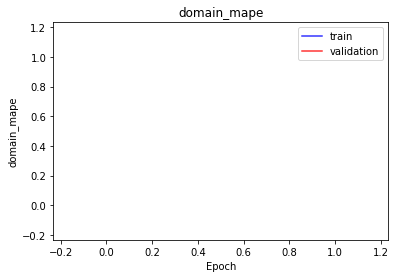

<b>latent_mae</b>: 0.2989 (min: 0.2962, max: 0.3017)

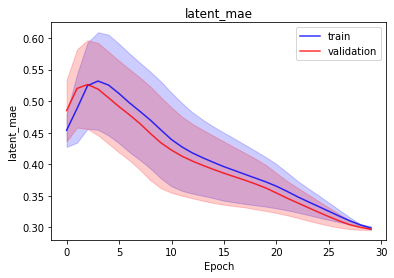

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

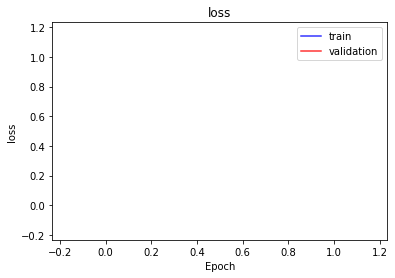

<b>bioma_loss</b>: nan (min: nan, max: nan)

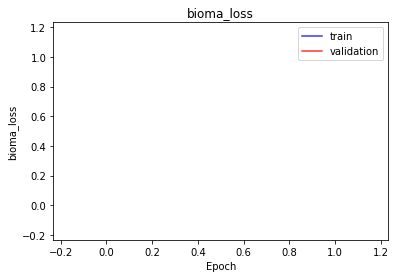

<b>domain_loss</b>: nan (min: nan, max: nan)

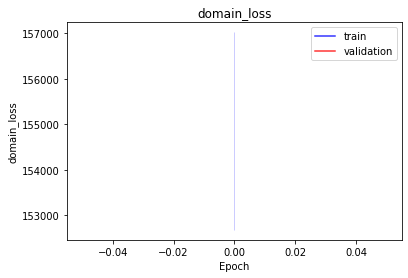

<b>latent_loss</b>: nan (min: nan, max: nan)

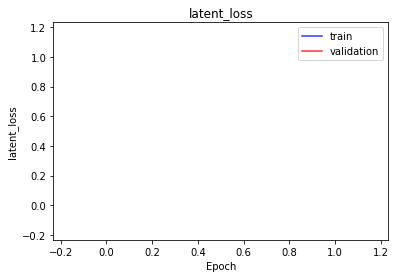

<b>bioma_mse</b>: nan (min: nan, max: nan)

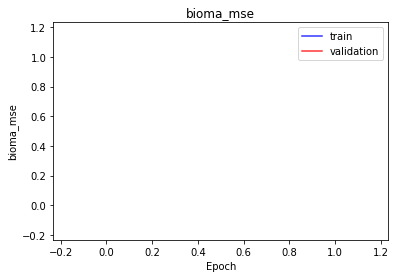

<b>bioma_mae</b>: nan (min: nan, max: nan)

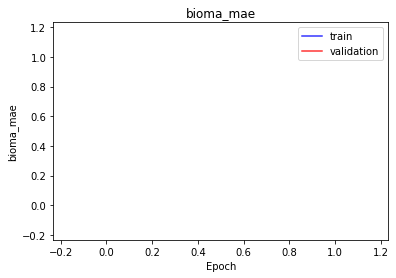

<b>bioma_mape</b>: nan (min: nan, max: nan)

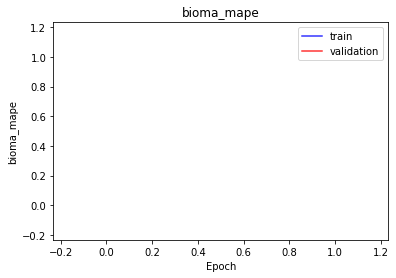

<b>domain_mse</b>: nan (min: nan, max: nan)

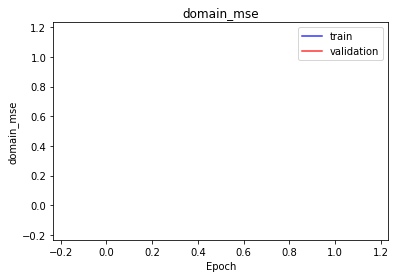

<b>domain_mae</b>: nan (min: nan, max: nan)

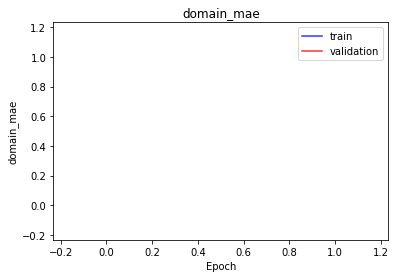

<b>domain_mape</b>: nan (min: nan, max: nan)

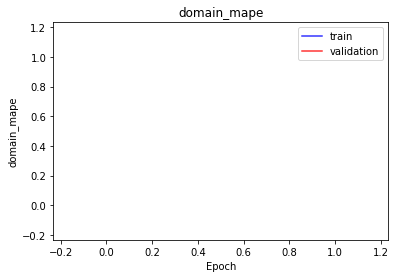

<b>latent_mae</b>: nan (min: nan, max: nan)

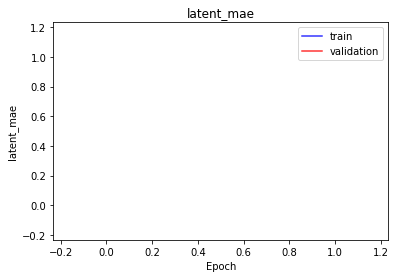

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

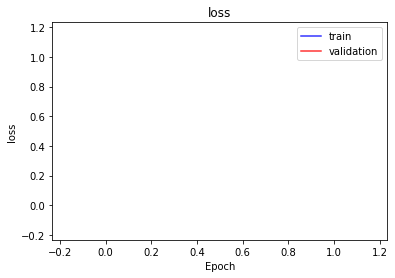

<b>bioma_loss</b>: nan (min: nan, max: nan)

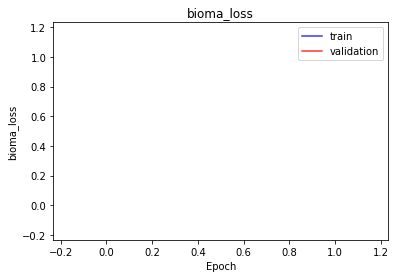

<b>domain_loss</b>: nan (min: nan, max: nan)

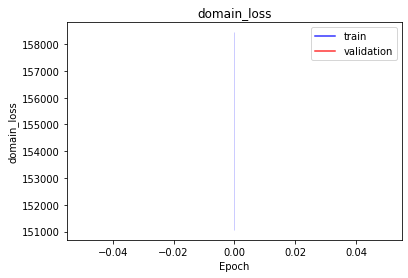

<b>latent_loss</b>: nan (min: nan, max: nan)

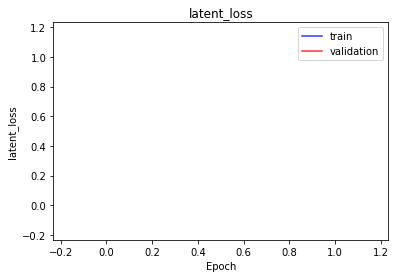

<b>bioma_mse</b>: nan (min: nan, max: nan)

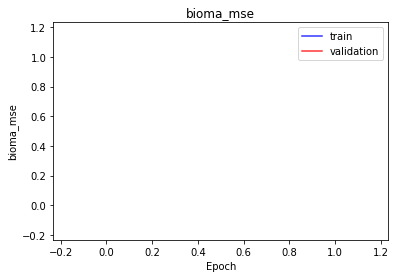

<b>bioma_mae</b>: nan (min: nan, max: nan)

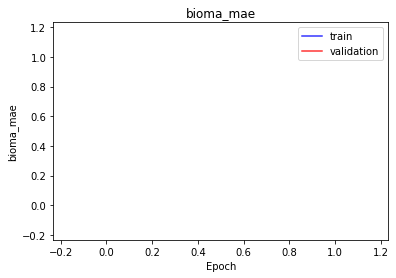

<b>bioma_mape</b>: nan (min: nan, max: nan)

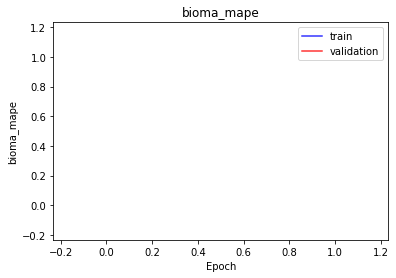

<b>domain_mse</b>: nan (min: nan, max: nan)

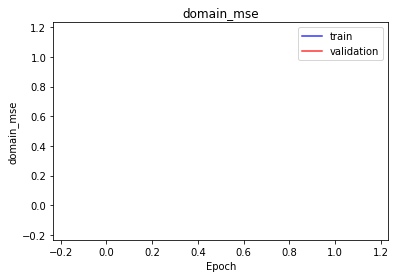

<b>domain_mae</b>: nan (min: nan, max: nan)

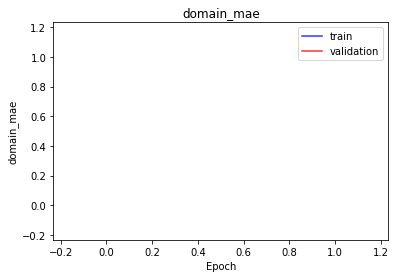

<b>domain_mape</b>: nan (min: nan, max: nan)

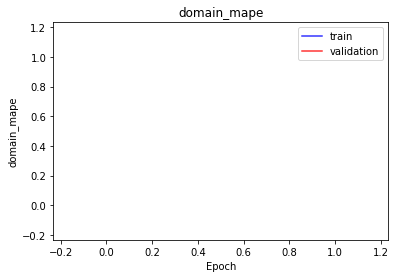

<b>latent_mae</b>: nan (min: nan, max: nan)

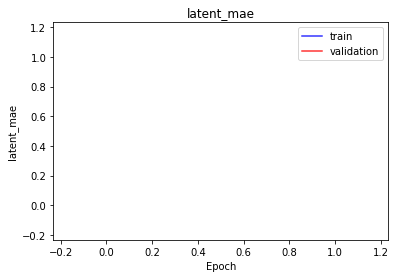

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

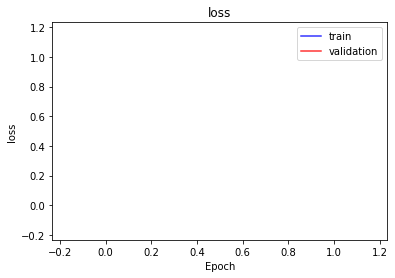

<b>bioma_loss</b>: nan (min: nan, max: nan)

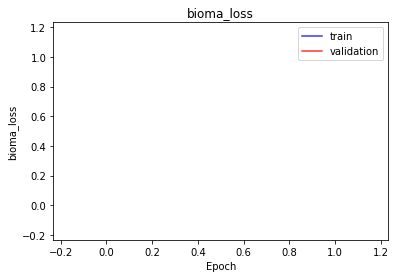

<b>domain_loss</b>: nan (min: nan, max: nan)

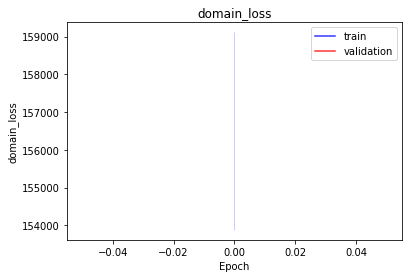

<b>latent_loss</b>: nan (min: nan, max: nan)

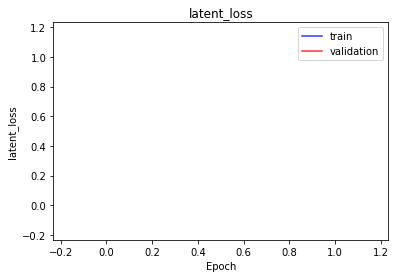

<b>bioma_mse</b>: nan (min: nan, max: nan)

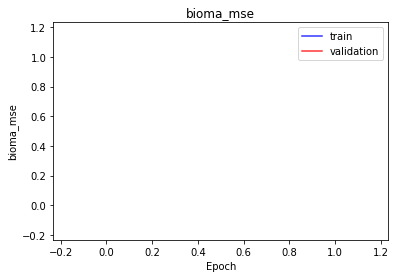

<b>bioma_mae</b>: nan (min: nan, max: nan)

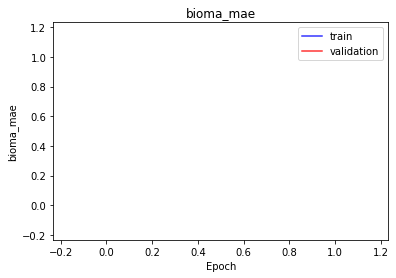

<b>bioma_mape</b>: nan (min: nan, max: nan)

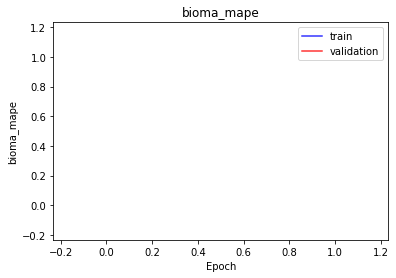

<b>domain_mse</b>: nan (min: nan, max: nan)

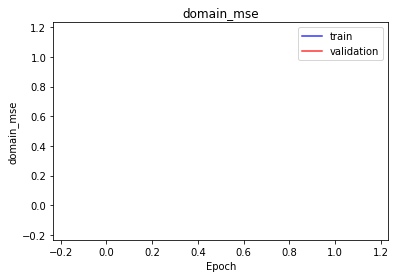

<b>domain_mae</b>: nan (min: nan, max: nan)

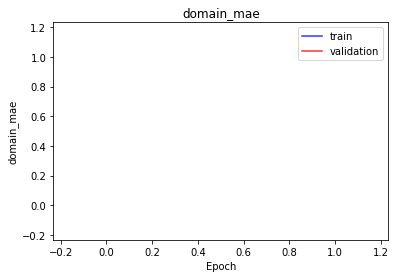

<b>domain_mape</b>: nan (min: nan, max: nan)

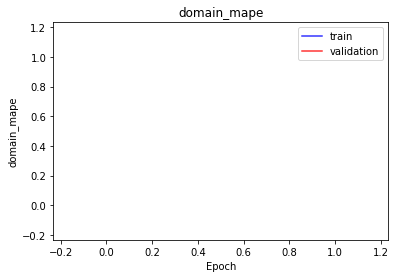

<b>latent_mae</b>: nan (min: nan, max: nan)

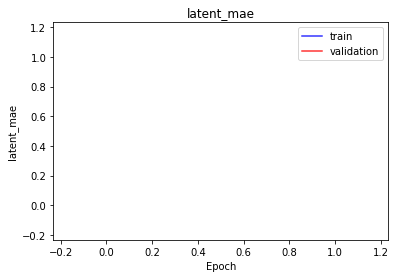

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

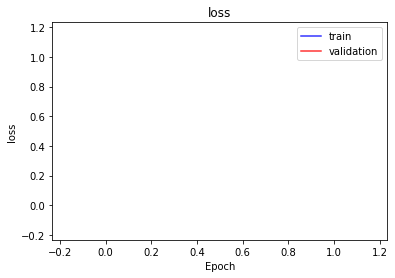

<b>bioma_loss</b>: nan (min: nan, max: nan)

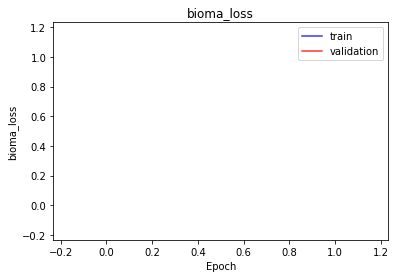

<b>domain_loss</b>: nan (min: nan, max: nan)

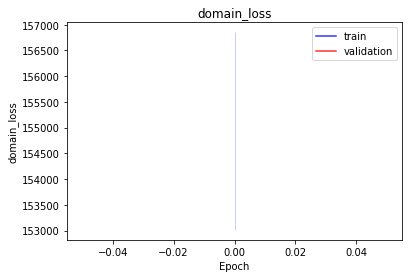

<b>latent_loss</b>: nan (min: nan, max: nan)

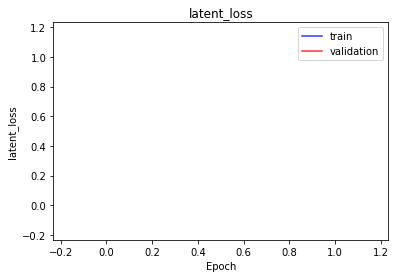

<b>bioma_mse</b>: nan (min: nan, max: nan)

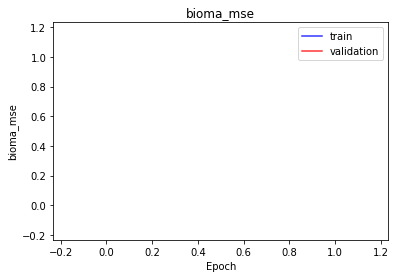

<b>bioma_mae</b>: nan (min: nan, max: nan)

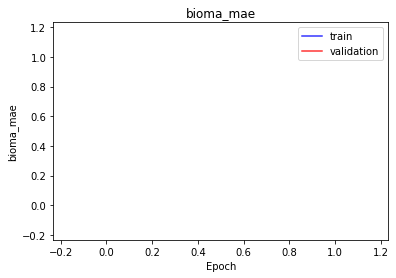

<b>bioma_mape</b>: nan (min: nan, max: nan)

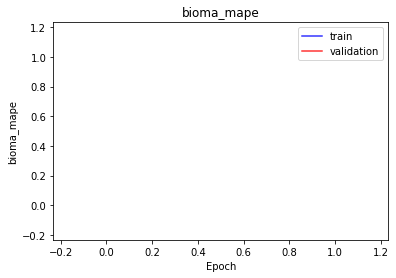

<b>domain_mse</b>: nan (min: nan, max: nan)

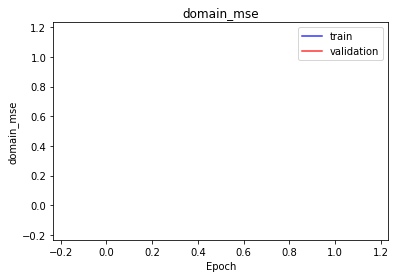

<b>domain_mae</b>: nan (min: nan, max: nan)

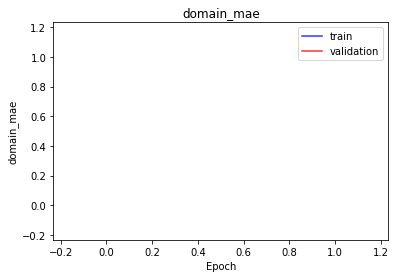

<b>domain_mape</b>: nan (min: nan, max: nan)

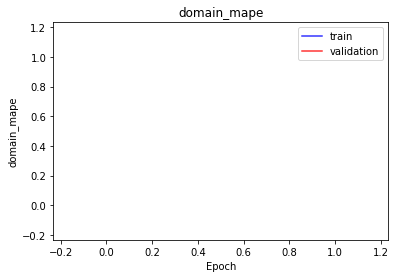

<b>latent_mae</b>: nan (min: nan, max: nan)

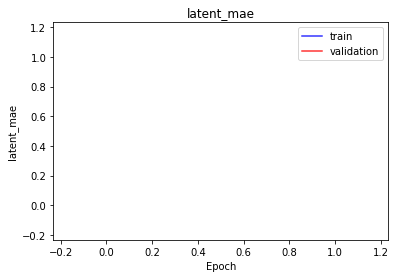

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

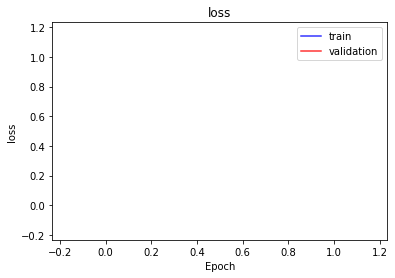

<b>bioma_loss</b>: nan (min: nan, max: nan)

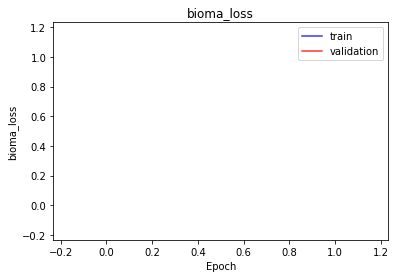

<b>domain_loss</b>: nan (min: nan, max: nan)

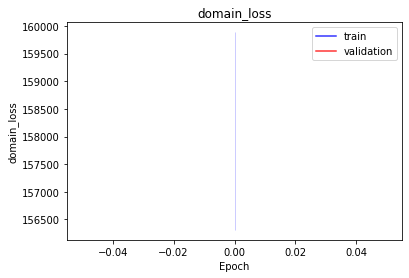

<b>latent_loss</b>: nan (min: nan, max: nan)

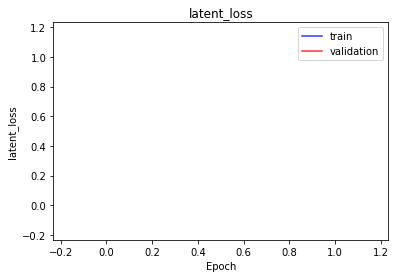

<b>bioma_mse</b>: nan (min: nan, max: nan)

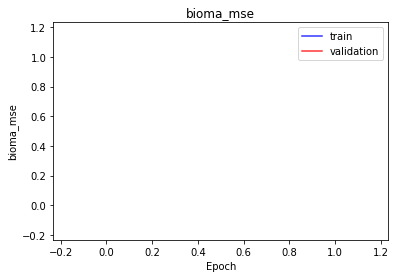

<b>bioma_mae</b>: nan (min: nan, max: nan)

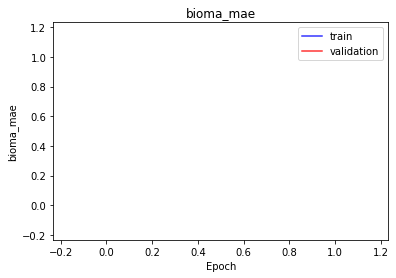

<b>bioma_mape</b>: nan (min: nan, max: nan)

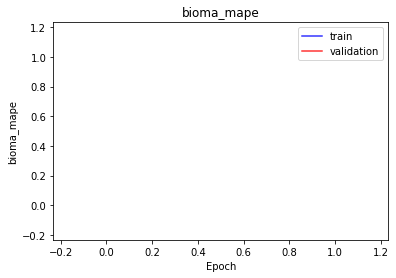

<b>domain_mse</b>: nan (min: nan, max: nan)

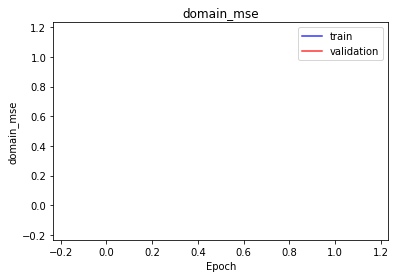

<b>domain_mae</b>: nan (min: nan, max: nan)

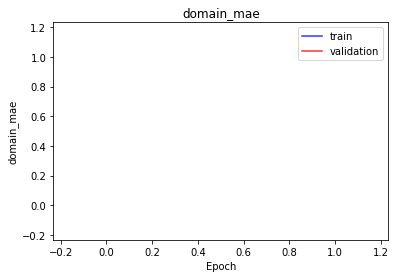

<b>domain_mape</b>: nan (min: nan, max: nan)

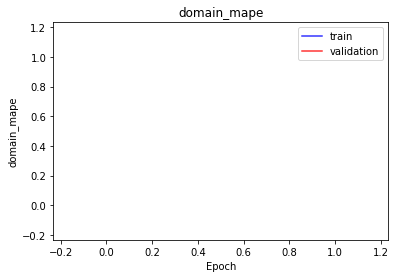

<b>latent_mae</b>: nan (min: nan, max: nan)

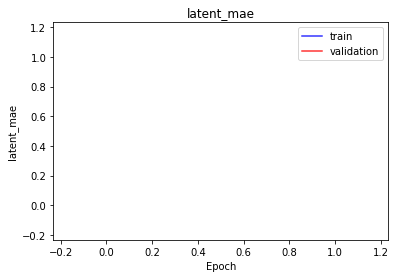

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

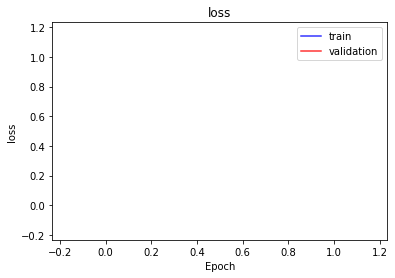

<b>bioma_loss</b>: nan (min: nan, max: nan)

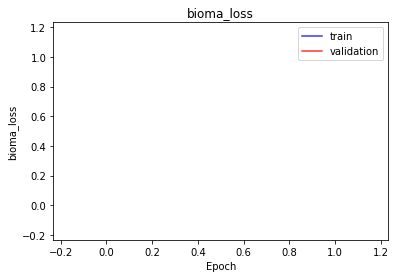

<b>domain_loss</b>: nan (min: nan, max: nan)

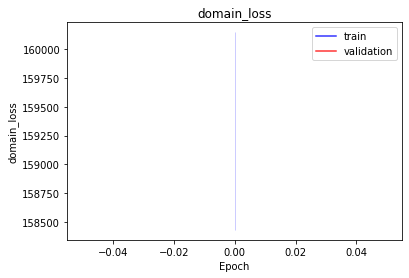

<b>latent_loss</b>: nan (min: nan, max: nan)

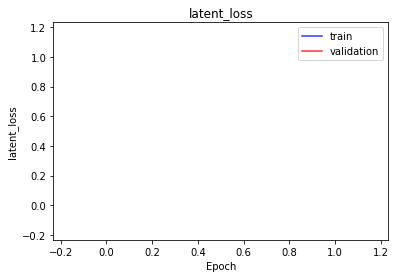

<b>bioma_mse</b>: nan (min: nan, max: nan)

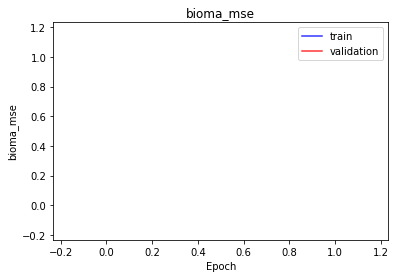

<b>bioma_mae</b>: nan (min: nan, max: nan)

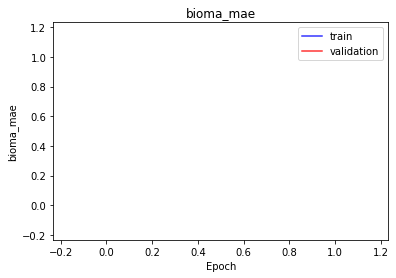

<b>bioma_mape</b>: nan (min: nan, max: nan)

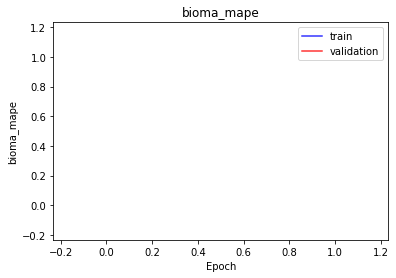

<b>domain_mse</b>: nan (min: nan, max: nan)

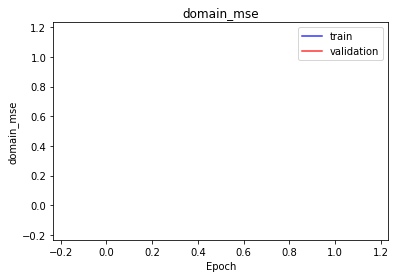

<b>domain_mae</b>: nan (min: nan, max: nan)

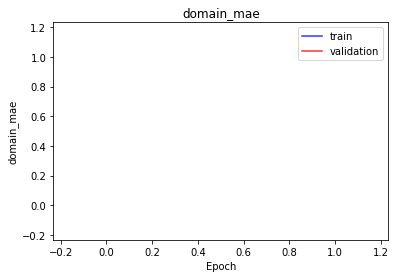

<b>domain_mape</b>: nan (min: nan, max: nan)

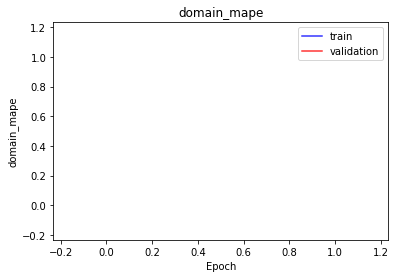

<b>latent_mae</b>: nan (min: nan, max: nan)

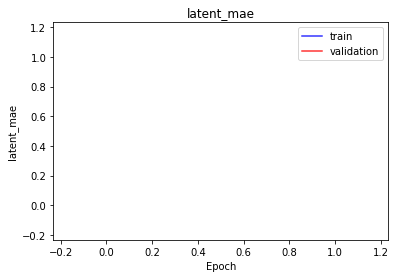

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

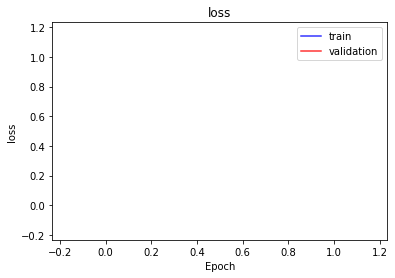

<b>bioma_loss</b>: nan (min: nan, max: nan)

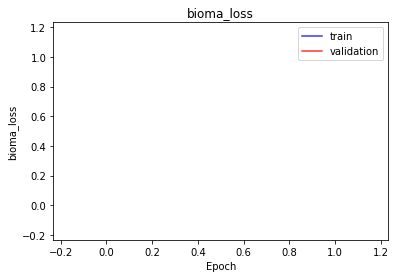

<b>domain_loss</b>: nan (min: nan, max: nan)

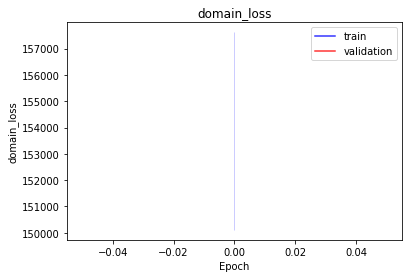

<b>latent_loss</b>: nan (min: nan, max: nan)

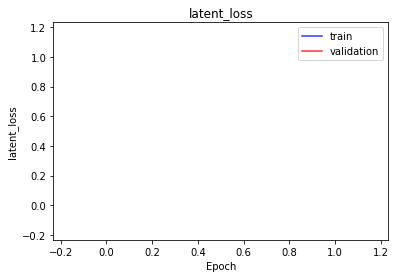

<b>bioma_mse</b>: nan (min: nan, max: nan)

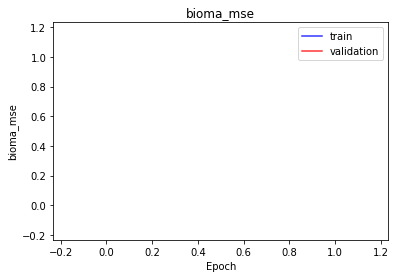

<b>bioma_mae</b>: nan (min: nan, max: nan)

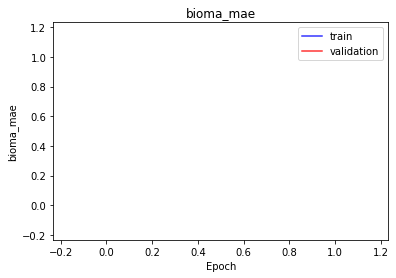

<b>bioma_mape</b>: nan (min: nan, max: nan)

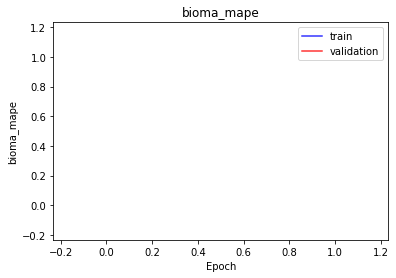

<b>domain_mse</b>: nan (min: nan, max: nan)

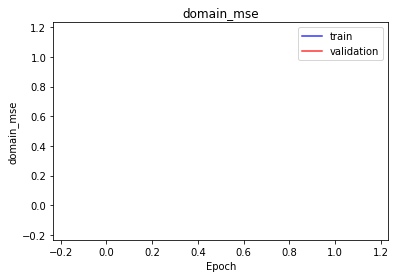

<b>domain_mae</b>: nan (min: nan, max: nan)

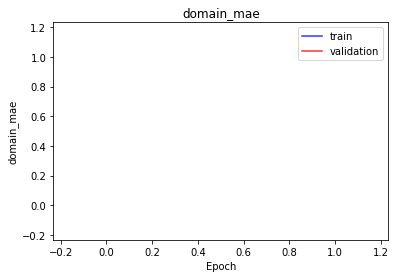

<b>domain_mape</b>: nan (min: nan, max: nan)

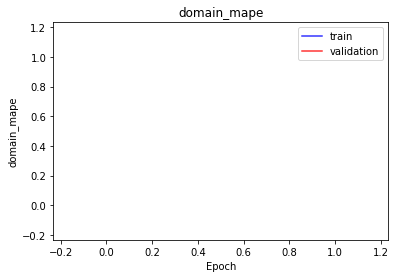

<b>latent_mae</b>: nan (min: nan, max: nan)

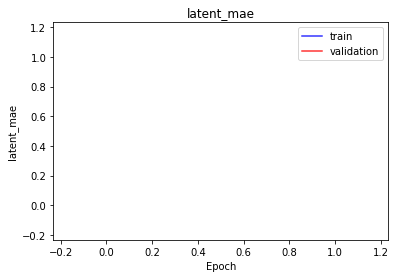

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

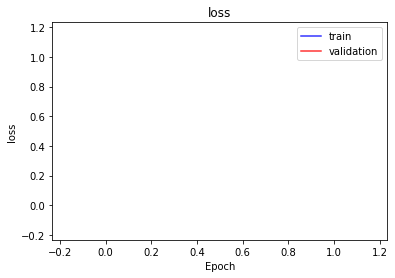

<b>bioma_loss</b>: nan (min: nan, max: nan)

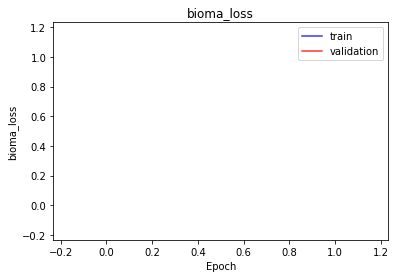

<b>domain_loss</b>: nan (min: nan, max: nan)

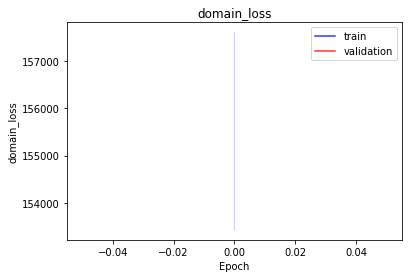

<b>latent_loss</b>: nan (min: nan, max: nan)

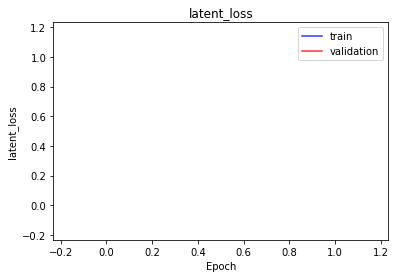

<b>bioma_mse</b>: nan (min: nan, max: nan)

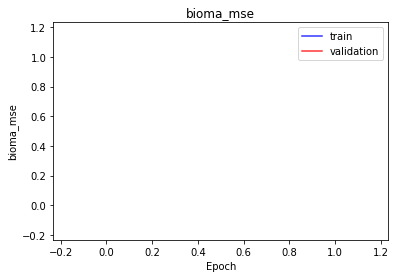

<b>bioma_mae</b>: nan (min: nan, max: nan)

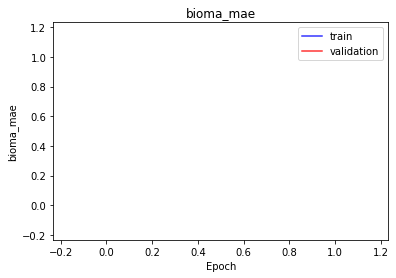

<b>bioma_mape</b>: nan (min: nan, max: nan)

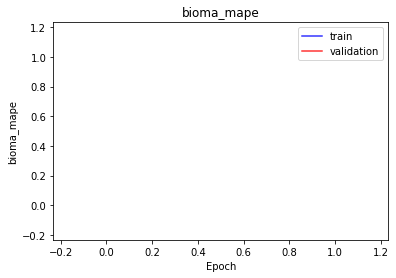

<b>domain_mse</b>: nan (min: nan, max: nan)

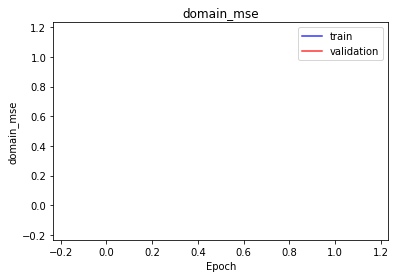

<b>domain_mae</b>: nan (min: nan, max: nan)

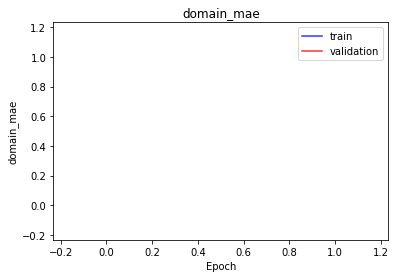

<b>domain_mape</b>: nan (min: nan, max: nan)

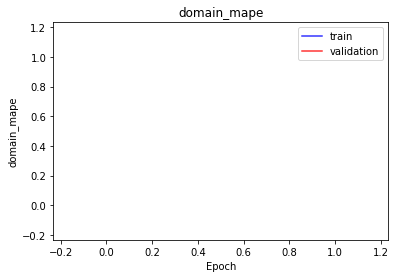

<b>latent_mae</b>: nan (min: nan, max: nan)

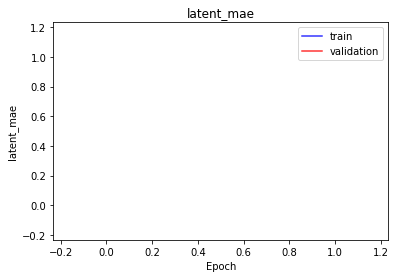

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

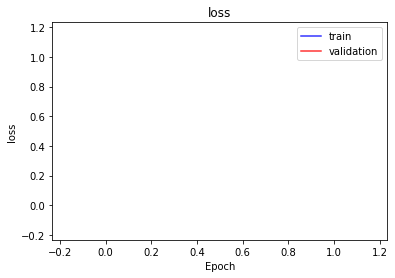

<b>bioma_loss</b>: nan (min: nan, max: nan)

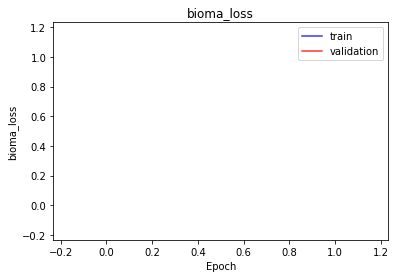

<b>domain_loss</b>: nan (min: nan, max: nan)

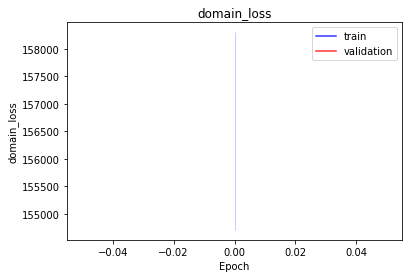

<b>latent_loss</b>: nan (min: nan, max: nan)

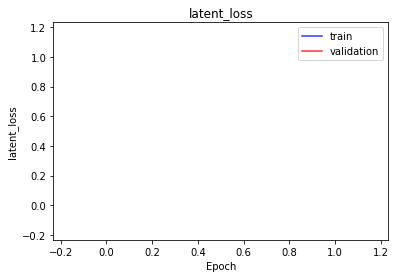

<b>bioma_mse</b>: nan (min: nan, max: nan)

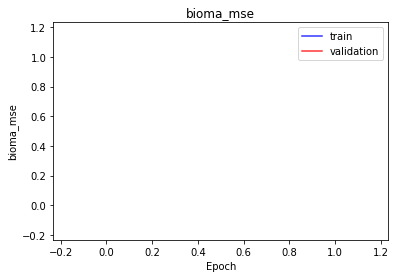

<b>bioma_mae</b>: nan (min: nan, max: nan)

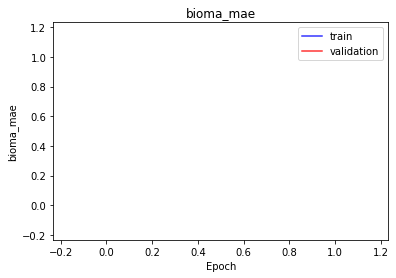

<b>bioma_mape</b>: nan (min: nan, max: nan)

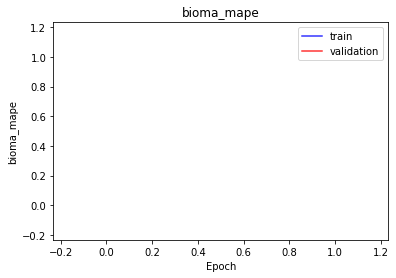

<b>domain_mse</b>: nan (min: nan, max: nan)

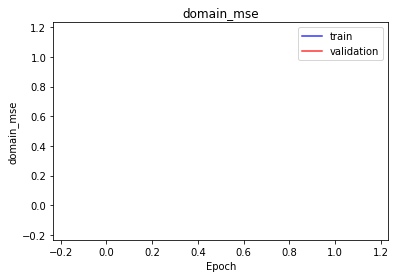

<b>domain_mae</b>: nan (min: nan, max: nan)

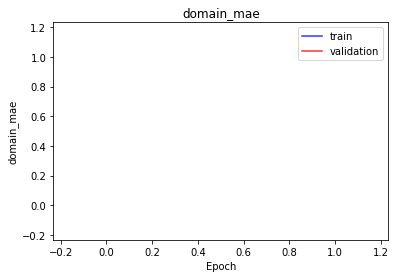

<b>domain_mape</b>: nan (min: nan, max: nan)

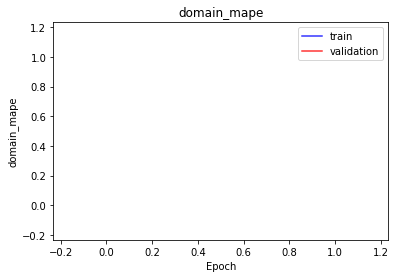

<b>latent_mae</b>: nan (min: nan, max: nan)

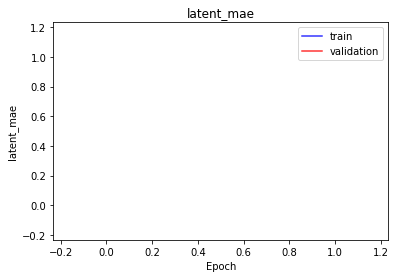

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

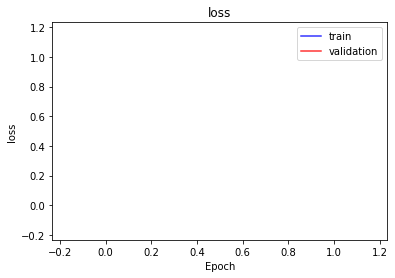

<b>bioma_loss</b>: nan (min: nan, max: nan)

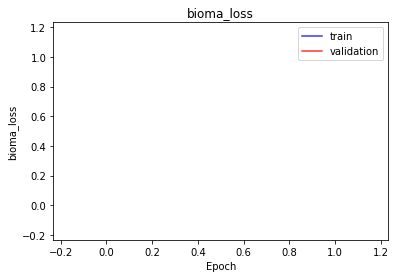

<b>domain_loss</b>: nan (min: nan, max: nan)

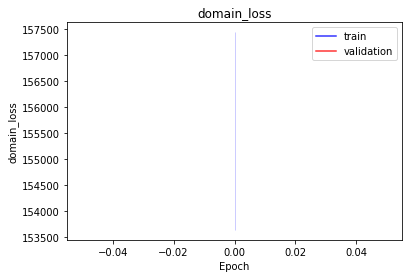

<b>latent_loss</b>: nan (min: nan, max: nan)

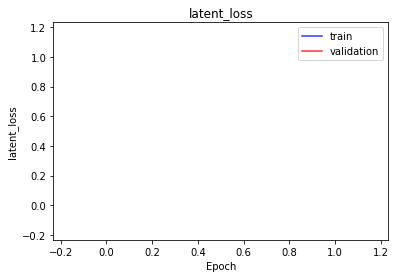

<b>bioma_mse</b>: nan (min: nan, max: nan)

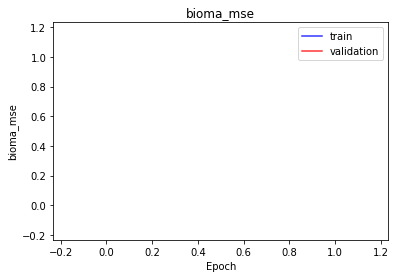

<b>bioma_mae</b>: nan (min: nan, max: nan)

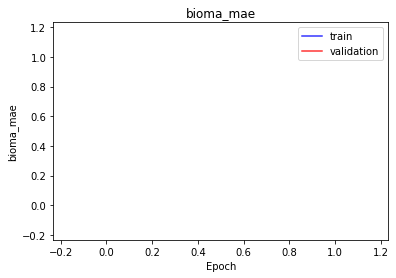

<b>bioma_mape</b>: nan (min: nan, max: nan)

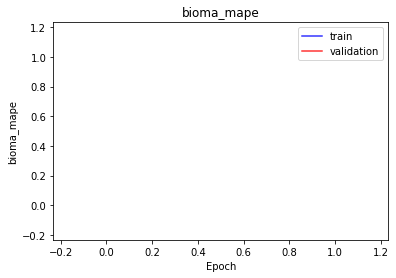

<b>domain_mse</b>: nan (min: nan, max: nan)

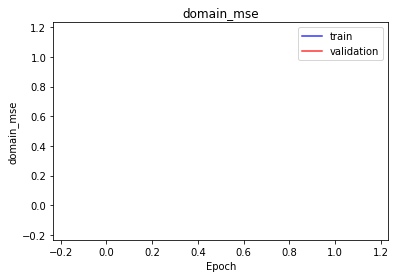

<b>domain_mae</b>: nan (min: nan, max: nan)

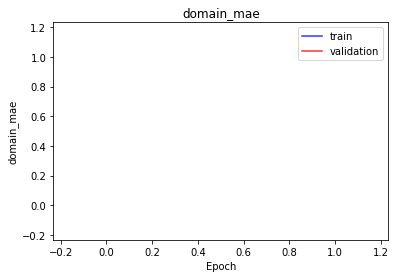

<b>domain_mape</b>: nan (min: nan, max: nan)

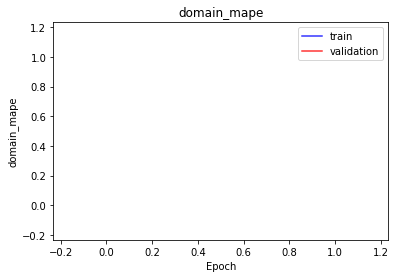

<b>latent_mae</b>: nan (min: nan, max: nan)

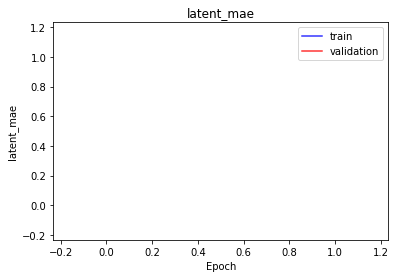

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

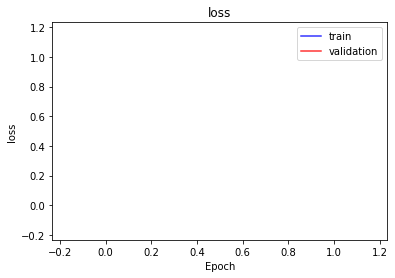

<b>bioma_loss</b>: nan (min: nan, max: nan)

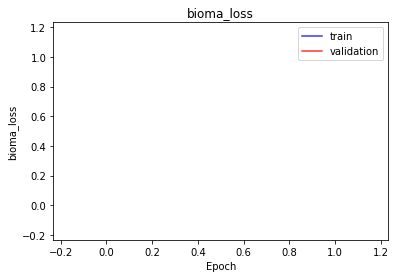

<b>domain_loss</b>: nan (min: nan, max: nan)

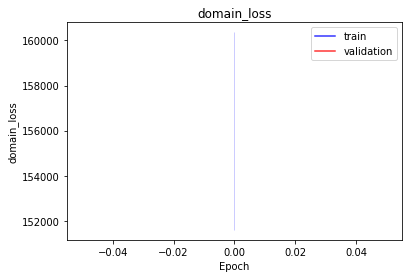

<b>latent_loss</b>: nan (min: nan, max: nan)

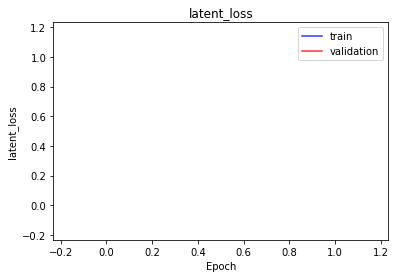

<b>bioma_mse</b>: nan (min: nan, max: nan)

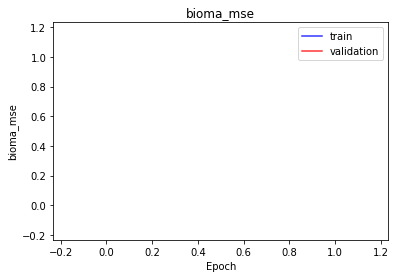

<b>bioma_mae</b>: nan (min: nan, max: nan)

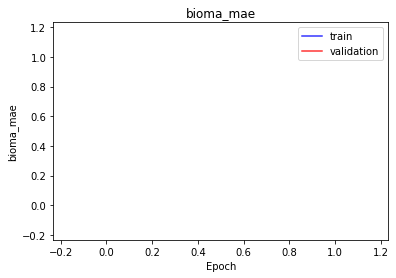

<b>bioma_mape</b>: nan (min: nan, max: nan)

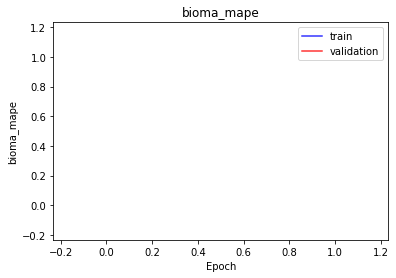

<b>domain_mse</b>: nan (min: nan, max: nan)

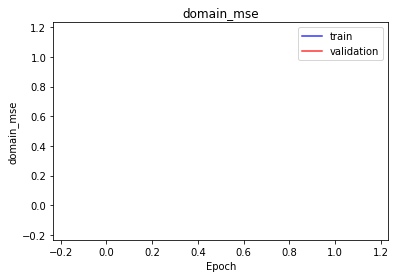

<b>domain_mae</b>: nan (min: nan, max: nan)

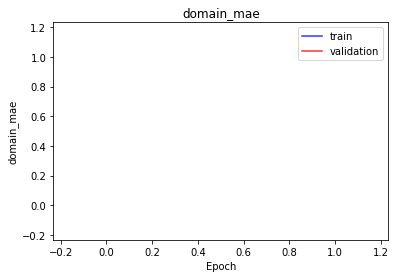

<b>domain_mape</b>: nan (min: nan, max: nan)

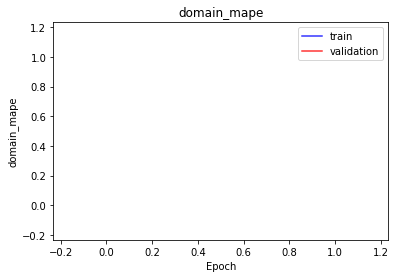

<b>latent_mae</b>: nan (min: nan, max: nan)

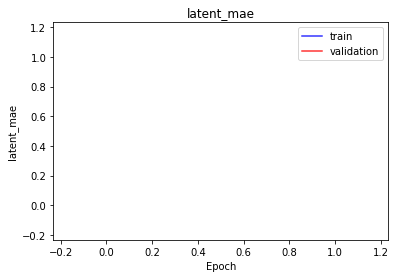

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 256 -> 10 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 10 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

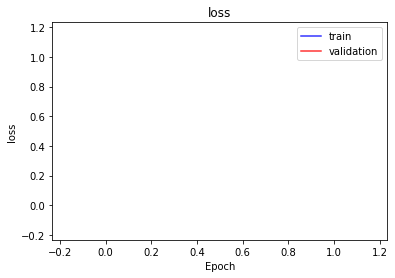

<b>bioma_loss</b>: nan (min: nan, max: nan)

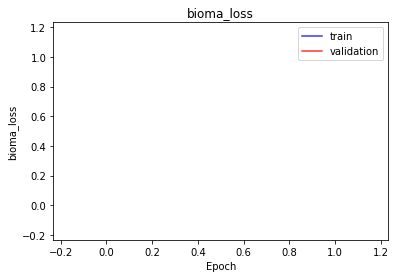

<b>domain_loss</b>: nan (min: nan, max: nan)

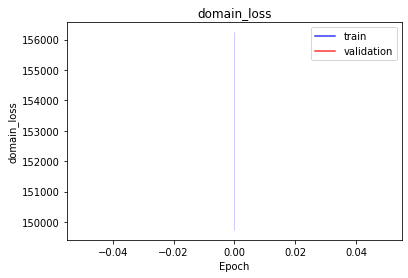

<b>latent_loss</b>: nan (min: nan, max: nan)

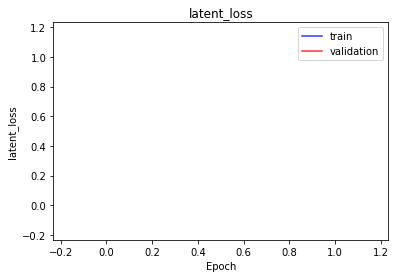

<b>bioma_mse</b>: nan (min: nan, max: nan)

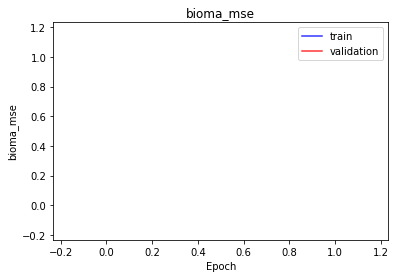

<b>bioma_mae</b>: nan (min: nan, max: nan)

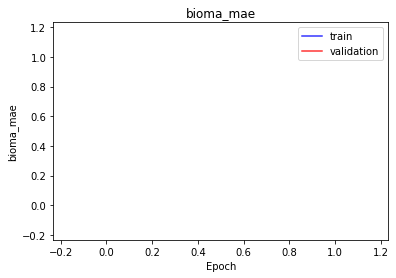

<b>bioma_mape</b>: nan (min: nan, max: nan)

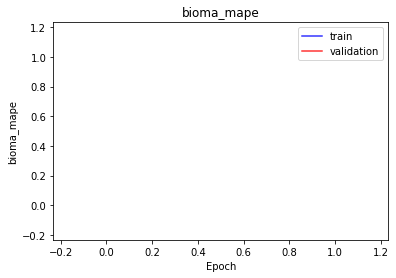

<b>domain_mse</b>: nan (min: nan, max: nan)

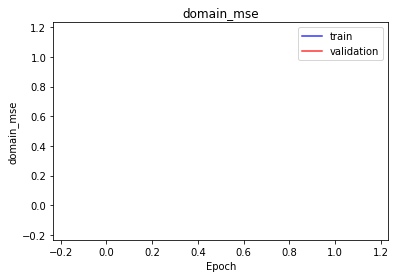

<b>domain_mae</b>: nan (min: nan, max: nan)

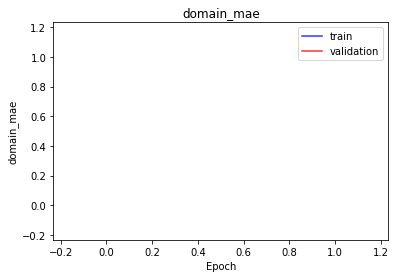

<b>domain_mape</b>: nan (min: nan, max: nan)

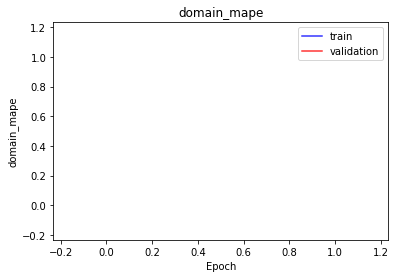

<b>latent_mae</b>: nan (min: nan, max: nan)

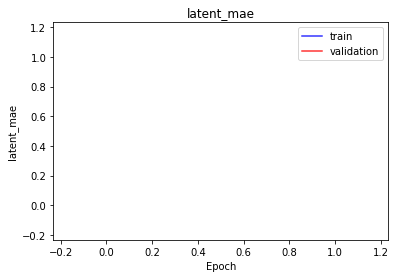

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

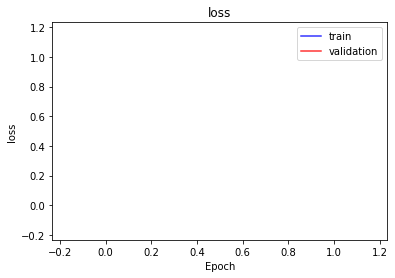

<b>bioma_loss</b>: nan (min: nan, max: nan)

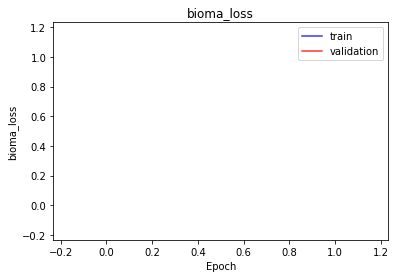

<b>domain_loss</b>: nan (min: nan, max: nan)

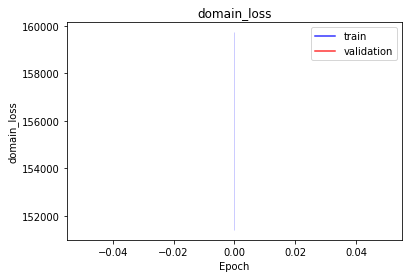

<b>latent_loss</b>: nan (min: nan, max: nan)

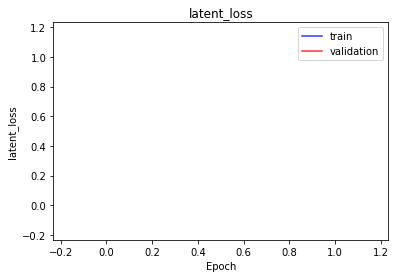

<b>bioma_mse</b>: nan (min: nan, max: nan)

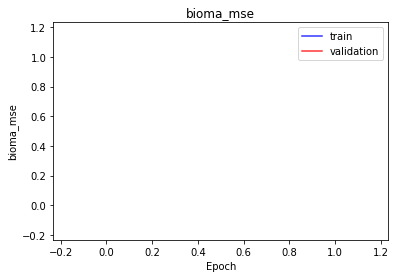

<b>bioma_mae</b>: nan (min: nan, max: nan)

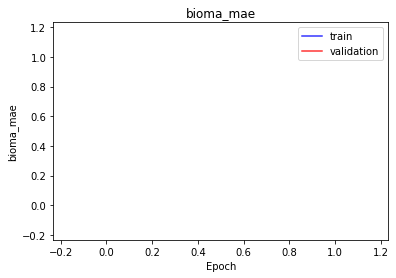

<b>bioma_mape</b>: nan (min: nan, max: nan)

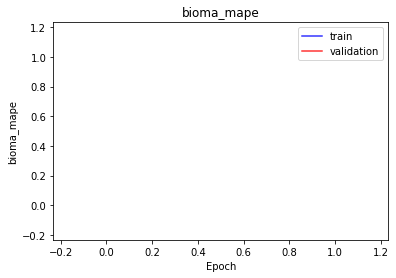

<b>domain_mse</b>: nan (min: nan, max: nan)

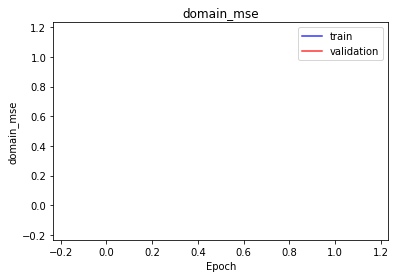

<b>domain_mae</b>: nan (min: nan, max: nan)

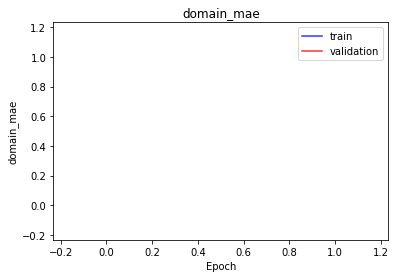

<b>domain_mape</b>: nan (min: nan, max: nan)

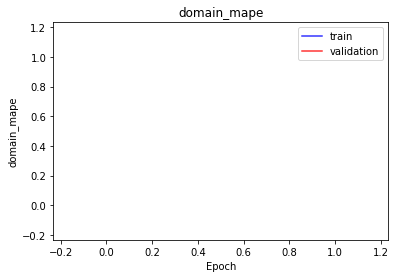

<b>latent_mae</b>: nan (min: nan, max: nan)

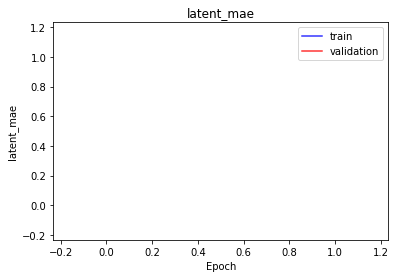

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

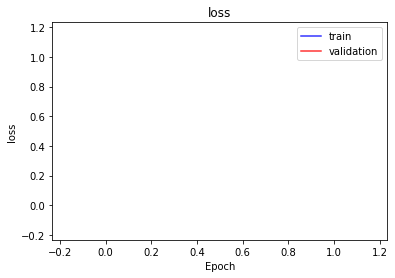

<b>bioma_loss</b>: nan (min: nan, max: nan)

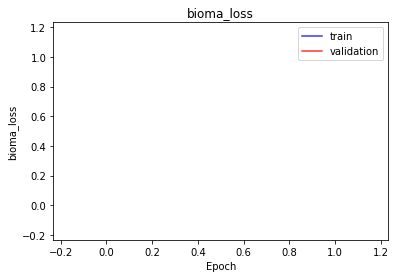

<b>domain_loss</b>: nan (min: nan, max: nan)

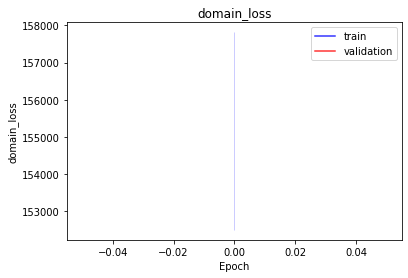

<b>latent_loss</b>: nan (min: nan, max: nan)

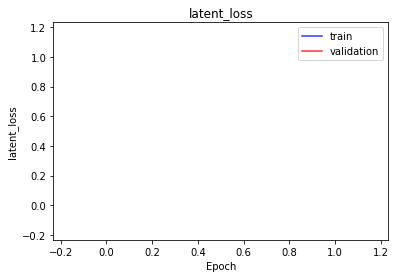

<b>bioma_mse</b>: nan (min: nan, max: nan)

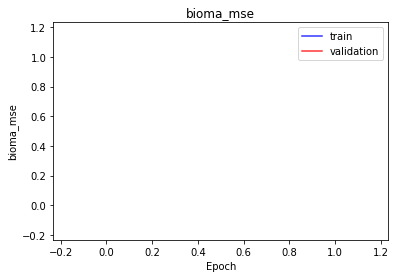

<b>bioma_mae</b>: nan (min: nan, max: nan)

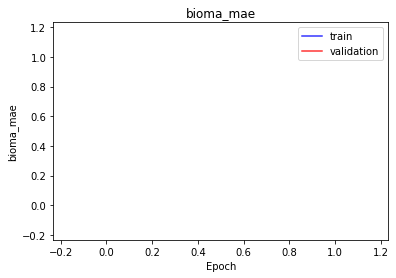

<b>bioma_mape</b>: nan (min: nan, max: nan)

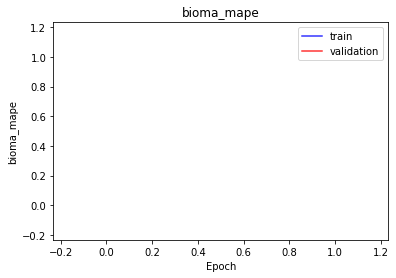

<b>domain_mse</b>: nan (min: nan, max: nan)

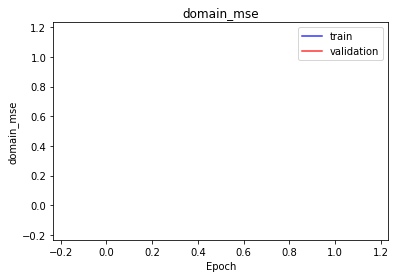

<b>domain_mae</b>: nan (min: nan, max: nan)

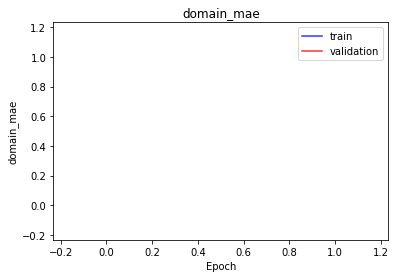

<b>domain_mape</b>: nan (min: nan, max: nan)

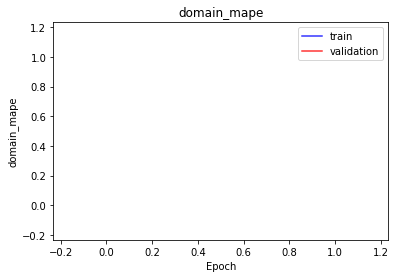

<b>latent_mae</b>: nan (min: nan, max: nan)

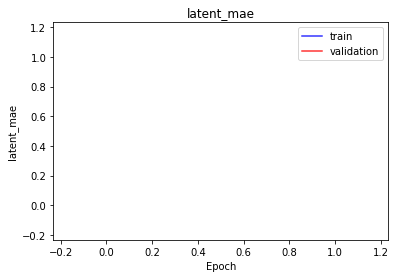

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

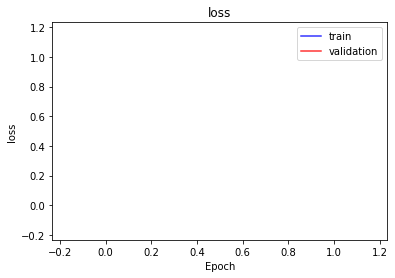

<b>bioma_loss</b>: nan (min: nan, max: nan)

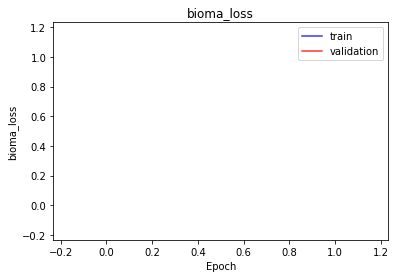

<b>domain_loss</b>: nan (min: nan, max: nan)

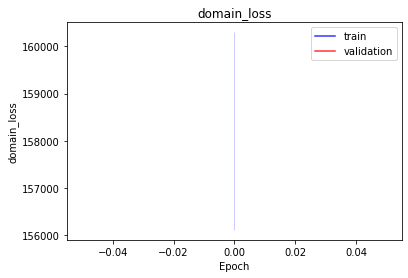

<b>latent_loss</b>: nan (min: nan, max: nan)

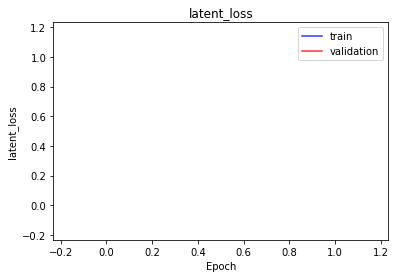

<b>bioma_mse</b>: nan (min: nan, max: nan)

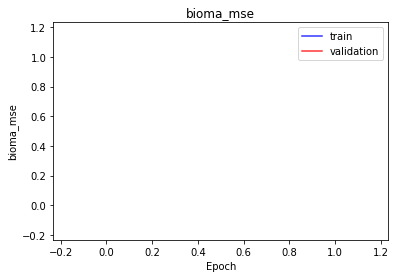

<b>bioma_mae</b>: nan (min: nan, max: nan)

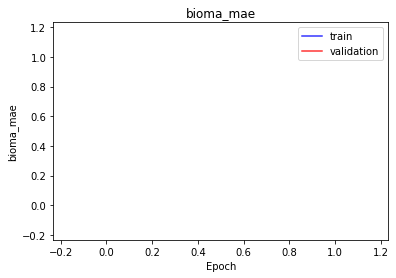

<b>bioma_mape</b>: nan (min: nan, max: nan)

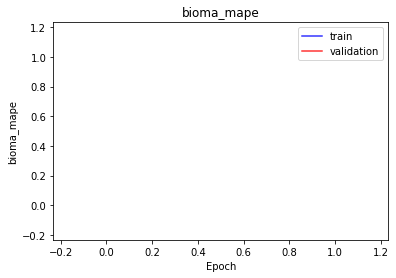

<b>domain_mse</b>: nan (min: nan, max: nan)

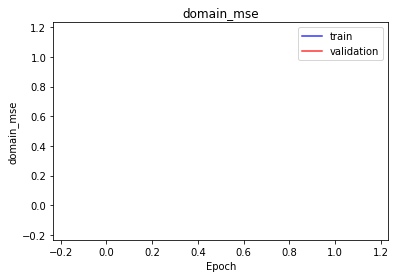

<b>domain_mae</b>: nan (min: nan, max: nan)

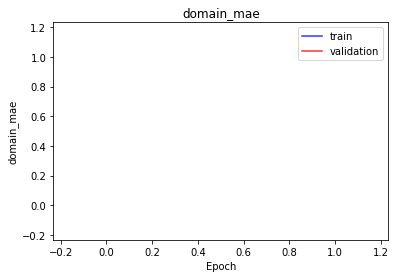

<b>domain_mape</b>: nan (min: nan, max: nan)

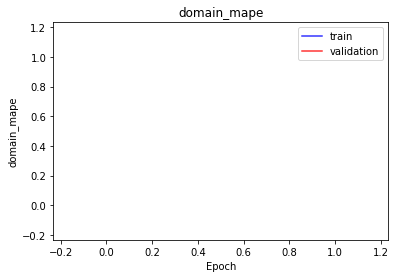

<b>latent_mae</b>: nan (min: nan, max: nan)

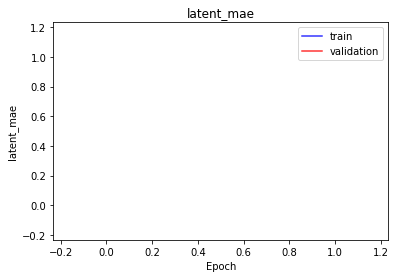

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

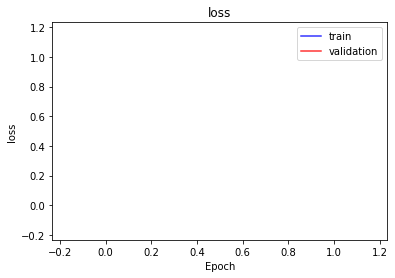

<b>bioma_loss</b>: nan (min: nan, max: nan)

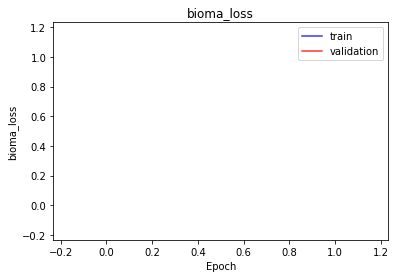

<b>domain_loss</b>: nan (min: nan, max: nan)

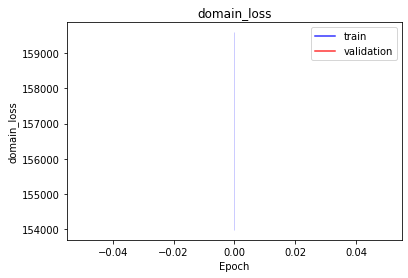

<b>latent_loss</b>: nan (min: nan, max: nan)

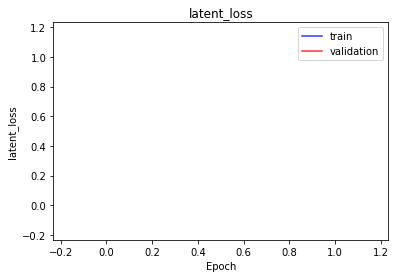

<b>bioma_mse</b>: nan (min: nan, max: nan)

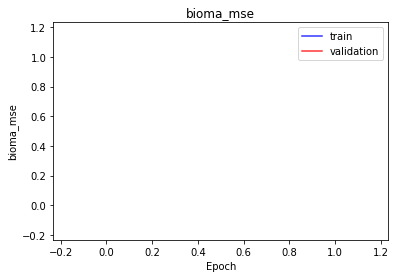

<b>bioma_mae</b>: nan (min: nan, max: nan)

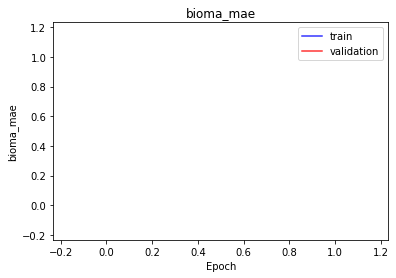

<b>bioma_mape</b>: nan (min: nan, max: nan)

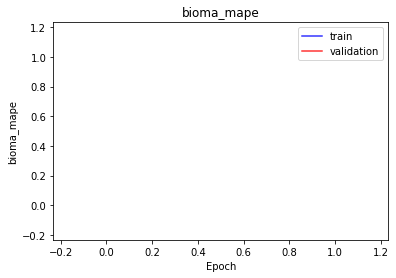

<b>domain_mse</b>: nan (min: nan, max: nan)

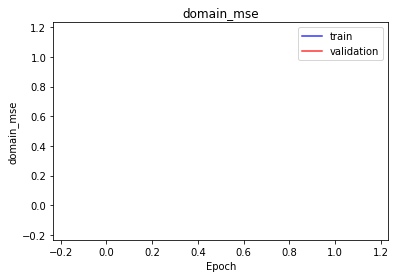

<b>domain_mae</b>: nan (min: nan, max: nan)

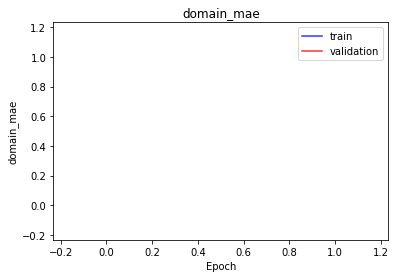

<b>domain_mape</b>: nan (min: nan, max: nan)

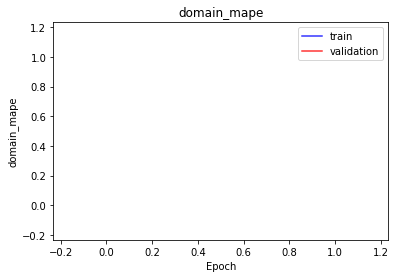

<b>latent_mae</b>: nan (min: nan, max: nan)

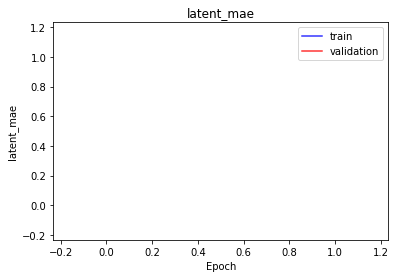

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

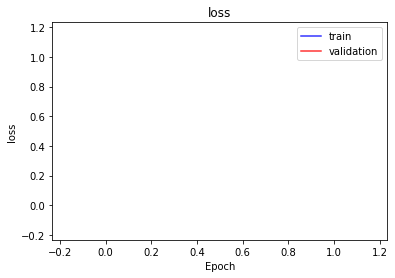

<b>bioma_loss</b>: nan (min: nan, max: nan)

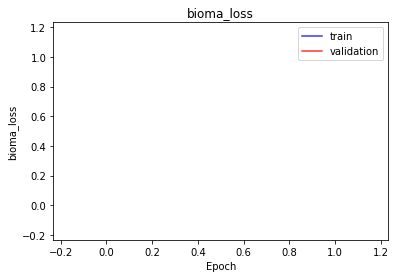

<b>domain_loss</b>: nan (min: nan, max: nan)

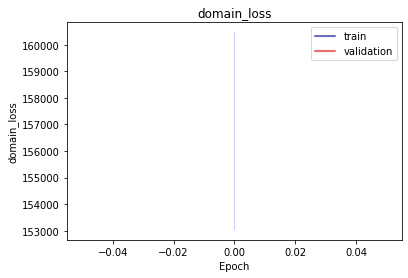

<b>latent_loss</b>: nan (min: nan, max: nan)

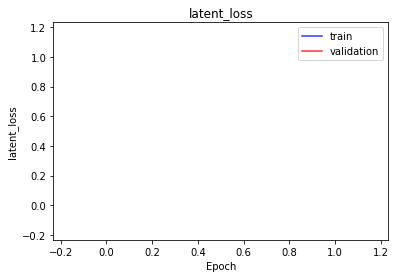

<b>bioma_mse</b>: nan (min: nan, max: nan)

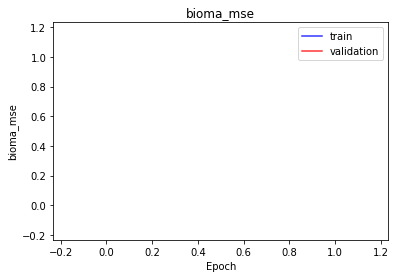

<b>bioma_mae</b>: nan (min: nan, max: nan)

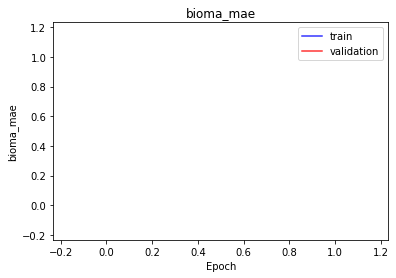

<b>bioma_mape</b>: nan (min: nan, max: nan)

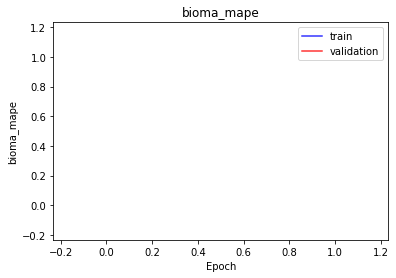

<b>domain_mse</b>: nan (min: nan, max: nan)

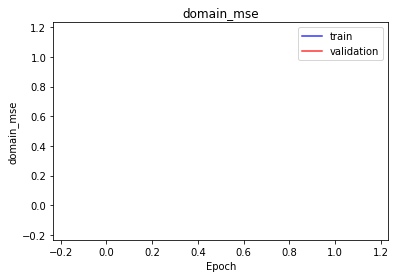

<b>domain_mae</b>: nan (min: nan, max: nan)

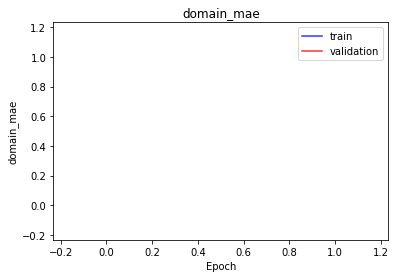

<b>domain_mape</b>: nan (min: nan, max: nan)

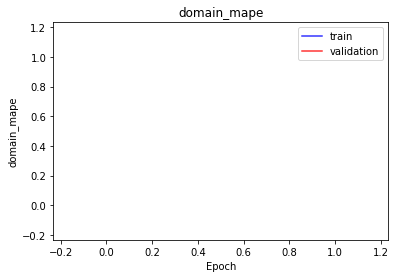

<b>latent_mae</b>: nan (min: nan, max: nan)

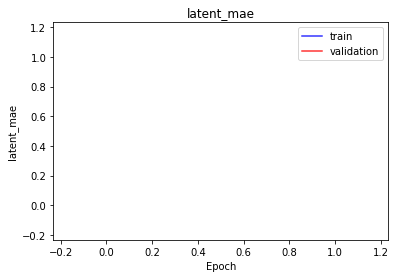

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 10 |
| Bioma Autoencoder | b -> 10 -> b |
| Domain Autoencoder | d -> 10 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

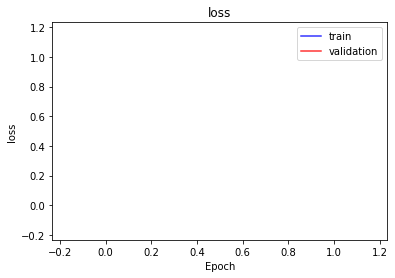

<b>bioma_loss</b>: nan (min: nan, max: nan)

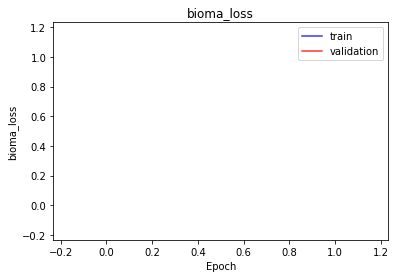

<b>domain_loss</b>: nan (min: nan, max: nan)

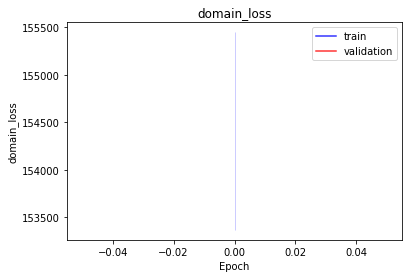

<b>latent_loss</b>: nan (min: nan, max: nan)

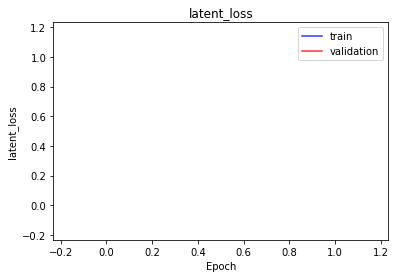

<b>bioma_mse</b>: nan (min: nan, max: nan)

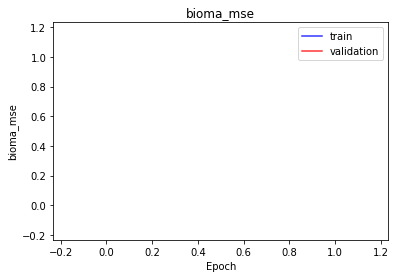

<b>bioma_mae</b>: nan (min: nan, max: nan)

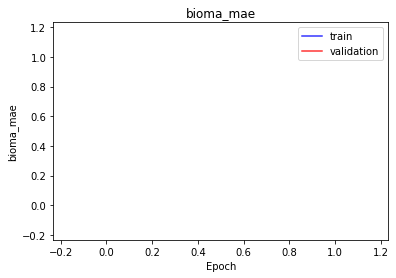

<b>bioma_mape</b>: nan (min: nan, max: nan)

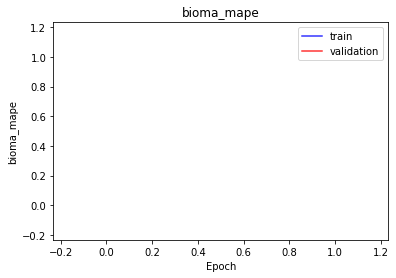

<b>domain_mse</b>: nan (min: nan, max: nan)

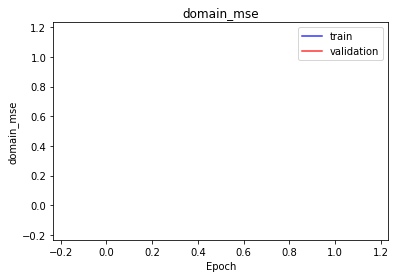

<b>domain_mae</b>: nan (min: nan, max: nan)

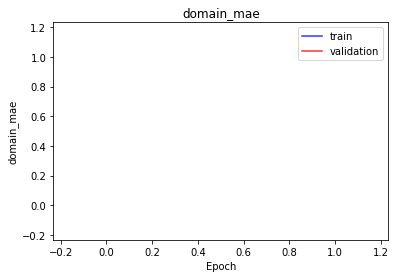

<b>domain_mape</b>: nan (min: nan, max: nan)

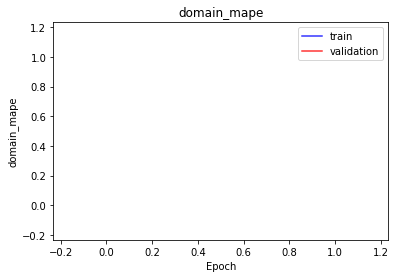

<b>latent_mae</b>: nan (min: nan, max: nan)

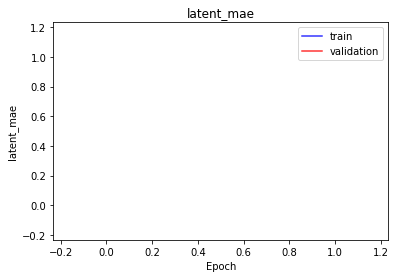

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

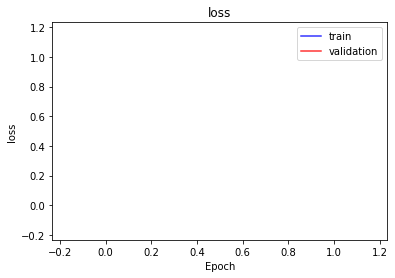

<b>bioma_loss</b>: nan (min: nan, max: nan)

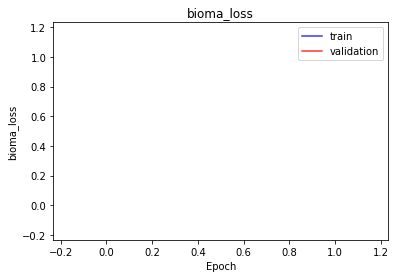

<b>domain_loss</b>: nan (min: nan, max: nan)

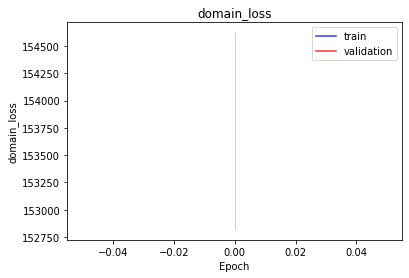

<b>latent_loss</b>: nan (min: nan, max: nan)

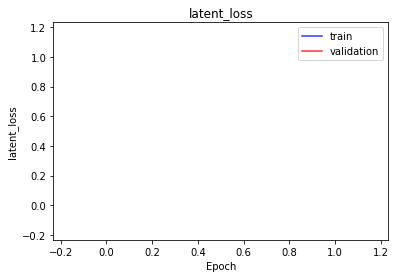

<b>bioma_mse</b>: nan (min: nan, max: nan)

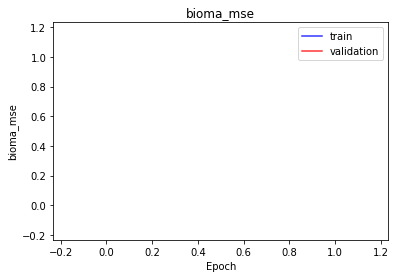

<b>bioma_mae</b>: nan (min: nan, max: nan)

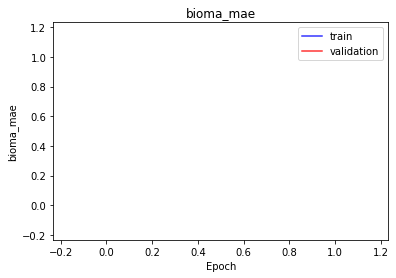

<b>bioma_mape</b>: nan (min: nan, max: nan)

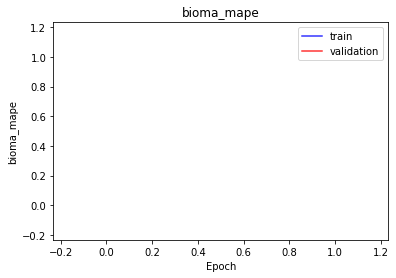

<b>domain_mse</b>: nan (min: nan, max: nan)

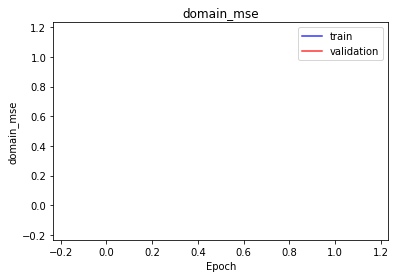

<b>domain_mae</b>: nan (min: nan, max: nan)

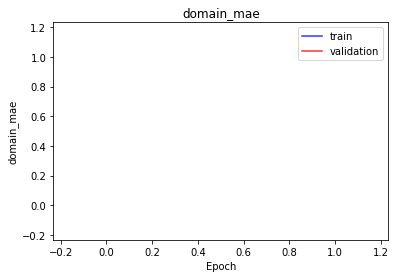

<b>domain_mape</b>: nan (min: nan, max: nan)

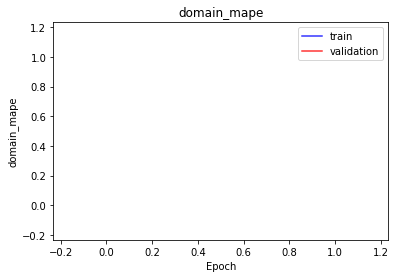

<b>latent_mae</b>: nan (min: nan, max: nan)

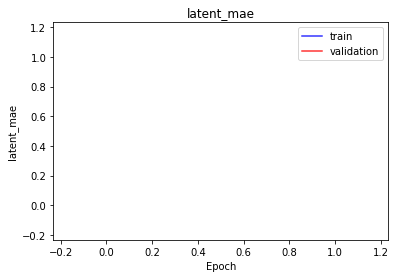

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

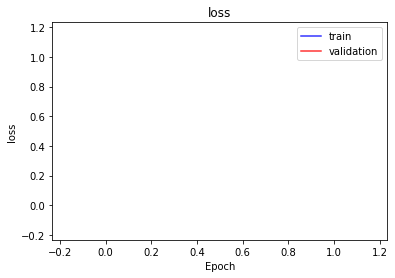

<b>bioma_loss</b>: nan (min: nan, max: nan)

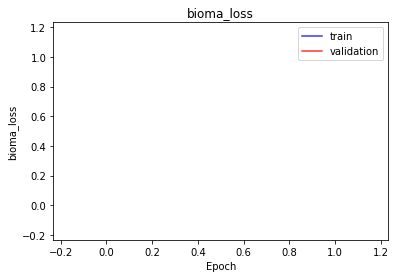

<b>domain_loss</b>: nan (min: nan, max: nan)

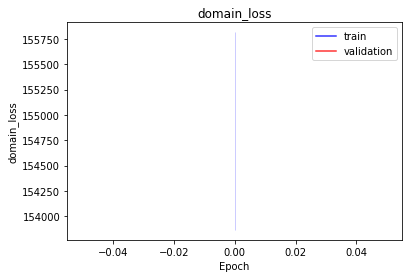

<b>latent_loss</b>: nan (min: nan, max: nan)

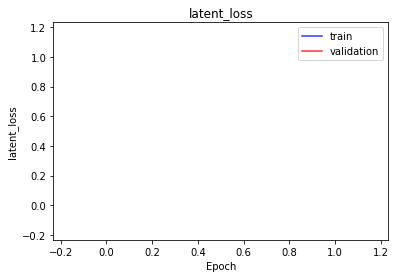

<b>bioma_mse</b>: nan (min: nan, max: nan)

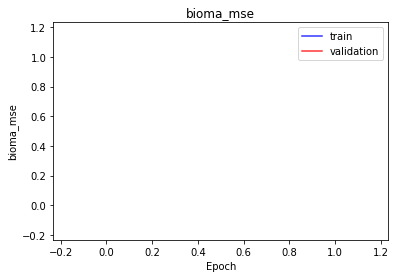

<b>bioma_mae</b>: nan (min: nan, max: nan)

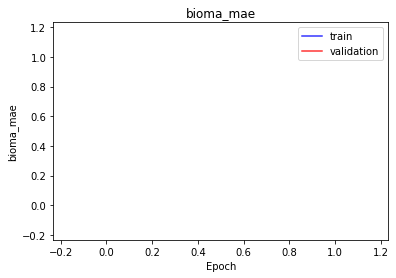

<b>bioma_mape</b>: nan (min: nan, max: nan)

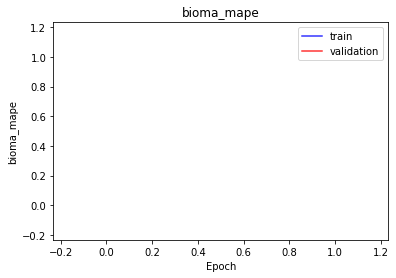

<b>domain_mse</b>: nan (min: nan, max: nan)

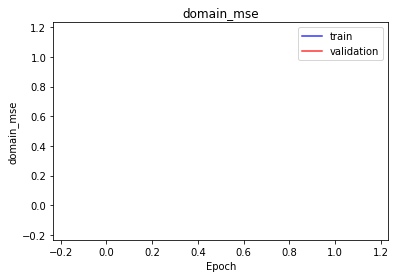

<b>domain_mae</b>: nan (min: nan, max: nan)

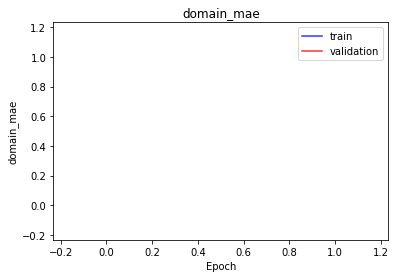

<b>domain_mape</b>: nan (min: nan, max: nan)

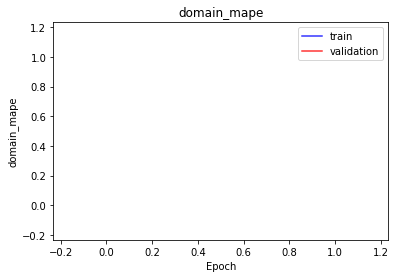

<b>latent_mae</b>: nan (min: nan, max: nan)

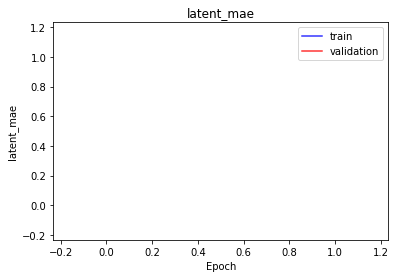

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

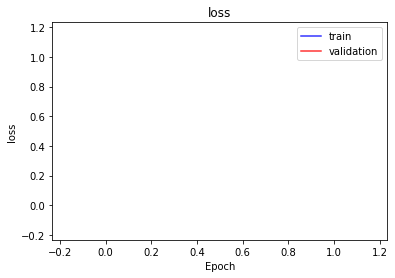

<b>bioma_loss</b>: nan (min: nan, max: nan)

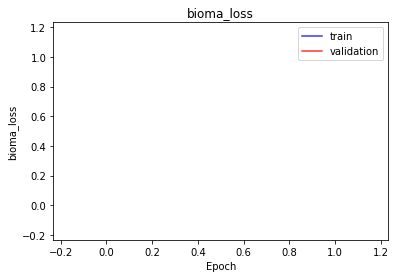

<b>domain_loss</b>: nan (min: nan, max: nan)

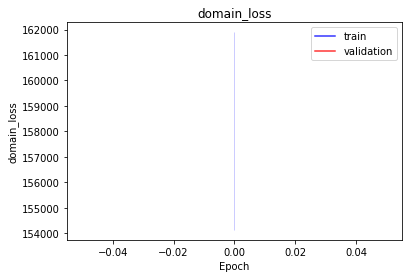

<b>latent_loss</b>: nan (min: nan, max: nan)

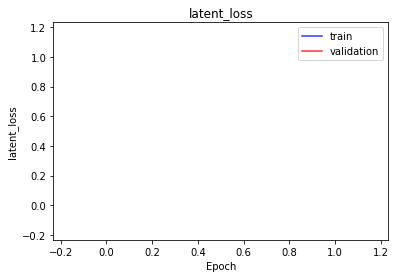

<b>bioma_mse</b>: nan (min: nan, max: nan)

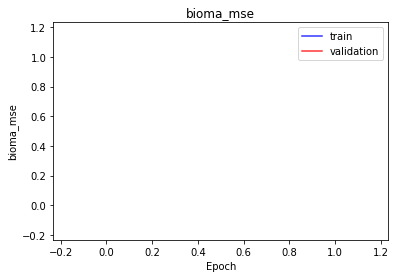

<b>bioma_mae</b>: nan (min: nan, max: nan)

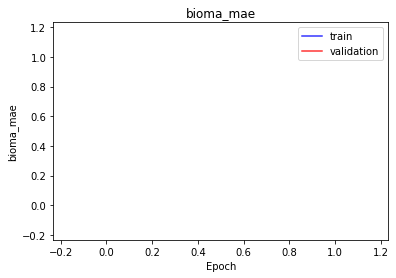

<b>bioma_mape</b>: nan (min: nan, max: nan)

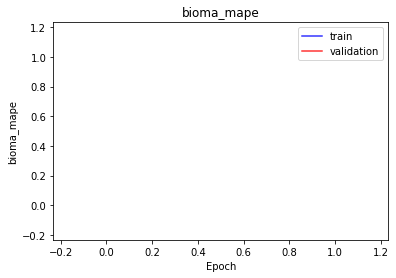

<b>domain_mse</b>: nan (min: nan, max: nan)

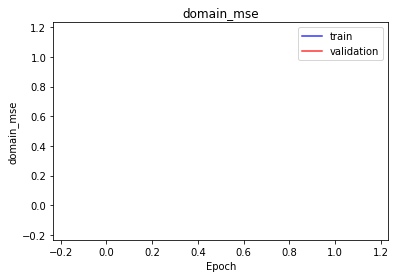

<b>domain_mae</b>: nan (min: nan, max: nan)

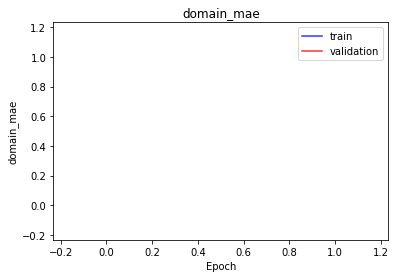

<b>domain_mape</b>: nan (min: nan, max: nan)

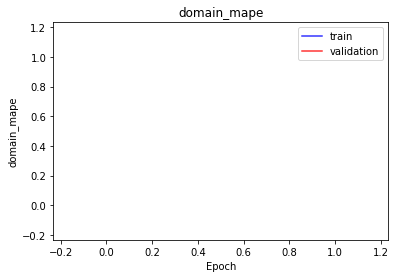

<b>latent_mae</b>: nan (min: nan, max: nan)

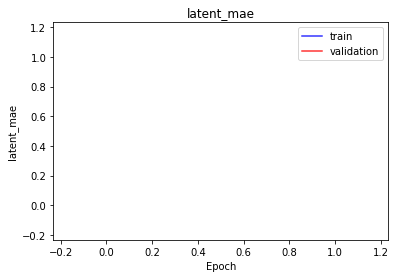

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

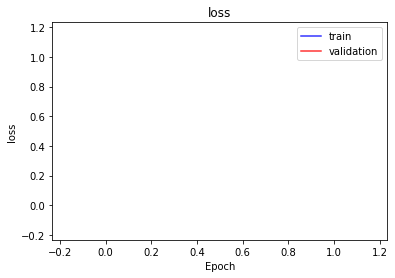

<b>bioma_loss</b>: nan (min: nan, max: nan)

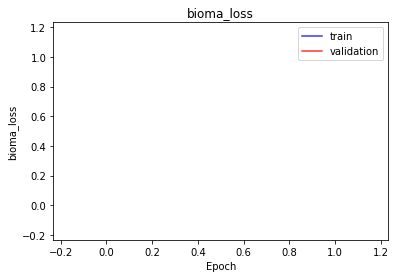

<b>domain_loss</b>: nan (min: nan, max: nan)

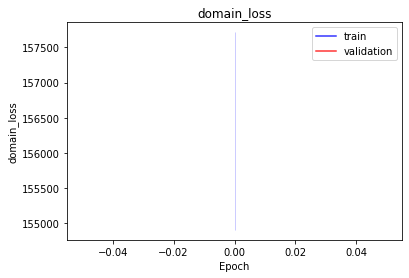

<b>latent_loss</b>: nan (min: nan, max: nan)

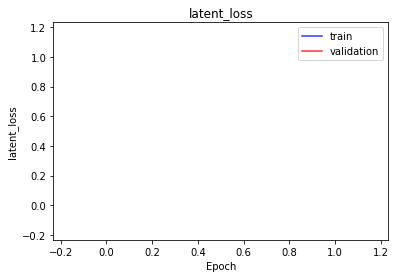

<b>bioma_mse</b>: nan (min: nan, max: nan)

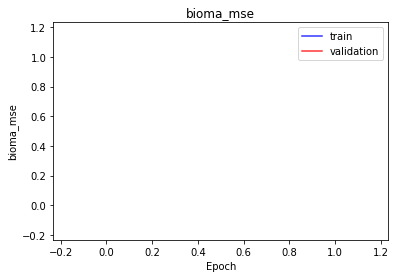

<b>bioma_mae</b>: nan (min: nan, max: nan)

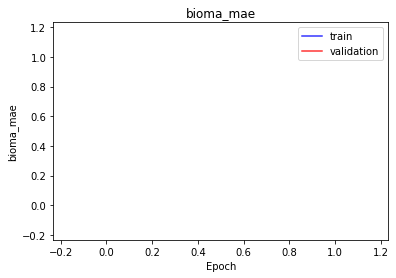

<b>bioma_mape</b>: nan (min: nan, max: nan)

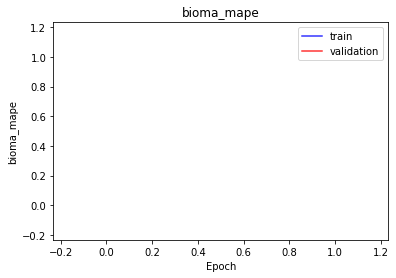

<b>domain_mse</b>: nan (min: nan, max: nan)

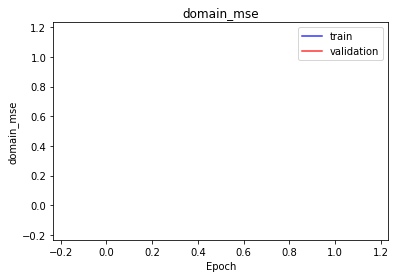

<b>domain_mae</b>: nan (min: nan, max: nan)

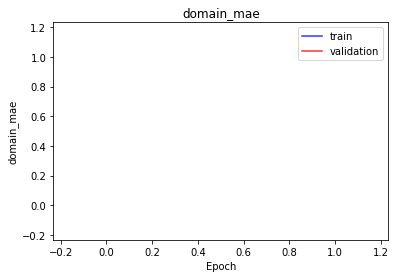

<b>domain_mape</b>: nan (min: nan, max: nan)

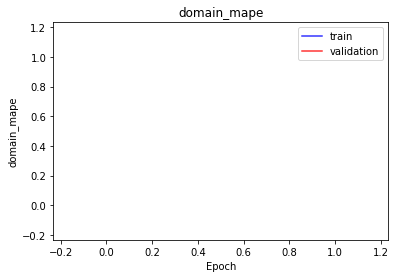

<b>latent_mae</b>: nan (min: nan, max: nan)

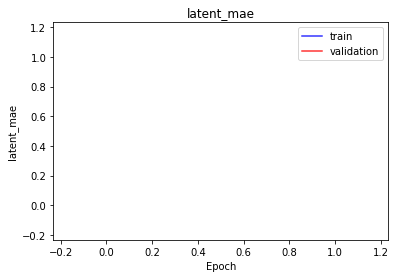

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

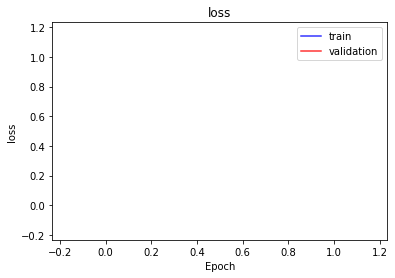

<b>bioma_loss</b>: nan (min: nan, max: nan)

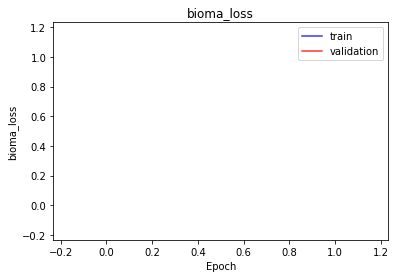

<b>domain_loss</b>: nan (min: nan, max: nan)

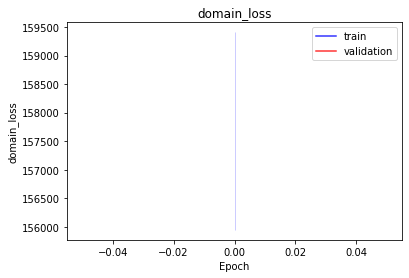

<b>latent_loss</b>: nan (min: nan, max: nan)

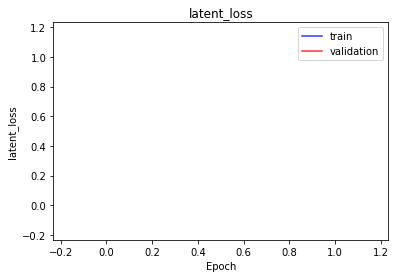

<b>bioma_mse</b>: nan (min: nan, max: nan)

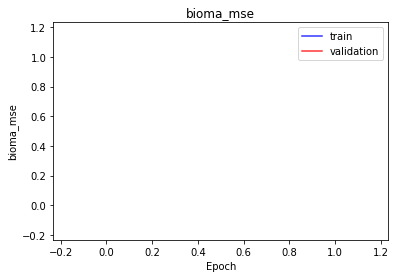

<b>bioma_mae</b>: nan (min: nan, max: nan)

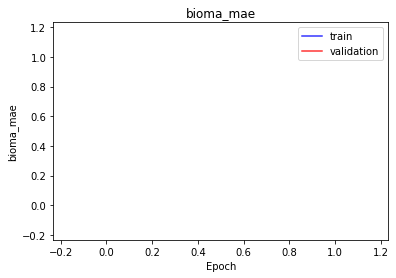

<b>bioma_mape</b>: nan (min: nan, max: nan)

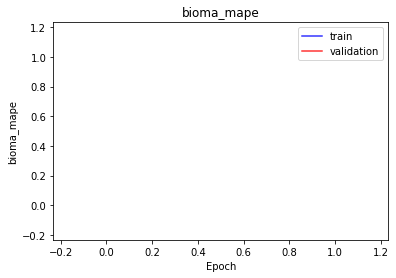

<b>domain_mse</b>: nan (min: nan, max: nan)

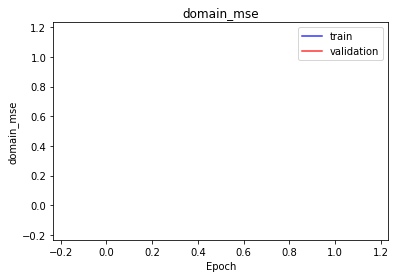

<b>domain_mae</b>: nan (min: nan, max: nan)

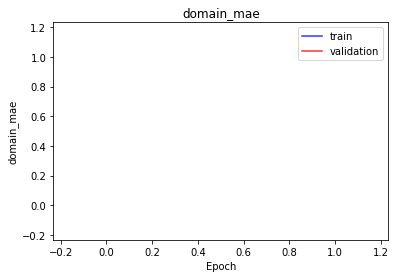

<b>domain_mape</b>: nan (min: nan, max: nan)

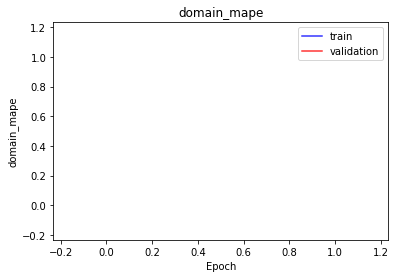

<b>latent_mae</b>: nan (min: nan, max: nan)

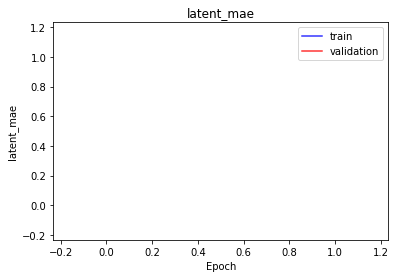

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

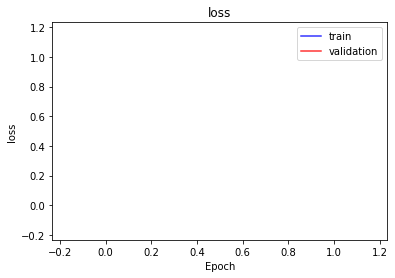

<b>bioma_loss</b>: nan (min: nan, max: nan)

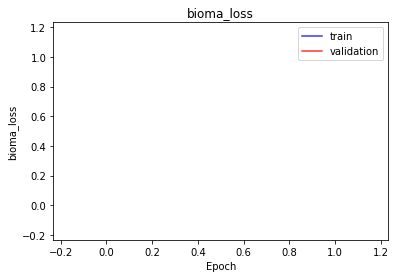

<b>domain_loss</b>: nan (min: nan, max: nan)

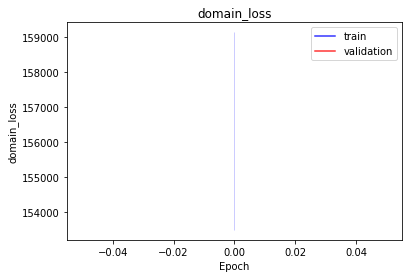

<b>latent_loss</b>: nan (min: nan, max: nan)

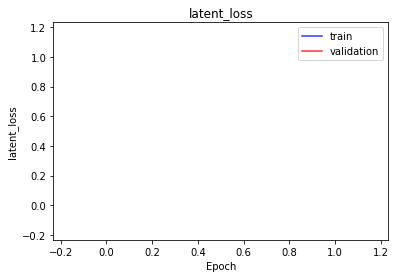

<b>bioma_mse</b>: nan (min: nan, max: nan)

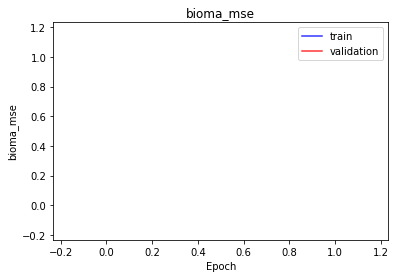

<b>bioma_mae</b>: nan (min: nan, max: nan)

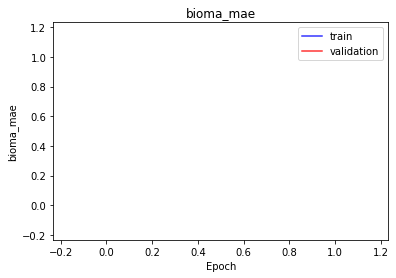

<b>bioma_mape</b>: nan (min: nan, max: nan)

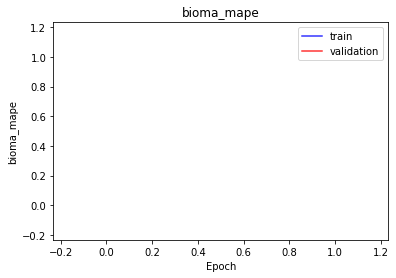

<b>domain_mse</b>: nan (min: nan, max: nan)

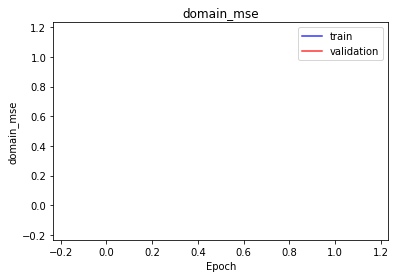

<b>domain_mae</b>: nan (min: nan, max: nan)

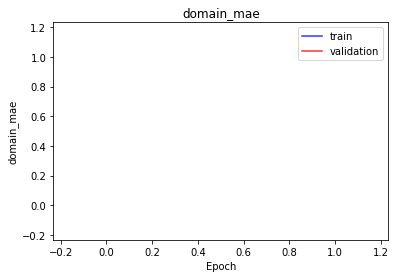

<b>domain_mape</b>: nan (min: nan, max: nan)

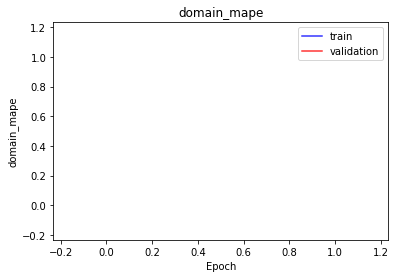

<b>latent_mae</b>: nan (min: nan, max: nan)

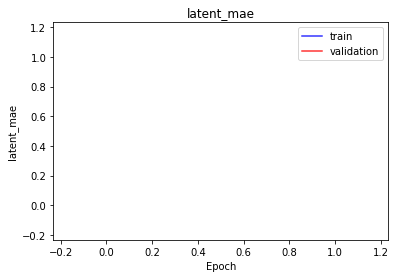

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

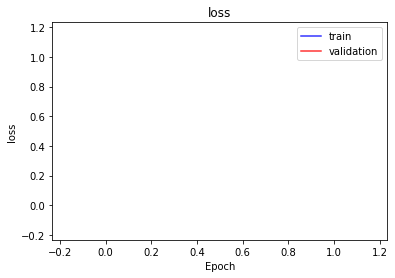

<b>bioma_loss</b>: nan (min: nan, max: nan)

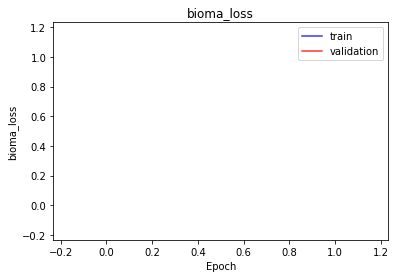

<b>domain_loss</b>: nan (min: nan, max: nan)

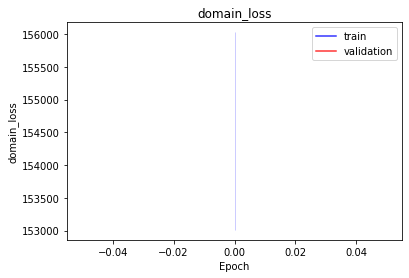

<b>latent_loss</b>: nan (min: nan, max: nan)

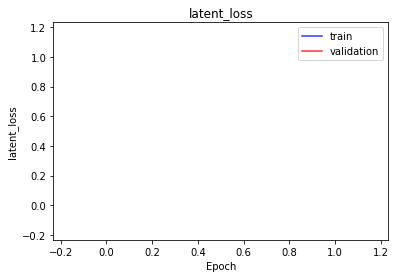

<b>bioma_mse</b>: nan (min: nan, max: nan)

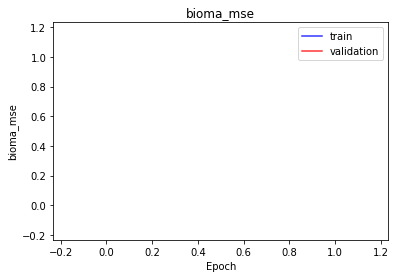

<b>bioma_mae</b>: nan (min: nan, max: nan)

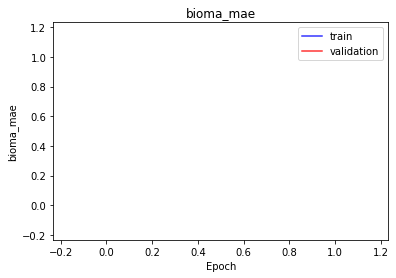

<b>bioma_mape</b>: nan (min: nan, max: nan)

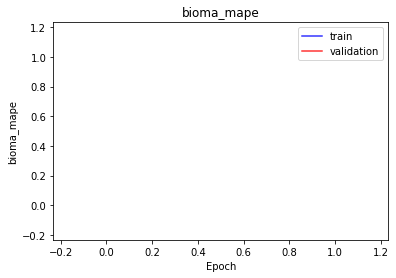

<b>domain_mse</b>: nan (min: nan, max: nan)

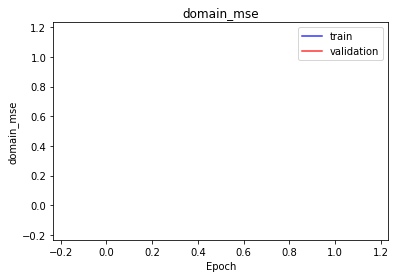

<b>domain_mae</b>: nan (min: nan, max: nan)

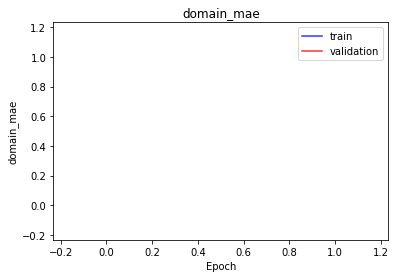

<b>domain_mape</b>: nan (min: nan, max: nan)

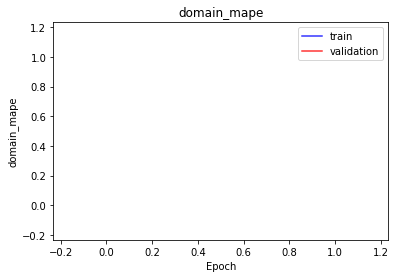

<b>latent_mae</b>: nan (min: nan, max: nan)

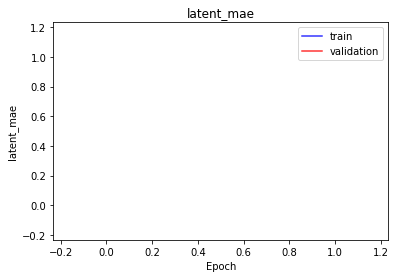

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

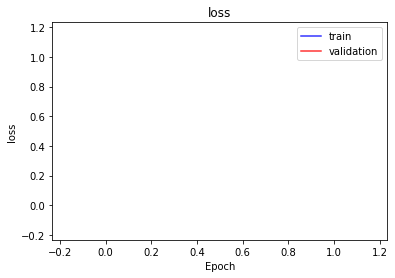

<b>bioma_loss</b>: nan (min: nan, max: nan)

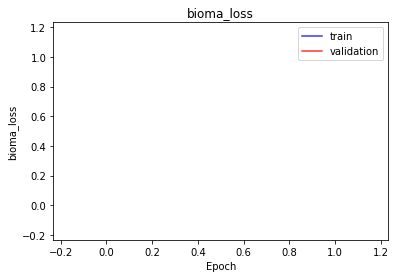

<b>domain_loss</b>: nan (min: nan, max: nan)

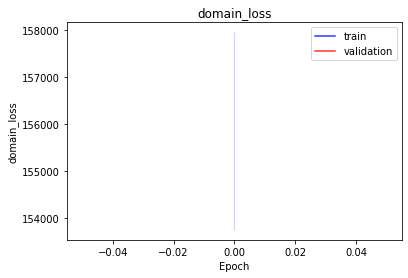

<b>latent_loss</b>: nan (min: nan, max: nan)

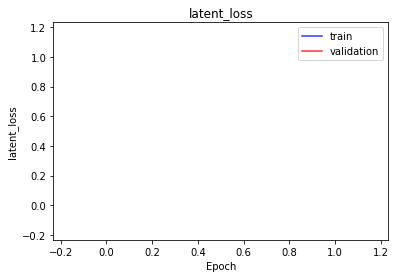

<b>bioma_mse</b>: nan (min: nan, max: nan)

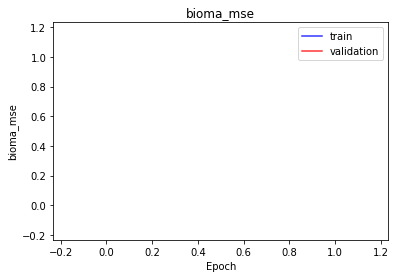

<b>bioma_mae</b>: nan (min: nan, max: nan)

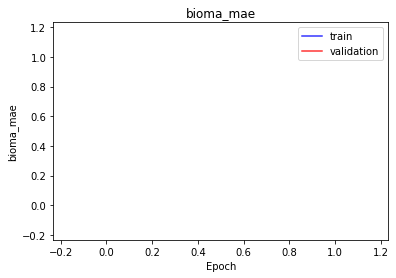

<b>bioma_mape</b>: nan (min: nan, max: nan)

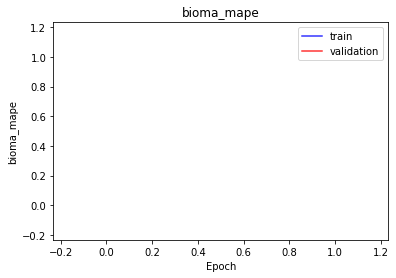

<b>domain_mse</b>: nan (min: nan, max: nan)

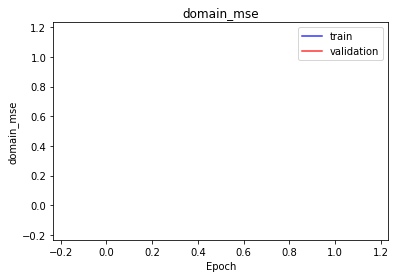

<b>domain_mae</b>: nan (min: nan, max: nan)

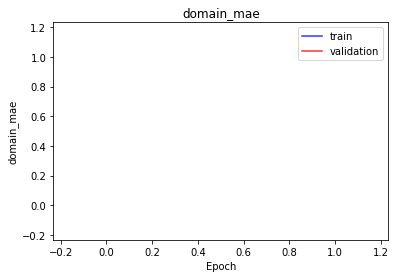

<b>domain_mape</b>: nan (min: nan, max: nan)

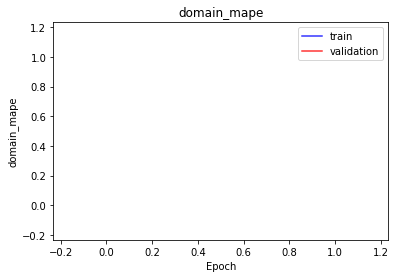

<b>latent_mae</b>: nan (min: nan, max: nan)

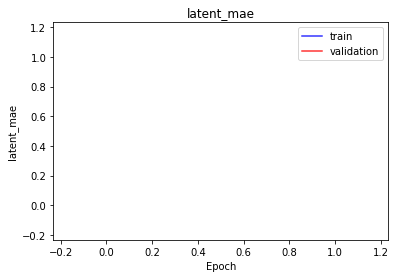

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

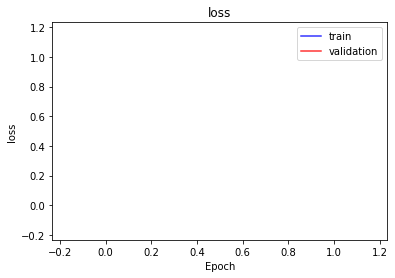

<b>bioma_loss</b>: nan (min: nan, max: nan)

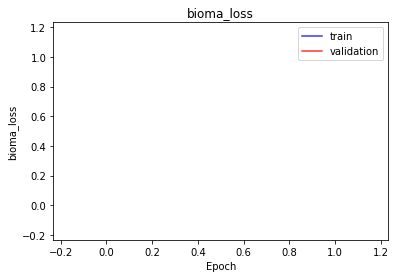

<b>domain_loss</b>: nan (min: nan, max: nan)

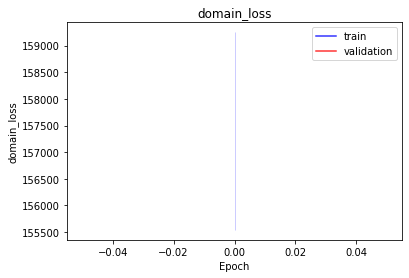

<b>latent_loss</b>: nan (min: nan, max: nan)

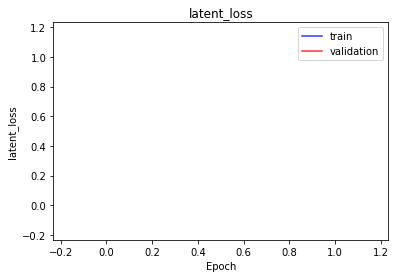

<b>bioma_mse</b>: nan (min: nan, max: nan)

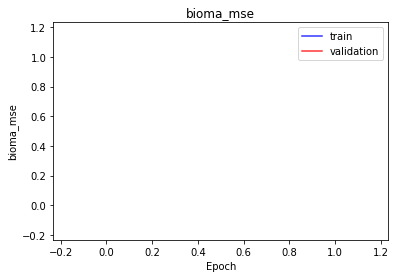

<b>bioma_mae</b>: nan (min: nan, max: nan)

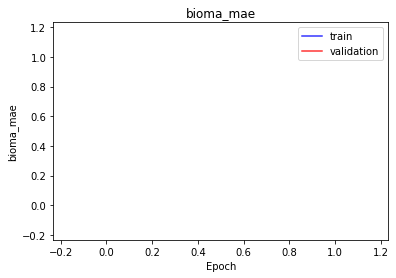

<b>bioma_mape</b>: nan (min: nan, max: nan)

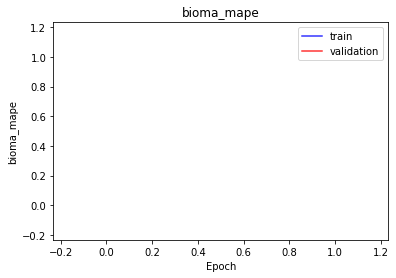

<b>domain_mse</b>: nan (min: nan, max: nan)

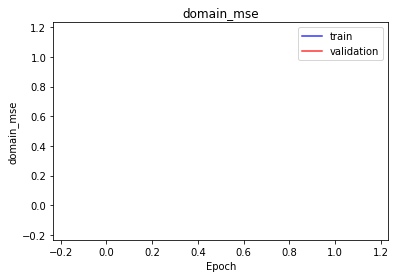

<b>domain_mae</b>: nan (min: nan, max: nan)

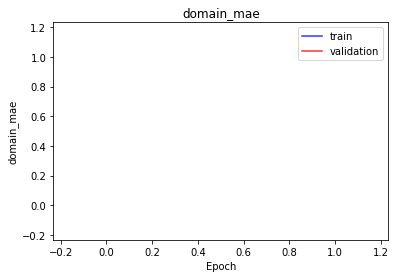

<b>domain_mape</b>: nan (min: nan, max: nan)

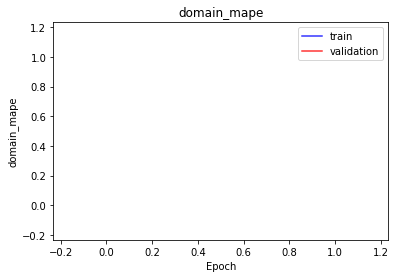

<b>latent_mae</b>: nan (min: nan, max: nan)

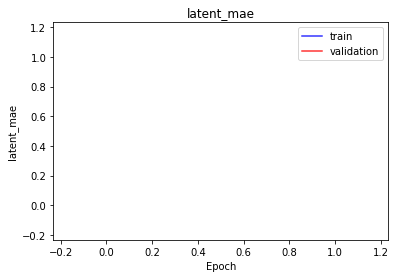

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

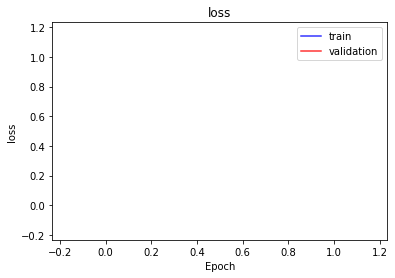

<b>bioma_loss</b>: nan (min: nan, max: nan)

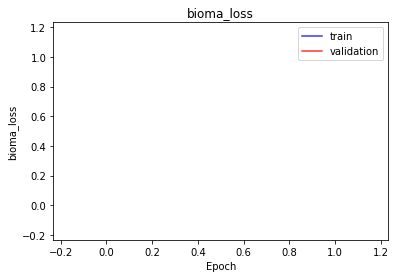

<b>domain_loss</b>: nan (min: nan, max: nan)

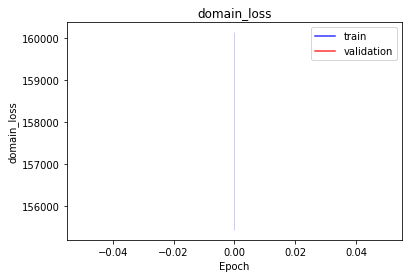

<b>latent_loss</b>: nan (min: nan, max: nan)

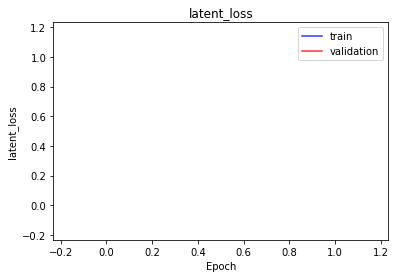

<b>bioma_mse</b>: nan (min: nan, max: nan)

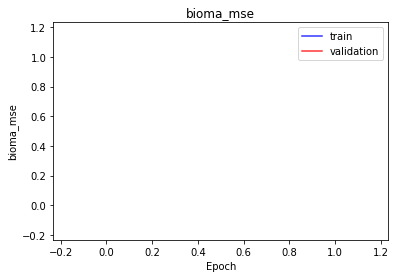

<b>bioma_mae</b>: nan (min: nan, max: nan)

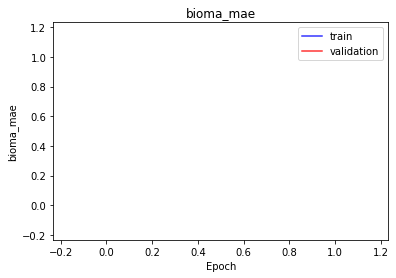

<b>bioma_mape</b>: nan (min: nan, max: nan)

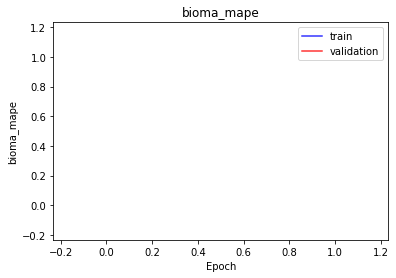

<b>domain_mse</b>: nan (min: nan, max: nan)

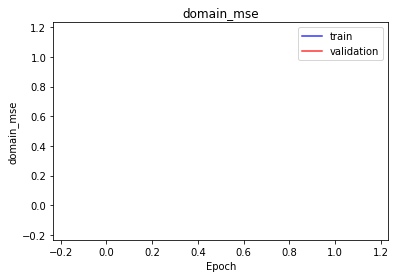

<b>domain_mae</b>: nan (min: nan, max: nan)

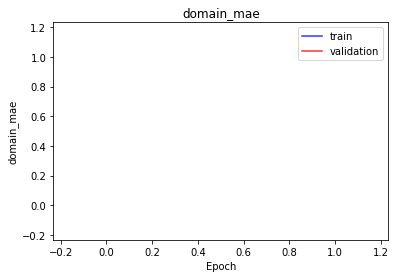

<b>domain_mape</b>: nan (min: nan, max: nan)

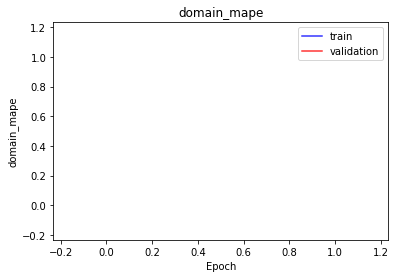

<b>latent_mae</b>: nan (min: nan, max: nan)

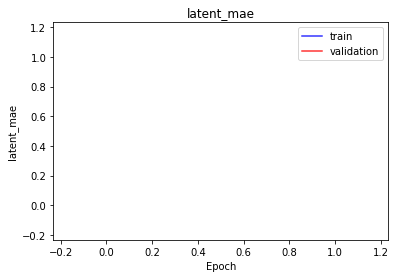

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

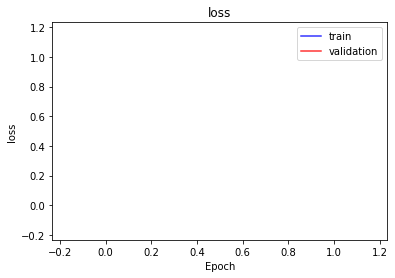

<b>bioma_loss</b>: nan (min: nan, max: nan)

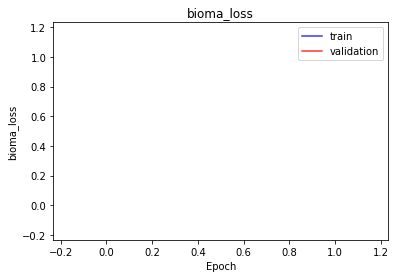

<b>domain_loss</b>: nan (min: nan, max: nan)

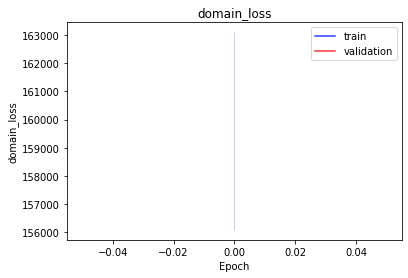

<b>latent_loss</b>: nan (min: nan, max: nan)

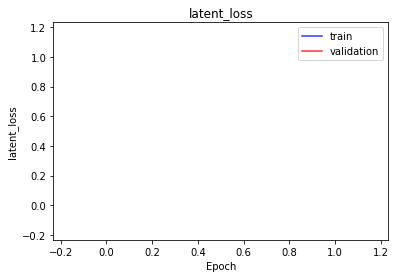

<b>bioma_mse</b>: nan (min: nan, max: nan)

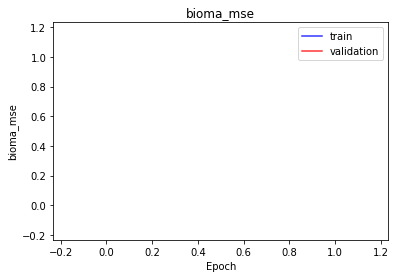

<b>bioma_mae</b>: nan (min: nan, max: nan)

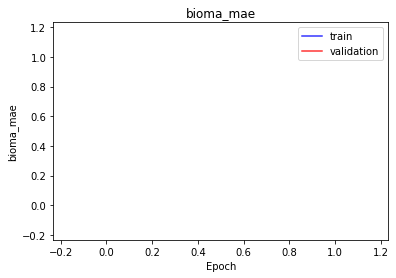

<b>bioma_mape</b>: nan (min: nan, max: nan)

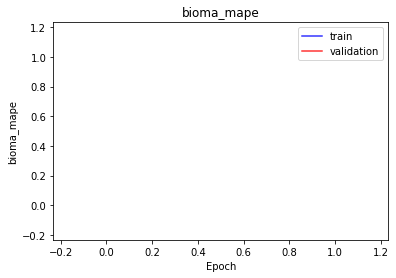

<b>domain_mse</b>: nan (min: nan, max: nan)

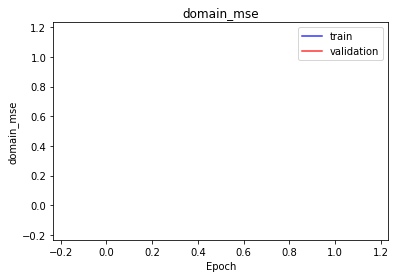

<b>domain_mae</b>: nan (min: nan, max: nan)

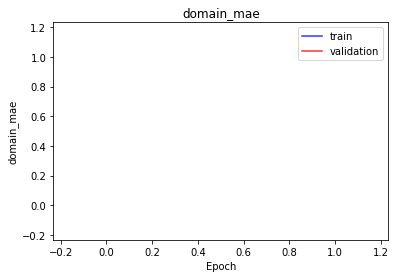

<b>domain_mape</b>: nan (min: nan, max: nan)

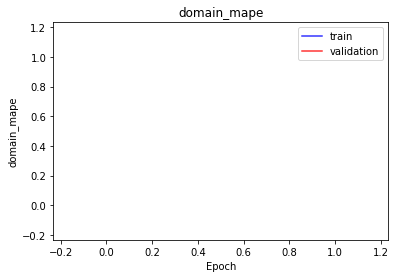

<b>latent_mae</b>: nan (min: nan, max: nan)

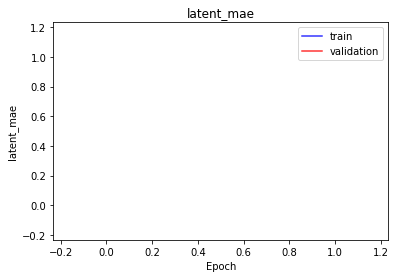

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 256 -> 50 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 50 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

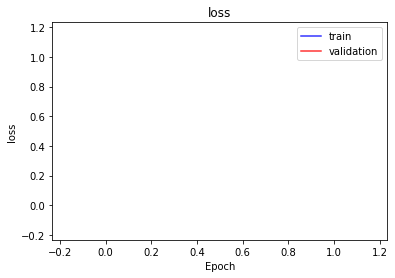

<b>bioma_loss</b>: nan (min: nan, max: nan)

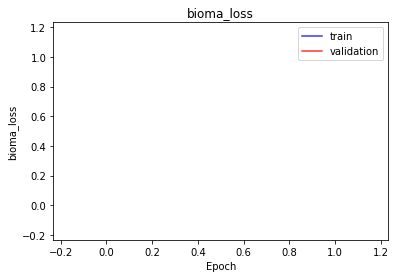

<b>domain_loss</b>: nan (min: nan, max: nan)

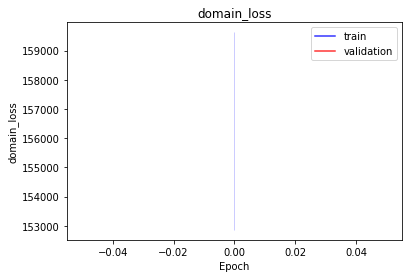

<b>latent_loss</b>: nan (min: nan, max: nan)

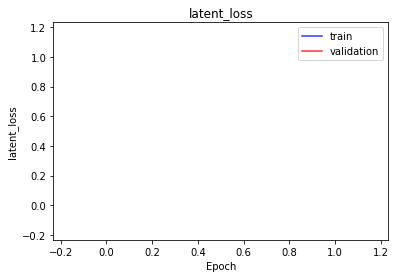

<b>bioma_mse</b>: nan (min: nan, max: nan)

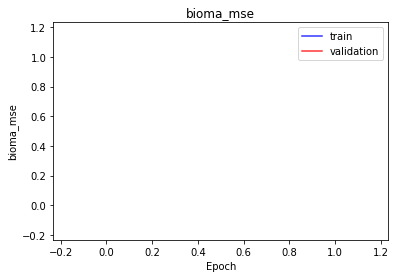

<b>bioma_mae</b>: nan (min: nan, max: nan)

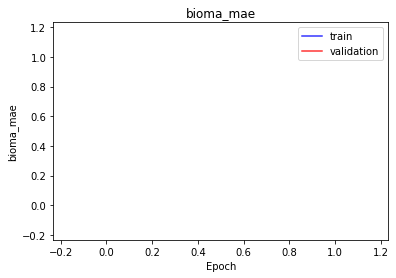

<b>bioma_mape</b>: nan (min: nan, max: nan)

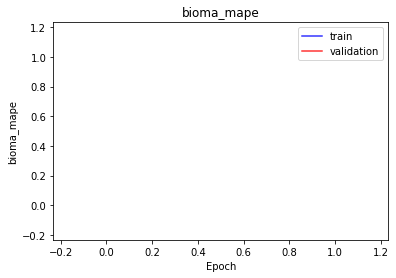

<b>domain_mse</b>: nan (min: nan, max: nan)

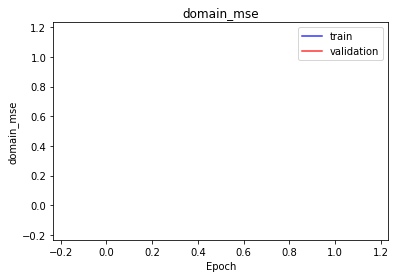

<b>domain_mae</b>: nan (min: nan, max: nan)

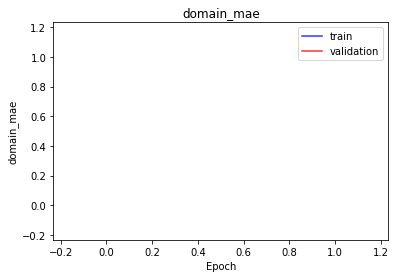

<b>domain_mape</b>: nan (min: nan, max: nan)

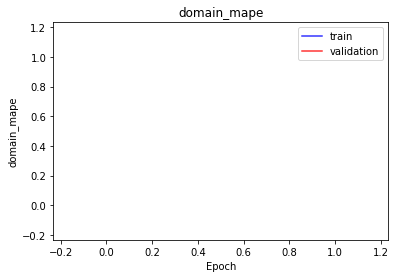

<b>latent_mae</b>: nan (min: nan, max: nan)

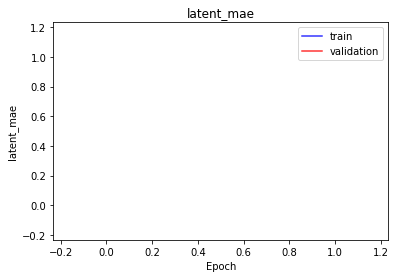

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

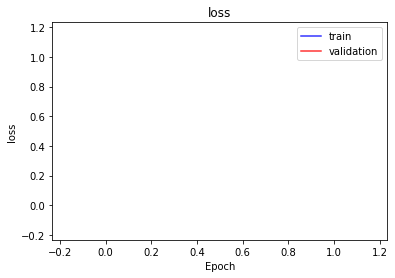

<b>bioma_loss</b>: nan (min: nan, max: nan)

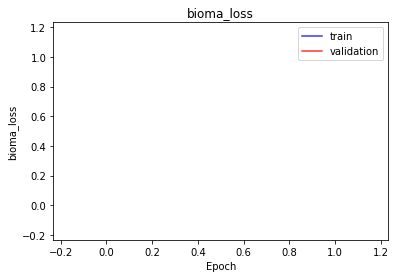

<b>domain_loss</b>: nan (min: nan, max: nan)

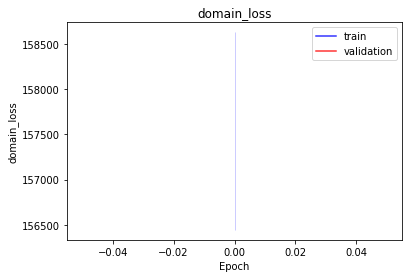

<b>latent_loss</b>: nan (min: nan, max: nan)

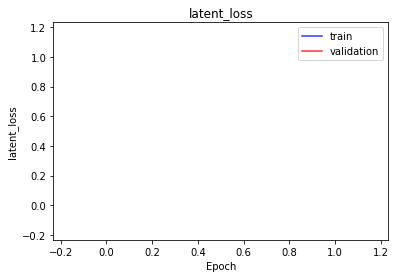

<b>bioma_mse</b>: nan (min: nan, max: nan)

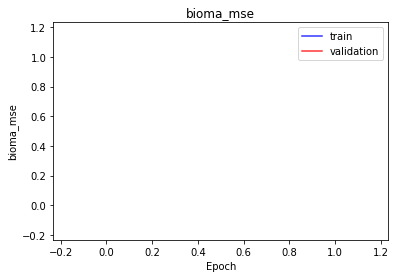

<b>bioma_mae</b>: nan (min: nan, max: nan)

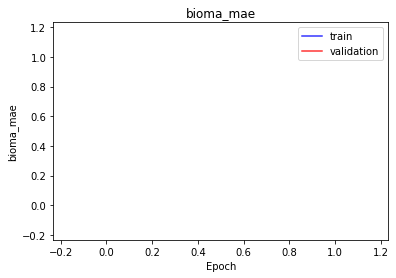

<b>bioma_mape</b>: nan (min: nan, max: nan)

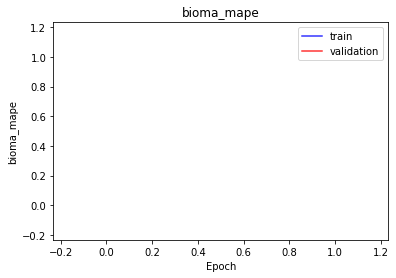

<b>domain_mse</b>: nan (min: nan, max: nan)

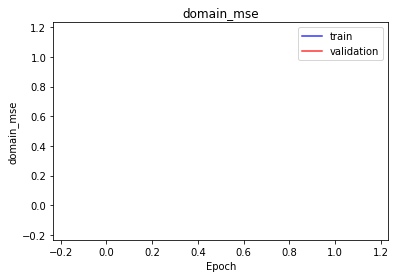

<b>domain_mae</b>: nan (min: nan, max: nan)

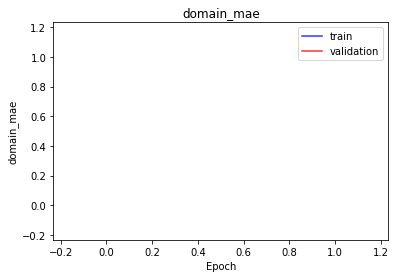

<b>domain_mape</b>: nan (min: nan, max: nan)

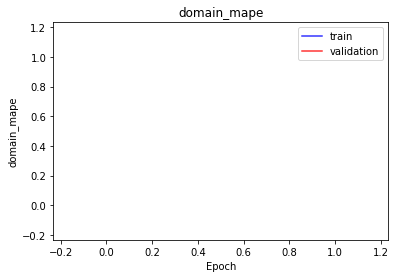

<b>latent_mae</b>: nan (min: nan, max: nan)

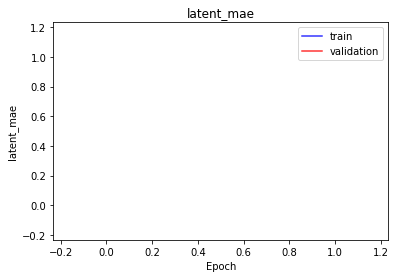

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

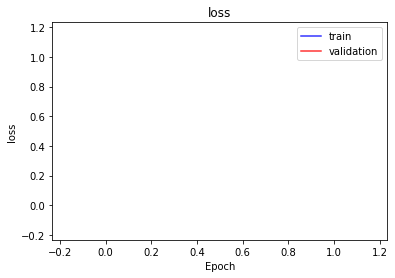

<b>bioma_loss</b>: nan (min: nan, max: nan)

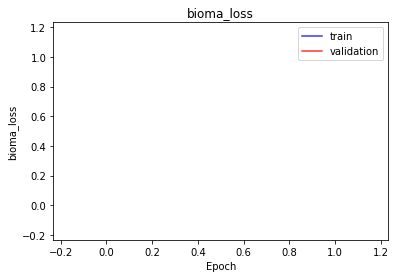

<b>domain_loss</b>: nan (min: nan, max: nan)

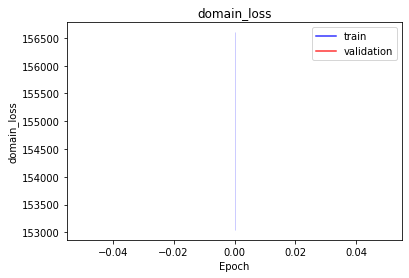

<b>latent_loss</b>: nan (min: nan, max: nan)

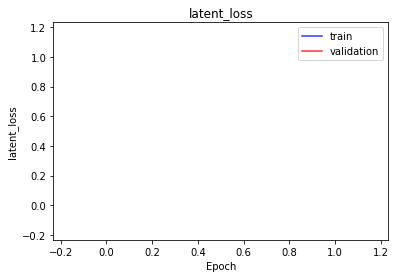

<b>bioma_mse</b>: nan (min: nan, max: nan)

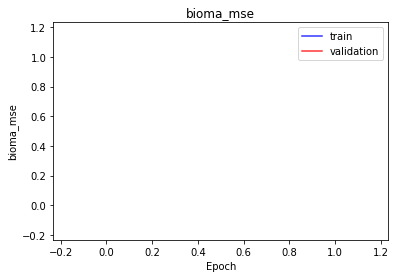

<b>bioma_mae</b>: nan (min: nan, max: nan)

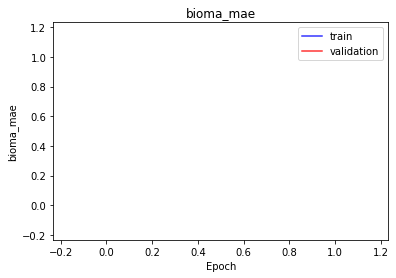

<b>bioma_mape</b>: nan (min: nan, max: nan)

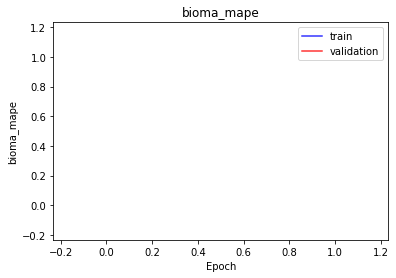

<b>domain_mse</b>: nan (min: nan, max: nan)

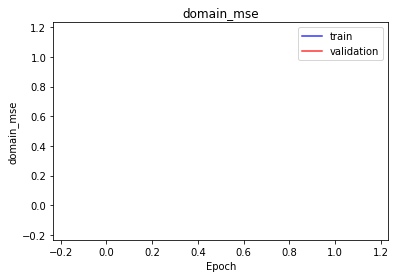

<b>domain_mae</b>: nan (min: nan, max: nan)

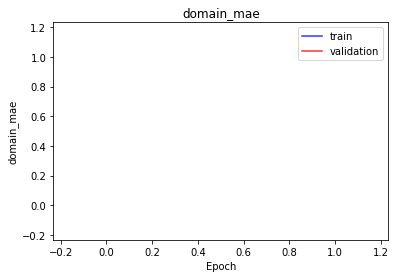

<b>domain_mape</b>: nan (min: nan, max: nan)

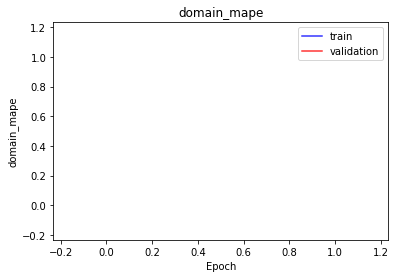

<b>latent_mae</b>: nan (min: nan, max: nan)

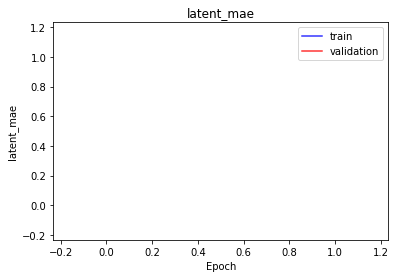

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

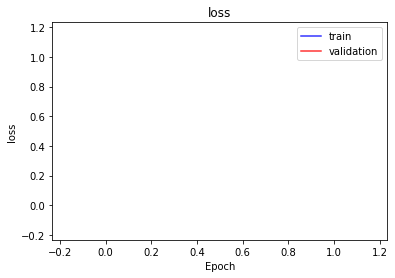

<b>bioma_loss</b>: nan (min: nan, max: nan)

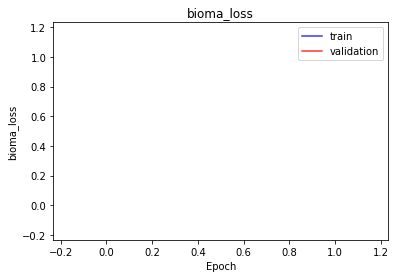

<b>domain_loss</b>: nan (min: nan, max: nan)

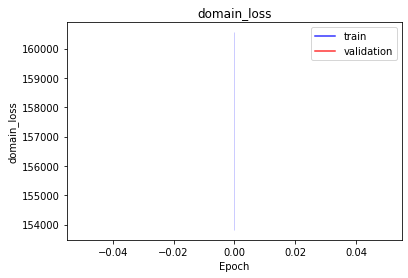

<b>latent_loss</b>: nan (min: nan, max: nan)

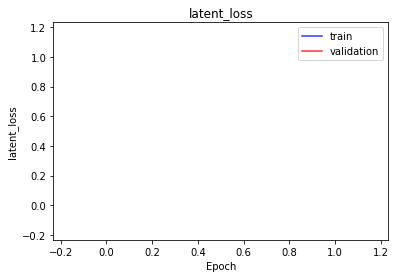

<b>bioma_mse</b>: nan (min: nan, max: nan)

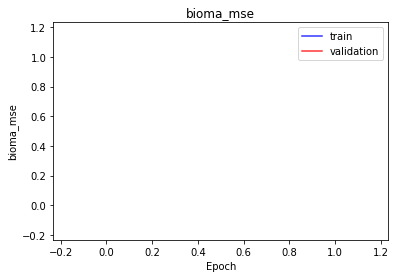

<b>bioma_mae</b>: nan (min: nan, max: nan)

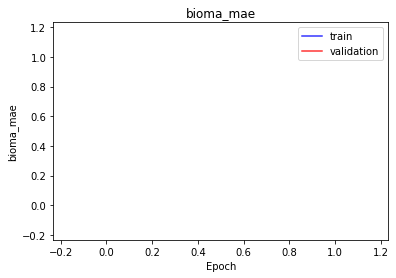

<b>bioma_mape</b>: nan (min: nan, max: nan)

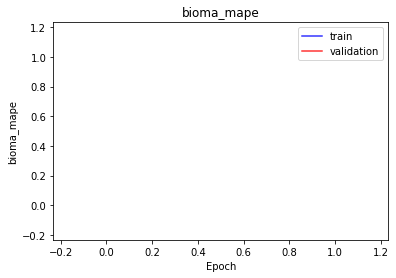

<b>domain_mse</b>: nan (min: nan, max: nan)

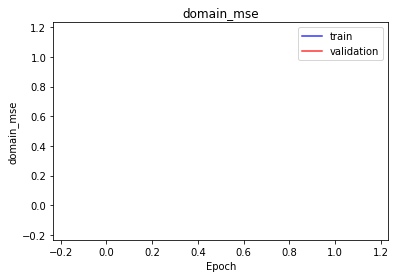

<b>domain_mae</b>: nan (min: nan, max: nan)

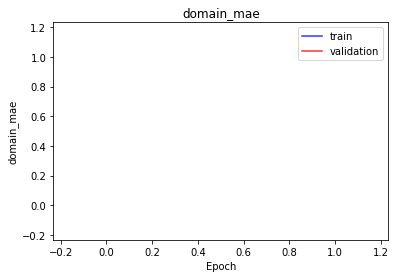

<b>domain_mape</b>: nan (min: nan, max: nan)

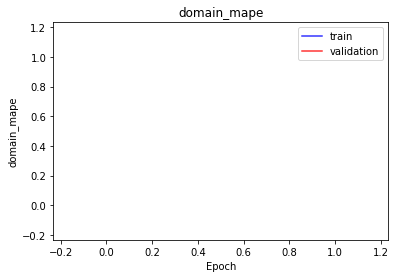

<b>latent_mae</b>: nan (min: nan, max: nan)

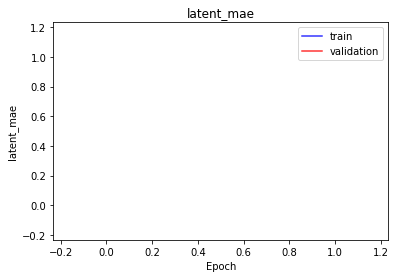

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

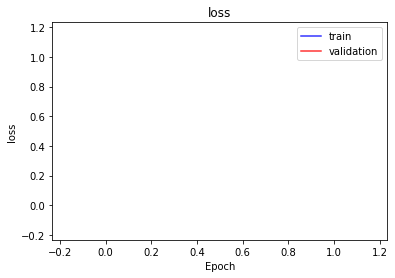

<b>bioma_loss</b>: nan (min: nan, max: nan)

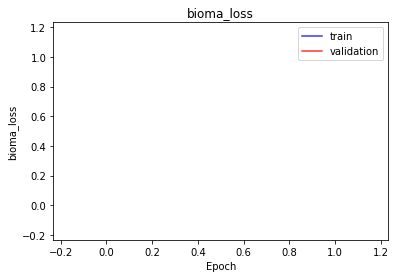

<b>domain_loss</b>: nan (min: nan, max: nan)

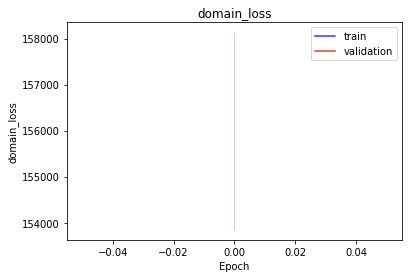

<b>latent_loss</b>: nan (min: nan, max: nan)

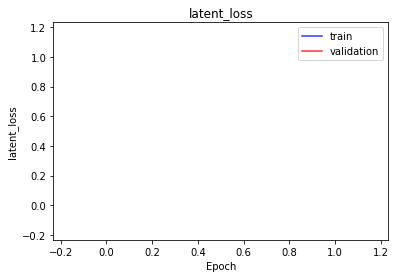

<b>bioma_mse</b>: nan (min: nan, max: nan)

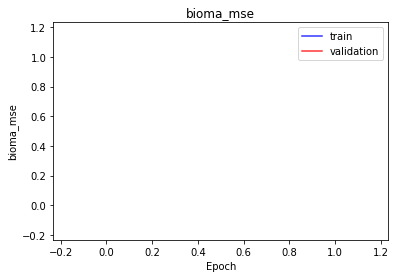

<b>bioma_mae</b>: nan (min: nan, max: nan)

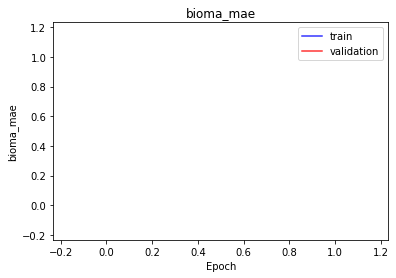

<b>bioma_mape</b>: nan (min: nan, max: nan)

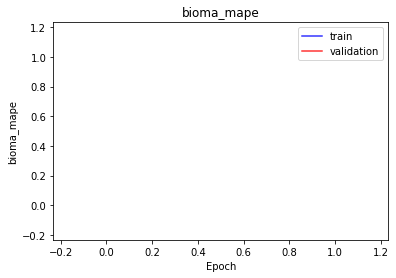

<b>domain_mse</b>: nan (min: nan, max: nan)

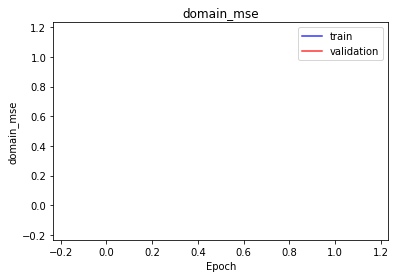

<b>domain_mae</b>: nan (min: nan, max: nan)

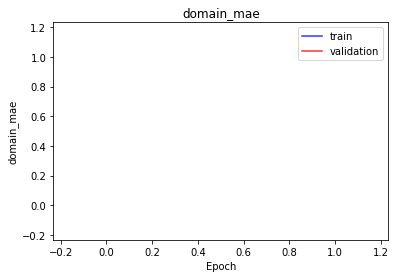

<b>domain_mape</b>: nan (min: nan, max: nan)

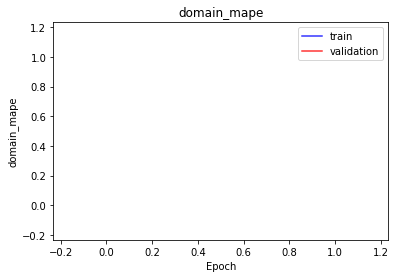

<b>latent_mae</b>: nan (min: nan, max: nan)

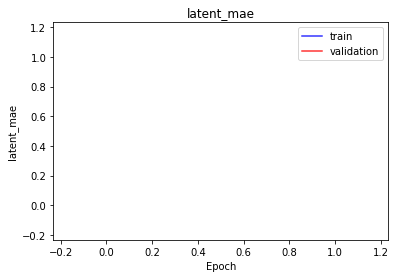

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

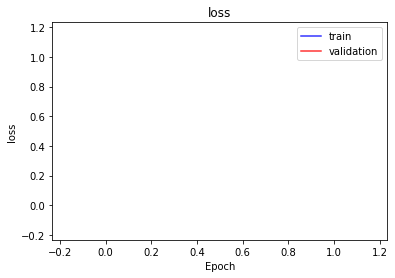

<b>bioma_loss</b>: nan (min: nan, max: nan)

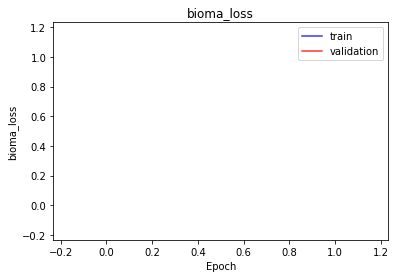

<b>domain_loss</b>: nan (min: nan, max: nan)

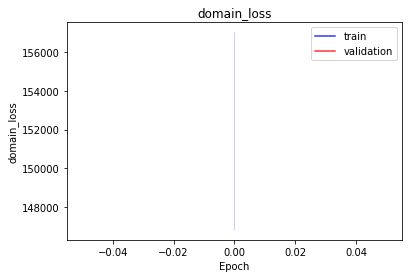

<b>latent_loss</b>: nan (min: nan, max: nan)

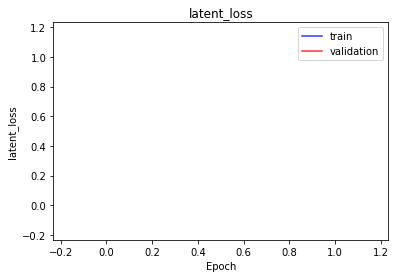

<b>bioma_mse</b>: nan (min: nan, max: nan)

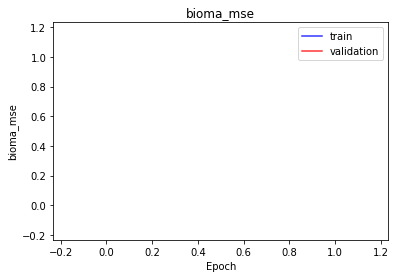

<b>bioma_mae</b>: nan (min: nan, max: nan)

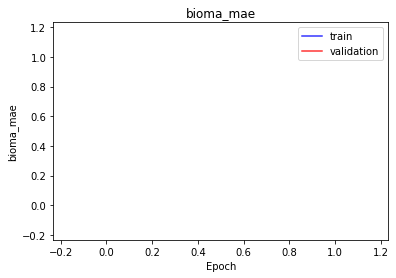

<b>bioma_mape</b>: nan (min: nan, max: nan)

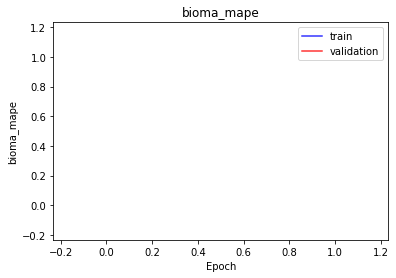

<b>domain_mse</b>: nan (min: nan, max: nan)

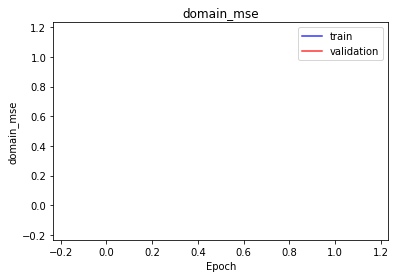

<b>domain_mae</b>: nan (min: nan, max: nan)

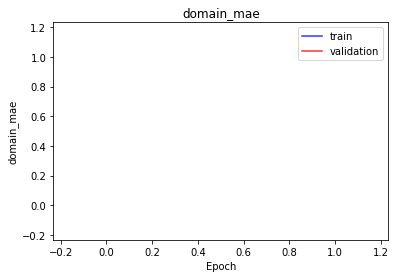

<b>domain_mape</b>: nan (min: nan, max: nan)

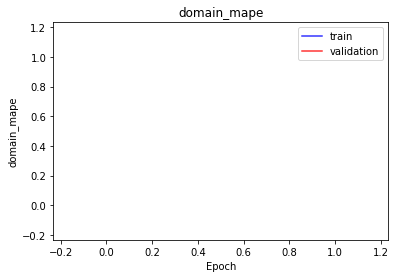

<b>latent_mae</b>: nan (min: nan, max: nan)

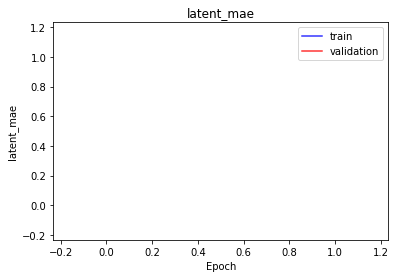

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 50 |
| Bioma Autoencoder | b -> 50 -> b |
| Domain Autoencoder | d -> 50 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

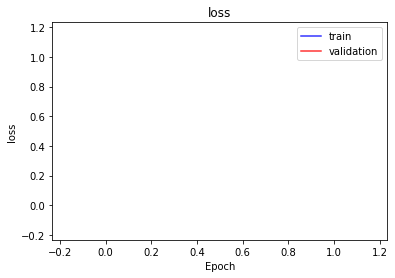

<b>bioma_loss</b>: nan (min: nan, max: nan)

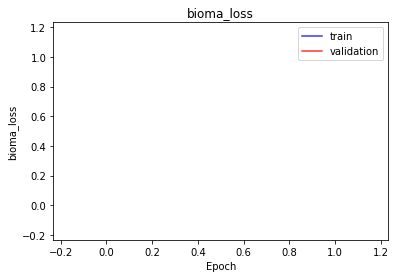

<b>domain_loss</b>: nan (min: nan, max: nan)

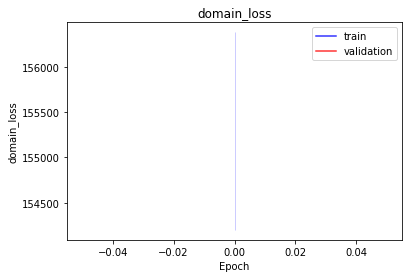

<b>latent_loss</b>: nan (min: nan, max: nan)

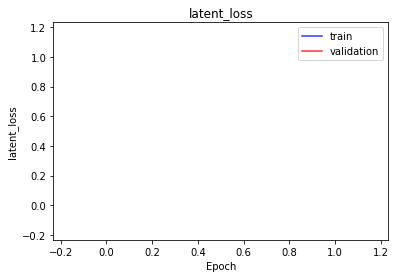

<b>bioma_mse</b>: nan (min: nan, max: nan)

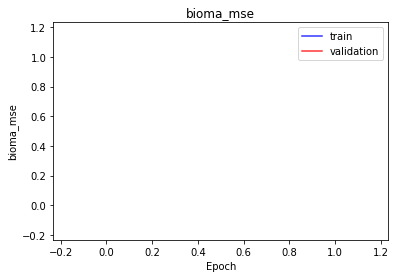

<b>bioma_mae</b>: nan (min: nan, max: nan)

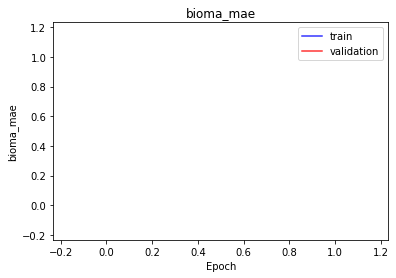

<b>bioma_mape</b>: nan (min: nan, max: nan)

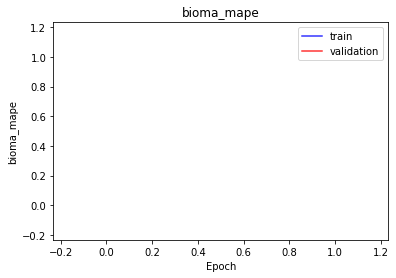

<b>domain_mse</b>: nan (min: nan, max: nan)

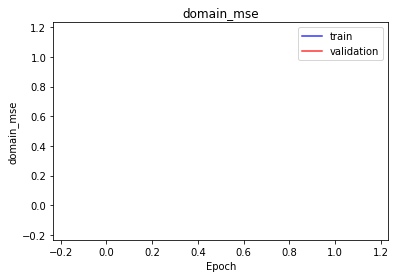

<b>domain_mae</b>: nan (min: nan, max: nan)

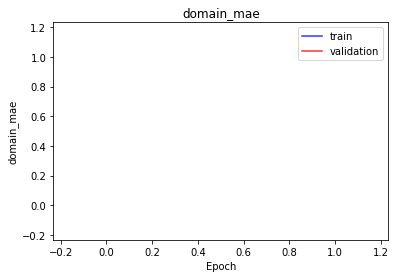

<b>domain_mape</b>: nan (min: nan, max: nan)

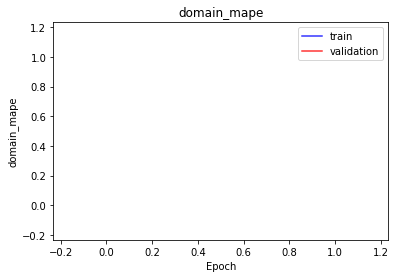

<b>latent_mae</b>: nan (min: nan, max: nan)

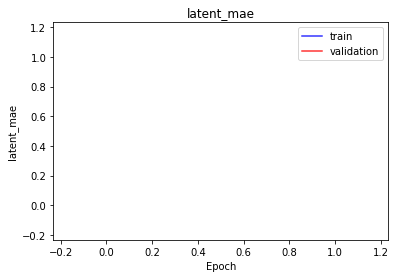

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

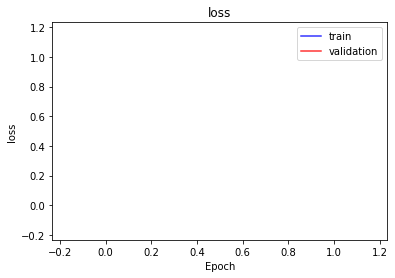

<b>bioma_loss</b>: nan (min: nan, max: nan)

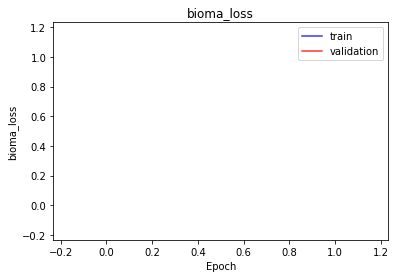

<b>domain_loss</b>: nan (min: nan, max: nan)

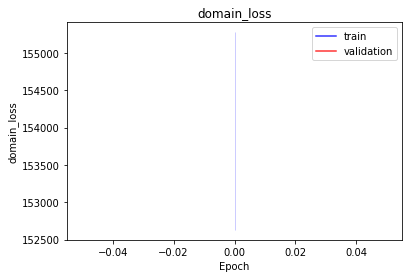

<b>latent_loss</b>: nan (min: nan, max: nan)

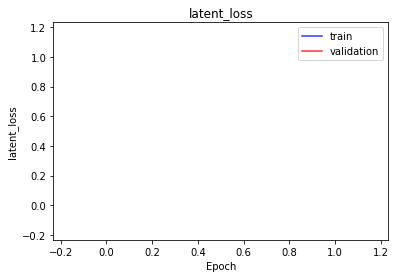

<b>bioma_mse</b>: nan (min: nan, max: nan)

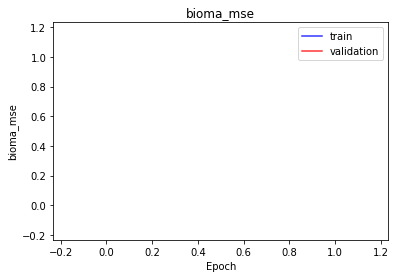

<b>bioma_mae</b>: nan (min: nan, max: nan)

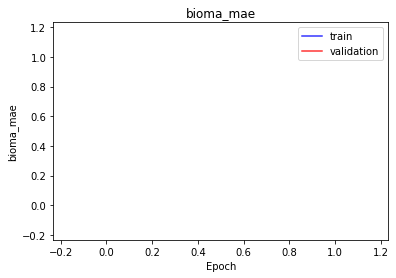

<b>bioma_mape</b>: nan (min: nan, max: nan)

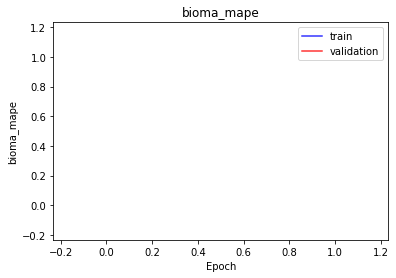

<b>domain_mse</b>: nan (min: nan, max: nan)

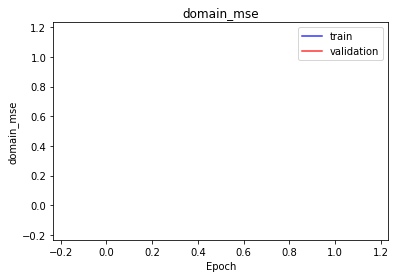

<b>domain_mae</b>: nan (min: nan, max: nan)

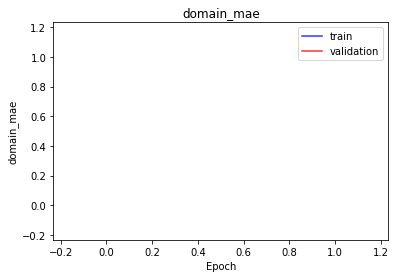

<b>domain_mape</b>: nan (min: nan, max: nan)

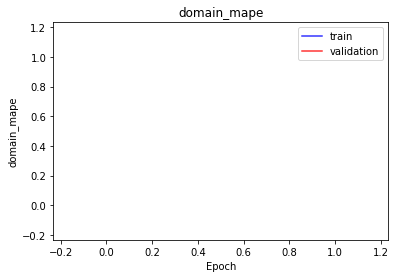

<b>latent_mae</b>: nan (min: nan, max: nan)

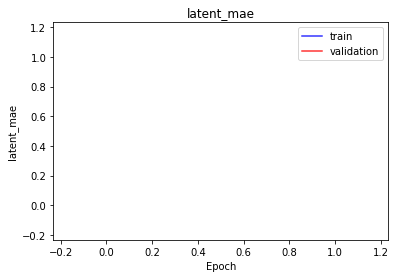

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

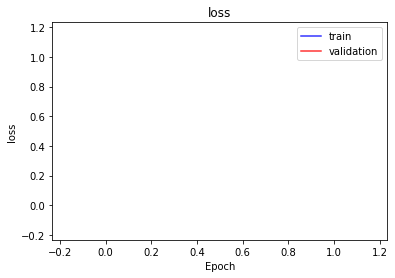

<b>bioma_loss</b>: nan (min: nan, max: nan)

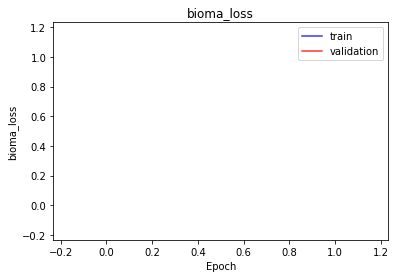

<b>domain_loss</b>: nan (min: nan, max: nan)

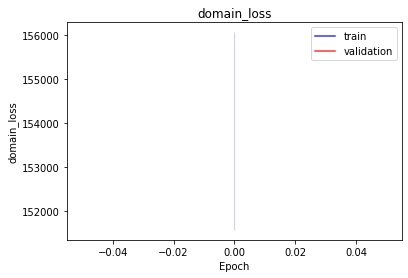

<b>latent_loss</b>: nan (min: nan, max: nan)

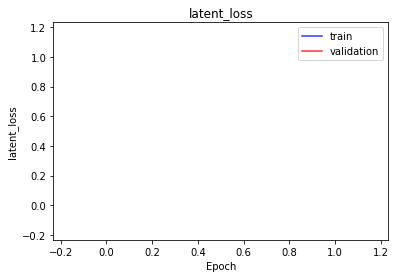

<b>bioma_mse</b>: nan (min: nan, max: nan)

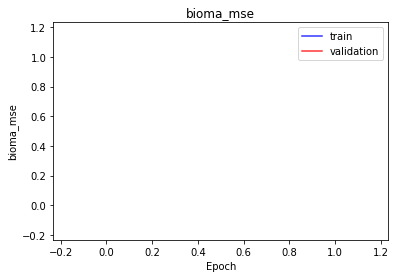

<b>bioma_mae</b>: nan (min: nan, max: nan)

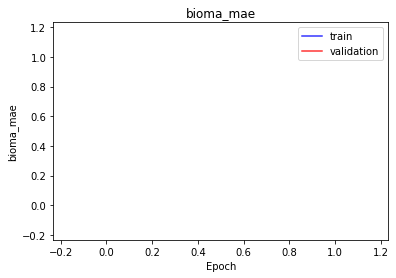

<b>bioma_mape</b>: nan (min: nan, max: nan)

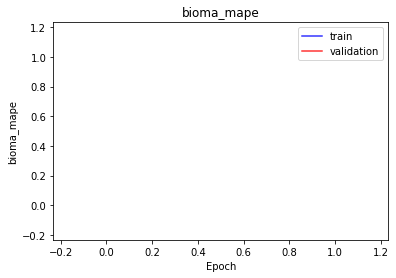

<b>domain_mse</b>: nan (min: nan, max: nan)

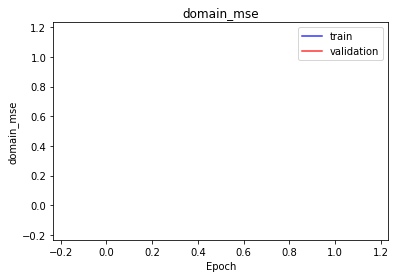

<b>domain_mae</b>: nan (min: nan, max: nan)

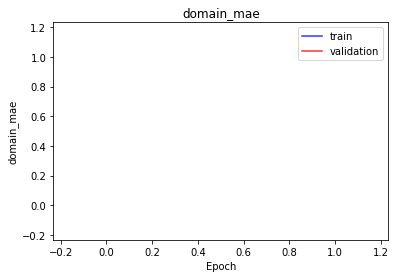

<b>domain_mape</b>: nan (min: nan, max: nan)

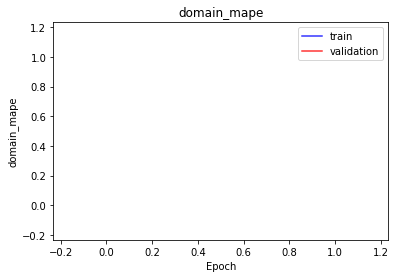

<b>latent_mae</b>: nan (min: nan, max: nan)

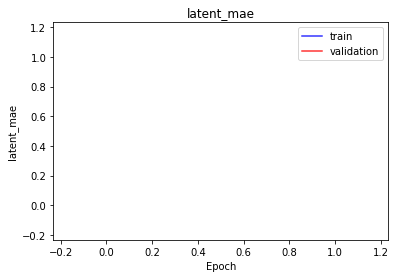

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

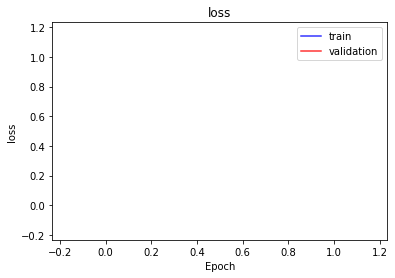

<b>bioma_loss</b>: nan (min: nan, max: nan)

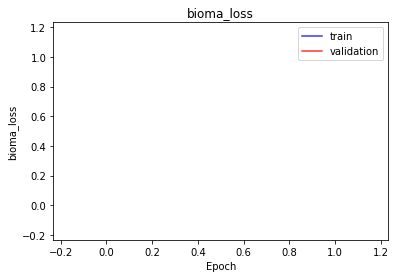

<b>domain_loss</b>: nan (min: nan, max: nan)

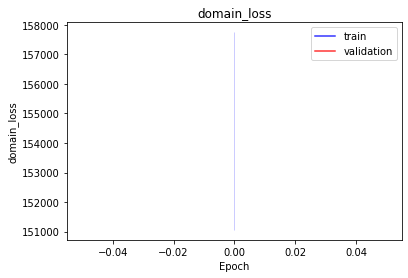

<b>latent_loss</b>: nan (min: nan, max: nan)

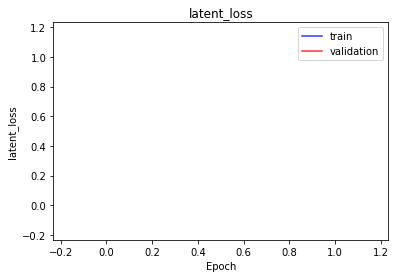

<b>bioma_mse</b>: nan (min: nan, max: nan)

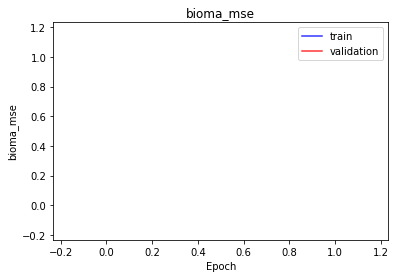

<b>bioma_mae</b>: nan (min: nan, max: nan)

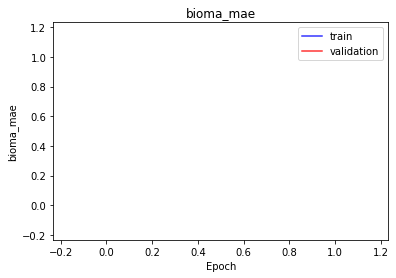

<b>bioma_mape</b>: nan (min: nan, max: nan)

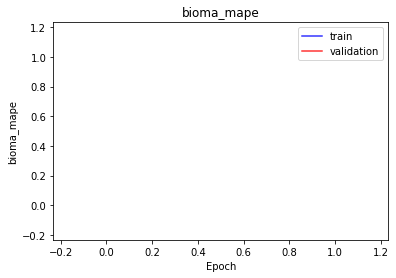

<b>domain_mse</b>: nan (min: nan, max: nan)

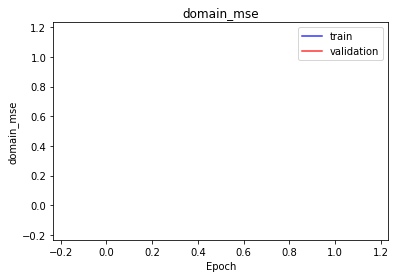

<b>domain_mae</b>: nan (min: nan, max: nan)

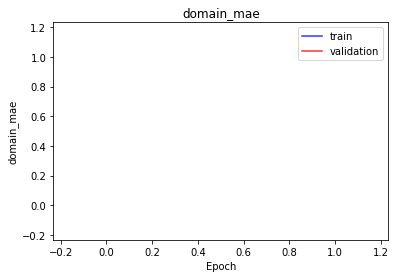

<b>domain_mape</b>: nan (min: nan, max: nan)

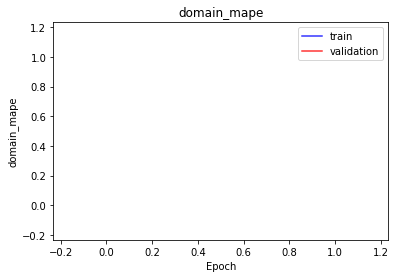

<b>latent_mae</b>: nan (min: nan, max: nan)

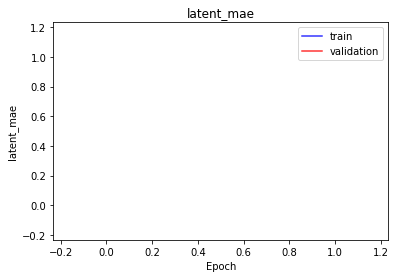

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

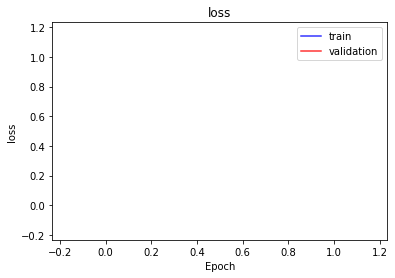

<b>bioma_loss</b>: nan (min: nan, max: nan)

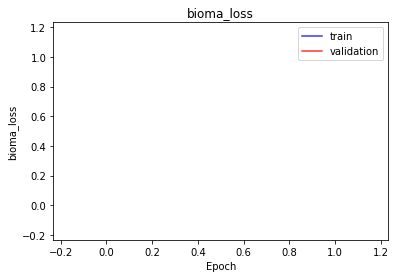

<b>domain_loss</b>: nan (min: nan, max: nan)

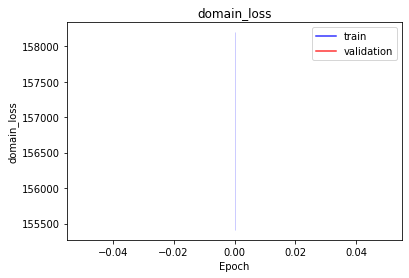

<b>latent_loss</b>: nan (min: nan, max: nan)

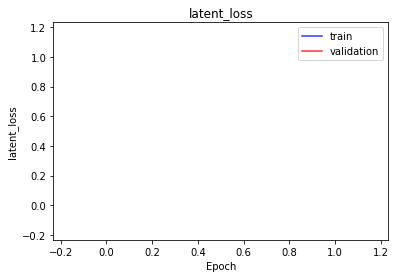

<b>bioma_mse</b>: nan (min: nan, max: nan)

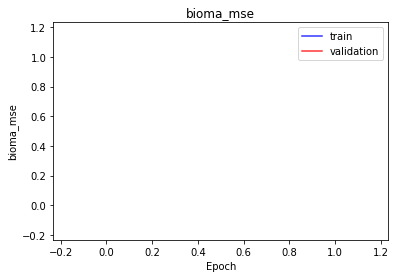

<b>bioma_mae</b>: nan (min: nan, max: nan)

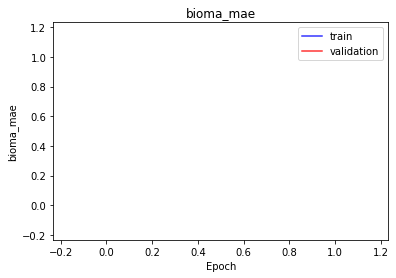

<b>bioma_mape</b>: nan (min: nan, max: nan)

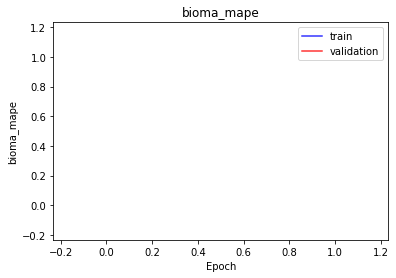

<b>domain_mse</b>: nan (min: nan, max: nan)

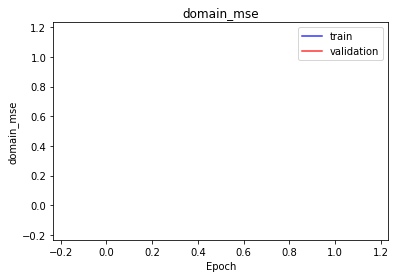

<b>domain_mae</b>: nan (min: nan, max: nan)

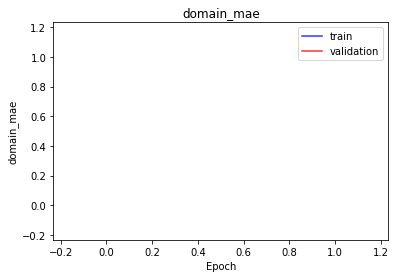

<b>domain_mape</b>: nan (min: nan, max: nan)

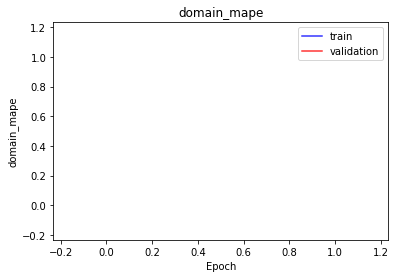

<b>latent_mae</b>: nan (min: nan, max: nan)

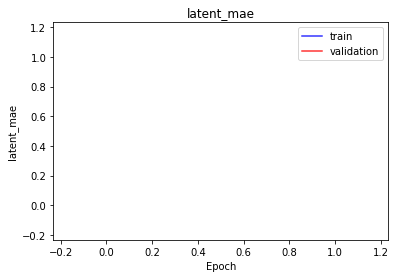

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

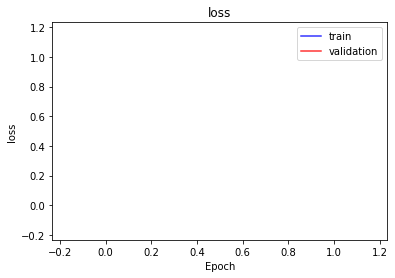

<b>bioma_loss</b>: nan (min: nan, max: nan)

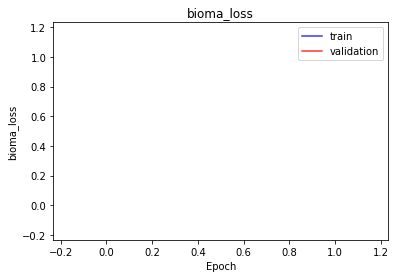

<b>domain_loss</b>: nan (min: nan, max: nan)

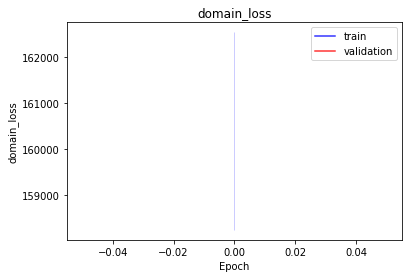

<b>latent_loss</b>: nan (min: nan, max: nan)

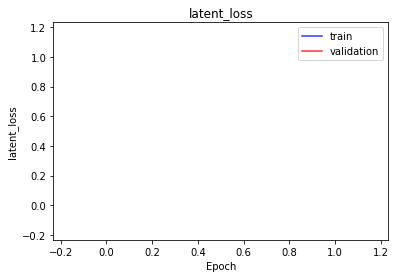

<b>bioma_mse</b>: nan (min: nan, max: nan)

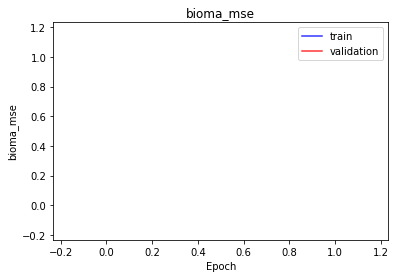

<b>bioma_mae</b>: nan (min: nan, max: nan)

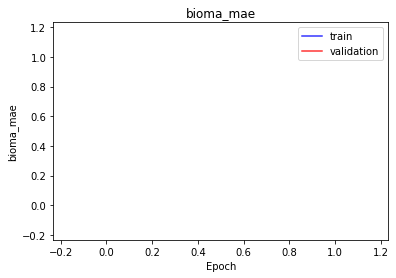

<b>bioma_mape</b>: nan (min: nan, max: nan)

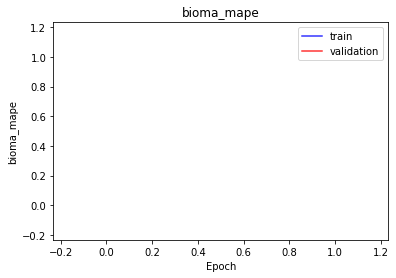

<b>domain_mse</b>: nan (min: nan, max: nan)

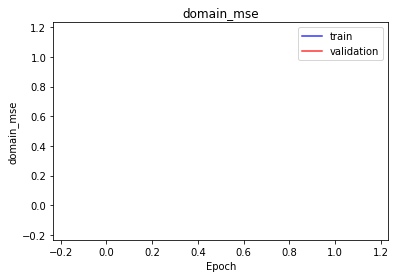

<b>domain_mae</b>: nan (min: nan, max: nan)

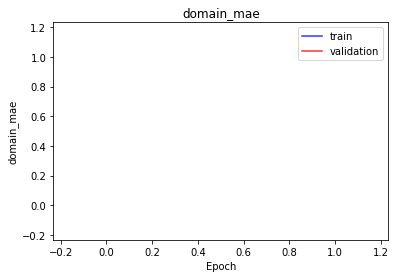

<b>domain_mape</b>: nan (min: nan, max: nan)

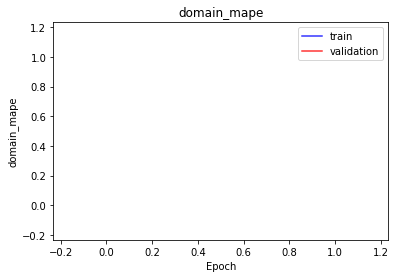

<b>latent_mae</b>: nan (min: nan, max: nan)

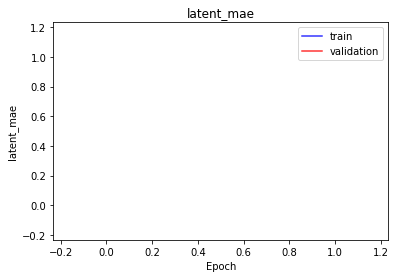

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b |
| Domain Autoencoder | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

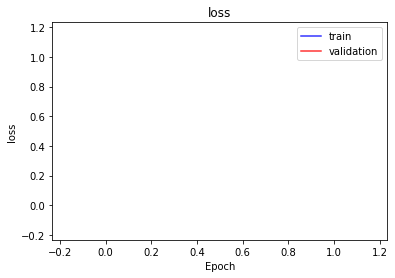

<b>bioma_loss</b>: nan (min: nan, max: nan)

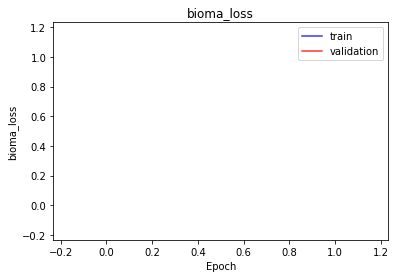

<b>domain_loss</b>: nan (min: nan, max: nan)

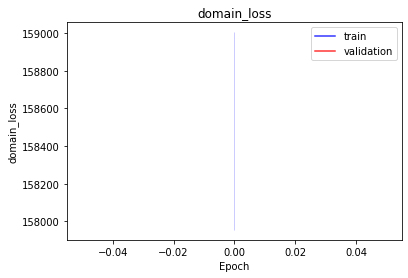

<b>latent_loss</b>: nan (min: nan, max: nan)

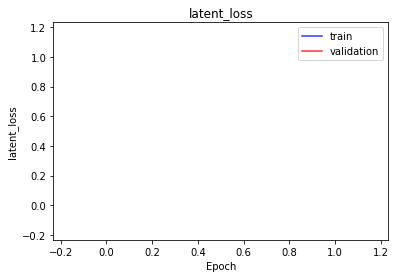

<b>bioma_mse</b>: nan (min: nan, max: nan)

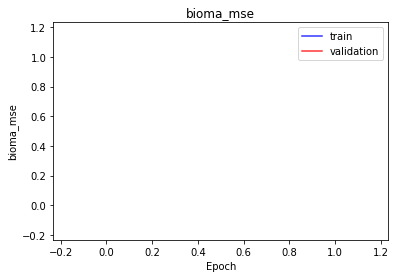

<b>bioma_mae</b>: nan (min: nan, max: nan)

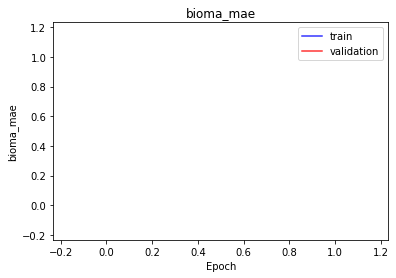

<b>bioma_mape</b>: nan (min: nan, max: nan)

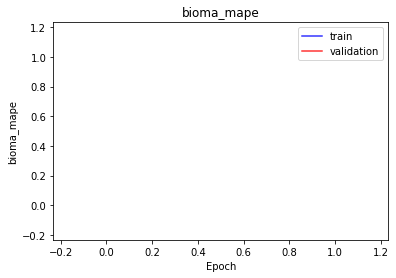

<b>domain_mse</b>: nan (min: nan, max: nan)

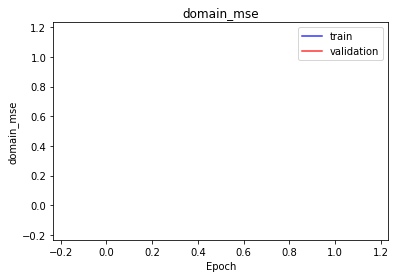

<b>domain_mae</b>: nan (min: nan, max: nan)

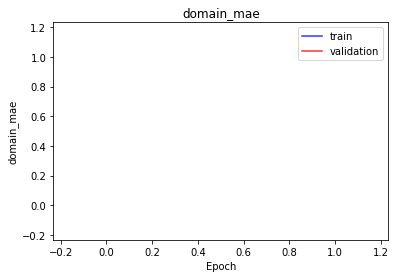

<b>domain_mape</b>: nan (min: nan, max: nan)

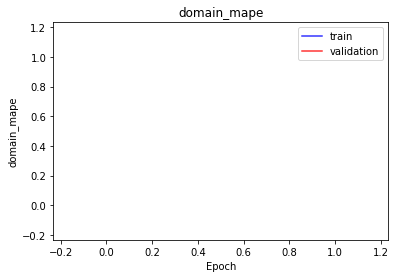

<b>latent_mae</b>: nan (min: nan, max: nan)

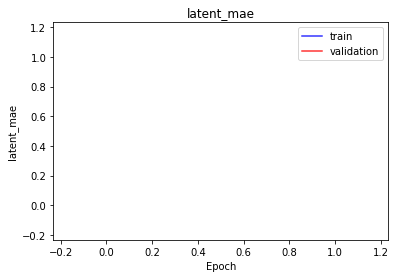

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

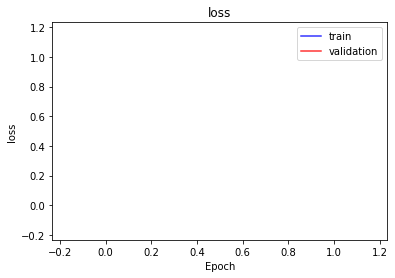

<b>bioma_loss</b>: nan (min: nan, max: nan)

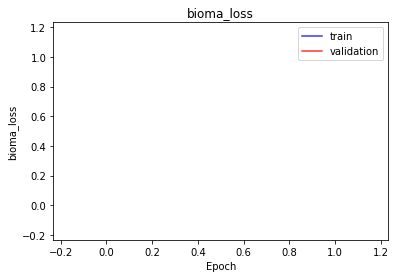

<b>domain_loss</b>: nan (min: nan, max: nan)

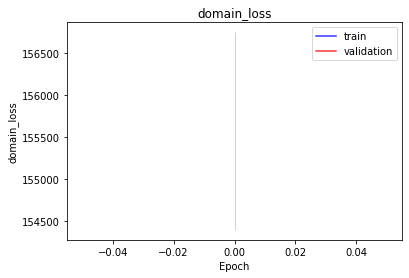

<b>latent_loss</b>: nan (min: nan, max: nan)

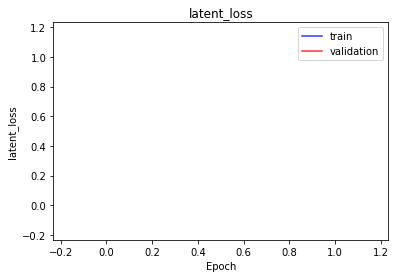

<b>bioma_mse</b>: nan (min: nan, max: nan)

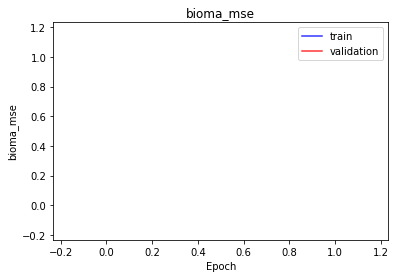

<b>bioma_mae</b>: nan (min: nan, max: nan)

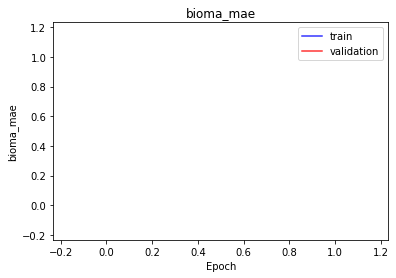

<b>bioma_mape</b>: nan (min: nan, max: nan)

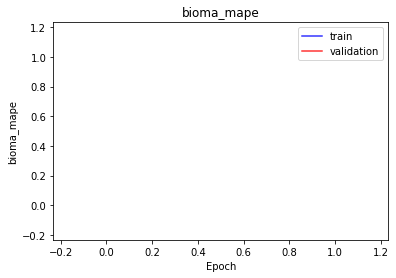

<b>domain_mse</b>: nan (min: nan, max: nan)

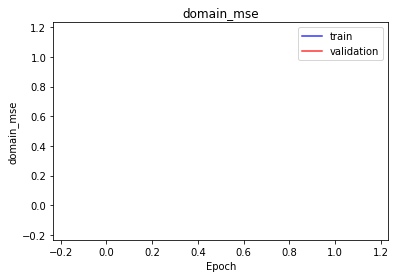

<b>domain_mae</b>: nan (min: nan, max: nan)

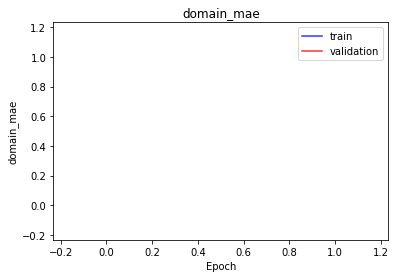

<b>domain_mape</b>: nan (min: nan, max: nan)

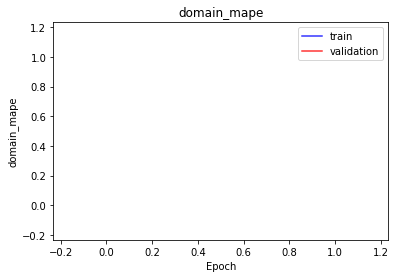

<b>latent_mae</b>: nan (min: nan, max: nan)

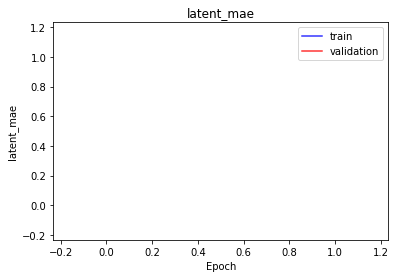

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

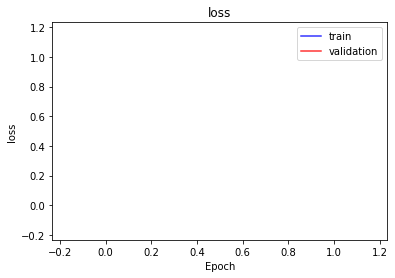

<b>bioma_loss</b>: nan (min: nan, max: nan)

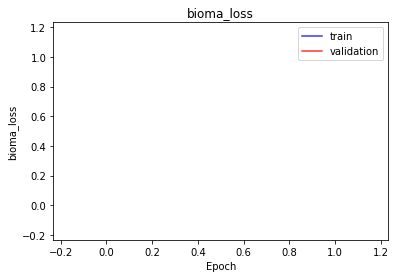

<b>domain_loss</b>: nan (min: nan, max: nan)

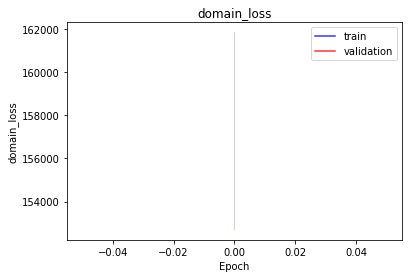

<b>latent_loss</b>: nan (min: nan, max: nan)

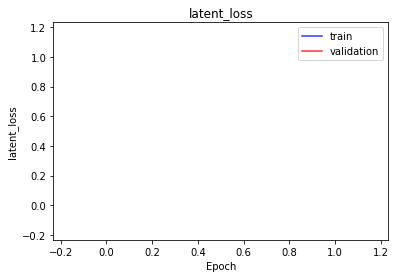

<b>bioma_mse</b>: nan (min: nan, max: nan)

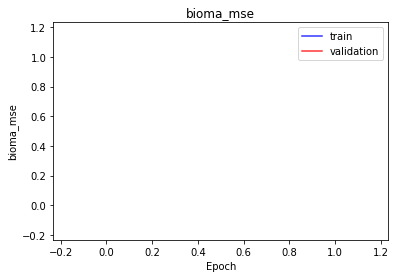

<b>bioma_mae</b>: nan (min: nan, max: nan)

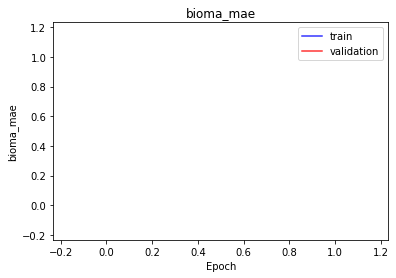

<b>bioma_mape</b>: nan (min: nan, max: nan)

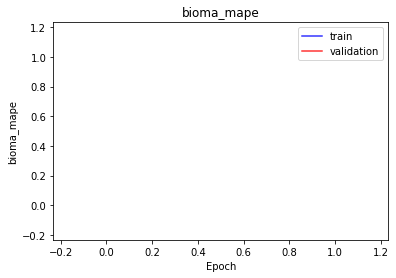

<b>domain_mse</b>: nan (min: nan, max: nan)

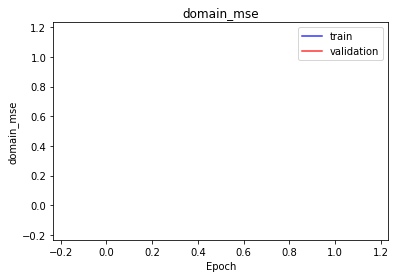

<b>domain_mae</b>: nan (min: nan, max: nan)

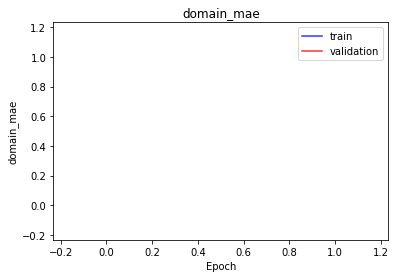

<b>domain_mape</b>: nan (min: nan, max: nan)

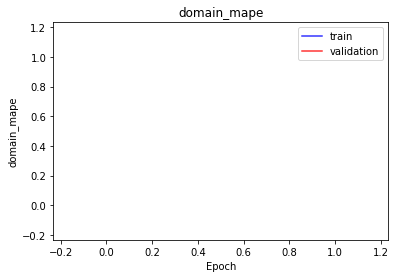

<b>latent_mae</b>: nan (min: nan, max: nan)

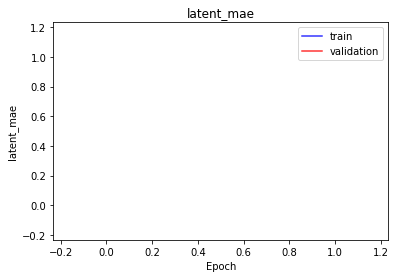

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

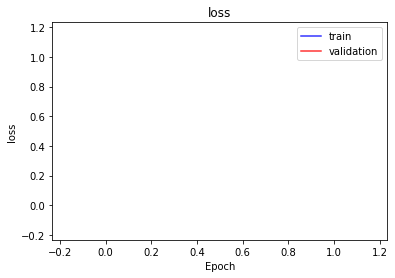

<b>bioma_loss</b>: nan (min: nan, max: nan)

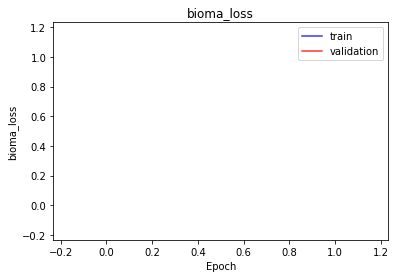

<b>domain_loss</b>: nan (min: nan, max: nan)

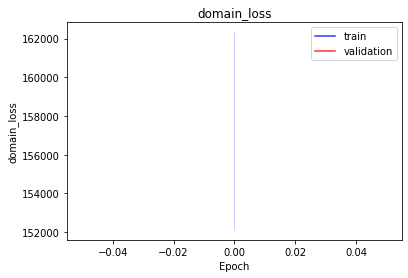

<b>latent_loss</b>: nan (min: nan, max: nan)

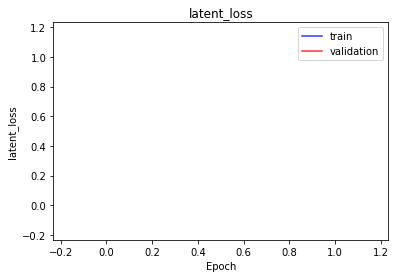

<b>bioma_mse</b>: nan (min: nan, max: nan)

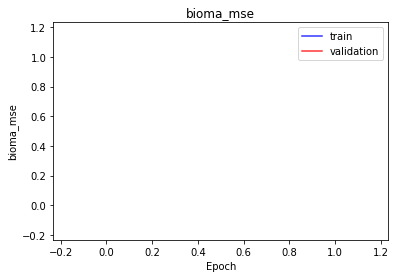

<b>bioma_mae</b>: nan (min: nan, max: nan)

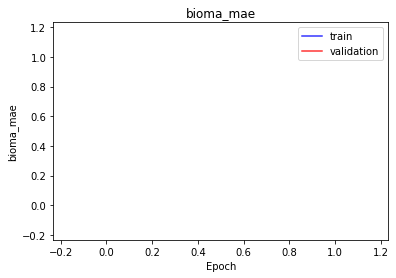

<b>bioma_mape</b>: nan (min: nan, max: nan)

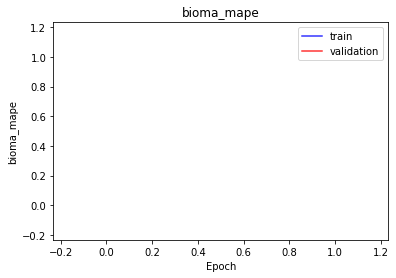

<b>domain_mse</b>: nan (min: nan, max: nan)

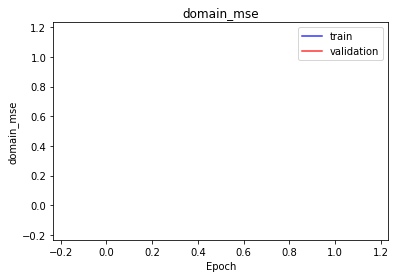

<b>domain_mae</b>: nan (min: nan, max: nan)

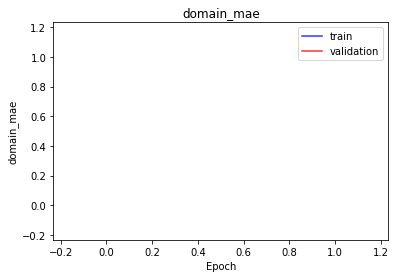

<b>domain_mape</b>: nan (min: nan, max: nan)

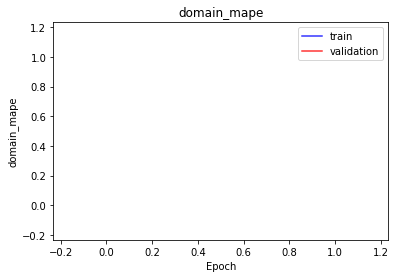

<b>latent_mae</b>: nan (min: nan, max: nan)

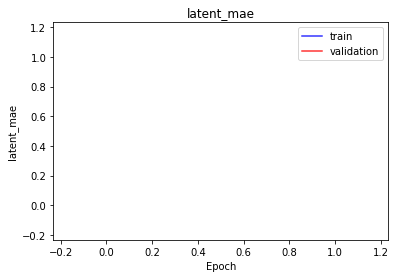

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

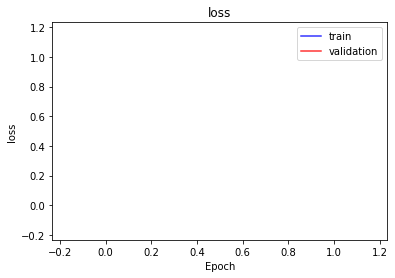

<b>bioma_loss</b>: nan (min: nan, max: nan)

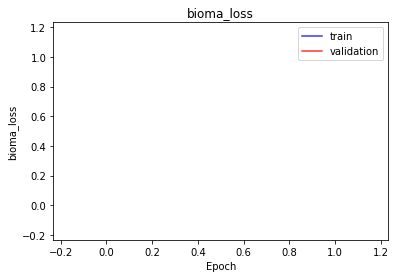

<b>domain_loss</b>: nan (min: nan, max: nan)

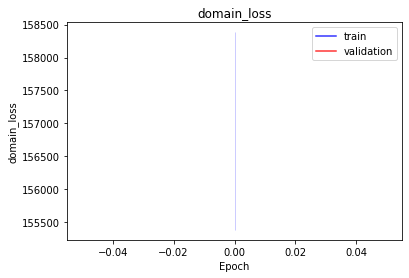

<b>latent_loss</b>: nan (min: nan, max: nan)

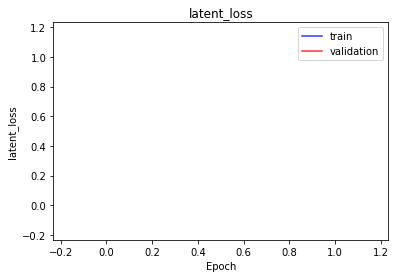

<b>bioma_mse</b>: nan (min: nan, max: nan)

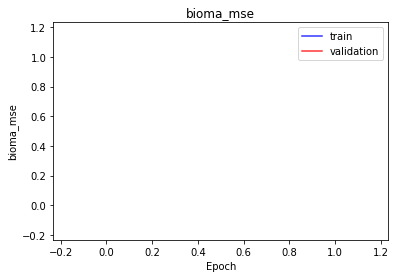

<b>bioma_mae</b>: nan (min: nan, max: nan)

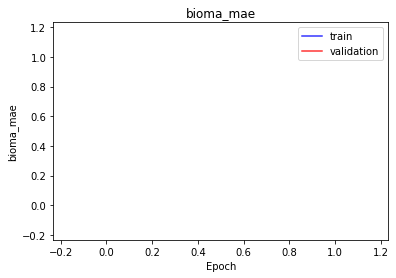

<b>bioma_mape</b>: nan (min: nan, max: nan)

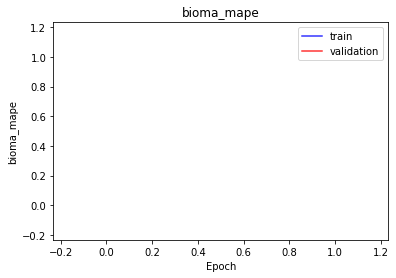

<b>domain_mse</b>: nan (min: nan, max: nan)

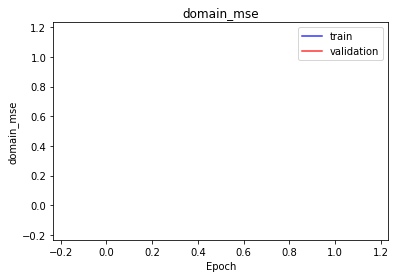

<b>domain_mae</b>: nan (min: nan, max: nan)

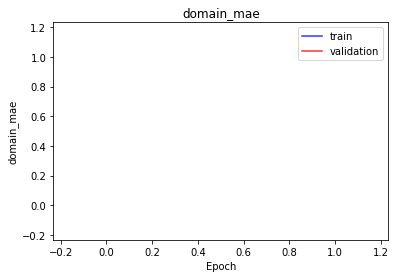

<b>domain_mape</b>: nan (min: nan, max: nan)

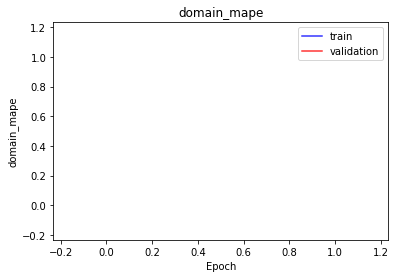

<b>latent_mae</b>: nan (min: nan, max: nan)

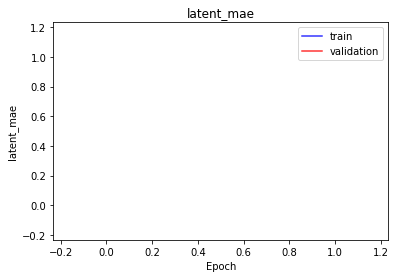

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

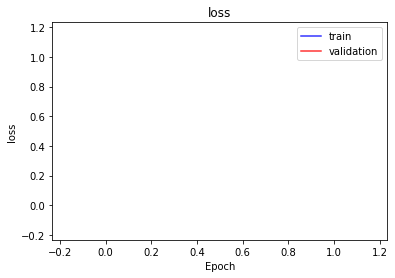

<b>bioma_loss</b>: nan (min: nan, max: nan)

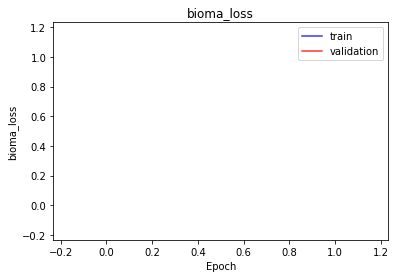

<b>domain_loss</b>: nan (min: nan, max: nan)

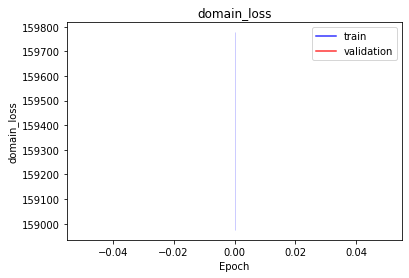

<b>latent_loss</b>: nan (min: nan, max: nan)

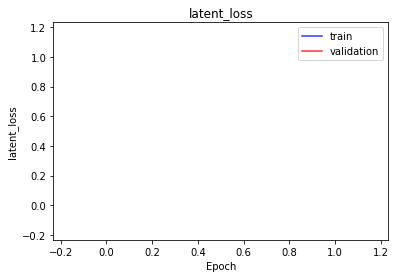

<b>bioma_mse</b>: nan (min: nan, max: nan)

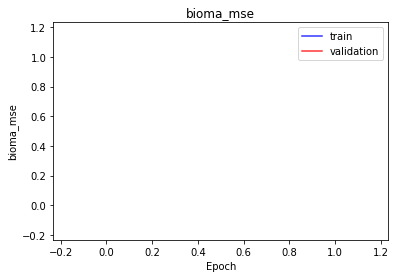

<b>bioma_mae</b>: nan (min: nan, max: nan)

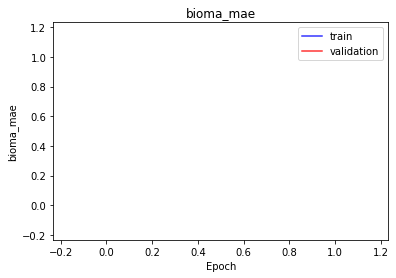

<b>bioma_mape</b>: nan (min: nan, max: nan)

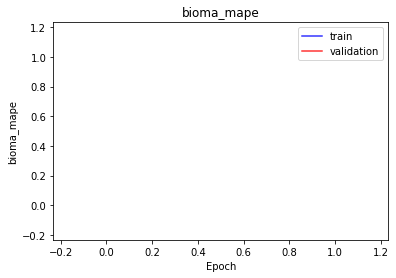

<b>domain_mse</b>: nan (min: nan, max: nan)

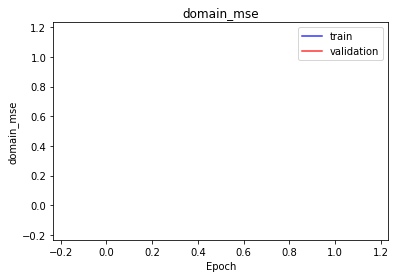

<b>domain_mae</b>: nan (min: nan, max: nan)

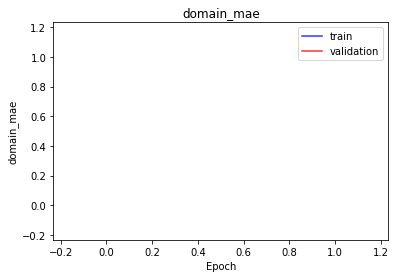

<b>domain_mape</b>: nan (min: nan, max: nan)

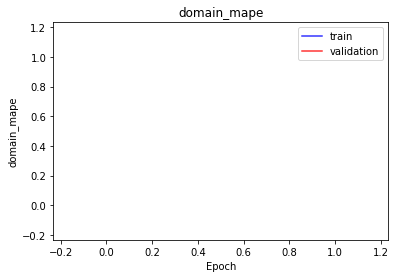

<b>latent_mae</b>: nan (min: nan, max: nan)

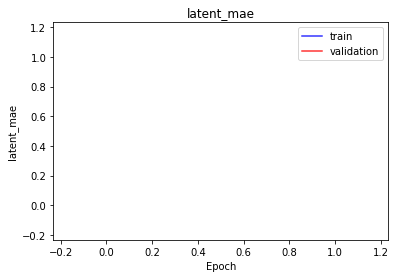

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 256 -> 100 -> 256 -> b |
| Domain Autoencoder | d -> 16 -> 100 -> 256 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

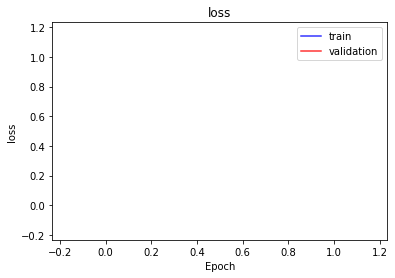

<b>bioma_loss</b>: nan (min: nan, max: nan)

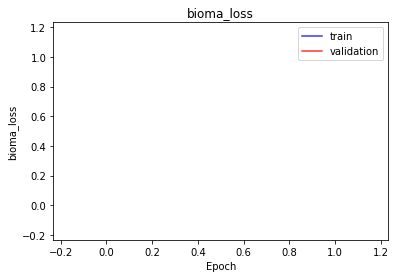

<b>domain_loss</b>: nan (min: nan, max: nan)

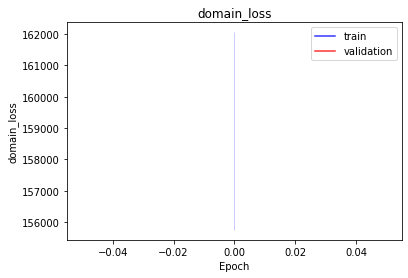

<b>latent_loss</b>: nan (min: nan, max: nan)

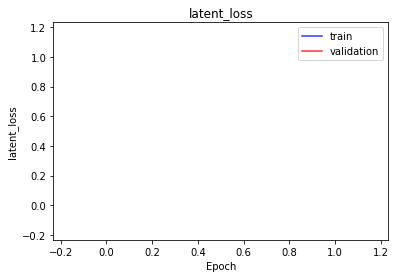

<b>bioma_mse</b>: nan (min: nan, max: nan)

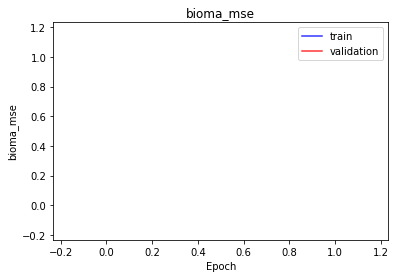

<b>bioma_mae</b>: nan (min: nan, max: nan)

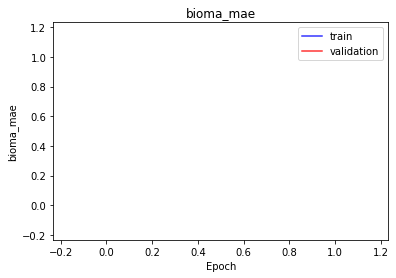

<b>bioma_mape</b>: nan (min: nan, max: nan)

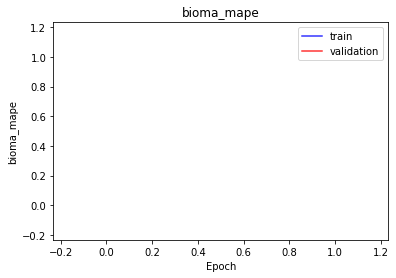

<b>domain_mse</b>: nan (min: nan, max: nan)

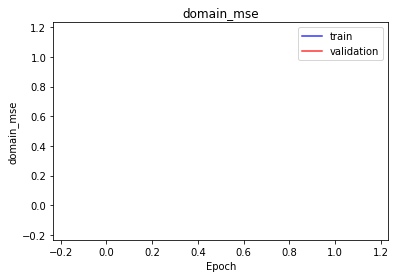

<b>domain_mae</b>: nan (min: nan, max: nan)

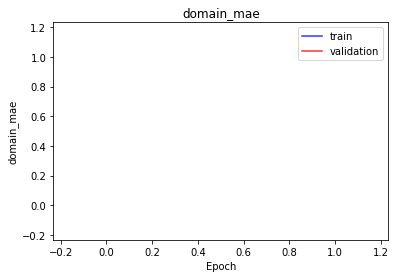

<b>domain_mape</b>: nan (min: nan, max: nan)

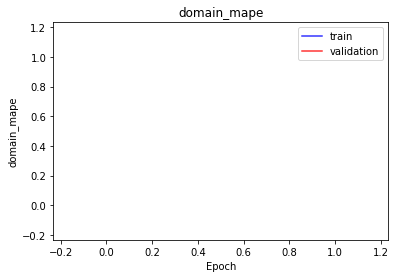

<b>latent_mae</b>: nan (min: nan, max: nan)

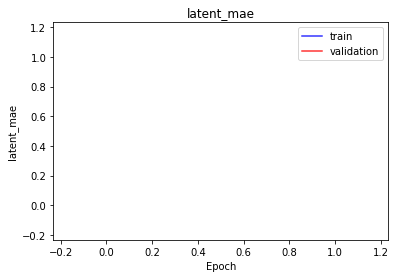

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

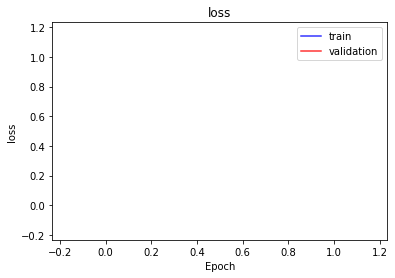

<b>bioma_loss</b>: nan (min: nan, max: nan)

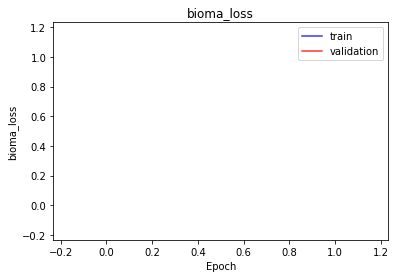

<b>domain_loss</b>: nan (min: nan, max: nan)

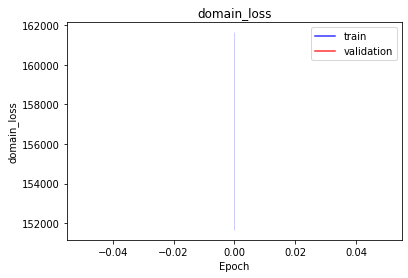

<b>latent_loss</b>: nan (min: nan, max: nan)

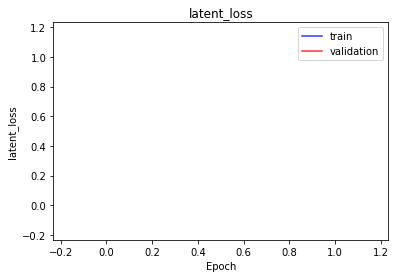

<b>bioma_mse</b>: nan (min: nan, max: nan)

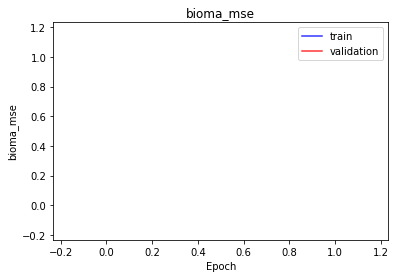

<b>bioma_mae</b>: nan (min: nan, max: nan)

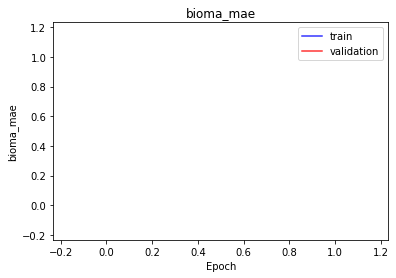

<b>bioma_mape</b>: nan (min: nan, max: nan)

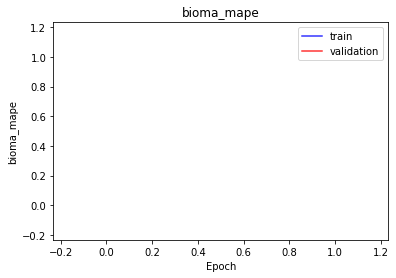

<b>domain_mse</b>: nan (min: nan, max: nan)

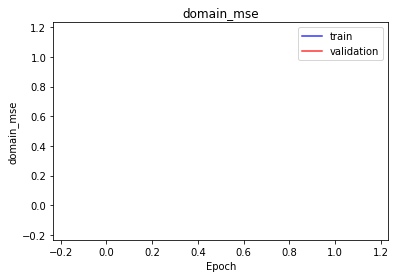

<b>domain_mae</b>: nan (min: nan, max: nan)

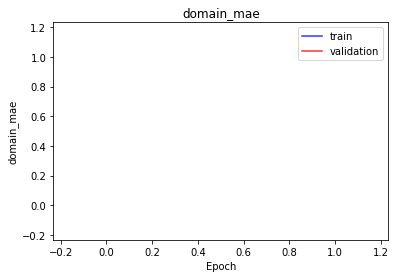

<b>domain_mape</b>: nan (min: nan, max: nan)

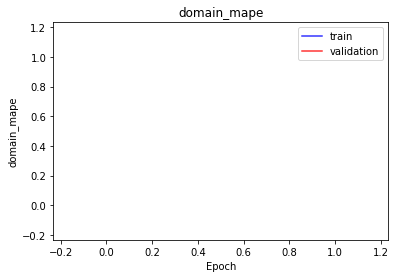

<b>latent_mae</b>: nan (min: nan, max: nan)

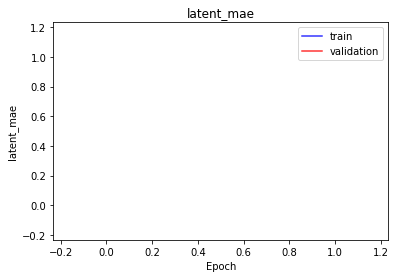

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | tanh |
| Activation Decoder | tanh |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

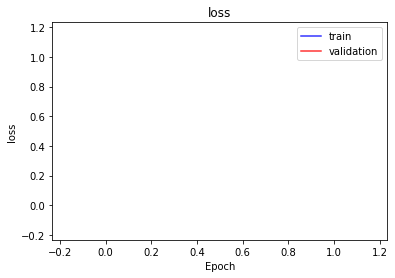

<b>bioma_loss</b>: nan (min: nan, max: nan)

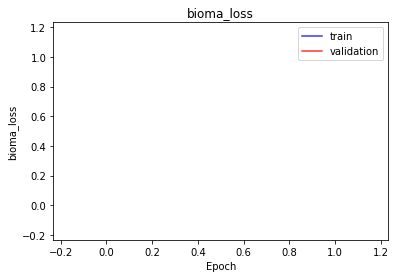

<b>domain_loss</b>: nan (min: nan, max: nan)

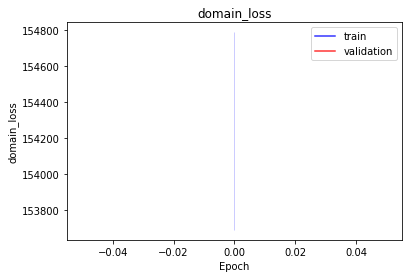

<b>latent_loss</b>: nan (min: nan, max: nan)

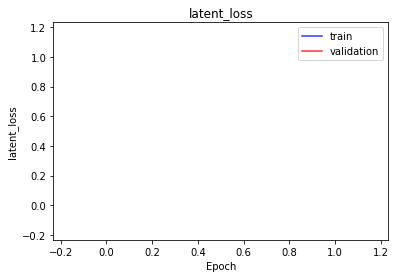

<b>bioma_mse</b>: nan (min: nan, max: nan)

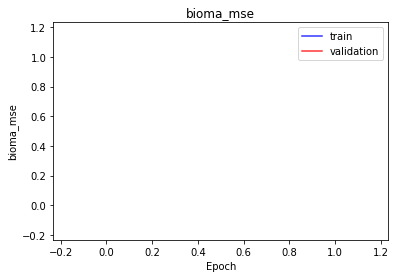

<b>bioma_mae</b>: nan (min: nan, max: nan)

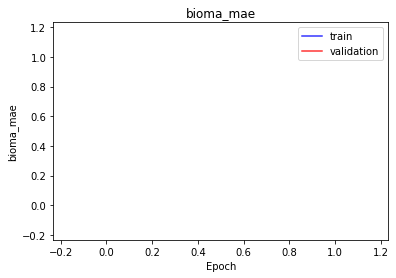

<b>bioma_mape</b>: nan (min: nan, max: nan)

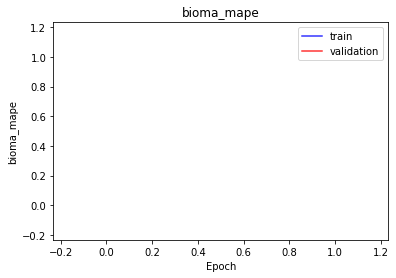

<b>domain_mse</b>: nan (min: nan, max: nan)

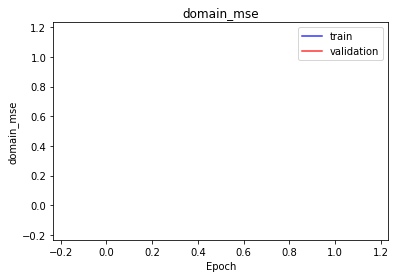

<b>domain_mae</b>: nan (min: nan, max: nan)

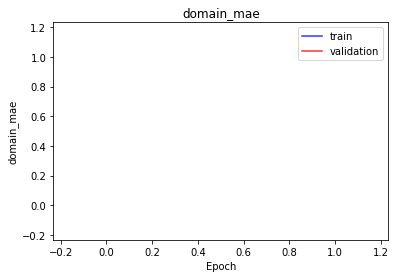

<b>domain_mape</b>: nan (min: nan, max: nan)

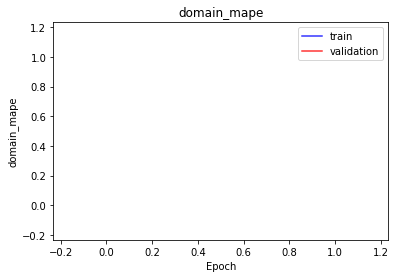

<b>latent_mae</b>: nan (min: nan, max: nan)

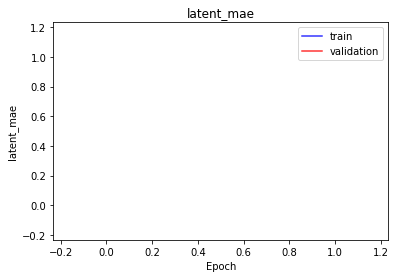

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

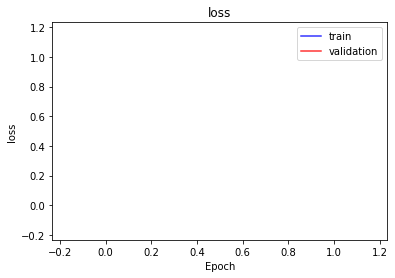

<b>bioma_loss</b>: nan (min: nan, max: nan)

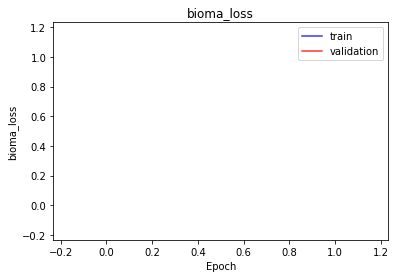

<b>domain_loss</b>: nan (min: nan, max: nan)

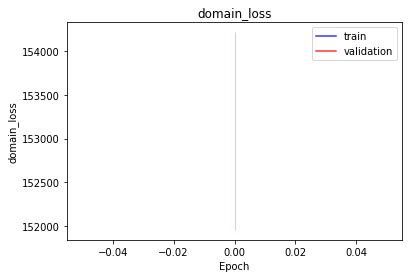

<b>latent_loss</b>: nan (min: nan, max: nan)

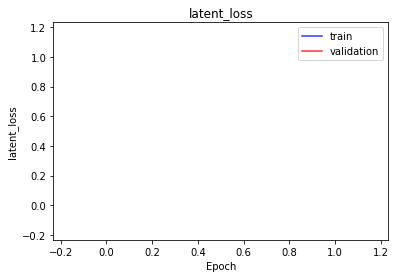

<b>bioma_mse</b>: nan (min: nan, max: nan)

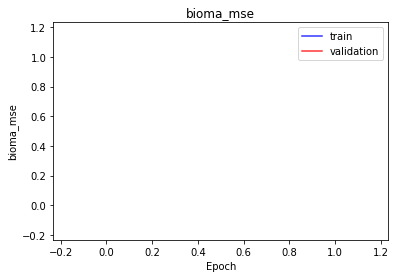

<b>bioma_mae</b>: nan (min: nan, max: nan)

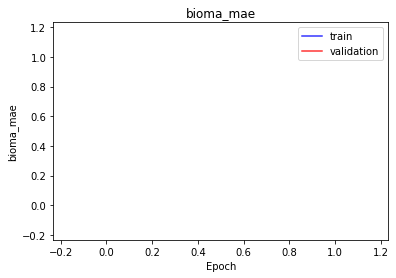

<b>bioma_mape</b>: nan (min: nan, max: nan)

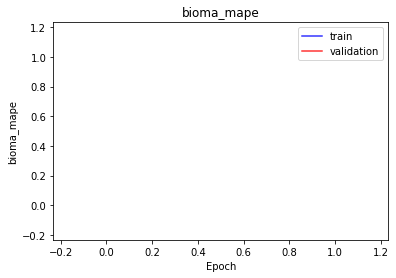

<b>domain_mse</b>: nan (min: nan, max: nan)

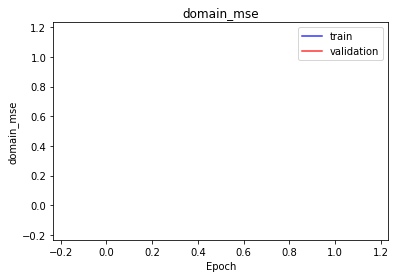

<b>domain_mae</b>: nan (min: nan, max: nan)

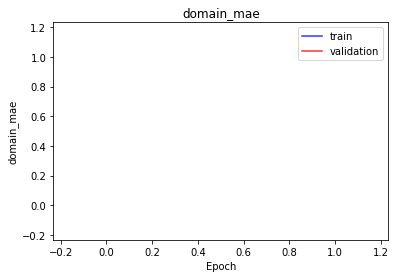

<b>domain_mape</b>: nan (min: nan, max: nan)

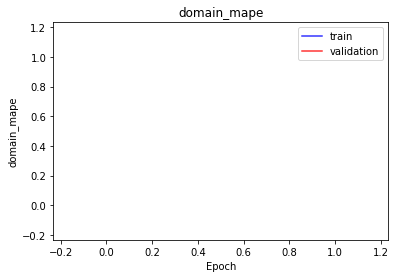

<b>latent_mae</b>: nan (min: nan, max: nan)

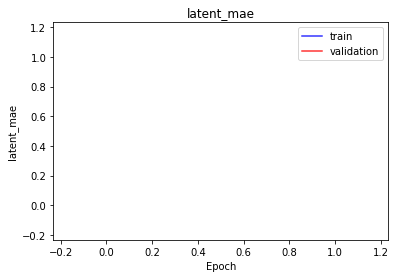

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | relu |
| Activation Decoder | relu |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

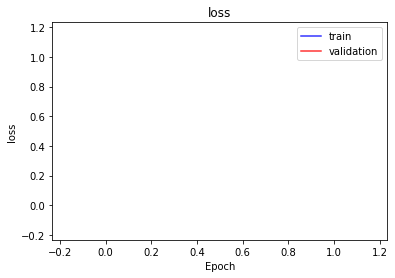

<b>bioma_loss</b>: nan (min: nan, max: nan)

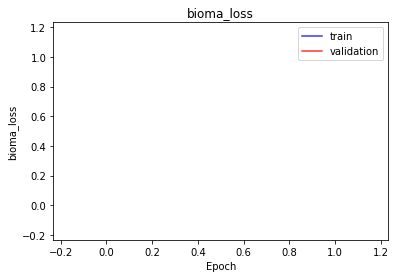

<b>domain_loss</b>: nan (min: nan, max: nan)

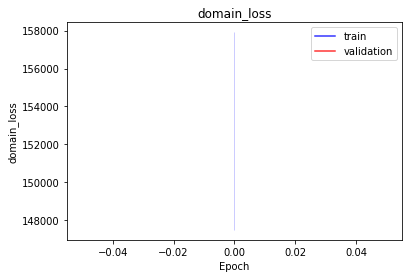

<b>latent_loss</b>: nan (min: nan, max: nan)

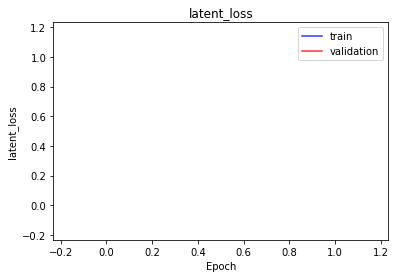

<b>bioma_mse</b>: nan (min: nan, max: nan)

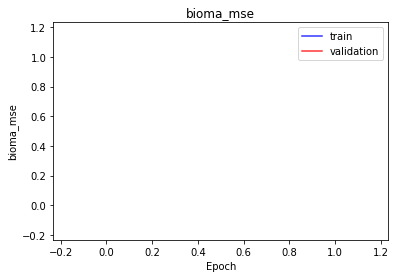

<b>bioma_mae</b>: nan (min: nan, max: nan)

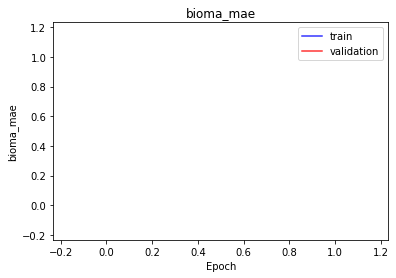

<b>bioma_mape</b>: nan (min: nan, max: nan)

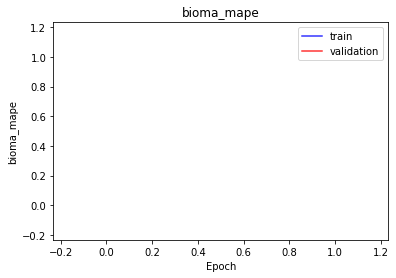

<b>domain_mse</b>: nan (min: nan, max: nan)

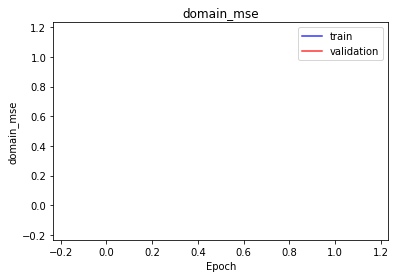

<b>domain_mae</b>: nan (min: nan, max: nan)

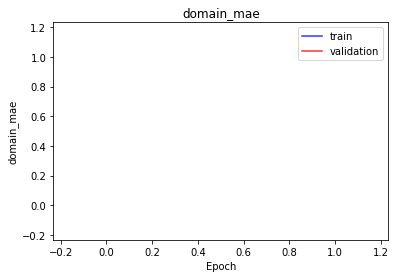

<b>domain_mape</b>: nan (min: nan, max: nan)

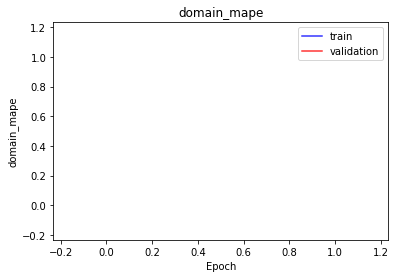

<b>latent_mae</b>: nan (min: nan, max: nan)

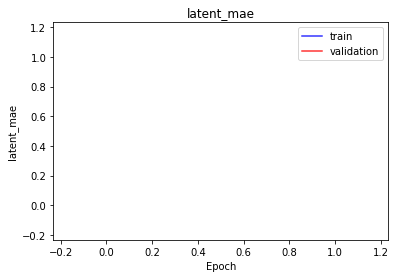

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | tanh |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

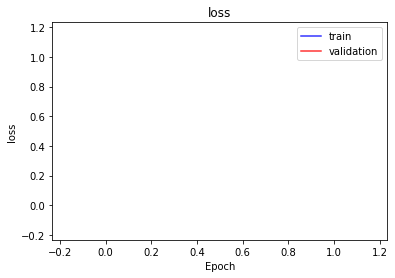

<b>bioma_loss</b>: nan (min: nan, max: nan)

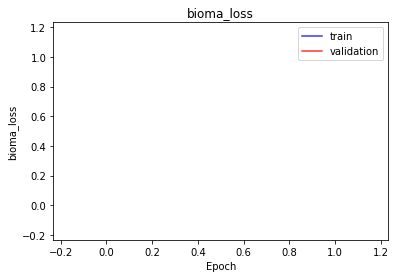

<b>domain_loss</b>: nan (min: nan, max: nan)

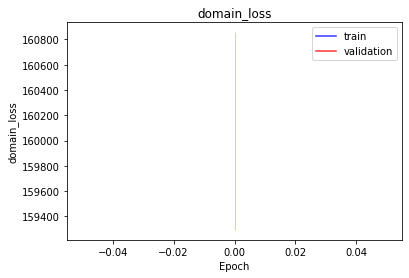

<b>latent_loss</b>: nan (min: nan, max: nan)

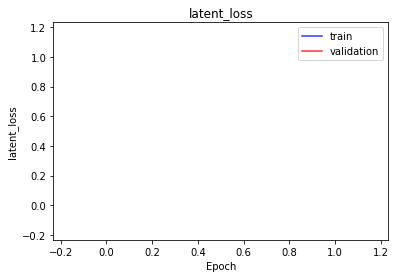

<b>bioma_mse</b>: nan (min: nan, max: nan)

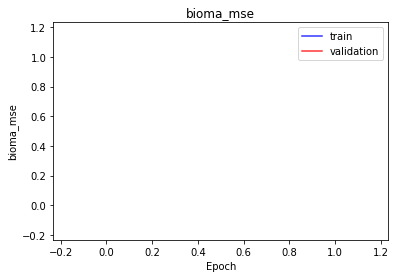

<b>bioma_mae</b>: nan (min: nan, max: nan)

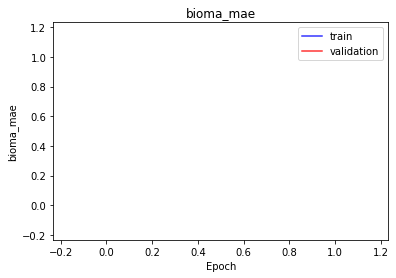

<b>bioma_mape</b>: nan (min: nan, max: nan)

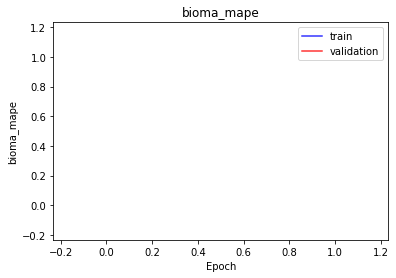

<b>domain_mse</b>: nan (min: nan, max: nan)

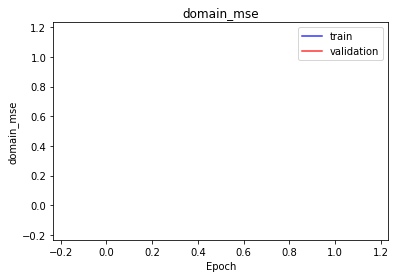

<b>domain_mae</b>: nan (min: nan, max: nan)

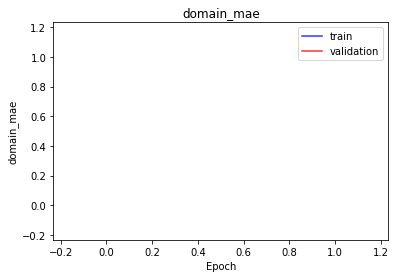

<b>domain_mape</b>: nan (min: nan, max: nan)

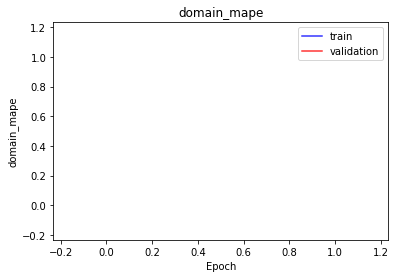

<b>latent_mae</b>: nan (min: nan, max: nan)

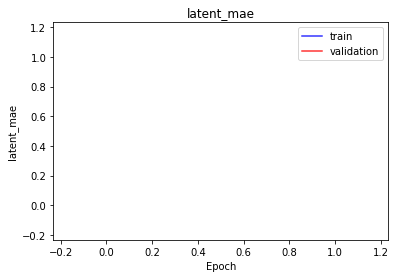

*************

| Parameter             | Value         |
|:----------------------|:--------------|
| Input transform | Percentage |
| Output transform | Softmax |
| Reconstruction Loss | CategoricalCrossentropy |
| Latent Space | 100 |
| Bioma Autoencoder | b -> 100 -> b |
| Domain Autoencoder | d -> 100 -> b |
| Activation Encoder | sigmoid |
| Activation Decoder | sigmoid |
| Activation Latent | sigmoid |
| CV folds | 2 |
| Epochs | 30 |
| Batch Size | 64 |
| Learning Rate | constant = 0.001 |
| Optimizer | Adam |


<b>loss</b>: nan (min: nan, max: nan)

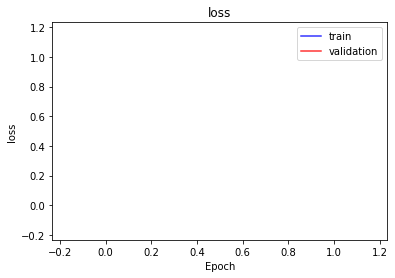

<b>bioma_loss</b>: nan (min: nan, max: nan)

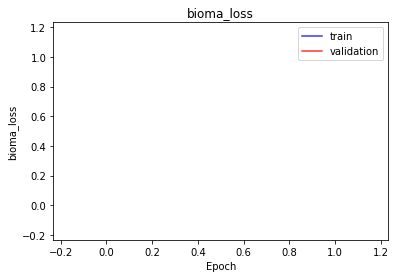

<b>domain_loss</b>: nan (min: nan, max: nan)

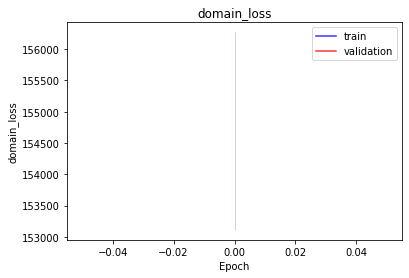

<b>latent_loss</b>: nan (min: nan, max: nan)

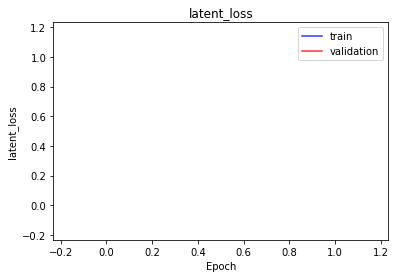

<b>bioma_mse</b>: nan (min: nan, max: nan)

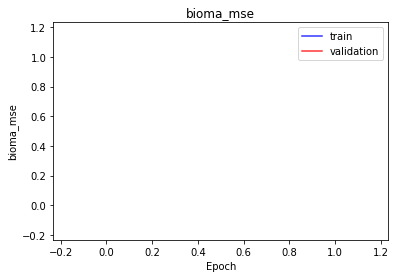

<b>bioma_mae</b>: nan (min: nan, max: nan)

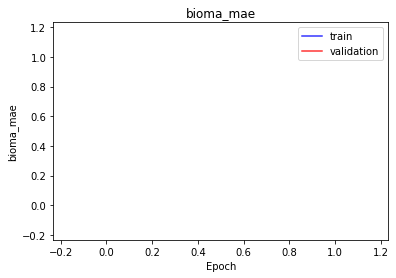

<b>bioma_mape</b>: nan (min: nan, max: nan)

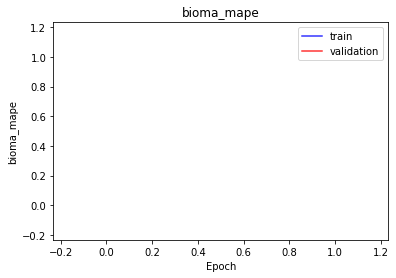

<b>domain_mse</b>: nan (min: nan, max: nan)

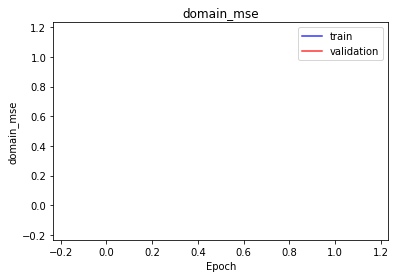

<b>domain_mae</b>: nan (min: nan, max: nan)

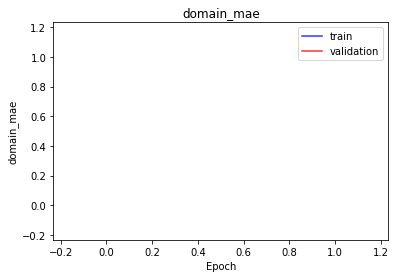

<b>domain_mape</b>: nan (min: nan, max: nan)

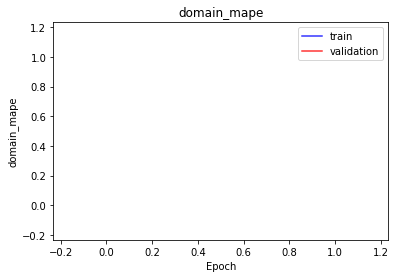

<b>latent_mae</b>: nan (min: nan, max: nan)

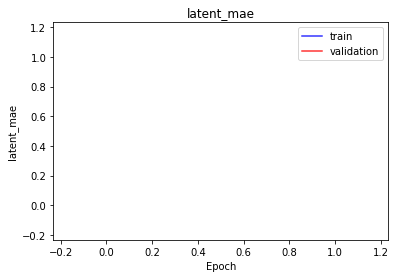

*************

In [23]:
all_metrics = []

cv_folds = 2 # 5
epochs = 30
batch_size = 64
learning_rate = 0.001
optimizer = optimizers.Adam(learning_rate=learning_rate)
params = [
    (None, layers.ReLU(), losses.MeanSquaredError()),
    (CenterLogRatio(), None, losses.MeanSquaredError()),
    (Percentage(), layers.Softmax(), losses.CategoricalCrossentropy()),
]
for input_transform, output_transform, reconstruction_loss in params:
    for latent_space in [10, 50, 100]:
        for autoencoder_layers in [[512,256],[256],[]]:
            for activation in ['tanh', 'relu', 'sigmoid']:
                for activation_latent in ['tanh', 'sigmoid']:
                    experiment_metrics = perform_experiment(cv_folds,
                                                            epochs,
                                                            batch_size,
                                                            learning_rate,
                                                            optimizer,
                                                            input_transform,
                                                            output_transform,
                                                            reconstruction_loss,
                                                            latent_space,
                                                            autoencoder_layers,
                                                            activation,
                                                            activation_latent)
                    all_metrics.append(experiment_metrics)

# Summary Table with all results

In [22]:
keys_set = set()
keys_list = []
for m in all_metrics:
    for k,v in m:
        if k not in keys_set:
            keys_set.add(k)
            keys_list.append(k)


md_text = ""
for k in keys_list:
    if k.startswith('val_'):
        md_text += "| {} ".format(k[4:])
    else:
        md_text += "| {} ".format(k)
md_text += "|\n"
for k in keys_list:
    if k.startswith('val_'):
        md_text += "|--:".format(k[4:])
    else:
        md_text += "|:--".format(k)
md_text += "|\n"

for m in all_metrics:
    i = 0
    for k,v in m:
        while k != keys_list[i]:
            md_text += "| "
            i += 1
        i += 1
        if k.startswith('val_'):
            md_text += "| **{:.4f}** [{:.4f},{:.4f}] ".format(*v)
        else:
            md_text += "| {} ".format(v)
    md_text += "|\n"

display(Markdown(md_text))





























| Input transform | Output transform | Reconstruction Loss | Latent Space | Bioma Autoencoder | Domain Autoencoder | Activation Encoder | Activation Decoder | Activation Latent | CV folds | Epochs | Batch Size | Learning Rate | Optimizer | loss | bioma_loss | domain_loss | latent_loss | bioma_mse | bioma_mae | bioma_mape | domain_mse | domain_mae | domain_mape | latent_mae |
|:--|:--|:--|:--|:--|:--|:--|:--|:--|:--|:--|:--|:--|:--|--:|--:|--:|--:|--:|--:|--:|--:|--:|--:|--:|
| none | ReLU | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978439.0938** [788918.0625,1167960.1250] | **489216.8438** [394457.5625,583976.1250] | **489221.5625** [394459.8750,583983.2500] | **0.6569** [0.6225,0.6913] | **489216.8438** [394457.5625,583976.1250] | **32.8992** [32.4456,33.3529] | **42.4767** [41.8508,43.1026] | **489221.5625** [394459.8750,583983.2500] | **32.9002** [32.4456,33.3548] | **42.4767** [41.8507,43.1027] | **0.6569** [0.6225,0.6913] |
| none | ReLU | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978450.3438** [788926.6875,1167974.0000] | **489222.8125** [394459.4688,583986.1875] | **489227.3125** [394467.0312,583987.5625] | **0.2279** [0.2183,0.2374] | **489222.8125** [394459.4688,583986.1875] | **32.8972** [32.4410,33.3535] | **42.4765** [41.8504,43.1027] | **489227.3125** [394467.0312,583987.5625] | **32.8995** [32.4429,33.3561] | **42.4766** [41.8505,43.1028] | **0.2279** [0.2183,0.2374] |
| none | ReLU | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978465.2500** [788946.0000,1167984.5000] | **489232.3125** [394471.8438,583992.8125] | **489231.9375** [394473.1562,583990.7500] | **1.0165** [0.9732,1.0598] | **489232.3125** [394471.8438,583992.8125] | **32.9017** [32.4454,33.3581] | **42.4769** [41.8508,43.1030] | **489231.9375** [394473.1562,583990.7500] | **32.9042** [32.4502,33.3583] | **42.4770** [41.8510,43.1029] | **1.0165** [0.9732,1.0598] |
| none | ReLU | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978469.7812** [788951.6875,1167987.8750] | **489234.7812** [394475.3750,583994.1875] | **489234.6250** [394475.9062,583993.3125] | **0.4202** [0.3886,0.4517] | **489234.7812** [394475.3750,583994.1875] | **32.9025** [32.4489,33.3562] | **42.4769** [41.8510,43.1028] | **489234.6250** [394475.9062,583993.3125] | **32.9049** [32.4501,33.3597] | **42.4770** [41.8510,43.1030] | **0.4202** [0.3886,0.4517] |
| none | ReLU | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978427.3750** [788906.1250,1167948.6250] | **489213.4375** [394452.9062,583974.0000] | **489213.5625** [394453.0000,583974.1250] | **0.3486** [0.2475,0.4498] | **489213.4375** [394452.9062,583974.0000] | **32.8749** [32.4179,33.3318] | **42.4746** [41.8480,43.1011] | **489213.5625** [394453.0000,583974.1250] | **32.8749** [32.4180,33.3318] | **42.4746** [41.8480,43.1011] | **0.3486** [0.2475,0.4498] |
| none | ReLU | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978448.8750** [788916.8750,1167980.8750] | **489224.3125** [394458.2812,583990.3125] | **489224.3750** [394458.4062,583990.3750] | **0.1434** [0.0882,0.1985] | **489224.3125** [394458.2812,583990.3125] | **32.8727** [32.4229,33.3226] | **42.4745** [41.8489,43.1002] | **489224.3750** [394458.4062,583990.3750] | **32.8727** [32.4229,33.3225] | **42.4745** [41.8489,43.1002] | **0.1434** [0.0882,0.1985] |
| none | ReLU | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978468.6875** [788950.8750,1167986.5000] | **489232.8125** [394473.6250,583992.0000] | **489235.1250** [394476.5312,583993.7500] | **0.7480** [0.7314,0.7647] | **489232.8125** [394473.6250,583992.0000] | **32.9027** [32.4485,33.3569] | **42.4770** [41.8511,43.1030] | **489235.1250** [394476.5312,583993.7500] | **32.9027** [32.4492,33.3562] | **42.4769** [41.8509,43.1028] | **0.7480** [0.7314,0.7647] |
| none | ReLU | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978470.0000** [788951.7500,1167988.2500] | **489235.1250** [394475.0000,583995.2500] | **489234.5625** [394476.4688,583992.6250] | **0.2993** [0.2651,0.3335] | **489235.1250** [394475.0000,583995.2500] | **32.9036** [32.4483,33.3589] | **42.4770** [41.8509,43.1030] | **489234.5625** [394476.4688,583992.6250] | **32.9036** [32.4471,33.3600] | **42.4769** [41.8508,43.1030] | **0.2993** [0.2651,0.3335] |
| none | ReLU | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978470.6562** [788950.9375,1167990.3750] | **489233.4688** [394473.1875,583993.7500] | **489236.1875** [394476.9062,583995.5000] | **1.0073** [0.8355,1.1791] | **489233.4688** [394473.1875,583993.7500] | **32.9025** [32.4471,33.3579] | **42.4770** [41.8510,43.1030] | **489236.1875** [394476.9062,583995.5000] | **32.9064** [32.4521,33.3608] | **42.4772** [41.8512,43.1032] | **1.0073** [0.8355,1.1791] |
| none | ReLU | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978470.7500** [788950.3750,1167991.1250] | **489234.9375** [394474.4688,583995.4375] | **489235.4062** [394475.3750,583995.4375] | **0.4052** [0.3035,0.5069] | **489234.9375** [394474.4688,583995.4375] | **32.9045** [32.4490,33.3600] | **42.4771** [41.8510,43.1031] | **489235.4062** [394475.3750,583995.4375] | **32.9063** [32.4507,33.3618] | **42.4771** [41.8511,43.1032] | **0.4052** [0.3035,0.5069] |
| none | ReLU | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978455.0000** [788938.5000,1167971.5000] | **489226.9375** [394468.9062,583984.9375] | **489227.5000** [394469.2500,583985.7500] | **0.5289** [0.3639,0.6940] | **489226.9375** [394468.9062,583984.9375] | **32.8823** [32.4280,33.3365] | **42.4754** [41.8492,43.1016] | **489227.5000** [394469.2500,583985.7500] | **32.8827** [32.4291,33.3363] | **42.4754** [41.8493,43.1016] | **0.5289** [0.3639,0.6940] |
| none | ReLU | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978463.9062** [788947.6875,1167980.1250] | **489231.8750** [394473.7188,583990.0625] | **489231.8125** [394473.7188,583989.9375] | **0.2096** [0.1726,0.2465] | **489231.8750** [394473.7188,583990.0625] | **32.8914** [32.4430,33.3399] | **42.4760** [41.8505,43.1015] | **489231.8125** [394473.7188,583989.9375] | **32.8914** [32.4430,33.3398] | **42.4760** [41.8505,43.1015] | **0.2096** [0.1726,0.2465] |
| none | ReLU | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978465.6875** [788943.8750,1167987.5000] | **489234.4375** [394475.5938,583993.2500] | **489230.2500** [394467.1562,583993.3750] | **0.9729** [0.8463,1.0995] | **489234.4375** [394475.5938,583993.2500] | **32.9025** [32.4471,33.3578] | **42.4771** [41.8511,43.1031] | **489230.2500** [394467.1562,583993.3750] | **32.9050** [32.4524,33.3576] | **42.4771** [41.8512,43.1030] | **0.9729** [0.8463,1.0995] |
| none | ReLU | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978471.5625** [788953.1250,1167990.0000] | **489234.6562** [394475.3750,583993.9375] | **489236.3750** [394477.1250,583995.6250] | **0.5505** [0.4948,0.6062] | **489234.6562** [394475.3750,583993.9375] | **32.9043** [32.4517,33.3569] | **42.4770** [41.8513,43.1028] | **489236.3750** [394477.1250,583995.6250] | **32.9076** [32.4526,33.3627] | **42.4772** [41.8512,43.1032] | **0.5505** [0.4948,0.6062] |
| none | ReLU | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978465.3750** [788948.3750,1167982.3750] | **489233.3125** [394476.2812,583990.3750] | **489230.9375** [394470.9062,583990.9375] | **1.1645** [1.1622,1.1669] | **489233.3125** [394476.2812,583990.3750] | **32.9048** [32.4498,33.3599] | **42.4773** [41.8513,43.1032] | **489230.9375** [394470.9062,583990.9375] | **32.9047** [32.4510,33.3585] | **42.4771** [41.8512,43.1031] | **1.1645** [1.1622,1.1669] |
| none | ReLU | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978467.1875** [788951.3750,1167983.0000] | **489233.9688** [394475.0000,583992.9375] | **489232.7188** [394475.8125,583989.6250] | **0.5399** [0.4909,0.5890] | **489233.9688** [394475.0000,583992.9375] | **32.9052** [32.4501,33.3604] | **42.4772** [41.8511,43.1032] | **489232.7188** [394475.8125,583989.6250] | **32.9057** [32.4501,33.3613] | **42.4771** [41.8510,43.1033] | **0.5399** [0.4909,0.5890] |
| none | ReLU | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978468.2500** [788953.1250,1167983.3750] | **489232.6250** [394475.7188,583989.5625] | **489234.5625** [394476.2500,583992.8750] | **0.9961** [0.8528,1.1394] | **489232.6250** [394475.7188,583989.5625] | **32.9034** [32.4501,33.3567] | **42.4772** [41.8513,43.1030] | **489234.5625** [394476.2500,583992.8750] | **32.9081** [32.4558,33.3604] | **42.4774** [41.8515,43.1032] | **0.9961** [0.8528,1.1394] |
| none | ReLU | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978469.0312** [788949.3125,1167988.7500] | **489234.1250** [394473.8125,583994.4375] | **489234.5000** [394475.0312,583993.9375] | **0.4330** [0.4241,0.4418] | **489234.1250** [394473.8125,583994.4375] | **32.9060** [32.4524,33.3597] | **42.4772** [41.8514,43.1031] | **489234.5000** [394475.0312,583993.9375] | **32.9064** [32.4541,33.3587] | **42.4772** [41.8514,43.1030] | **0.4330** [0.4241,0.4418] |
| none | ReLU | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978432.5000** [788909.1250,1167955.8750] | **489207.2812** [394441.0000,583973.5625] | **489224.6562** [394467.5625,583981.7500] | **0.5944** [0.5867,0.6022] | **489207.2812** [394441.0000,583973.5625] | **32.8965** [32.4428,33.3502] | **42.4766** [41.8507,43.1026] | **489224.6562** [394467.5625,583981.7500] | **32.9000** [32.4467,33.3534] | **42.4767** [41.8508,43.1026] | **0.5944** [0.5867,0.6022] |
| none | ReLU | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978431.0312** [788920.9375,1167941.1250] | **489212.8438** [394458.1875,583967.5000] | **489218.0000** [394462.5312,583973.5000] | **0.1778** [0.1707,0.1849] | **489212.8438** [394458.1875,583967.5000] | **32.8886** [32.4382,33.3390] | **42.4759** [41.8502,43.1016] | **489218.0000** [394462.5312,583973.5000] | **32.8906** [32.4407,33.3405] | **42.4760** [41.8504,43.1017] | **0.1778** [0.1707,0.1849] |
| none | ReLU | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978452.8125** [788921.7500,1167983.8750] | **489225.3125** [394460.3125,583990.3125] | **489226.5625** [394460.4688,583992.6250] | **0.9355** [0.8717,0.9993] | **489225.3125** [394460.3125,583990.3125] | **32.8916** [32.4330,33.3502] | **42.4764** [41.8501,43.1027] | **489226.5625** [394460.4688,583992.6250] | **32.8936** [32.4372,33.3501] | **42.4762** [41.8499,43.1025] | **0.9355** [0.8717,0.9993] |
| none | ReLU | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978454.1250** [788927.0000,1167981.2500] | **489226.0625** [394462.7188,583989.3750] | **489227.6250** [394463.8125,583991.4375] | **0.5051** [0.4937,0.5165] | **489226.0625** [394462.7188,583989.3750] | **32.8960** [32.4421,33.3500] | **42.4765** [41.8506,43.1024] | **489227.6250** [394463.8125,583991.4375] | **32.9006** [32.4460,33.3552] | **42.4768** [41.8507,43.1028] | **0.5051** [0.4937,0.5165] |
| none | ReLU | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978407.6250** [788893.6250,1167921.6250] | **489203.3125** [394446.4375,583960.1875] | **489203.8125** [394446.6875,583960.9375] | **0.4972** [0.4719,0.5226] | **489203.3125** [394446.4375,583960.1875] | **32.8595** [32.4112,33.3078] | **42.4733** [41.8474,43.0991] | **489203.8125** [394446.6875,583960.9375] | **32.8595** [32.4113,33.3077] | **42.4733** [41.8474,43.0991] | **0.4972** [0.4719,0.5226] |
| none | ReLU | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978448.8125** [788924.7500,1167972.8750] | **489224.3125** [394462.2500,583986.3750] | **489224.3750** [394462.4062,583986.3125] | **0.1019** [0.0962,0.1076] | **489224.3125** [394462.2500,583986.3750] | **32.8600** [32.3995,33.3205] | **42.4735** [41.8466,43.1003] | **489224.3750** [394462.4062,583986.3125] | **32.8601** [32.3996,33.3205] | **42.4735** [41.8466,43.1003] | **0.1019** [0.0962,0.1076] |
| none | ReLU | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978456.8438** [788941.5625,1167972.1250] | **489227.3750** [394475.1562,583979.6250] | **489228.7500** [394465.6875,583991.8125] | **0.6678** [0.6626,0.6729] | **489227.3750** [394475.1562,583979.6250] | **32.8943** [32.4375,33.3510] | **42.4766** [41.8505,43.1027] | **489228.7500** [394465.6875,583991.8125] | **32.8990** [32.4453,33.3527] | **42.4767** [41.8507,43.1026] | **0.6678** [0.6626,0.6729] |
| none | ReLU | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978463.2188** [788938.9375,1167987.5000] | **489231.2500** [394468.8750,583993.6250] | **489231.7500** [394469.8125,583993.6875] | **0.2492** [0.2385,0.2598] | **489231.2500** [394468.8750,583993.6250] | **32.8976** [32.4414,33.3538] | **42.4766** [41.8504,43.1027] | **489231.7500** [394469.8125,583993.6875] | **32.8965** [32.4397,33.3534] | **42.4765** [41.8502,43.1027] | **0.2492** [0.2385,0.2598] |
| none | ReLU | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978451.5000** [788927.6250,1167975.3750] | **489226.0625** [394464.4688,583987.6875] | **489224.5312** [394462.2500,583986.8125] | **0.9018** [0.9012,0.9024] | **489226.0625** [394464.4688,583987.6875] | **32.8916** [32.4383,33.3448] | **42.4765** [41.8507,43.1023] | **489224.5312** [394462.2500,583986.8125] | **32.8980** [32.4488,33.3471] | **42.4766** [41.8510,43.1022] | **0.9018** [0.9012,0.9024] |
| none | ReLU | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978451.5312** [788924.9375,1167978.1250] | **489224.5312** [394461.4375,583987.6250] | **489226.5000** [394463.0000,583990.0000] | **0.5074** [0.4710,0.5439] | **489224.5312** [394461.4375,583987.6250] | **32.8931** [32.4361,33.3502] | **42.4763** [41.8501,43.1026] | **489226.5000** [394463.0000,583990.0000] | **32.8986** [32.4461,33.3510] | **42.4767** [41.8508,43.1025] | **0.5074** [0.4710,0.5439] |
| none | ReLU | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978444.0312** [788912.0625,1167976.0000] | **489220.8750** [394454.5312,583987.1875] | **489222.5938** [394457.0000,583988.1875] | **0.5918** [0.5419,0.6416] | **489220.8750** [394454.5312,583987.1875] | **32.8826** [32.4272,33.3380] | **42.4755** [41.8492,43.1018] | **489222.5938** [394457.0000,583988.1875] | **32.8814** [32.4267,33.3360] | **42.4754** [41.8491,43.1016] | **0.5918** [0.5419,0.6416] |
| none | ReLU | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978450.6875** [788944.5000,1167956.8750] | **489225.2812** [394472.1250,583978.4375] | **489225.2500** [394472.1875,583978.3125] | **0.1763** [0.1721,0.1806] | **489225.2812** [394472.1250,583978.4375] | **32.8777** [32.4353,33.3201] | **42.4751** [41.8500,43.1002] | **489225.2500** [394472.1875,583978.3125] | **32.8779** [32.4357,33.3202] | **42.4751** [41.8500,43.1002] | **0.1763** [0.1721,0.1806] |
| none | ReLU | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978455.5938** [788928.6875,1167982.5000] | **489231.0000** [394471.8125,583990.1875] | **489223.6250** [394455.8438,583991.3750] | **1.0466** [1.0067,1.0864] | **489231.0000** [394471.8125,583990.1875] | **32.8922** [32.4354,33.3489] | **42.4766** [41.8505,43.1028] | **489223.6250** [394455.8438,583991.3750] | **32.8993** [32.4497,33.3488] | **42.4769** [41.8512,43.1026] | **1.0466** [1.0067,1.0864] |
| none | ReLU | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978462.1562** [788942.0625,1167982.2500] | **489230.0625** [394469.5938,583990.5625] | **489231.5625** [394471.9062,583991.1875] | **0.5162** [0.4840,0.5484] | **489230.0625** [394469.5938,583990.5625] | **32.8974** [32.4446,33.3503] | **42.4767** [41.8508,43.1026] | **489231.5625** [394471.9062,583991.1875] | **32.8992** [32.4451,33.3533] | **42.4768** [41.8507,43.1028] | **0.5162** [0.4840,0.5484] |
| none | ReLU | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978454.6562** [788931.5625,1167977.7500] | **489226.9688** [394466.3125,583987.6250] | **489226.6875** [394464.0938,583989.2500] | **0.9910** [0.8215,1.1605] | **489226.9688** [394466.3125,583987.6250] | **32.8957** [32.4426,33.3487] | **42.4769** [41.8511,43.1028] | **489226.6875** [394464.0938,583989.2500] | **32.8934** [32.4416,33.3452] | **42.4763** [41.8506,43.1021] | **0.9910** [0.8215,1.1605] |
| none | ReLU | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978448.1875** [788936.1250,1167960.2500] | **489225.0625** [394467.2812,583982.8750] | **489222.6250** [394468.3125,583976.9375] | **0.4830** [0.4807,0.4853] | **489225.0625** [394467.2812,583982.8750] | **32.8979** [32.4420,33.3537] | **42.4768** [41.8507,43.1029] | **489222.6250** [394468.3125,583976.9375] | **32.9005** [32.4437,33.3573] | **42.4769** [41.8507,43.1031] | **0.4830** [0.4807,0.4853] |
| none | ReLU | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978453.4688** [788933.0625,1167973.8750] | **489227.4375** [394463.0312,583991.8750] | **489225.0312** [394469.0000,583981.0625] | **0.9615** [0.8684,1.0545] | **489227.4375** [394463.0312,583991.8750] | **32.8978** [32.4421,33.3534] | **42.4772** [41.8511,43.1032] | **489225.0312** [394469.0000,583981.0625] | **32.8942** [32.4406,33.3477] | **42.4765** [41.8504,43.1025] | **0.9615** [0.8684,1.0545] |
| none | ReLU | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978458.0000** [788948.1250,1167967.8750] | **489228.0000** [394474.9688,583981.0625] | **489229.4688** [394472.6250,583986.3125] | **0.4854** [0.4533,0.5175] | **489228.0000** [394474.9688,583981.0625] | **32.8963** [32.4435,33.3490] | **42.4767** [41.8508,43.1026] | **489229.4688** [394472.6250,583986.3125] | **32.8974** [32.4444,33.3504] | **42.4766** [41.8506,43.1025] | **0.4854** [0.4533,0.5175] |
| none | ReLU | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978411.3438** [788898.6875,1167924.0000] | **489198.5625** [394451.4375,583945.6875] | **489212.2500** [394446.6875,583977.8125] | **0.5482** [0.5214,0.5751] | **489198.5625** [394451.4375,583945.6875] | **32.8935** [32.4396,33.3475] | **42.4765** [41.8505,43.1025] | **489212.2500** [394446.6875,583977.8125] | **32.8941** [32.4404,33.3479] | **42.4762** [41.8502,43.1022] | **0.5482** [0.5214,0.5751] |
| none | ReLU | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978411.3438** [788844.8125,1167977.8750] | **489201.9688** [394415.4375,583988.5000] | **489209.2188** [394429.1875,583989.2500] | **0.1653** [0.1652,0.1653] | **489201.9688** [394415.4375,583988.5000] | **32.8735** [32.4136,33.3334] | **42.4745** [41.8480,43.1010] | **489209.2188** [394429.1875,583989.2500] | **32.8783** [32.4189,33.3378] | **42.4749** [41.8484,43.1014] | **0.1653** [0.1652,0.1653] |
| none | ReLU | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978393.1250** [788855.0000,1167931.2500] | **489198.6250** [394430.5625,583966.6875] | **489193.5625** [394423.5938,583963.5000] | **0.9319** [0.8898,0.9741] | **489198.6250** [394430.5625,583966.6875] | **32.8700** [32.4111,33.3289] | **42.4749** [41.8487,43.1011] | **489193.5625** [394423.5938,583963.5000] | **32.8861** [32.4338,33.3384] | **42.4757** [41.8498,43.1015] | **0.9319** [0.8898,0.9741] |
| none | ReLU | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978430.8750** [788915.5000,1167946.2500] | **489213.4062** [394454.6875,583972.1250] | **489217.0000** [394460.3125,583973.6875] | **0.4896** [0.4715,0.5077] | **489213.4062** [394454.6875,583972.1250] | **32.8864** [32.4360,33.3367] | **42.4758** [41.8502,43.1014] | **489217.0000** [394460.3125,583973.6875] | **32.8906** [32.4405,33.3407] | **42.4760** [41.8503,43.1017] | **0.4896** [0.4715,0.5077] |
| none | ReLU | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978442.7500** [788937.8750,1167947.6250] | **489221.0938** [394468.6875,583973.5000] | **489221.3125** [394468.8438,583973.7500] | **0.4031** [0.3804,0.4258] | **489221.0938** [394468.6875,583973.5000] | **32.8449** [32.3982,33.2917] | **42.4719** [41.8463,43.0975] | **489221.3125** [394468.8438,583973.7500] | **32.8452** [32.3981,33.2924] | **42.4720** [41.8463,43.0976] | **0.4031** [0.3804,0.4258] |
| none | ReLU | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978408.8750** [788865.1250,1167952.6250] | **489204.3125** [394432.5312,583976.1250] | **489204.4375** [394432.4688,583976.3750] | **0.1253** [0.1202,0.1303] | **489204.3125** [394432.5312,583976.1250] | **32.8397** [32.3864,33.2930] | **42.4712** [41.8451,43.0973] | **489204.4375** [394432.4688,583976.3750] | **32.8398** [32.3865,33.2930] | **42.4712** [41.8451,43.0973] | **0.1253** [0.1202,0.1303] |
| none | ReLU | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978436.0312** [788909.3125,1167962.7500] | **489215.0000** [394446.5312,583983.5000] | **489220.3750** [394462.0938,583978.6250] | **0.6460** [0.6306,0.6615] | **489215.0000** [394446.5312,583983.5000] | **32.8908** [32.4386,33.3429] | **42.4764** [41.8507,43.1022] | **489220.3750** [394462.0938,583978.6250] | **32.8916** [32.4400,33.3431] | **42.4761** [41.8502,43.1019] | **0.6460** [0.6306,0.6615] |
| none | ReLU | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978445.0000** [788925.2500,1167964.7500] | **489219.0938** [394459.6875,583978.5000] | **489225.7188** [394465.3750,583986.0625] | **0.2218** [0.2141,0.2294] | **489219.0938** [394459.6875,583978.5000] | **32.8877** [32.4316,33.3439] | **42.4758** [41.8496,43.1020] | **489225.7188** [394465.3750,583986.0625] | **32.8888** [32.4336,33.3439] | **42.4758** [41.8497,43.1019] | **0.2218** [0.2141,0.2294] |
| none | ReLU | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978414.8125** [788899.3750,1167930.2500] | **489206.2812** [394446.6250,583965.9375] | **489207.6250** [394451.8750,583963.3750] | **0.9430** [0.8770,1.0090] | **489206.2812** [394446.6250,583965.9375] | **32.8732** [32.4127,33.3338] | **42.4754** [41.8489,43.1018] | **489207.6250** [394451.8750,583963.3750] | **32.8822** [32.4277,33.3366] | **42.4753** [41.8493,43.1014] | **0.9430** [0.8770,1.0090] |
| none | ReLU | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978447.0000** [788940.5000,1167953.5000] | **489222.8438** [394471.4375,583974.2500] | **489223.6875** [394468.5938,583978.8125] | **0.5277** [0.5222,0.5331] | **489222.8438** [394471.4375,583974.2500] | **32.8895** [32.4328,33.3461] | **42.4761** [41.8499,43.1023] | **489223.6875** [394468.5938,583978.8125] | **32.8944** [32.4353,33.3535] | **42.4763** [41.8498,43.1028] | **0.5277** [0.5222,0.5331] |
| none | ReLU | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978443.4062** [788931.9375,1167954.8750] | **489220.3125** [394463.7500,583976.8750] | **489222.5000** [394467.5625,583977.4375] | **0.6049** [0.5977,0.6122] | **489220.3125** [394463.7500,583976.8750] | **32.8700** [32.4132,33.3269] | **42.4743** [41.8480,43.1007] | **489222.5000** [394467.5625,583977.4375] | **32.8699** [32.4118,33.3279] | **42.4743** [41.8478,43.1007] | **0.6049** [0.5977,0.6122] |
| none | ReLU | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978440.7188** [788916.5625,1167964.8750] | **489219.8750** [394457.6250,583982.1250] | **489220.6562** [394458.7500,583982.5625] | **0.1658** [0.1535,0.1780] | **489219.8750** [394457.6250,583982.1250] | **32.8739** [32.4221,33.3257] | **42.4745** [41.8485,43.1004] | **489220.6562** [394458.7500,583982.5625] | **32.8741** [32.4224,33.3259] | **42.4745** [41.8486,43.1004] | **0.1658** [0.1535,0.1780] |
| none | ReLU | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978442.7188** [788910.1875,1167975.2500] | **489225.5312** [394462.1250,583988.9375] | **489216.1250** [394447.0000,583985.2500] | **0.9989** [0.9601,1.0376] | **489225.5312** [394462.1250,583988.9375] | **32.8845** [32.4293,33.3396] | **42.4761** [41.8503,43.1019] | **489216.1250** [394447.0000,583985.2500] | **32.8798** [32.4264,33.3332] | **42.4755** [41.8490,43.1019] | **0.9989** [0.9601,1.0376] |
| none | ReLU | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978457.0625** [788945.3750,1167968.7500] | **489230.6250** [394473.5938,583987.6250] | **489225.9375** [394471.2500,583980.6250] | **0.4973** [0.4895,0.5051] | **489230.6250** [394473.5938,583987.6250] | **32.8940** [32.4402,33.3477] | **42.4766** [41.8507,43.1025] | **489225.9375** [394471.2500,583980.6250] | **32.8942** [32.4461,33.3422] | **42.4764** [41.8510,43.1018] | **0.4973** [0.4895,0.5051] |
| none | ReLU | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978447.1562** [788939.6875,1167954.6250] | **489225.3438** [394471.6250,583979.0625] | **489220.7500** [394466.9688,583974.5625] | **1.0454** [1.0355,1.0553] | **489225.3438** [394471.6250,583979.0625] | **32.8837** [32.4295,33.3378] | **42.4762** [41.8504,43.1019] | **489220.7500** [394466.9688,583974.5625] | **32.8932** [32.4418,33.3446] | **42.4763** [41.8504,43.1022] | **1.0454** [1.0355,1.0553] |
| none | ReLU | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978444.9375** [788934.5000,1167955.3750] | **489218.1250** [394464.0312,583972.2500] | **489226.3125** [394470.0000,583982.6250] | **0.5113** [0.4877,0.5348] | **489218.1250** [394464.0312,583972.2500] | **32.8876** [32.4320,33.3431] | **42.4760** [41.8499,43.1022] | **489226.3125** [394470.0000,583982.6250] | **32.8908** [32.4352,33.3464] | **42.4759** [41.8497,43.1021] | **0.5113** [0.4877,0.5348] |
| none | ReLU | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978441.2500** [788902.1250,1167980.3750] | **489214.0625** [394439.5938,583988.5000] | **489226.2500** [394461.5312,583990.9375] | **0.9627** [0.9352,0.9902] | **489214.0625** [394439.5938,583988.5000] | **32.8843** [32.4349,33.3338] | **42.4762** [41.8508,43.1016] | **489226.2500** [394461.5312,583990.9375] | **32.8863** [32.4343,33.3384] | **42.4758** [41.8498,43.1018] | **0.9627** [0.9352,0.9902] |
| none | ReLU | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978436.9688** [788900.3125,1167973.6250] | **489218.2188** [394450.0000,583986.4375] | **489218.2812** [394449.8750,583986.6875] | **0.4492** [0.4451,0.4533] | **489218.2188** [394450.0000,583986.4375] | **32.8856** [32.4379,33.3333] | **42.4759** [41.8505,43.1013] | **489218.2812** [394449.8750,583986.6875] | **32.8906** [32.4391,33.3421] | **42.4761** [41.8502,43.1020] | **0.4492** [0.4451,0.4533] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978452.0312** [788932.0625,1167972.0000] | **489221.0625** [394458.8750,583983.2500] | **489230.1562** [394472.2500,583988.0625] | **0.8478** [0.7585,0.9371] | **2.0239** [1.9653,2.0824] | **1.1278** [1.0929,1.1628] | **nan** [nan,nan] | **2.0004** [1.9503,2.0505] | **1.1239** [1.0949,1.1529] | **nan** [nan,nan] | **0.8478** [0.7585,0.9371] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978431.5312** [788912.6875,1167950.3750] | **489212.0312** [394452.0000,583972.0625] | **489219.2188** [394460.3750,583978.0625] | **0.3235** [0.3067,0.3403] | **2.0022** [1.9488,2.0556] | **1.1317** [1.0991,1.1642] | **nan** [nan,nan] | **1.9966** [1.9497,2.0435] | **1.1286** [1.0988,1.1585] | **nan** [nan,nan] | **0.3235** [0.3067,0.3403] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978457.7500** [788937.3750,1167978.1250] | **489226.8125** [394467.6250,583986.0000] | **489229.9375** [394468.6250,583991.2500] | **1.0448** [0.9364,1.1533] | **2.0014** [1.9610,2.0418] | **1.1227** [1.0940,1.1514] | **nan** [nan,nan] | **1.9981** [1.9501,2.0461] | **1.1245** [1.0953,1.1537] | **nan** [nan,nan] | **1.0448** [0.9364,1.1533] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978463.3750** [788944.5000,1167982.2500] | **489230.5625** [394471.9062,583989.1875] | **489232.2500** [394472.0312,583992.5000] | **0.5347** [0.5230,0.5464] | **2.0033** [1.9585,2.0482] | **1.1232** [1.0933,1.1531] | **nan** [nan,nan] | **2.0034** [1.9553,2.0515] | **1.1234** [1.0912,1.1556] | **nan** [nan,nan] | **0.5347** [0.5230,0.5464] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978435.5625** [788907.0000,1167964.1250] | **489217.3750** [394453.0312,583981.7500] | **489217.7500** [394453.5312,583982.0000] | **0.4250** [0.4196,0.4305] | **2.1120** [2.0362,2.1879] | **1.1793** [1.1498,1.2088] | **nan** [nan,nan] | **2.1125** [2.0366,2.1884] | **1.1794** [1.1498,1.2089] | **nan** [nan,nan] | **0.4250** [0.4196,0.4305] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978388.1250** [788862.3750,1167913.8750] | **489194.0000** [394431.1250,583956.8750] | **489194.0312** [394431.1250,583956.9375] | **0.1391** [0.1012,0.1770] | **2.0878** [2.0437,2.1318] | **1.1702** [1.1476,1.1928] | **nan** [nan,nan] | **2.0880** [2.0440,2.1320] | **1.1703** [1.1477,1.1928] | **nan** [nan,nan] | **0.1391** [0.1012,0.1770] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978458.3750** [788944.2500,1167972.5000] | **489227.0000** [394470.9688,583983.0625] | **489230.6250** [394472.5312,583988.6875] | **0.7188** [0.6967,0.7409] | **2.0243** [1.9836,2.0649] | **1.1271** [1.1003,1.1540] | **nan** [nan,nan] | **2.0053** [1.9632,2.0474] | **1.1256** [1.0968,1.1544] | **nan** [nan,nan] | **0.7188** [0.6967,0.7409] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978464.7500** [788949.2500,1167980.2500] | **489230.1250** [394472.3125,583987.9375] | **489234.2812** [394476.5625,583992.0000] | **0.3043** [0.2536,0.3551] | **2.0083** [1.9533,2.0634] | **1.1292** [1.0977,1.1608] | **nan** [nan,nan] | **2.0129** [1.9596,2.0662] | **1.1293** [1.0983,1.1602] | **nan** [nan,nan] | **0.3043** [0.2536,0.3551] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978463.9688** [788954.6875,1167973.2500] | **489227.8750** [394469.5938,583986.1250] | **489235.3125** [394483.8438,583986.7500] | **0.8024** [0.3332,1.2717] | **2.0258** [1.9784,2.0732] | **1.1278** [1.0965,1.1592] | **nan** [nan,nan] | **2.0215** [1.9810,2.0619] | **1.1305** [1.1038,1.1572] | **nan** [nan,nan] | **0.8024** [0.3332,1.2717] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978465.6875** [788946.1250,1167985.2500] | **489232.1875** [394471.8438,583992.5000] | **489233.0625** [394473.8750,583992.2500] | **0.4298** [0.4017,0.4578] | **2.0033** [1.9635,2.0432] | **1.1231** [1.0950,1.1513] | **nan** [nan,nan] | **2.0102** [1.9697,2.0506] | **1.1266** [1.0999,1.1532] | **nan** [nan,nan] | **0.4298** [0.4017,0.4578] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978485.0000** [788987.2500,1167982.7500] | **489241.4688** [394492.1875,583990.7500] | **489243.0000** [394494.4062,583991.6250] | **0.5270** [0.4080,0.6461] | **2.0624** [1.9801,2.1447] | **1.1530** [1.1213,1.1847] | **nan** [nan,nan] | **2.0616** [1.9818,2.1413] | **1.1527** [1.1218,1.1836] | **nan** [nan,nan] | **0.5270** [0.4080,0.6461] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978448.3125** [788922.0000,1167974.6250] | **489223.7188** [394460.3750,583987.0625] | **489224.3750** [394461.4062,583987.3125] | **0.2161** [0.1913,0.2409] | **2.0582** [2.0265,2.0899] | **1.1521** [1.1328,1.1713] | **nan** [nan,nan] | **2.0595** [2.0262,2.0928] | **1.1523** [1.1327,1.1719] | **nan** [nan,nan] | **0.2161** [0.1913,0.2409] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978472.9062** [788956.3125,1167989.5000] | **489234.5312** [394474.8125,583994.2500] | **489237.4375** [394480.4062,583994.5000] | **0.8849** [0.6949,1.0749] | **2.0265** [1.9764,2.0766] | **1.1254** [1.0948,1.1561] | **nan** [nan,nan] | **2.0414** [1.9904,2.0924] | **1.1338** [1.1050,1.1627] | **nan** [nan,nan] | **0.8849** [0.6949,1.0749] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978470.2812** [788943.9375,1167996.6250] | **489234.5625** [394471.9688,583997.1875] | **489235.2500** [394471.4688,583999.0625] | **0.4328** [0.3906,0.4750] | **2.0236** [1.9714,2.0759] | **1.1275** [1.0958,1.1592] | **nan** [nan,nan] | **2.0190** [1.9848,2.0531] | **1.1278** [1.1029,1.1528] | **nan** [nan,nan] | **0.4328** [0.3906,0.4750] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978471.6562** [788960.9375,1167982.3750] | **489236.1875** [394477.9688,583994.3750] | **489234.5625** [394481.9688,583987.1250] | **0.9422** [0.8716,1.0128] | **2.0297** [1.9923,2.0672] | **1.1256** [1.0987,1.1525] | **nan** [nan,nan] | **2.0449** [2.0007,2.0892] | **1.1373** [1.1118,1.1627] | **nan** [nan,nan] | **0.9422** [0.8716,1.0128] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978478.0312** [788961.4375,1167994.6250] | **489236.3750** [394479.4062,583993.3750] | **489241.0625** [394481.4688,584000.6250] | **0.5718** [0.5351,0.6085] | **2.0196** [1.9709,2.0683] | **1.1262** [1.0966,1.1559] | **nan** [nan,nan] | **2.0264** [1.9752,2.0776] | **1.1273** [1.0976,1.1570] | **nan** [nan,nan] | **0.5718** [0.5351,0.6085] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978470.4375** [788951.0000,1167989.8750] | **489232.0000** [394471.1562,583992.8125] | **489237.5000** [394478.8750,583996.1250] | **0.9678** [0.9150,1.0206] | **2.0300** [1.9777,2.0822] | **1.1265** [1.0939,1.1592] | **nan** [nan,nan] | **2.0251** [1.9736,2.0766] | **1.1298** [1.1002,1.1593] | **nan** [nan,nan] | **0.9678** [0.9150,1.0206] |
| CenterLogRatio | none | MeanSquaredError | 10 | b -> 10 -> b | d -> 10 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978473.5312** [788951.6875,1167995.3750] | **489235.4375** [394473.2812,583997.6250] | **489237.5625** [394477.8750,583997.2500] | **0.5264** [0.5135,0.5393] | **2.0133** [1.9667,2.0599] | **1.1238** [1.0949,1.1528] | **nan** [nan,nan] | **2.0136** [1.9673,2.0598] | **1.1249** [1.0958,1.1540] | **nan** [nan,nan] | **0.5264** [0.5135,0.5393] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978397.4688** [788868.9375,1167926.0000] | **489180.3125** [394409.7188,583950.9375] | **489216.5000** [394458.5312,583974.4375] | **0.6596** [0.6381,0.6812] | **2.0254** [1.9912,2.0595] | **1.1324** [1.1043,1.1605] | **nan** [nan,nan] | **1.9964** [1.9500,2.0429] | **1.1293** [1.1007,1.1579] | **nan** [nan,nan] | **0.6596** [0.6381,0.6812] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978378.7500** [788863.2500,1167894.2500] | **489180.8125** [394423.1250,583938.5000] | **489197.6562** [394439.8750,583955.4375] | **0.2609** [0.2587,0.2631] | **1.9981** [1.9518,2.0443] | **1.1390** [1.1076,1.1705] | **nan** [nan,nan] | **1.9987** [1.9582,2.0393] | **1.1380** [1.1107,1.1652] | **nan** [nan,nan] | **0.2609** [0.2587,0.2631] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978421.5625** [788908.6250,1167934.5000] | **489206.5000** [394450.9688,583962.0625] | **489214.0625** [394456.6250,583971.5000] | **1.0224** [0.9860,1.0589] | **1.9764** [1.9340,2.0189] | **1.1206** [1.0913,1.1498] | **nan** [nan,nan] | **1.9932** [1.9475,2.0389] | **1.1289** [1.1037,1.1541] | **nan** [nan,nan] | **1.0224** [0.9860,1.0589] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978439.1562** [788914.4375,1167963.8750] | **489219.6875** [394457.6875,583981.6875] | **489219.0000** [394456.2500,583981.7500] | **0.4452** [0.3812,0.5091] | **1.9921** [1.9458,2.0384] | **1.1260** [1.0954,1.1566] | **nan** [nan,nan] | **1.9881** [1.9402,2.0361] | **1.1280** [1.0979,1.1582] | **nan** [nan,nan] | **0.4452** [0.3812,0.5091] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978390.4375** [788867.2500,1167913.6250] | **489194.4688** [394433.1250,583955.8125] | **489195.4688** [394433.6250,583957.3125] | **0.5355** [0.5110,0.5599] | **2.0368** [1.9913,2.0824] | **1.1628** [1.1407,1.1849] | **nan** [nan,nan] | **2.0376** [1.9932,2.0819] | **1.1629** [1.1412,1.1846] | **nan** [nan,nan] | **0.5355** [0.5110,0.5599] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978398.3125** [788863.5000,1167933.1250] | **489198.8438** [394431.4375,583966.2500] | **489199.3750** [394431.9688,583966.7500] | **0.1415** [0.1371,0.1460] | **2.0634** [2.0547,2.0722] | **1.1667** [1.1559,1.1774] | **nan** [nan,nan] | **2.0635** [2.0549,2.0721] | **1.1666** [1.1559,1.1773] | **nan** [nan,nan] | **0.1415** [0.1371,0.1460] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978433.3438** [788907.9375,1167958.7500] | **489200.8750** [394435.9062,583965.8125] | **489231.6875** [394471.2812,583992.1250] | **0.7307** [0.7258,0.7356] | **2.0317** [1.9823,2.0810] | **1.1322** [1.1001,1.1644] | **nan** [nan,nan] | **2.0161** [1.9811,2.0511] | **1.1312** [1.1069,1.1554] | **nan** [nan,nan] | **0.7307** [0.7258,0.7356] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978418.3438** [788879.3125,1167957.3750] | **489203.5938** [394435.1250,583972.0625] | **489214.5312** [394444.0000,583985.0625] | **0.2316** [0.2126,0.2506] | **1.9989** [1.9507,2.0472] | **1.1317** [1.1023,1.1611] | **nan** [nan,nan] | **2.0080** [1.9577,2.0582] | **1.1341** [1.1048,1.1634] | **nan** [nan,nan] | **0.2316** [0.2126,0.2506] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978425.8438** [788901.0625,1167950.6250] | **489203.6875** [394443.1875,583964.1875] | **489221.1875** [394456.7500,583985.6250] | **1.0074** [0.8885,1.1263] | **2.0075** [1.9535,2.0615] | **1.1245** [1.0922,1.1567] | **nan** [nan,nan] | **2.0484** [1.9968,2.1001] | **1.1468** [1.1185,1.1751] | **nan** [nan,nan] | **1.0074** [0.8885,1.1263] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978428.5312** [788908.6875,1167948.3750] | **489210.6250** [394448.6875,583972.5625] | **489217.5625** [394459.6250,583975.5000] | **0.4031** [0.3993,0.4069] | **2.0099** [1.9594,2.0603] | **1.1313** [1.0993,1.1632] | **nan** [nan,nan] | **2.0109** [1.9659,2.0559] | **1.1329** [1.1058,1.1600] | **nan** [nan,nan] | **0.4031** [0.3993,0.4069] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978443.7188** [788916.5625,1167970.8750] | **489218.4062** [394455.3125,583981.5000] | **489224.7188** [394460.6875,583988.7500] | **0.5751** [0.5492,0.6010] | **2.0411** [1.9613,2.1209] | **1.1472** [1.1140,1.1804] | **nan** [nan,nan] | **2.0434** [1.9682,2.1185] | **1.1462** [1.1146,1.1778] | **nan** [nan,nan] | **0.5751** [0.5492,0.6010] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978443.3438** [788924.9375,1167961.7500] | **489220.6250** [394461.3125,583979.9375] | **489222.5625** [394463.4688,583981.6875] | **0.1818** [0.1597,0.2038] | **2.0673** [2.0568,2.0778] | **1.1596** [1.1494,1.1698] | **nan** [nan,nan] | **2.0688** [2.0586,2.0789] | **1.1599** [1.1497,1.1701] | **nan** [nan,nan] | **0.1818** [0.1597,0.2038] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978446.9688** [788918.1875,1167975.7500] | **489215.1250** [394451.5312,583978.7500] | **489230.9062** [394465.6875,583996.1250] | **0.8882** [0.8483,0.9282] | **2.0616** [1.9746,2.1486] | **1.1349** [1.0942,1.1755] | **nan** [nan,nan] | **2.1034** [2.0515,2.1554] | **1.1528** [1.1246,1.1811] | **nan** [nan,nan] | **0.8882** [0.8483,0.9282] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978482.5938** [788953.9375,1168011.2500] | **489235.1250** [394471.4688,583998.8125] | **489246.9688** [394482.0000,584011.9375] | **0.4731** [0.4545,0.4918] | **2.0352** [1.9930,2.0775] | **1.1356** [1.1078,1.1635] | **nan** [nan,nan] | **2.0604** [2.0119,2.1089] | **1.1420** [1.1149,1.1691] | **nan** [nan,nan] | **0.4731** [0.4545,0.4918] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978442.9688** [788915.3125,1167970.6250] | **489222.8125** [394459.5625,583986.0625] | **489219.1250** [394454.6250,583983.6250] | **0.9970** [0.8683,1.1256] | **2.0989** [2.0460,2.1518] | **1.1447** [1.1146,1.1747] | **nan** [nan,nan] | **2.0739** [2.0484,2.0993] | **1.1526** [1.1346,1.1706] | **nan** [nan,nan] | **0.9970** [0.8683,1.1256] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978464.5938** [788950.9375,1167978.2500] | **489228.5000** [394470.4688,583986.5000] | **489235.5938** [394480.0000,583991.1875] | **0.4774** [0.4677,0.4871] | **2.0333** [1.9716,2.0951] | **1.1357** [1.1031,1.1682] | **nan** [nan,nan] | **2.0717** [1.9892,2.1541] | **1.1457** [1.1095,1.1820] | **nan** [nan,nan] | **0.4774** [0.4677,0.4871] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978471.5312** [788951.4375,1167991.6250] | **489230.1250** [394472.2812,583987.9375] | **489240.3750** [394478.1562,584002.5625] | **1.0472** [1.0168,1.0777] | **2.0738** [2.0499,2.0977] | **1.1361** [1.1154,1.1568] | **nan** [nan,nan] | **2.1153** [2.0736,2.1570] | **1.1536** [1.1325,1.1748] | **nan** [nan,nan] | **1.0472** [1.0168,1.0777] |
| CenterLogRatio | none | MeanSquaredError | 50 | b -> 50 -> b | d -> 50 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978483.8125** [788959.8750,1168007.7500] | **489238.0625** [394474.5312,584001.6250] | **489245.2500** [394484.8438,584005.6875] | **0.4861** [0.4844,0.4878] | **2.0439** [2.0023,2.0854] | **1.1359** [1.1087,1.1631] | **nan** [nan,nan] | **2.0579** [2.0138,2.1020] | **1.1402** [1.1151,1.1652] | **nan** [nan,nan] | **0.4861** [0.4844,0.4878] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978387.0938** [788873.1875,1167901.0000] | **489174.4375** [394415.0312,583933.8125] | **489212.0625** [394457.5312,583966.6250] | **0.5960** [0.5430,0.6490] | **2.0466** [2.0036,2.0896] | **1.1376** [1.1082,1.1669] | **nan** [nan,nan] | **1.9937** [1.9501,2.0372] | **1.1286** [1.0995,1.1578] | **nan** [nan,nan] | **0.5960** [0.5430,0.6490] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978321.0312** [788807.8125,1167834.2500] | **489151.4375** [394394.6250,583908.2500] | **489169.3750** [394412.9688,583925.7500] | **0.1967** [0.1951,0.1983] | **1.9597** [1.9143,2.0050] | **1.1335** [1.1079,1.1590] | **nan** [nan,nan] | **1.9586** [1.9096,2.0077] | **1.1321** [1.1063,1.1579] | **nan** [nan,nan] | **0.1967** [0.1951,0.1983] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978393.2188** [788856.6875,1167929.7500] | **489193.6875** [394426.4062,583961.0000] | **489198.5938** [394429.3125,583967.8750] | **0.8985** [0.8623,0.9346] | **1.9913** [1.9428,2.0397] | **1.1276** [1.0951,1.1602] | **nan** [nan,nan] | **1.9888** [1.9461,2.0314] | **1.1353** [1.1071,1.1634] | **nan** [nan,nan] | **0.8985** [0.8623,0.9346] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978411.5000** [788881.1250,1167941.8750] | **489200.0625** [394436.4062,583963.7500] | **489211.0312** [394444.3750,583977.6875] | **0.3823** [0.3548,0.4098] | **1.9877** [1.9380,2.0375] | **1.1287** [1.0999,1.1575] | **nan** [nan,nan] | **1.9914** [1.9453,2.0376] | **1.1296** [1.1026,1.1566] | **nan** [nan,nan] | **0.3823** [0.3548,0.4098] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978393.2812** [788896.5625,1167890.0000] | **489195.2500** [394446.6875,583943.8125] | **489197.5625** [394449.4062,583945.7500] | **0.4712** [0.4614,0.4811] | **2.0536** [1.9885,2.1187] | **1.1763** [1.1497,1.2029] | **nan** [nan,nan] | **2.0529** [1.9874,2.1185] | **1.1755** [1.1490,1.2020] | **nan** [nan,nan] | **0.4712** [0.4614,0.4811] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978410.5000** [788918.8750,1167902.1250] | **489204.9375** [394459.0938,583950.8125] | **489205.4688** [394459.6875,583951.2500] | **0.1304** [0.1266,0.1343] | **2.0933** [2.0620,2.1245] | **1.1854** [1.1746,1.1963] | **nan** [nan,nan] | **2.0934** [2.0613,2.1255] | **1.1854** [1.1743,1.1965] | **nan** [nan,nan] | **0.1304** [0.1266,0.1343] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978416.2500** [788906.6250,1167925.8750] | **489187.3125** [394432.4688,583942.1250] | **489228.3125** [394473.4688,583983.1875] | **0.6747** [0.6577,0.6916] | **2.0624** [2.0481,2.0766] | **1.1421** [1.1231,1.1610] | **nan** [nan,nan] | **2.0116** [1.9718,2.0515] | **1.1338** [1.1084,1.1592] | **nan** [nan,nan] | **0.6747** [0.6577,0.6916] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978414.7812** [788890.8125,1167938.7500] | **489199.1875** [394436.7500,583961.6250] | **489215.3750** [394453.8438,583976.8750] | **0.2108** [0.2090,0.2127] | **2.0243** [2.0017,2.0469] | **1.1415** [1.1222,1.1609] | **nan** [nan,nan] | **2.0249** [1.9981,2.0518] | **1.1409** [1.1198,1.1621] | **nan** [nan,nan] | **0.2108** [0.2090,0.2127] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978432.8438** [788917.0625,1167948.6250] | **489211.7188** [394451.6875,583971.7500] | **489220.2500** [394464.4688,583976.0000] | **0.9331** [0.9286,0.9377] | **2.0527** [2.0289,2.0765] | **1.1351** [1.1123,1.1580] | **nan** [nan,nan] | **2.0977** [2.0669,2.1286] | **1.1601** [1.1422,1.1779] | **nan** [nan,nan] | **0.9331** [0.9286,0.9377] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978411.3438** [788884.3125,1167938.3750] | **489199.4375** [394436.4688,583962.3750] | **489211.5312** [394447.4375,583975.6250] | **0.3916** [0.3650,0.4182] | **2.0218** [1.9555,2.0881] | **1.1369** [1.1037,1.1700] | **nan** [nan,nan] | **2.0308** [1.9685,2.0932] | **1.1395** [1.1091,1.1699] | **nan** [nan,nan] | **0.3916** [0.3650,0.4182] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978421.7188** [788889.3125,1167954.1250] | **489205.9375** [394441.5938,583970.2500] | **489215.1875** [394447.1250,583983.2500] | **0.5754** [0.5727,0.5782] | **2.0442** [1.9833,2.1052] | **1.1560** [1.1276,1.1844] | **nan** [nan,nan] | **2.0506** [1.9893,2.1120] | **1.1570** [1.1278,1.1863] | **nan** [nan,nan] | **0.5754** [0.5727,0.5782] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978451.8438** [788947.0625,1167956.6250] | **489224.9688** [394472.4375,583977.5000] | **489226.7188** [394474.4375,583979.0000] | **0.1506** [0.1366,0.1646] | **2.0860** [2.0393,2.1327] | **1.1665** [1.1436,1.1893] | **nan** [nan,nan] | **2.0881** [2.0383,2.1378] | **1.1669** [1.1433,1.1906] | **nan** [nan,nan] | **0.1506** [0.1366,0.1646] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978426.7188** [788902.9375,1167950.5000] | **489198.5000** [394431.7188,583965.2500] | **489227.2500** [394470.2500,583984.2500] | **0.9744** [0.9327,1.0161] | **2.1090** [2.0730,2.1450] | **1.1465** [1.1181,1.1749] | **nan** [nan,nan] | **2.1349** [2.0934,2.1765] | **1.1661** [1.1461,1.1861] | **nan** [nan,nan] | **0.9744** [0.9327,1.0161] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978467.2812** [788956.4375,1167978.1250] | **489222.0625** [394465.4062,583978.7500] | **489244.7812** [394490.6250,583998.9375] | **0.4411** [0.4259,0.4564] | **2.0145** [1.9565,2.0726] | **1.1382** [1.1095,1.1669] | **nan** [nan,nan] | **2.0542** [1.9644,2.1441] | **1.1485** [1.1124,1.1845] | **nan** [nan,nan] | **0.4411** [0.4259,0.4564] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978441.8438** [788931.4375,1167952.2500] | **489208.5000** [394440.2812,583976.7500] | **489232.3125** [394490.1562,583974.5000] | **1.0228** [1.0189,1.0266] | **2.1211** [2.0536,2.1885] | **1.1506** [1.1144,1.1869] | **nan** [nan,nan] | **2.1507** [2.1021,2.1992] | **1.1733** [1.1551,1.1914] | **nan** [nan,nan] | **1.0228** [1.0189,1.0266] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978459.8125** [788943.8750,1167975.7500] | **489221.5938** [394465.8125,583977.3750] | **489237.7500** [394477.5938,583997.9375] | **0.5035** [0.4903,0.5168] | **2.0688** [1.9999,2.1376] | **1.1521** [1.1196,1.1846] | **nan** [nan,nan] | **2.0904** [2.0262,2.1545] | **1.1541** [1.1251,1.1831] | **nan** [nan,nan] | **0.5035** [0.4903,0.5168] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **978431.7812** [788907.9375,1167955.6250] | **489199.2812** [394436.0000,583962.5625] | **489231.4375** [394470.8750,583992.0000] | **1.0719** [1.0627,1.0812] | **2.1016** [2.0602,2.1430] | **1.1405** [1.1120,1.1690] | **nan** [nan,nan] | **2.1436** [2.0921,2.1952] | **1.1647** [1.1391,1.1903] | **nan** [nan,nan] | **1.0719** [1.0627,1.0812] |
| CenterLogRatio | none | MeanSquaredError | 100 | b -> 100 -> b | d -> 100 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **978460.1562** [788954.4375,1167965.8750] | **489223.2188** [394470.3750,583976.0625] | **489236.4688** [394483.6250,583989.3125] | **0.4511** [0.4490,0.4531] | **2.0662** [2.0434,2.0891] | **1.1462** [1.1266,1.1658] | **nan** [nan,nan] | **2.1232** [2.0688,2.1776] | **1.1630** [1.1341,1.1918] | **nan** [nan,nan] | **0.4511** [0.4490,0.4531] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 512 -> 256 -> 10 -> 256 -> 512 -> b | d -> 32 -> 16 -> 10 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 256 -> 10 -> 256 -> b | d -> 16 -> 10 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 10 -> b | d -> 10 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 10 -> b | d -> 10 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 10 -> b | d -> 10 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 10 -> b | d -> 10 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 10 -> b | d -> 10 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 10 | b -> 10 -> b | d -> 10 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 512 -> 256 -> 50 -> 256 -> 512 -> b | d -> 32 -> 16 -> 50 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 256 -> 50 -> 256 -> b | d -> 16 -> 50 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 50 -> b | d -> 50 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 50 -> b | d -> 50 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 50 -> b | d -> 50 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 50 -> b | d -> 50 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 50 -> b | d -> 50 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 50 | b -> 50 -> b | d -> 50 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 512 -> 256 -> 100 -> 256 -> 512 -> b | d -> 32 -> 16 -> 100 -> 256 -> 512 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 256 -> 100 -> 256 -> b | d -> 16 -> 100 -> 256 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 100 -> b | d -> 100 -> b | tanh | tanh | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 100 -> b | d -> 100 -> b | tanh | tanh | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 100 -> b | d -> 100 -> b | relu | relu | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 100 -> b | d -> 100 -> b | relu | relu | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 100 -> b | d -> 100 -> b | sigmoid | sigmoid | tanh | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |
| Percentage | Softmax | CategoricalCrossentropy | 100 | b -> 100 -> b | d -> 100 -> b | sigmoid | sigmoid | sigmoid | 2 | 1 | 64 | constant = 0.001 | Adam | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] | **nan** [nan,nan] |


In [25]:
import csv

with open("all_metric.csv", "w", newline="") as f:
    writer = csv.writer(f)
    writer.writerows(all_metrics)

{'loss': [259357.6678125, 207338.32515625, 235163.4784375, 314368.749921875, 417414.2619555664, 478378.859375, 572680.0996875, 668939.4496875, 732791.316875, 805927.9940625, 888525.82375, 958006.659375, 1039206.504375, 1131174.405, 1203204.56, 1270891.5596875, 1374712.965, 1448329.879375, 1539952.770625, 1603053.632248535, 1699846.32625, 1784075.5800878906, 1852758.94125, 1935635.71375, 2033630.42, 2114238.9143847656, 2191512.69375, 2276219.8775, 2353902.22875, 2440496.27375], 'bioma_loss': [126699.29, 102612.76, 117665.4, 157338.23, 208810.88, 239261.52, 286400.03, 334518.97, 366435.53, 402997.2, 444291.56, 479027.84, 519624.72, 565606.2, 601619.3, 635460.6, 687370.06, 724177.2, 769987.7, 801536.9, 849932.6, 892046.5, 926387.5, 967825.1, 1016822.2, 1057125.6, 1095762.4, 1138115.5, 1176956.4, 1220252.9], 'domain_loss': [132657.83, 104725.22, 117497.84, 157030.3, 208603.22, 239117.16, 286279.94, 334420.34, 366355.62, 402930.6, 444234.1, 478978.56, 519581.6, 565568.2, 601585.2, 635430.8,

<b>loss</b>: 1870143.7463 (min: 1299791.2188, max: 2440496.2738)

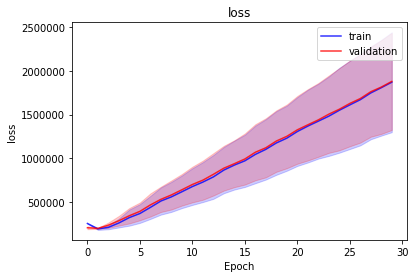

<b>bioma_loss</b>: 935074.5625 (min: 649896.2500, max: 1220252.8750)

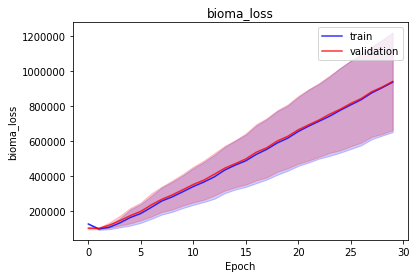

<b>domain_loss</b>: 935069.1250 (min: 649894.8750, max: 1220243.3750)

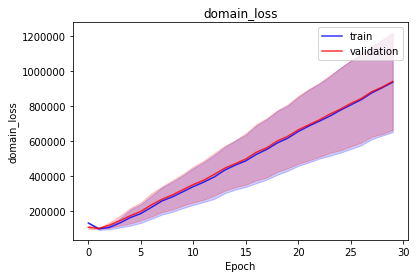

<b>latent_loss</b>: 0.0864 (min: 0.0485, max: 0.1243)

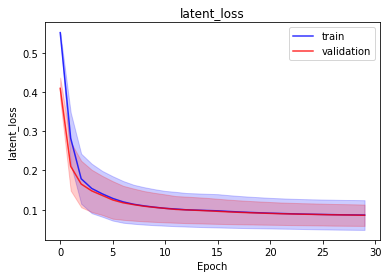

<b>bioma_mse</b>: 2.0055 (min: 1.9579, max: 2.0531)

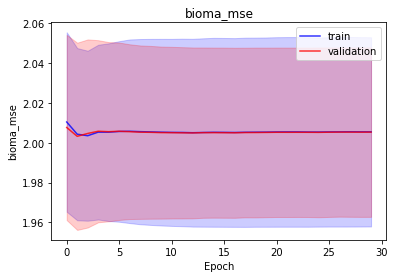

<b>bioma_mae</b>: 1.1197 (min: 1.0890, max: 1.1504)

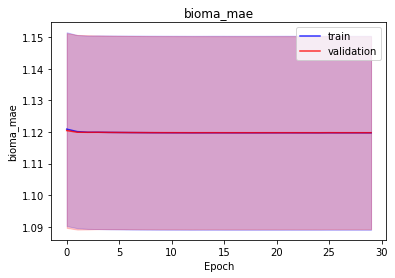

<b>bioma_mape</b>: nan (min: nan, max: nan)

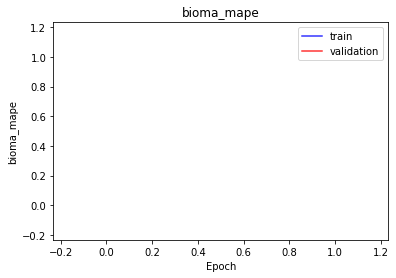

<b>domain_mse</b>: 2.0055 (min: 1.9580, max: 2.0531)

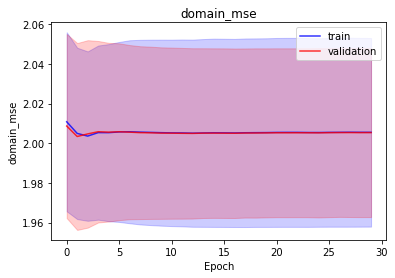

<b>domain_mae</b>: 1.1197 (min: 1.0890, max: 1.1504)

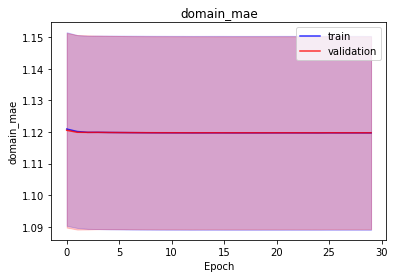

<b>domain_mape</b>: nan (min: nan, max: nan)

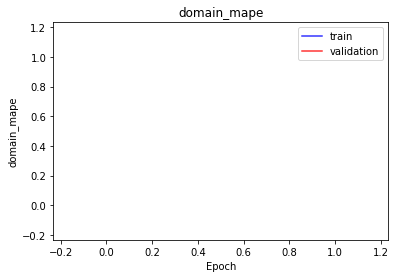

<b>latent_mae</b>: 0.0864 (min: 0.0485, max: 0.1243)

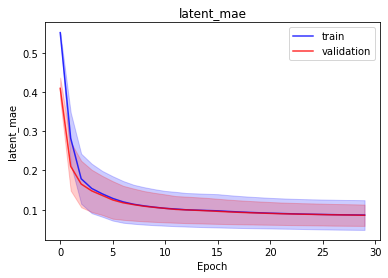

In [16]:

def create_model(print_data=False):

    output_transform = layers.Softmax()
    output_transform = layers.ReLU()
    input_transform = Percentage()
    input_transform = CenterLogRatio()
    output_transform = layers.Softmax()
    # output_transform = None
    models = autoencoder(#bioma_shape=717,
                         #domain_shape=None,
                         bioma_shape=717,
                         domain_shape=36,
                         latent_space=10,
                         bioma_layers=[256,128],                        
                         domain_layers=[32,16],
                         input_transform=input_transform,
                         output_transform=output_transform,
                         activation_function_encoder='tanh',
                         activation_function_decoder='tanh',
                         activation_function_latent='tanh')
    model, encoder_bioma, encoder_domain, decoder_bioma = models

    if print_data:
        plot_models(model, encoder_bioma, encoder_domain, decoder_bioma)

    compile_train(model,
                  encoder_domain=encoder_domain,
                  reconstruction_error=losses.CategoricalCrossentropy(),
                  encoded_comparison_error=losses.MeanAbsoluteError(),
                  metrics=get_experiment_metrics(input_transform, output_transform),
                  optimizer=optimizers.Adam(learning_rate=0.001))

    return model, encoder_bioma, encoder_domain, decoder_bioma

model, encoder_bioma, encoder_domain, decoder_bioma = create_model(print_data=False)

results  = train(create_model,
                 data_microbioma,
                 data_domain,
                 latent_space=10,
                 folds=2,
                 epochs=30,
                 batch_size=2,
                 learning_rate_scheduler=None,
                 verbose=-1)

print(results[0].history)

validation_results = print_results(results)


In [25]:
# Save tables of OTU predicted values
def save_predicted_otu_table(model,test_microbioma,test_domain,sample_names,otu_names):
    nsamples = len(test_microbioma)
    #nsamples=10
    p = model.predict([test_microbioma[:nsamples],test_domain[:nsamples]])

    df0 = pd.DataFrame(p[0], index=sample_names, columns=otu_names)
    df0.T.to_csv('otus_predicted_biome.tsv', index=True, header=True, sep='\t')

    df1 = pd.DataFrame(p[1], index=sample_names, columns=otu_names)
    df1.T.to_csv('otus_predicted_domain.tsv', index=True, header=True, sep='\t')

    df2 = pd.DataFrame(p[2], index=sample_names)
    df2.T.to_csv('latent_predicted.tsv', index=True, sep='\t')
    
    return df0, df1 , df2

data_microbioma = df[otu.columns].to_numpy(dtype=np.float32)#[:100]
data_domain = df[domain.columns].to_numpy(dtype=np.float32)#[:100]
nsamples = len(data_microbioma)
df_pred_biome, df_pred_domain, df_latent = save_predicted_otu_table(model,data_microbioma[:nsamples],data_domain[:nsamples],otu.index[:nsamples],otu.columns)

In [27]:
print(otu.columns[0])
#    print(df0[otu_id])
#rint(otu.shape)
# df[otu.columns]
print(df_pred_domain[otu.columns[0]])
len(otu.columns)

4479944
otuids
11116.C02A66.1194587     0.001387
11116.C06A63.1195666     0.001363
11116.C08A61.1197689     0.001359
11116.C08A63.1196825     0.001361
11116.C12A64.1197667     0.001356
                           ...   
11116.L01A079.1194513    0.001389
11116.C10A62.1195924     0.001389
11116.A07C079.1195819    0.001389
11116.I29A118.1198207    0.001402
11116.A04B094.1196153    0.001402
Name: 4479944, Length: 4724, dtype: float32


717

In [35]:
# Save error by independent OTU and by independent sample
from scipy.stats import pearsonr

#otu_corr = np.zeros((len(otu.columns),1))
otu_corr = {}
for otu_id in otu.columns:
    otu_corr[otu_id], _ = pearsonr(otu[otu_id], df_pred_biome[otu_id])
    #print('Pearson correlation otu %s: %.3f' % (otu_id,corr))

with open('pearson.tsv', 'w') as f:
    f.write('otuID\tPearsonCorr\n') 
    for key, value in otu_corr.items():
        f.write('{0}\t{1}\n'.format(key, value)) 


In [149]:
input_transform = CenterLogRatio()
output_transform = layers.Softmax()
get_experiment_metrics(input_transform, output_transform)

[[<__main__.MeanSquaredErrorWrapper at 0x7f48bc0c1198>,

In [142]:
p = model.predict([data_microbioma[:15],data_domain[:15]])
# It returns a first array with the predictions of the 717 OTU abundances, 
#data_domain[:1].shape
#print(p[1].size)
# and a second array with the latent space of the latent_space size defined in the model.
#print(p[2].size)
print(p[0].shape)
print(p[1].shape)
print(p[2].shape)

(15, 717)
(15, 717)
(15, 10)


In [144]:

p = model.predict(data_microbioma[:1])
print(p)
print(np.asarray(p).sum())

for l in model.layers:
    print(l.name)
print()

for l in model.layers[5:]:
    print(l)
    print(l.name)
    new_model = keras.Model(inputs=model.inputs, outputs=l.output)
    print(new_model.predict(data_microbioma[:1]))

ValueError: Error when checking model input: the list of Numpy arrays that you are passing to your model is not the size the model expected. Expected to see 2 array(s), for inputs ['bioma_input_717', 'domain_input_36'] but instead got the following list of 1 arrays: [array([[7.300e+01, 0.000e+00, 7.490e+02, 6.000e+00, 1.100e+01, 1.000e+00,
        1.052e+03, 0.000e+00, 0.000e+00, 7.600e+01, 8.000e+00, 0.000e+00,
        1.200e+01, 1.900e+01, 5.000e+01, 0.000e+00,...

In [37]:
data_microbioma[:1].shape

(1, 717)

In [31]:
i = layers.Input((3,))
n= i
n = CenterLogRatio()(n)
n = layers.Softmax()(n)
model = keras.Model(i,n)

model.predict([[1,1,1]])

array([[0.33333334, 0.33333334, 0.33333334]], dtype=float32)